In [1]:
# to run the code, ensure that you have environment.py in your library site-packages or the folder containing the jupyter notbook.
# the environment.py is attached in the folder with the jupyter notebook
import random
import numpy as np
import matplotlib.pyplot as plt
from environment import TreasureCube
import pandas as pd

In [2]:
np.random.seed(10)

## Baseline Q Agent (parameters: discount factor = 0.99, learning rate= 0.5, exploration rate = 0.01)

In [3]:
# you need to implement your agent based on one RL algorithm
class QAgent(object):
    def __init__(self):
        self.learning_rate = 0.5
        self.discount = 0.99
        self.exploration_rate = 0.01
        self.action_space = ['left','right','forward','backward','up','down'] # in TreasureCube
        self.Q = np.zeros([64,6])

    def take_action(self, state):
        if np.random.random() > self.exploration_rate:
            # Get action from Q table
            print("current state: " + state)
            state = [int(d) for d in str(state)]
            state = state[0] + state[1]*4 + state[2]*16
            action = self.action_space[np.argmax(self.Q[state])]
        else:
            print("random action!!!")
            action = random.choice(self.action_space)
        return action

    # implement your train/update function to update self.V or self.Q
    # you should pass arguments to the train function
    def train(self, state, action, next_state, reward):
        state = [int(d) for d in str(state)]
        state = state[0] + state[1]*4 + state[2]*16
        
        next_state = [int(d) for d in str(next_state)]
        next_state = next_state[0] + next_state[1]*4 + next_state[2]*16
        
        # Maximum possible Q value in next step (for new state)
        max_future_q = np.max(self.Q[next_state])

        # Current Q value (for current state and performed action)
        current_q = self.Q[state,self.action_space.index(action)]

        # And here's our equation for a new Q value for current state and action
        new_q = (1 - self.learning_rate) * current_q + self.learning_rate * (reward + self.discount * max_future_q)

        # Update Q table with new Q value
        self.Q[state,self.action_space.index(action)] = new_q
        
    def q_table(self):
        return self.Q

def test_cube(max_episode, max_step):
    env = TreasureCube(max_step=max_step)
    agent = QAgent()
    SHOW_EP = 100
    SHOW_STEP = 10
    # For stats
    ep_rewards = []
    aggr_ep_rewards = {'ep': [], 'avg': [], 'max': [], 'min': []}
    ep_steps = []

    for epsisode_num in range(0, max_episode):
        state = env.reset()
        terminate = False
        t = 0
        episode_reward = 0
        while not terminate:
            action = agent.take_action(state)
            reward, terminate, next_state = env.step(action)
            episode_reward += reward
            # you can comment the following two lines, if the output is too much
            if epsisode_num % SHOW_EP == 0 and t % SHOW_STEP == 0:
                env.render() # comment
            print(f'epsisode: {epsisode_num},step: {t}, action: {action}, reward: {reward}') # comment
            t += 1
            agent.train(state, action, next_state, reward)
            state = next_state
        print(f'epsisode: {epsisode_num}, total_steps: {t} episode reward: {episode_reward}')
        ep_rewards.append(episode_reward)
        ep_steps.append(t)
        aggr_ep_rewards['ep'].append(epsisode_num)
        aggr_ep_rewards['avg'].append(sum(ep_rewards)/(epsisode_num+1))
        aggr_ep_rewards['max'].append(max(ep_rewards))
        aggr_ep_rewards['min'].append(min(ep_rewards))
        
    return agent.q_table(),ep_rewards,aggr_ep_rewards,ep_steps

In [17]:
q,ep_rewards,aggr_ep_rewards,ep_steps = test_cube(500, 500)

current state: 000
* * * *
- + - -
- - - -
- - - -
- - - -
# # # #
- - - -
- - - -
- - - -
- - - -
# # # #
- - - -
- - - -
- - - -
- - - -
# # # #
- - - -
- - - -
- - - -
- - - G
# # # #
* * * *
epsisode: 0,step: 0, action: left, reward: -0.1
current state: 001
epsisode: 0,step: 1, action: left, reward: -0.1
current state: 001
epsisode: 0,step: 2, action: right, reward: -0.1
current state: 101
epsisode: 0,step: 3, action: left, reward: -0.1
current state: 101
epsisode: 0,step: 4, action: right, reward: -0.1
current state: 001
epsisode: 0,step: 5, action: forward, reward: -0.1
current state: 101
epsisode: 0,step: 6, action: forward, reward: -0.1
current state: 201
epsisode: 0,step: 7, action: left, reward: -0.1
current state: 301
epsisode: 0,step: 8, action: left, reward: -0.1
current state: 301
epsisode: 0,step: 9, action: right, reward: -0.1
current state: 311
* * * *
- - - -
- - - -
- - - -
- - - -
# # # #
- - - -
- - - -
- - - -
- - - -
# # # #
- - - -
- - - -
- - - -
- - - -
# # # 

current state: 123
epsisode: 9,step: 7, action: left, reward: -0.1
current state: 113
epsisode: 9,step: 8, action: down, reward: -0.1
current state: 112
epsisode: 9,step: 9, action: left, reward: -0.1
current state: 113
epsisode: 9,step: 10, action: forward, reward: -0.1
current state: 213
epsisode: 9,step: 11, action: down, reward: -0.1
current state: 313
epsisode: 9,step: 12, action: right, reward: -0.1
current state: 323
epsisode: 9,step: 13, action: right, reward: -0.1
current state: 223
epsisode: 9,step: 14, action: right, reward: -0.1
current state: 223
epsisode: 9,step: 15, action: right, reward: -0.1
current state: 222
epsisode: 9,step: 16, action: backward, reward: -0.1
current state: 122
epsisode: 9,step: 17, action: down, reward: -0.1
current state: 132
epsisode: 9,step: 18, action: up, reward: -0.1
current state: 133
epsisode: 9,step: 19, action: forward, reward: -0.1
current state: 132
epsisode: 9,step: 20, action: up, reward: -0.1
current state: 133
epsisode: 9,step: 21, 

epsisode: 54, total_steps: 27 episode reward: -1.600000000000001
current state: 000
epsisode: 55,step: 0, action: right, reward: -0.1
current state: 001
epsisode: 55,step: 1, action: forward, reward: -0.1
current state: 000
epsisode: 55,step: 2, action: right, reward: -0.1
current state: 000
epsisode: 55,step: 3, action: backward, reward: -0.1
current state: 001
epsisode: 55,step: 4, action: up, reward: -0.1
current state: 101
epsisode: 55,step: 5, action: right, reward: -0.1
current state: 201
epsisode: 55,step: 6, action: left, reward: -0.1
current state: 201
epsisode: 55,step: 7, action: backward, reward: -0.1
current state: 101
epsisode: 55,step: 8, action: up, reward: -0.1
current state: 001
epsisode: 55,step: 9, action: up, reward: -0.1
current state: 001
epsisode: 55,step: 10, action: up, reward: -0.1
current state: 002
epsisode: 55,step: 11, action: left, reward: -0.1
current state: 002
epsisode: 55,step: 12, action: backward, reward: -0.1
current state: 012
epsisode: 55,step: 

epsisode: 137,step: 11, action: forward, reward: -0.1
current state: 223
epsisode: 137,step: 12, action: right, reward: -0.1
current state: 233
epsisode: 137,step: 13, action: forward, reward: -0.1
current state: 232
epsisode: 137,step: 14, action: up, reward: -0.1
current state: 132
epsisode: 137,step: 15, action: up, reward: -0.1
current state: 232
epsisode: 137,step: 16, action: up, reward: -0.1
current state: 132
epsisode: 137,step: 17, action: up, reward: -0.1
current state: 133
epsisode: 137,step: 18, action: forward, reward: -0.1
current state: 233
epsisode: 137,step: 19, action: forward, reward: 1
epsisode: 137, total_steps: 20 episode reward: -0.9000000000000006
current state: 000
epsisode: 138,step: 0, action: right, reward: -0.1
current state: 010
epsisode: 138,step: 1, action: right, reward: -0.1
current state: 110
epsisode: 138,step: 2, action: forward, reward: -0.1
current state: 210
epsisode: 138,step: 3, action: up, reward: -0.1
current state: 211
epsisode: 138,step: 4,

current state: 010
epsisode: 236,step: 2, action: right, reward: -0.1
current state: 010
epsisode: 236,step: 3, action: right, reward: -0.1
current state: 020
epsisode: 236,step: 4, action: right, reward: -0.1
current state: 020
epsisode: 236,step: 5, action: right, reward: -0.1
current state: 030
epsisode: 236,step: 6, action: up, reward: -0.1
current state: 031
epsisode: 236,step: 7, action: forward, reward: -0.1
current state: 131
epsisode: 236,step: 8, action: up, reward: -0.1
current state: 121
epsisode: 236,step: 9, action: right, reward: -0.1
current state: 131
epsisode: 236,step: 10, action: up, reward: -0.1
current state: 231
epsisode: 236,step: 11, action: up, reward: -0.1
current state: 232
epsisode: 236,step: 12, action: up, reward: -0.1
current state: 233
epsisode: 236,step: 13, action: forward, reward: -0.1
current state: 223
epsisode: 236,step: 14, action: right, reward: -0.1
current state: 223
epsisode: 236,step: 15, action: right, reward: -0.1
current state: 233
epsiso

epsisode: 330,step: 12, action: up, reward: -0.1
current state: 132
epsisode: 330,step: 13, action: up, reward: -0.1
current state: 232
epsisode: 330,step: 14, action: up, reward: -0.1
current state: 233
epsisode: 330,step: 15, action: forward, reward: 1
epsisode: 330, total_steps: 16 episode reward: -0.5000000000000002
current state: 000
epsisode: 331,step: 0, action: right, reward: -0.1
current state: 000
epsisode: 331,step: 1, action: right, reward: -0.1
current state: 010
epsisode: 331,step: 2, action: right, reward: -0.1
current state: 020
epsisode: 331,step: 3, action: forward, reward: -0.1
current state: 120
epsisode: 331,step: 4, action: up, reward: -0.1
current state: 110
epsisode: 331,step: 5, action: forward, reward: -0.1
current state: 111
epsisode: 331,step: 6, action: right, reward: -0.1
current state: 121
epsisode: 331,step: 7, action: right, reward: -0.1
current state: 131
epsisode: 331,step: 8, action: up, reward: -0.1
current state: 132
epsisode: 331,step: 9, action: 

current state: 331
epsisode: 421,step: 12, action: up, reward: -0.1
current state: 332
epsisode: 421,step: 13, action: up, reward: 1
epsisode: 421, total_steps: 14 episode reward: -0.30000000000000004
current state: 000
epsisode: 422,step: 0, action: up, reward: -0.1
current state: 100
epsisode: 422,step: 1, action: right, reward: -0.1
current state: 110
epsisode: 422,step: 2, action: forward, reward: -0.1
current state: 210
epsisode: 422,step: 3, action: up, reward: -0.1
current state: 211
epsisode: 422,step: 4, action: forward, reward: -0.1
current state: 221
epsisode: 422,step: 5, action: up, reward: -0.1
current state: 222
epsisode: 422,step: 6, action: up, reward: -0.1
current state: 122
epsisode: 422,step: 7, action: up, reward: -0.1
current state: 123
epsisode: 422,step: 8, action: forward, reward: -0.1
current state: 223
epsisode: 422,step: 9, action: right, reward: -0.1
current state: 233
epsisode: 422,step: 10, action: forward, reward: 1
epsisode: 422, total_steps: 11 episode

In [18]:
print("Maximum number of steps for last 100 episodes: " + str(max(ep_steps[-100:])))

Maximum number of steps for last 100 episodes: 40


In [19]:
print("Average number of steps for last 100 episodes: " + str(sum(ep_steps[-100:])/100))

Average number of steps for last 100 episodes: 14.6


In [20]:
count = 0

for i in ep_steps:
    if i < 15:
        count += 1
print("percentage of episodes below 15 steps : " + str(count/len(ep_steps)))

percentage of episodes below 15 steps : 0.424


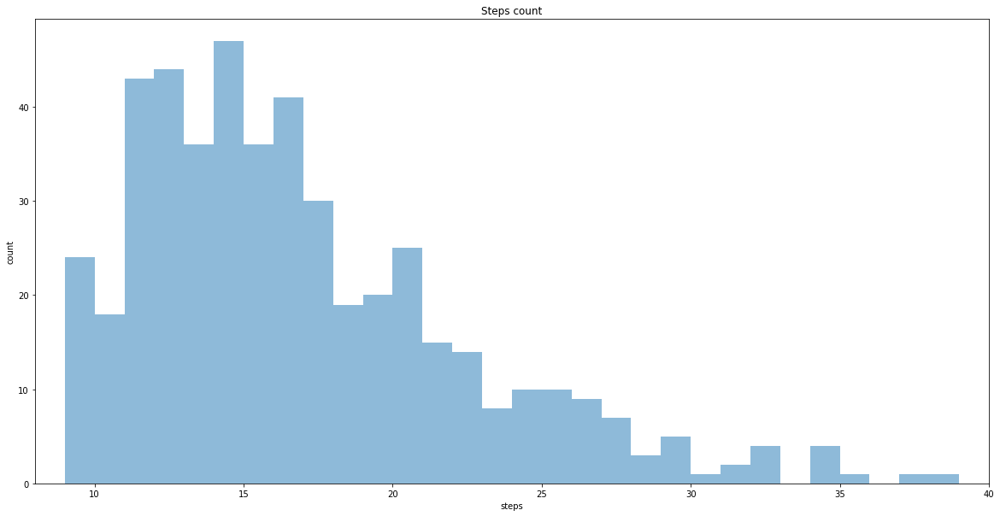

In [21]:
plt.figure(figsize=(20,10))
bins = np.arange(9, 40, 1) # fixed bin size

plt.xlim([8, 40])

plt.hist(ep_steps, bins=bins, alpha=0.5)
plt.title('Steps count')
plt.xlabel('steps')
plt.ylabel('count')

plt.show()

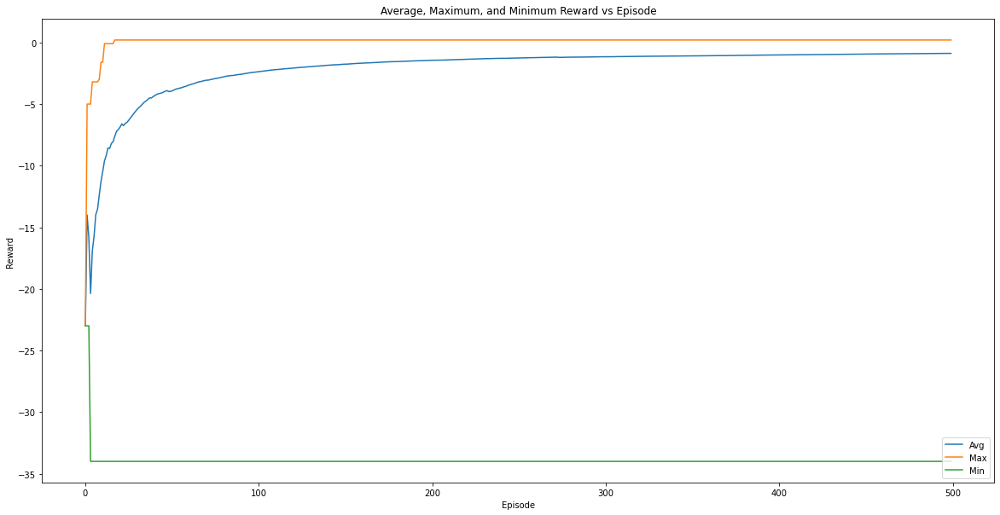

In [22]:
plt.figure(figsize=(20,10))
plt.plot(aggr_ep_rewards['avg'])
plt.plot(aggr_ep_rewards['max'])
plt.plot(aggr_ep_rewards['min'])
plt.title('Average, Maximum, and Minimum Reward vs Episode')
plt.ylabel('Reward')
plt.xlabel('Episode')
plt.legend(['Avg', 'Max', 'Min'], loc='lower right')
plt.show()

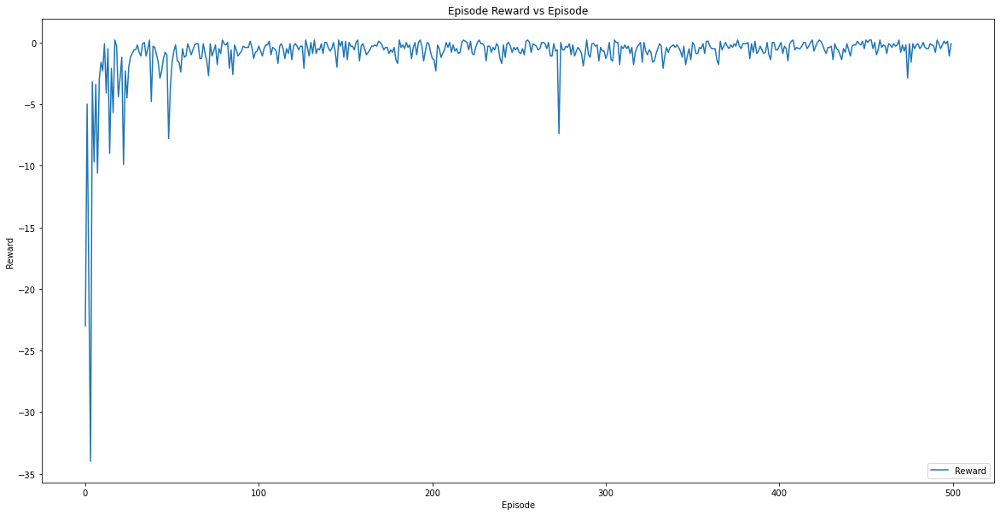

In [23]:
plt.figure(figsize=(20,10))
plt.plot(ep_rewards)
plt.title('Episode Reward vs Episode')
plt.ylabel('Reward')
plt.xlabel('Episode')
plt.legend(['Reward'], loc='lower right')
plt.show()

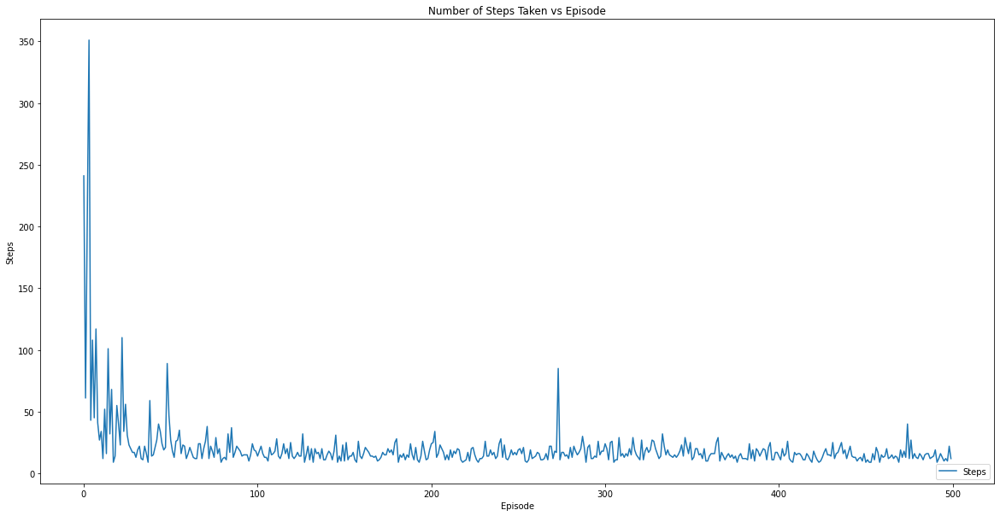

In [24]:
plt.figure(figsize=(20,10))
plt.plot(ep_steps)
plt.title('Number of Steps Taken vs Episode')
plt.ylabel('Steps')
plt.xlabel('Episode')
plt.legend(['Steps'], loc='lower right')
plt.show()

In [32]:
index = []

for i in range(0,4):
    for j in range(0,4):
        for h in range(0,4):
            x = str(i) + ',' + str(j) + ',' + str(h)
            index.append(x)

In [35]:
q_table_frame = pd.DataFrame(index,columns=['Grid Position'])
q_table_frame.head()

,Grid Position
0,"0,0,0"
1,"0,0,1"
2,"0,0,2"
3,"0,0,3"
4,"0,1,0"


In [36]:
pd.set_option("display.max_rows", None, "display.max_columns", None)
df = pd.DataFrame(data=q, columns=['left','right','forward','backward','up','down'])
q_table_frame = pd.concat([q_table_frame, df], axis=1)
q_table_frame = q_table_frame.set_index('Grid Position')
q_table_frame.head(64)

,left,right,forward,backward,up,down
Grid Position,,,,,,
"0,0,0",-0.681231,-0.685250,-0.688787,-0.701823,-0.315544,-0.718573
"0,0,1",-0.599390,-0.199357,-0.555004,-0.608753,-0.656315,-0.612276
"0,0,2",-0.570091,-0.515419,-0.254516,-0.538326,-0.514509,-0.544454
"0,0,3",-0.470067,-0.473642,-0.489720,-0.489405,-0.221556,-0.477644
"0,1,0",-0.609106,-0.201960,-0.657518,-0.615525,-0.611597,-0.593153
"0,1,1",-0.558632,-0.550313,-0.056779,-0.535816,-0.500480,-0.513073
"0,1,2",-0.419069,-0.391299,-0.374683,-0.430567,0.056344,-0.414973
"0,1,3",-0.357957,0.145806,-0.355407,-0.334277,-0.326002,-0.321779
"0,2,0",-0.489919,-0.076081,-0.494127,-0.468598,-0.332398,-0.472073


## Testing Trained Q-Learning Agent

In [37]:
class TestAgent(object):
    def __init__(self,q_table):
        self.action_space = ['left','right','forward','backward','up','down'] # in TreasureCube
        self.Q = q_table

    def take_action(self, state):

        print("current state: " + state)
        state = [int(d) for d in str(state)]
        state = state[0] + state[1]*4 + state[2]*16
        action = self.action_space[np.argmax(self.Q[state])]
   
        return action

def test(max_episode, max_step,q_table):
    env = TreasureCube(max_step=max_step)
    agent = TestAgent(q_table)
    SHOW_EP = 100
    SHOW_STEP = 10
    # For stats
    ep_rewards = []
    aggr_ep_rewards = {'ep': [], 'avg': [], 'max': [], 'min': []}
    ep_steps = []

    for epsisode_num in range(0, max_episode):
        state = env.reset()
        terminate = False
        t = 0
        episode_reward = 0
        while not terminate:
            action = agent.take_action(state)
            reward, terminate, next_state = env.step(action)
            episode_reward += reward
            # you can comment the following two lines, if the output is too much
            #if epsisode_num % SHOW_EP == 0 and t % SHOW_STEP == 0:
                #env.render() # comment
            print(f'epsisode: {epsisode_num},step: {t}, action: {action}, reward: {reward}') # comment
            t += 1
            state = next_state
        print(f'epsisode: {epsisode_num}, total_steps: {t} episode reward: {episode_reward}')
        ep_rewards.append(episode_reward)
        ep_steps.append(t)
        aggr_ep_rewards['ep'].append(epsisode_num)
        aggr_ep_rewards['avg'].append(sum(ep_rewards)/(epsisode_num+1))
        aggr_ep_rewards['max'].append(max(ep_rewards))
        aggr_ep_rewards['min'].append(min(ep_rewards))
        
    return ep_rewards,ep_steps,aggr_ep_rewards

In [38]:
ep_rewards,ep_steps,aggr_ep_rewards = test(100, 500,q)

current state: 000
epsisode: 0,step: 0, action: up, reward: -0.1
current state: 000
epsisode: 0,step: 1, action: up, reward: -0.1
current state: 001
epsisode: 0,step: 2, action: up, reward: -0.1
current state: 101
epsisode: 0,step: 3, action: up, reward: -0.1
current state: 102
epsisode: 0,step: 4, action: right, reward: -0.1
current state: 002
epsisode: 0,step: 5, action: up, reward: -0.1
current state: 003
epsisode: 0,step: 6, action: right, reward: -0.1
current state: 013
epsisode: 0,step: 7, action: right, reward: -0.1
current state: 113
epsisode: 0,step: 8, action: right, reward: -0.1
current state: 123
epsisode: 0,step: 9, action: forward, reward: -0.1
current state: 223
epsisode: 0,step: 10, action: right, reward: -0.1
current state: 233
epsisode: 0,step: 11, action: forward, reward: 1
epsisode: 0, total_steps: 12 episode reward: -0.09999999999999987
current state: 000
epsisode: 1,step: 0, action: up, reward: -0.1
current state: 100
epsisode: 1,step: 1, action: right, reward: -0

current state: 132
epsisode: 94,step: 13, action: up, reward: -0.1
current state: 133
epsisode: 94,step: 14, action: forward, reward: -0.1
current state: 133
epsisode: 94,step: 15, action: forward, reward: -0.1
current state: 233
epsisode: 94,step: 16, action: forward, reward: 1
epsisode: 94, total_steps: 17 episode reward: -0.6000000000000003
current state: 000
epsisode: 95,step: 0, action: up, reward: -0.1
current state: 001
epsisode: 95,step: 1, action: up, reward: -0.1
current state: 002
epsisode: 95,step: 2, action: up, reward: -0.1
current state: 003
epsisode: 95,step: 3, action: right, reward: -0.1
current state: 002
epsisode: 95,step: 4, action: up, reward: -0.1
current state: 003
epsisode: 95,step: 5, action: right, reward: -0.1
current state: 013
epsisode: 95,step: 6, action: right, reward: -0.1
current state: 023
epsisode: 95,step: 7, action: right, reward: -0.1
current state: 033
epsisode: 95,step: 8, action: forward, reward: -0.1
current state: 023
epsisode: 95,step: 9, ac

In [39]:
print("Maximum number of steps : " + str(max(ep_steps)))
print("Average number of steps: " + str(sum(ep_steps)/100))

Maximum number of steps : 40
Average number of steps: 15.2


In [40]:
count = 0

for i in ep_steps:
    if i < 15:
        count += 1
print("percentage of episodes below 15 steps : " + str(count/len(ep_steps)))

percentage of episodes below 15 steps : 0.53


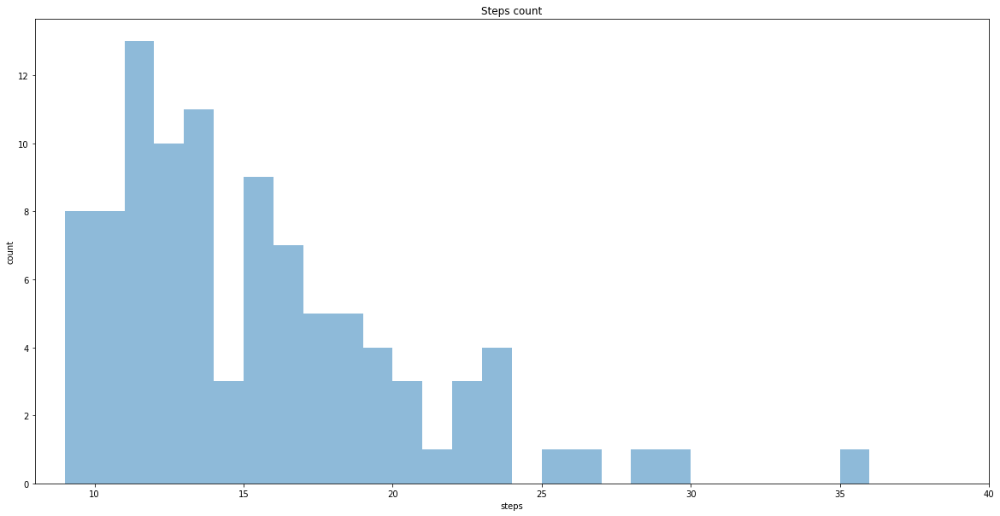

In [41]:
plt.figure(figsize=(20,10))
bins = np.arange(9, 40, 1) # fixed bin size

plt.xlim([8, 40])

plt.hist(ep_steps, bins=bins, alpha=0.5)
plt.title('Steps count')
plt.xlabel('steps')
plt.ylabel('count')

plt.show()

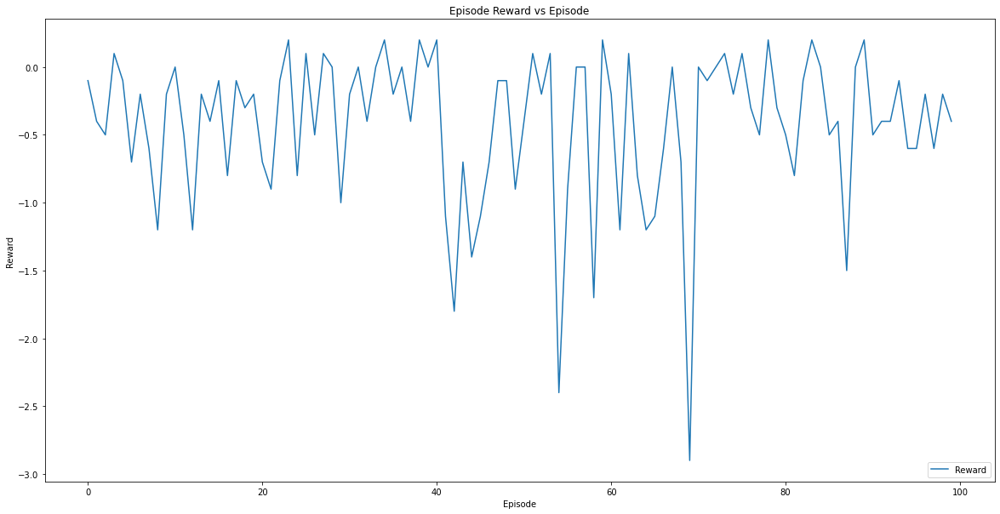

In [42]:
plt.figure(figsize=(20,10))
plt.plot(ep_rewards)
plt.title('Episode Reward vs Episode')
plt.ylabel('Reward')
plt.xlabel('Episode')
plt.legend(['Reward'], loc='lower right')
plt.show()

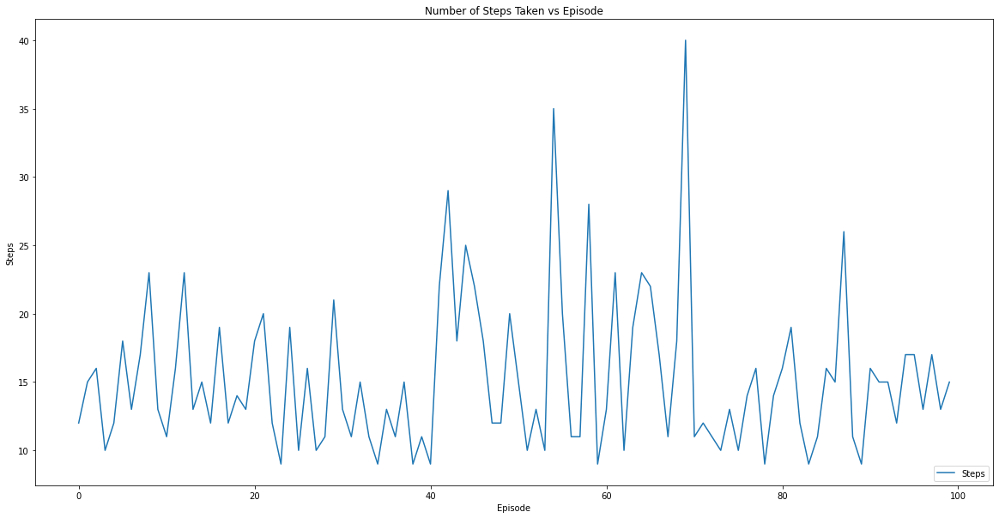

In [43]:
plt.figure(figsize=(20,10))
plt.plot(ep_steps)
plt.title('Number of Steps Taken vs Episode')
plt.ylabel('Steps')
plt.xlabel('Episode')
plt.legend(['Steps'], loc='lower right')
plt.show()

## Q Agent Choose Optimal Learning Rate

In [119]:
# Find optimal Learning rate from [0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9] learning rates
class QAgent(object):
    def __init__(self, learning_rate):
        self.learning_rate = learning_rate
        self.discount = 0.99
        self.exploration_rate = 0.01
        self.action_space = ['left','right','forward','backward','up','down'] # in TreasureCube
        self.Q = np.zeros([64,6])

    def take_action(self, state):
        if np.random.random() > self.exploration_rate:
            # Get action from Q table
            print("current state: " + state)
            state = [int(d) for d in str(state)]
            state = state[0] + state[1]*4 + state[2]*16
            action = self.action_space[np.argmax(self.Q[state])]
        else:
            print("random action!!!")
            action = random.choice(self.action_space)
        return action

    # implement your train/update function to update self.V or self.Q
    # you should pass arguments to the train function
    def train(self, state, action, next_state, reward):
        state = [int(d) for d in str(state)]
        state = state[0] + state[1]*4 + state[2]*16
        
        next_state = [int(d) for d in str(next_state)]
        next_state = next_state[0] + next_state[1]*4 + next_state[2]*16
        
        # Maximum possible Q value in next step (for new state)
        max_future_q = np.max(self.Q[next_state])

        # Current Q value (for current state and performed action)
        current_q = self.Q[state,self.action_space.index(action)]

        # And here's our equation for a new Q value for current state and action
        new_q = (1 - self.learning_rate) * current_q + self.learning_rate * (reward + self.discount * max_future_q)

        # Update Q table with new Q value
        self.Q[state,self.action_space.index(action)] = new_q
        
    def q_table(self):
        return self.Q

def test_cube(max_episode, max_step):
    env = TreasureCube(max_step=max_step)
    learning_rates = [0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9]
    learning_rates_stats = {'lr': [], 'ep_rewards': [], 'aggr_ep_rewards': [], 'ep_steps': [], 'q_tables': []}
    for i in learning_rates:
        print("Learning rate: " + str(i))
        agent = QAgent(i)
        SHOW_EP = 100
        SHOW_STEP = 10
        # For stats
        ep_rewards = []
        aggr_ep_rewards = {'ep': [], 'avg': [], 'max': [], 'min': []}
        ep_steps = []

        for epsisode_num in range(0, max_episode):
            state = env.reset()
            terminate = False
            t = 0
            episode_reward = 0
            while not terminate:
                action = agent.take_action(state)
                reward, terminate, next_state = env.step(action)
                episode_reward += reward
                # you can comment the following two lines, if the output is too much
                #if epsisode_num % SHOW_EP == 0 and t % SHOW_STEP == 0:
                    #env.render() # comment
                print(f'learning rate: {i},epsisode: {epsisode_num},step: {t}, action: {action}, reward: {reward}') # comment
                t += 1
                agent.train(state, action, next_state, reward)
                state = next_state
            print(f'learning rate: {i},epsisode: {epsisode_num}, total_steps: {t} episode reward: {episode_reward}')
            ep_rewards.append(episode_reward)
            ep_steps.append(t)
            aggr_ep_rewards['ep'].append(epsisode_num)
            aggr_ep_rewards['avg'].append(sum(ep_rewards)/(epsisode_num+1))
            aggr_ep_rewards['max'].append(max(ep_rewards))
            aggr_ep_rewards['min'].append(min(ep_rewards))
            
        learning_rates_stats['lr'].append(i)
        learning_rates_stats['ep_rewards'].append(ep_rewards)
        learning_rates_stats['aggr_ep_rewards'].append(aggr_ep_rewards)
        learning_rates_stats['ep_steps'].append(ep_steps)
        learning_rates_stats['q_tables'].append(agent.q_table())
        
    return learning_rates_stats

In [120]:
learning_rates_stats = test_cube(500, 500)

Learning rate: 0.1
current state: 000
learning rate: 0.1,epsisode: 0,step: 0, action: left, reward: -0.1
current state: 001
learning rate: 0.1,epsisode: 0,step: 1, action: left, reward: -0.1
current state: 001
learning rate: 0.1,epsisode: 0,step: 2, action: right, reward: -0.1
current state: 101
learning rate: 0.1,epsisode: 0,step: 3, action: left, reward: -0.1
current state: 101
learning rate: 0.1,epsisode: 0,step: 4, action: right, reward: -0.1
current state: 001
learning rate: 0.1,epsisode: 0,step: 5, action: forward, reward: -0.1
current state: 101
learning rate: 0.1,epsisode: 0,step: 6, action: forward, reward: -0.1
current state: 201
learning rate: 0.1,epsisode: 0,step: 7, action: left, reward: -0.1
current state: 301
learning rate: 0.1,epsisode: 0,step: 8, action: left, reward: -0.1
current state: 301
learning rate: 0.1,epsisode: 0,step: 9, action: right, reward: -0.1
current state: 311
learning rate: 0.1,epsisode: 0,step: 10, action: left, reward: -0.1
current state: 301
learni

learning rate: 0.1,epsisode: 12,step: 48, action: forward, reward: -0.1
current state: 311
learning rate: 0.1,epsisode: 12,step: 49, action: right, reward: -0.1
current state: 321
learning rate: 0.1,epsisode: 12,step: 50, action: right, reward: -0.1
current state: 331
learning rate: 0.1,epsisode: 12,step: 51, action: down, reward: -0.1
current state: 231
learning rate: 0.1,epsisode: 12,step: 52, action: backward, reward: -0.1
current state: 131
learning rate: 0.1,epsisode: 12,step: 53, action: up, reward: -0.1
current state: 132
learning rate: 0.1,epsisode: 12,step: 54, action: backward, reward: -0.1
current state: 032
learning rate: 0.1,epsisode: 12,step: 55, action: right, reward: -0.1
current state: 032
learning rate: 0.1,epsisode: 12,step: 56, action: backward, reward: -0.1
current state: 031
learning rate: 0.1,epsisode: 12,step: 57, action: down, reward: -0.1
current state: 030
learning rate: 0.1,epsisode: 12,step: 58, action: backward, reward: -0.1
current state: 030
learning rat

learning rate: 0.1,epsisode: 45,step: 23, action: up, reward: -0.1
current state: 312
learning rate: 0.1,epsisode: 45,step: 24, action: right, reward: -0.1
current state: 322
learning rate: 0.1,epsisode: 45,step: 25, action: up, reward: -0.1
current state: 323
learning rate: 0.1,epsisode: 45,step: 26, action: right, reward: 1
learning rate: 0.1,epsisode: 45, total_steps: 27 episode reward: -1.600000000000001
current state: 000
learning rate: 0.1,epsisode: 46,step: 0, action: up, reward: -0.1
current state: 001
learning rate: 0.1,epsisode: 46,step: 1, action: right, reward: -0.1
current state: 011
learning rate: 0.1,epsisode: 46,step: 2, action: left, reward: -0.1
current state: 012
learning rate: 0.1,epsisode: 46,step: 3, action: backward, reward: -0.1
current state: 012
learning rate: 0.1,epsisode: 46,step: 4, action: up, reward: -0.1
current state: 002
learning rate: 0.1,epsisode: 46,step: 5, action: backward, reward: -0.1
current state: 002
learning rate: 0.1,epsisode: 46,step: 6, a

learning rate: 0.1,epsisode: 99,step: 4, action: left, reward: -0.1
current state: 311
learning rate: 0.1,epsisode: 99,step: 5, action: right, reward: -0.1
current state: 310
learning rate: 0.1,epsisode: 99,step: 6, action: backward, reward: -0.1
current state: 210
learning rate: 0.1,epsisode: 99,step: 7, action: backward, reward: -0.1
current state: 220
learning rate: 0.1,epsisode: 99,step: 8, action: up, reward: -0.1
current state: 221
learning rate: 0.1,epsisode: 99,step: 9, action: up, reward: -0.1
current state: 321
learning rate: 0.1,epsisode: 99,step: 10, action: up, reward: -0.1
current state: 322
learning rate: 0.1,epsisode: 99,step: 11, action: up, reward: -0.1
current state: 323
learning rate: 0.1,epsisode: 99,step: 12, action: right, reward: 1
learning rate: 0.1,epsisode: 99, total_steps: 13 episode reward: -0.19999999999999996
current state: 000
learning rate: 0.1,epsisode: 100,step: 0, action: right, reward: -0.1
current state: 001
learning rate: 0.1,epsisode: 100,step: 1

current state: 232
learning rate: 0.1,epsisode: 159,step: 27, action: up, reward: -0.1
current state: 222
learning rate: 0.1,epsisode: 159,step: 28, action: up, reward: -0.1
current state: 223
learning rate: 0.1,epsisode: 159,step: 29, action: right, reward: -0.1
current state: 233
learning rate: 0.1,epsisode: 159,step: 30, action: forward, reward: -0.1
current state: 232
learning rate: 0.1,epsisode: 159,step: 31, action: up, reward: -0.1
current state: 132
learning rate: 0.1,epsisode: 159,step: 32, action: forward, reward: -0.1
current state: 232
learning rate: 0.1,epsisode: 159,step: 33, action: up, reward: -0.1
current state: 232
learning rate: 0.1,epsisode: 159,step: 34, action: up, reward: -0.1
current state: 232
learning rate: 0.1,epsisode: 159,step: 35, action: up, reward: -0.1
current state: 233
learning rate: 0.1,epsisode: 159,step: 36, action: forward, reward: 1
learning rate: 0.1,epsisode: 159, total_steps: 37 episode reward: -2.600000000000002
current state: 000
learning ra

current state: 122
learning rate: 0.1,epsisode: 240,step: 5, action: forward, reward: -0.1
current state: 112
learning rate: 0.1,epsisode: 240,step: 6, action: right, reward: -0.1
random action!!!
learning rate: 0.1,epsisode: 240,step: 7, action: up, reward: -0.1
current state: 123
learning rate: 0.1,epsisode: 240,step: 8, action: forward, reward: -0.1
current state: 122
learning rate: 0.1,epsisode: 240,step: 9, action: forward, reward: -0.1
current state: 123
learning rate: 0.1,epsisode: 240,step: 10, action: forward, reward: -0.1
current state: 223
learning rate: 0.1,epsisode: 240,step: 11, action: right, reward: -0.1
current state: 223
learning rate: 0.1,epsisode: 240,step: 12, action: right, reward: -0.1
current state: 323
learning rate: 0.1,epsisode: 240,step: 13, action: right, reward: -0.1
current state: 323
learning rate: 0.1,epsisode: 240,step: 14, action: right, reward: 1
learning rate: 0.1,epsisode: 240, total_steps: 15 episode reward: -0.40000000000000013
current state: 000

learning rate: 0.1,epsisode: 312,step: 13, action: up, reward: 1
learning rate: 0.1,epsisode: 312, total_steps: 14 episode reward: -0.30000000000000004
current state: 000
learning rate: 0.1,epsisode: 313,step: 0, action: forward, reward: -0.1
current state: 010
learning rate: 0.1,epsisode: 313,step: 1, action: up, reward: -0.1
current state: 011
learning rate: 0.1,epsisode: 313,step: 2, action: up, reward: -0.1
current state: 012
learning rate: 0.1,epsisode: 313,step: 3, action: forward, reward: -0.1
current state: 112
learning rate: 0.1,epsisode: 313,step: 4, action: right, reward: -0.1
current state: 122
learning rate: 0.1,epsisode: 313,step: 5, action: forward, reward: -0.1
current state: 222
learning rate: 0.1,epsisode: 313,step: 6, action: up, reward: -0.1
current state: 322
learning rate: 0.1,epsisode: 313,step: 7, action: up, reward: -0.1
current state: 322
learning rate: 0.1,epsisode: 313,step: 8, action: up, reward: -0.1
current state: 332
learning rate: 0.1,epsisode: 313,step

learning rate: 0.1,epsisode: 404,step: 8, action: up, reward: -0.1
current state: 223
learning rate: 0.1,epsisode: 404,step: 9, action: right, reward: -0.1
current state: 233
learning rate: 0.1,epsisode: 404,step: 10, action: forward, reward: 1
learning rate: 0.1,epsisode: 404, total_steps: 11 episode reward: 1.1102230246251565e-16
current state: 000
learning rate: 0.1,epsisode: 405,step: 0, action: right, reward: -0.1
current state: 010
learning rate: 0.1,epsisode: 405,step: 1, action: up, reward: -0.1
current state: 011
learning rate: 0.1,epsisode: 405,step: 2, action: up, reward: -0.1
current state: 012
learning rate: 0.1,epsisode: 405,step: 3, action: forward, reward: -0.1
current state: 002
learning rate: 0.1,epsisode: 405,step: 4, action: backward, reward: -0.1
current state: 002
learning rate: 0.1,epsisode: 405,step: 5, action: up, reward: -0.1
current state: 003
learning rate: 0.1,epsisode: 405,step: 6, action: up, reward: -0.1
current state: 003
learning rate: 0.1,epsisode: 40

learning rate: 0.2,epsisode: 1,step: 41, action: down, reward: -0.1
current state: 120
learning rate: 0.2,epsisode: 1,step: 42, action: left, reward: -0.1
current state: 220
learning rate: 0.2,epsisode: 1,step: 43, action: left, reward: -0.1
current state: 210
learning rate: 0.2,epsisode: 1,step: 44, action: left, reward: -0.1
current state: 211
learning rate: 0.2,epsisode: 1,step: 45, action: backward, reward: -0.1
current state: 111
learning rate: 0.2,epsisode: 1,step: 46, action: left, reward: -0.1
current state: 101
learning rate: 0.2,epsisode: 1,step: 47, action: forward, reward: -0.1
current state: 201
learning rate: 0.2,epsisode: 1,step: 48, action: up, reward: -0.1
current state: 211
learning rate: 0.2,epsisode: 1,step: 49, action: up, reward: -0.1
current state: 111
learning rate: 0.2,epsisode: 1,step: 50, action: right, reward: -0.1
current state: 110
learning rate: 0.2,epsisode: 1,step: 51, action: right, reward: -0.1
current state: 120
learning rate: 0.2,epsisode: 1,step: 5

learning rate: 0.2,epsisode: 28,step: 7, action: down, reward: -0.1
current state: 110
learning rate: 0.2,epsisode: 28,step: 8, action: right, reward: -0.1
current state: 111
learning rate: 0.2,epsisode: 28,step: 9, action: forward, reward: -0.1
current state: 211
learning rate: 0.2,epsisode: 28,step: 10, action: forward, reward: -0.1
current state: 221
learning rate: 0.2,epsisode: 28,step: 11, action: down, reward: -0.1
current state: 231
learning rate: 0.2,epsisode: 28,step: 12, action: up, reward: -0.1
current state: 232
learning rate: 0.2,epsisode: 28,step: 13, action: right, reward: -0.1
current state: 232
learning rate: 0.2,epsisode: 28,step: 14, action: right, reward: -0.1
current state: 232
learning rate: 0.2,epsisode: 28,step: 15, action: right, reward: -0.1
current state: 231
learning rate: 0.2,epsisode: 28,step: 16, action: up, reward: -0.1
current state: 232
learning rate: 0.2,epsisode: 28,step: 17, action: right, reward: -0.1
current state: 232
learning rate: 0.2,epsisode:

current state: 001
learning rate: 0.2,epsisode: 77,step: 5, action: up, reward: -0.1
current state: 001
learning rate: 0.2,epsisode: 77,step: 6, action: forward, reward: -0.1
current state: 101
learning rate: 0.2,epsisode: 77,step: 7, action: down, reward: -0.1
current state: 100
learning rate: 0.2,epsisode: 77,step: 8, action: right, reward: -0.1
current state: 110
learning rate: 0.2,epsisode: 77,step: 9, action: forward, reward: -0.1
current state: 210
learning rate: 0.2,epsisode: 77,step: 10, action: up, reward: -0.1
current state: 310
learning rate: 0.2,epsisode: 77,step: 11, action: left, reward: -0.1
current state: 300
learning rate: 0.2,epsisode: 77,step: 12, action: right, reward: -0.1
current state: 310
learning rate: 0.2,epsisode: 77,step: 13, action: right, reward: -0.1
current state: 320
learning rate: 0.2,epsisode: 77,step: 14, action: forward, reward: -0.1
current state: 321
learning rate: 0.2,epsisode: 77,step: 15, action: up, reward: -0.1
current state: 321
learning rat

current state: 101
learning rate: 0.2,epsisode: 137,step: 2, action: forward, reward: -0.1
current state: 201
learning rate: 0.2,epsisode: 137,step: 3, action: forward, reward: -0.1
current state: 201
learning rate: 0.2,epsisode: 137,step: 4, action: down, reward: -0.1
current state: 201
learning rate: 0.2,epsisode: 137,step: 5, action: right, reward: -0.1
current state: 211
learning rate: 0.2,epsisode: 137,step: 6, action: right, reward: -0.1
current state: 311
learning rate: 0.2,epsisode: 137,step: 7, action: up, reward: -0.1
current state: 211
learning rate: 0.2,epsisode: 137,step: 8, action: right, reward: -0.1
current state: 221
learning rate: 0.2,epsisode: 137,step: 9, action: up, reward: -0.1
current state: 231
learning rate: 0.2,epsisode: 137,step: 10, action: up, reward: -0.1
current state: 221
learning rate: 0.2,epsisode: 137,step: 11, action: up, reward: -0.1
current state: 222
learning rate: 0.2,epsisode: 137,step: 12, action: up, reward: -0.1
current state: 223
learning ra

learning rate: 0.2,epsisode: 215,step: 1, action: up, reward: -0.1
current state: 011
learning rate: 0.2,epsisode: 215,step: 2, action: right, reward: -0.1
current state: 011
learning rate: 0.2,epsisode: 215,step: 3, action: backward, reward: -0.1
current state: 011
learning rate: 0.2,epsisode: 215,step: 4, action: right, reward: -0.1
current state: 021
learning rate: 0.2,epsisode: 215,step: 5, action: up, reward: -0.1
current state: 022
learning rate: 0.2,epsisode: 215,step: 6, action: up, reward: -0.1
current state: 032
learning rate: 0.2,epsisode: 215,step: 7, action: forward, reward: -0.1
current state: 032
learning rate: 0.2,epsisode: 215,step: 8, action: forward, reward: -0.1
current state: 031
learning rate: 0.2,epsisode: 215,step: 9, action: forward, reward: -0.1
current state: 031
learning rate: 0.2,epsisode: 215,step: 10, action: up, reward: -0.1
current state: 032
learning rate: 0.2,epsisode: 215,step: 11, action: forward, reward: -0.1
current state: 132
learning rate: 0.2,e

learning rate: 0.2,epsisode: 288,step: 19, action: right, reward: -0.1
current state: 133
learning rate: 0.2,epsisode: 288,step: 20, action: forward, reward: -0.1
current state: 233
learning rate: 0.2,epsisode: 288,step: 21, action: forward, reward: -0.1
current state: 223
learning rate: 0.2,epsisode: 288,step: 22, action: right, reward: -0.1
current state: 233
learning rate: 0.2,epsisode: 288,step: 23, action: forward, reward: -0.1
current state: 232
learning rate: 0.2,epsisode: 288,step: 24, action: backward, reward: -0.1
current state: 132
learning rate: 0.2,epsisode: 288,step: 25, action: up, reward: -0.1
current state: 032
learning rate: 0.2,epsisode: 288,step: 26, action: forward, reward: -0.1
current state: 132
learning rate: 0.2,epsisode: 288,step: 27, action: up, reward: -0.1
current state: 133
learning rate: 0.2,epsisode: 288,step: 28, action: forward, reward: -0.1
current state: 233
learning rate: 0.2,epsisode: 288,step: 29, action: forward, reward: 1
learning rate: 0.2,epsi

learning rate: 0.2,epsisode: 362,step: 1, action: forward, reward: -0.1
current state: 010
learning rate: 0.2,epsisode: 362,step: 2, action: forward, reward: -0.1
current state: 110
learning rate: 0.2,epsisode: 362,step: 3, action: forward, reward: -0.1
current state: 110
learning rate: 0.2,epsisode: 362,step: 4, action: forward, reward: -0.1
current state: 100
learning rate: 0.2,epsisode: 362,step: 5, action: forward, reward: -0.1
current state: 200
learning rate: 0.2,epsisode: 362,step: 6, action: right, reward: -0.1
current state: 200
learning rate: 0.2,epsisode: 362,step: 7, action: right, reward: -0.1
current state: 210
learning rate: 0.2,epsisode: 362,step: 8, action: up, reward: -0.1
current state: 211
learning rate: 0.2,epsisode: 362,step: 9, action: up, reward: -0.1
current state: 221
learning rate: 0.2,epsisode: 362,step: 10, action: up, reward: -0.1
current state: 231
learning rate: 0.2,epsisode: 362,step: 11, action: up, reward: -0.1
current state: 331
learning rate: 0.2,ep

current state: 312
learning rate: 0.2,epsisode: 435,step: 14, action: up, reward: -0.1
current state: 212
learning rate: 0.2,epsisode: 435,step: 15, action: forward, reward: -0.1
current state: 202
learning rate: 0.2,epsisode: 435,step: 16, action: forward, reward: -0.1
current state: 302
learning rate: 0.2,epsisode: 435,step: 17, action: right, reward: -0.1
current state: 312
learning rate: 0.2,epsisode: 435,step: 18, action: up, reward: -0.1
current state: 322
learning rate: 0.2,epsisode: 435,step: 19, action: up, reward: -0.1
current state: 323
learning rate: 0.2,epsisode: 435,step: 20, action: right, reward: 1
learning rate: 0.2,epsisode: 435, total_steps: 21 episode reward: -1.0000000000000004
current state: 000
learning rate: 0.2,epsisode: 436,step: 0, action: forward, reward: -0.1
current state: 010
learning rate: 0.2,epsisode: 436,step: 1, action: forward, reward: -0.1
current state: 110
learning rate: 0.2,epsisode: 436,step: 2, action: forward, reward: -0.1
random action!!!
le

current state: 101
learning rate: 0.3,epsisode: 2,step: 26, action: up, reward: -0.1
current state: 102
learning rate: 0.3,epsisode: 2,step: 27, action: backward, reward: -0.1
current state: 103
learning rate: 0.3,epsisode: 2,step: 28, action: backward, reward: -0.1
current state: 103
learning rate: 0.3,epsisode: 2,step: 29, action: up, reward: -0.1
current state: 203
learning rate: 0.3,epsisode: 2,step: 30, action: backward, reward: -0.1
current state: 103
learning rate: 0.3,epsisode: 2,step: 31, action: down, reward: -0.1
current state: 113
learning rate: 0.3,epsisode: 2,step: 32, action: backward, reward: -0.1
current state: 123
learning rate: 0.3,epsisode: 2,step: 33, action: up, reward: -0.1
current state: 123
learning rate: 0.3,epsisode: 2,step: 34, action: down, reward: -0.1
current state: 122
learning rate: 0.3,epsisode: 2,step: 35, action: left, reward: -0.1
current state: 222
learning rate: 0.3,epsisode: 2,step: 36, action: backward, reward: -0.1
current state: 223
learning r

learning rate: 0.3,epsisode: 22,step: 15, action: backward, reward: -0.1
current state: 031
learning rate: 0.3,epsisode: 22,step: 16, action: up, reward: -0.1
current state: 131
learning rate: 0.3,epsisode: 22,step: 17, action: forward, reward: -0.1
current state: 231
learning rate: 0.3,epsisode: 22,step: 18, action: down, reward: -0.1
current state: 221
learning rate: 0.3,epsisode: 22,step: 19, action: backward, reward: -0.1
current state: 121
learning rate: 0.3,epsisode: 22,step: 20, action: up, reward: -0.1
current state: 021
learning rate: 0.3,epsisode: 22,step: 21, action: backward, reward: -0.1
current state: 021
learning rate: 0.3,epsisode: 22,step: 22, action: right, reward: -0.1
current state: 020
learning rate: 0.3,epsisode: 22,step: 23, action: left, reward: -0.1
current state: 010
learning rate: 0.3,epsisode: 22,step: 24, action: right, reward: -0.1
current state: 110
learning rate: 0.3,epsisode: 22,step: 25, action: right, reward: -0.1
current state: 120
learning rate: 0.3

learning rate: 0.3,epsisode: 62,step: 13, action: up, reward: -0.1
current state: 002
learning rate: 0.3,epsisode: 62,step: 14, action: up, reward: -0.1
current state: 003
learning rate: 0.3,epsisode: 62,step: 15, action: down, reward: -0.1
current state: 003
learning rate: 0.3,epsisode: 62,step: 16, action: right, reward: -0.1
current state: 002
learning rate: 0.3,epsisode: 62,step: 17, action: left, reward: -0.1
current state: 002
learning rate: 0.3,epsisode: 62,step: 18, action: forward, reward: -0.1
current state: 102
learning rate: 0.3,epsisode: 62,step: 19, action: up, reward: -0.1
current state: 112
learning rate: 0.3,epsisode: 62,step: 20, action: forward, reward: -0.1
current state: 212
learning rate: 0.3,epsisode: 62,step: 21, action: up, reward: -0.1
current state: 202
learning rate: 0.3,epsisode: 62,step: 22, action: backward, reward: -0.1
current state: 102
learning rate: 0.3,epsisode: 62,step: 23, action: backward, reward: -0.1
current state: 002
learning rate: 0.3,epsiso

current state: 313
learning rate: 0.3,epsisode: 127,step: 16, action: right, reward: -0.1
current state: 313
learning rate: 0.3,epsisode: 127,step: 17, action: right, reward: -0.1
current state: 323
learning rate: 0.3,epsisode: 127,step: 18, action: right, reward: -0.1
current state: 223
learning rate: 0.3,epsisode: 127,step: 19, action: up, reward: -0.1
current state: 123
learning rate: 0.3,epsisode: 127,step: 20, action: right, reward: -0.1
current state: 123
learning rate: 0.3,epsisode: 127,step: 21, action: right, reward: -0.1
current state: 133
learning rate: 0.3,epsisode: 127,step: 22, action: forward, reward: -0.1
current state: 233
learning rate: 0.3,epsisode: 127,step: 23, action: forward, reward: -0.1
current state: 233
learning rate: 0.3,epsisode: 127,step: 24, action: forward, reward: -0.1
current state: 233
learning rate: 0.3,epsisode: 127,step: 25, action: forward, reward: 1
learning rate: 0.3,epsisode: 127, total_steps: 26 episode reward: -1.5000000000000009
current stat

current state: 233
learning rate: 0.3,epsisode: 197,step: 22, action: forward, reward: -0.1
current state: 223
learning rate: 0.3,epsisode: 197,step: 23, action: up, reward: -0.1
current state: 223
learning rate: 0.3,epsisode: 197,step: 24, action: up, reward: -0.1
current state: 233
learning rate: 0.3,epsisode: 197,step: 25, action: forward, reward: 1
learning rate: 0.3,epsisode: 197, total_steps: 26 episode reward: -1.5000000000000009
current state: 000
learning rate: 0.3,epsisode: 198,step: 0, action: forward, reward: -0.1
current state: 100
learning rate: 0.3,epsisode: 198,step: 1, action: forward, reward: -0.1
current state: 200
learning rate: 0.3,epsisode: 198,step: 2, action: forward, reward: -0.1
current state: 300
learning rate: 0.3,epsisode: 198,step: 3, action: up, reward: -0.1
current state: 301
learning rate: 0.3,epsisode: 198,step: 4, action: up, reward: -0.1
current state: 302
learning rate: 0.3,epsisode: 198,step: 5, action: right, reward: -0.1
current state: 301
learni

current state: 102
learning rate: 0.3,epsisode: 280,step: 13, action: up, reward: -0.1
current state: 103
learning rate: 0.3,epsisode: 280,step: 14, action: right, reward: -0.1
current state: 113
learning rate: 0.3,epsisode: 280,step: 15, action: forward, reward: -0.1
current state: 213
learning rate: 0.3,epsisode: 280,step: 16, action: right, reward: -0.1
current state: 223
learning rate: 0.3,epsisode: 280,step: 17, action: up, reward: -0.1
current state: 123
learning rate: 0.3,epsisode: 280,step: 18, action: right, reward: -0.1
current state: 133
learning rate: 0.3,epsisode: 280,step: 19, action: forward, reward: -0.1
current state: 233
learning rate: 0.3,epsisode: 280,step: 20, action: forward, reward: -0.1
current state: 233
learning rate: 0.3,epsisode: 280,step: 21, action: forward, reward: 1
learning rate: 0.3,epsisode: 280, total_steps: 22 episode reward: -1.1000000000000005
current state: 000
learning rate: 0.3,epsisode: 281,step: 0, action: forward, reward: -0.1
current state:

learning rate: 0.3,epsisode: 355,step: 6, action: forward, reward: -0.1
current state: 133
learning rate: 0.3,epsisode: 355,step: 7, action: forward, reward: -0.1
current state: 233
learning rate: 0.3,epsisode: 355,step: 8, action: forward, reward: -0.1
current state: 233
learning rate: 0.3,epsisode: 355,step: 9, action: forward, reward: -0.1
current state: 223
learning rate: 0.3,epsisode: 355,step: 10, action: backward, reward: -0.1
current state: 233
learning rate: 0.3,epsisode: 355,step: 11, action: forward, reward: -0.1
current state: 223
learning rate: 0.3,epsisode: 355,step: 12, action: backward, reward: -0.1
current state: 123
learning rate: 0.3,epsisode: 355,step: 13, action: right, reward: -0.1
current state: 133
learning rate: 0.3,epsisode: 355,step: 14, action: forward, reward: -0.1
current state: 233
learning rate: 0.3,epsisode: 355,step: 15, action: forward, reward: 1
learning rate: 0.3,epsisode: 355, total_steps: 16 episode reward: -0.5000000000000002
current state: 000
l

current state: 200
learning rate: 0.3,epsisode: 447,step: 4, action: up, reward: -0.1
current state: 300
learning rate: 0.3,epsisode: 447,step: 5, action: right, reward: -0.1
current state: 200
learning rate: 0.3,epsisode: 447,step: 6, action: up, reward: -0.1
current state: 201
learning rate: 0.3,epsisode: 447,step: 7, action: forward, reward: -0.1
current state: 301
learning rate: 0.3,epsisode: 447,step: 8, action: up, reward: -0.1
current state: 302
learning rate: 0.3,epsisode: 447,step: 9, action: up, reward: -0.1
current state: 303
learning rate: 0.3,epsisode: 447,step: 10, action: right, reward: -0.1
current state: 313
learning rate: 0.3,epsisode: 447,step: 11, action: right, reward: -0.1
current state: 323
learning rate: 0.3,epsisode: 447,step: 12, action: right, reward: 1
learning rate: 0.3,epsisode: 447, total_steps: 13 episode reward: -0.19999999999999996
current state: 000
learning rate: 0.3,epsisode: 448,step: 0, action: forward, reward: -0.1
current state: 000
learning rat

current state: 301
learning rate: 0.4,epsisode: 2,step: 107, action: left, reward: -0.1
current state: 301
learning rate: 0.4,epsisode: 2,step: 108, action: right, reward: -0.1
current state: 311
learning rate: 0.4,epsisode: 2,step: 109, action: left, reward: -0.1
current state: 310
learning rate: 0.4,epsisode: 2,step: 110, action: forward, reward: -0.1
current state: 311
learning rate: 0.4,epsisode: 2,step: 111, action: right, reward: -0.1
current state: 321
learning rate: 0.4,epsisode: 2,step: 112, action: right, reward: -0.1
current state: 331
learning rate: 0.4,epsisode: 2,step: 113, action: right, reward: -0.1
current state: 331
learning rate: 0.4,epsisode: 2,step: 114, action: forward, reward: -0.1
current state: 331
learning rate: 0.4,epsisode: 2,step: 115, action: backward, reward: -0.1
current state: 231
learning rate: 0.4,epsisode: 2,step: 116, action: down, reward: -0.1
current state: 230
learning rate: 0.4,epsisode: 2,step: 117, action: right, reward: -0.1
current state: 23

current state: 030
learning rate: 0.4,epsisode: 38,step: 6, action: backward, reward: -0.1
current state: 030
learning rate: 0.4,epsisode: 38,step: 7, action: down, reward: -0.1
current state: 030
learning rate: 0.4,epsisode: 38,step: 8, action: forward, reward: -0.1
current state: 130
learning rate: 0.4,epsisode: 38,step: 9, action: backward, reward: -0.1
current state: 030
learning rate: 0.4,epsisode: 38,step: 10, action: up, reward: -0.1
current state: 031
learning rate: 0.4,epsisode: 38,step: 11, action: right, reward: -0.1
current state: 031
learning rate: 0.4,epsisode: 38,step: 12, action: forward, reward: -0.1
current state: 131
learning rate: 0.4,epsisode: 38,step: 13, action: down, reward: -0.1
current state: 130
learning rate: 0.4,epsisode: 38,step: 14, action: down, reward: -0.1
current state: 120
learning rate: 0.4,epsisode: 38,step: 15, action: right, reward: -0.1
current state: 130
learning rate: 0.4,epsisode: 38,step: 16, action: left, reward: -0.1
current state: 120
lea

learning rate: 0.4,epsisode: 98,step: 17, action: left, reward: -0.1
current state: 013
learning rate: 0.4,epsisode: 98,step: 18, action: up, reward: -0.1
current state: 013
learning rate: 0.4,epsisode: 98,step: 19, action: right, reward: -0.1
current state: 023
learning rate: 0.4,epsisode: 98,step: 20, action: forward, reward: -0.1
current state: 023
learning rate: 0.4,epsisode: 98,step: 21, action: down, reward: -0.1
current state: 022
learning rate: 0.4,epsisode: 98,step: 22, action: right, reward: -0.1
current state: 023
learning rate: 0.4,epsisode: 98,step: 23, action: down, reward: -0.1
current state: 022
learning rate: 0.4,epsisode: 98,step: 24, action: left, reward: -0.1
current state: 023
learning rate: 0.4,epsisode: 98,step: 25, action: backward, reward: -0.1
current state: 023
learning rate: 0.4,epsisode: 98,step: 26, action: up, reward: -0.1
current state: 023
learning rate: 0.4,epsisode: 98,step: 27, action: right, reward: -0.1
current state: 033
learning rate: 0.4,epsisod

learning rate: 0.4,epsisode: 179,step: 8, action: right, reward: -0.1
current state: 322
learning rate: 0.4,epsisode: 179,step: 9, action: up, reward: -0.1
current state: 323
learning rate: 0.4,epsisode: 179,step: 10, action: right, reward: 1
learning rate: 0.4,epsisode: 179, total_steps: 11 episode reward: 1.1102230246251565e-16
current state: 000
learning rate: 0.4,epsisode: 180,step: 0, action: forward, reward: -0.1
current state: 010
learning rate: 0.4,epsisode: 180,step: 1, action: right, reward: -0.1
current state: 020
learning rate: 0.4,epsisode: 180,step: 2, action: up, reward: -0.1
current state: 021
learning rate: 0.4,epsisode: 180,step: 3, action: up, reward: -0.1
current state: 022
learning rate: 0.4,epsisode: 180,step: 4, action: forward, reward: -0.1
current state: 122
learning rate: 0.4,epsisode: 180,step: 5, action: forward, reward: -0.1
current state: 123
learning rate: 0.4,epsisode: 180,step: 6, action: forward, reward: -0.1
current state: 223
learning rate: 0.4,epsis

learning rate: 0.4,epsisode: 268,step: 16, action: right, reward: 1
learning rate: 0.4,epsisode: 268, total_steps: 17 episode reward: -0.6000000000000003
current state: 000
learning rate: 0.4,epsisode: 269,step: 0, action: forward, reward: -0.1
current state: 100
learning rate: 0.4,epsisode: 269,step: 1, action: forward, reward: -0.1
current state: 100
learning rate: 0.4,epsisode: 269,step: 2, action: forward, reward: -0.1
current state: 100
learning rate: 0.4,epsisode: 269,step: 3, action: forward, reward: -0.1
current state: 100
learning rate: 0.4,epsisode: 269,step: 4, action: forward, reward: -0.1
current state: 200
learning rate: 0.4,epsisode: 269,step: 5, action: forward, reward: -0.1
current state: 300
learning rate: 0.4,epsisode: 269,step: 6, action: right, reward: -0.1
current state: 310
learning rate: 0.4,epsisode: 269,step: 7, action: up, reward: -0.1
current state: 310
learning rate: 0.4,epsisode: 269,step: 8, action: up, reward: -0.1
current state: 311
learning rate: 0.4,e

current state: 212
learning rate: 0.4,epsisode: 348,step: 10, action: forward, reward: -0.1
current state: 202
learning rate: 0.4,epsisode: 348,step: 11, action: up, reward: -0.1
current state: 203
learning rate: 0.4,epsisode: 348,step: 12, action: forward, reward: -0.1
current state: 303
learning rate: 0.4,epsisode: 348,step: 13, action: right, reward: -0.1
current state: 303
learning rate: 0.4,epsisode: 348,step: 14, action: right, reward: -0.1
current state: 313
learning rate: 0.4,epsisode: 348,step: 15, action: right, reward: -0.1
current state: 323
learning rate: 0.4,epsisode: 348,step: 16, action: right, reward: 1
learning rate: 0.4,epsisode: 348, total_steps: 17 episode reward: -0.6000000000000003
current state: 000
learning rate: 0.4,epsisode: 349,step: 0, action: forward, reward: -0.1
current state: 001
learning rate: 0.4,epsisode: 349,step: 1, action: forward, reward: -0.1
current state: 011
learning rate: 0.4,epsisode: 349,step: 2, action: up, reward: -0.1
current state: 021

learning rate: 0.4,epsisode: 428,step: 6, action: up, reward: -0.1
current state: 221
learning rate: 0.4,epsisode: 428,step: 7, action: forward, reward: -0.1
current state: 211
learning rate: 0.4,epsisode: 428,step: 8, action: right, reward: -0.1
current state: 221
learning rate: 0.4,epsisode: 428,step: 9, action: forward, reward: -0.1
current state: 321
learning rate: 0.4,epsisode: 428,step: 10, action: up, reward: -0.1
current state: 322
learning rate: 0.4,epsisode: 428,step: 11, action: up, reward: -0.1
current state: 323
learning rate: 0.4,epsisode: 428,step: 12, action: right, reward: 1
learning rate: 0.4,epsisode: 428, total_steps: 13 episode reward: -0.19999999999999996
current state: 000
learning rate: 0.4,epsisode: 429,step: 0, action: forward, reward: -0.1
current state: 001
learning rate: 0.4,epsisode: 429,step: 1, action: forward, reward: -0.1
current state: 011
learning rate: 0.4,epsisode: 429,step: 2, action: up, reward: -0.1
current state: 021
learning rate: 0.4,epsisode

current state: 002
learning rate: 0.5,epsisode: 2,step: 42, action: up, reward: -0.1
current state: 003
learning rate: 0.5,epsisode: 2,step: 43, action: left, reward: -0.1
current state: 003
learning rate: 0.5,epsisode: 2,step: 44, action: right, reward: -0.1
current state: 003
learning rate: 0.5,epsisode: 2,step: 45, action: forward, reward: -0.1
current state: 002
learning rate: 0.5,epsisode: 2,step: 46, action: down, reward: -0.1
current state: 001
learning rate: 0.5,epsisode: 2,step: 47, action: left, reward: -0.1
current state: 001
learning rate: 0.5,epsisode: 2,step: 48, action: right, reward: -0.1
current state: 011
learning rate: 0.5,epsisode: 2,step: 49, action: left, reward: -0.1
current state: 010
learning rate: 0.5,epsisode: 2,step: 50, action: backward, reward: -0.1
current state: 010
learning rate: 0.5,epsisode: 2,step: 51, action: up, reward: -0.1
current state: 010
learning rate: 0.5,epsisode: 2,step: 52, action: left, reward: -0.1
current state: 010
learning rate: 0.5,

current state: 011
learning rate: 0.5,epsisode: 25,step: 11, action: up, reward: -0.1
current state: 001
learning rate: 0.5,epsisode: 25,step: 12, action: up, reward: -0.1
current state: 101
learning rate: 0.5,epsisode: 25,step: 13, action: up, reward: -0.1
current state: 101
learning rate: 0.5,epsisode: 25,step: 14, action: backward, reward: -0.1
current state: 100
learning rate: 0.5,epsisode: 25,step: 15, action: right, reward: -0.1
current state: 110
learning rate: 0.5,epsisode: 25,step: 16, action: up, reward: -0.1
current state: 120
learning rate: 0.5,epsisode: 25,step: 17, action: right, reward: -0.1
current state: 130
learning rate: 0.5,epsisode: 25,step: 18, action: right, reward: -0.1
current state: 131
learning rate: 0.5,epsisode: 25,step: 19, action: up, reward: -0.1
current state: 132
learning rate: 0.5,epsisode: 25,step: 20, action: up, reward: -0.1
current state: 133
learning rate: 0.5,epsisode: 25,step: 21, action: forward, reward: -0.1
current state: 123
learning rate: 

learning rate: 0.5,epsisode: 88,step: 0, action: forward, reward: -0.1
current state: 100
learning rate: 0.5,epsisode: 88,step: 1, action: forward, reward: -0.1
current state: 110
learning rate: 0.5,epsisode: 88,step: 2, action: up, reward: -0.1
current state: 111
learning rate: 0.5,epsisode: 88,step: 3, action: up, reward: -0.1
current state: 112
learning rate: 0.5,epsisode: 88,step: 4, action: up, reward: -0.1
current state: 113
learning rate: 0.5,epsisode: 88,step: 5, action: right, reward: -0.1
current state: 013
learning rate: 0.5,epsisode: 88,step: 6, action: up, reward: -0.1
current state: 013
learning rate: 0.5,epsisode: 88,step: 7, action: left, reward: -0.1
current state: 003
learning rate: 0.5,epsisode: 88,step: 8, action: forward, reward: -0.1
current state: 003
learning rate: 0.5,epsisode: 88,step: 9, action: forward, reward: -0.1
current state: 103
learning rate: 0.5,epsisode: 88,step: 10, action: forward, reward: -0.1
current state: 203
learning rate: 0.5,epsisode: 88,st

current state: 032
learning rate: 0.5,epsisode: 156,step: 43, action: up, reward: -0.1
current state: 033
learning rate: 0.5,epsisode: 156,step: 44, action: forward, reward: -0.1
current state: 023
learning rate: 0.5,epsisode: 156,step: 45, action: right, reward: -0.1
current state: 033
learning rate: 0.5,epsisode: 156,step: 46, action: forward, reward: -0.1
current state: 033
learning rate: 0.5,epsisode: 156,step: 47, action: forward, reward: -0.1
current state: 032
learning rate: 0.5,epsisode: 156,step: 48, action: up, reward: -0.1
current state: 033
learning rate: 0.5,epsisode: 156,step: 49, action: forward, reward: -0.1
current state: 023
learning rate: 0.5,epsisode: 156,step: 50, action: right, reward: -0.1
current state: 033
learning rate: 0.5,epsisode: 156,step: 51, action: forward, reward: -0.1
current state: 033
learning rate: 0.5,epsisode: 156,step: 52, action: forward, reward: -0.1
current state: 032
learning rate: 0.5,epsisode: 156,step: 53, action: up, reward: -0.1
current

learning rate: 0.5,epsisode: 231,step: 1, action: forward, reward: -0.1
current state: 100
learning rate: 0.5,epsisode: 231,step: 2, action: forward, reward: -0.1
current state: 200
learning rate: 0.5,epsisode: 231,step: 3, action: right, reward: -0.1
current state: 210
learning rate: 0.5,epsisode: 231,step: 4, action: forward, reward: -0.1
current state: 310
learning rate: 0.5,epsisode: 231,step: 5, action: up, reward: -0.1
current state: 311
learning rate: 0.5,epsisode: 231,step: 6, action: up, reward: -0.1
current state: 312
learning rate: 0.5,epsisode: 231,step: 7, action: right, reward: -0.1
current state: 322
learning rate: 0.5,epsisode: 231,step: 8, action: right, reward: -0.1
current state: 222
learning rate: 0.5,epsisode: 231,step: 9, action: right, reward: -0.1
current state: 221
learning rate: 0.5,epsisode: 231,step: 10, action: up, reward: -0.1
current state: 121
learning rate: 0.5,epsisode: 231,step: 11, action: up, reward: -0.1
current state: 122
learning rate: 0.5,epsiso

current state: 033
learning rate: 0.5,epsisode: 307,step: 11, action: forward, reward: -0.1
current state: 133
learning rate: 0.5,epsisode: 307,step: 12, action: forward, reward: -0.1
current state: 233
learning rate: 0.5,epsisode: 307,step: 13, action: forward, reward: -0.1
current state: 232
learning rate: 0.5,epsisode: 307,step: 14, action: forward, reward: -0.1
current state: 332
learning rate: 0.5,epsisode: 307,step: 15, action: up, reward: 1
learning rate: 0.5,epsisode: 307, total_steps: 16 episode reward: -0.5000000000000002
current state: 000
learning rate: 0.5,epsisode: 308,step: 0, action: right, reward: -0.1
current state: 001
learning rate: 0.5,epsisode: 308,step: 1, action: forward, reward: -0.1
current state: 101
learning rate: 0.5,epsisode: 308,step: 2, action: up, reward: -0.1
current state: 102
learning rate: 0.5,epsisode: 308,step: 3, action: up, reward: -0.1
current state: 103
learning rate: 0.5,epsisode: 308,step: 4, action: right, reward: -0.1
current state: 113
le

learning rate: 0.5,epsisode: 386,step: 4, action: left, reward: -0.1
current state: 300
learning rate: 0.5,epsisode: 386,step: 5, action: right, reward: -0.1
current state: 310
learning rate: 0.5,epsisode: 386,step: 6, action: up, reward: -0.1
current state: 311
learning rate: 0.5,epsisode: 386,step: 7, action: up, reward: -0.1
current state: 312
learning rate: 0.5,epsisode: 386,step: 8, action: right, reward: -0.1
current state: 322
learning rate: 0.5,epsisode: 386,step: 9, action: right, reward: -0.1
current state: 332
learning rate: 0.5,epsisode: 386,step: 10, action: up, reward: 1
learning rate: 0.5,epsisode: 386, total_steps: 11 episode reward: 1.1102230246251565e-16
current state: 000
learning rate: 0.5,epsisode: 387,step: 0, action: right, reward: -0.1
current state: 000
learning rate: 0.5,epsisode: 387,step: 1, action: right, reward: -0.1
current state: 010
learning rate: 0.5,epsisode: 387,step: 2, action: right, reward: -0.1
current state: 010
learning rate: 0.5,epsisode: 387,

current state: 010
learning rate: 0.5,epsisode: 469,step: 1, action: right, reward: -0.1
current state: 020
learning rate: 0.5,epsisode: 469,step: 2, action: right, reward: -0.1
current state: 030
learning rate: 0.5,epsisode: 469,step: 3, action: up, reward: -0.1
current state: 031
learning rate: 0.5,epsisode: 469,step: 4, action: up, reward: -0.1
current state: 032
learning rate: 0.5,epsisode: 469,step: 5, action: up, reward: -0.1
current state: 033
learning rate: 0.5,epsisode: 469,step: 6, action: forward, reward: -0.1
current state: 133
learning rate: 0.5,epsisode: 469,step: 7, action: forward, reward: -0.1
current state: 133
learning rate: 0.5,epsisode: 469,step: 8, action: forward, reward: -0.1
current state: 233
learning rate: 0.5,epsisode: 469,step: 9, action: forward, reward: 1
learning rate: 0.5,epsisode: 469, total_steps: 10 episode reward: 0.10000000000000009
current state: 000
learning rate: 0.5,epsisode: 470,step: 0, action: right, reward: -0.1
current state: 010
learning 

current state: 103
learning rate: 0.6,epsisode: 5,step: 113, action: forward, reward: -0.1
current state: 203
learning rate: 0.6,epsisode: 5,step: 114, action: left, reward: -0.1
current state: 203
learning rate: 0.6,epsisode: 5,step: 115, action: backward, reward: -0.1
current state: 203
learning rate: 0.6,epsisode: 5,step: 116, action: up, reward: -0.1
current state: 303
learning rate: 0.6,epsisode: 5,step: 117, action: forward, reward: -0.1
current state: 303
learning rate: 0.6,epsisode: 5,step: 118, action: up, reward: -0.1
current state: 313
learning rate: 0.6,epsisode: 5,step: 119, action: forward, reward: -0.1
current state: 323
learning rate: 0.6,epsisode: 5,step: 120, action: right, reward: 1
learning rate: 0.6,epsisode: 5, total_steps: 121 episode reward: -10.999999999999973
current state: 000
learning rate: 0.6,epsisode: 6,step: 0, action: right, reward: -0.1
current state: 010
learning rate: 0.6,epsisode: 6,step: 1, action: right, reward: -0.1
current state: 020
learning ra

learning rate: 0.6,epsisode: 40,step: 0, action: up, reward: -0.1
current state: 001
learning rate: 0.6,epsisode: 40,step: 1, action: up, reward: -0.1
current state: 002
learning rate: 0.6,epsisode: 40,step: 2, action: up, reward: -0.1
current state: 003
learning rate: 0.6,epsisode: 40,step: 3, action: backward, reward: -0.1
current state: 003
learning rate: 0.6,epsisode: 40,step: 4, action: forward, reward: -0.1
current state: 003
learning rate: 0.6,epsisode: 40,step: 5, action: right, reward: -0.1
current state: 013
learning rate: 0.6,epsisode: 40,step: 6, action: down, reward: -0.1
current state: 113
learning rate: 0.6,epsisode: 40,step: 7, action: right, reward: -0.1
current state: 123
learning rate: 0.6,epsisode: 40,step: 8, action: forward, reward: -0.1
current state: 113
learning rate: 0.6,epsisode: 40,step: 9, action: right, reward: -0.1
current state: 113
learning rate: 0.6,epsisode: 40,step: 10, action: forward, reward: -0.1
current state: 113
learning rate: 0.6,epsisode: 40,

learning rate: 0.6,epsisode: 104,step: 5, action: backward, reward: -0.1
current state: 010
learning rate: 0.6,epsisode: 104,step: 6, action: forward, reward: -0.1
current state: 011
learning rate: 0.6,epsisode: 104,step: 7, action: forward, reward: -0.1
current state: 111
learning rate: 0.6,epsisode: 104,step: 8, action: forward, reward: -0.1
current state: 211
learning rate: 0.6,epsisode: 104,step: 9, action: up, reward: -0.1
current state: 201
learning rate: 0.6,epsisode: 104,step: 10, action: forward, reward: -0.1
current state: 301
learning rate: 0.6,epsisode: 104,step: 11, action: up, reward: -0.1
current state: 302
learning rate: 0.6,epsisode: 104,step: 12, action: up, reward: -0.1
current state: 303
learning rate: 0.6,epsisode: 104,step: 13, action: right, reward: -0.1
current state: 203
learning rate: 0.6,epsisode: 104,step: 14, action: right, reward: -0.1
current state: 213
learning rate: 0.6,epsisode: 104,step: 15, action: forward, reward: -0.1
current state: 313
learning ra

learning rate: 0.6,epsisode: 164,step: 2, action: up, reward: -0.1
current state: 011
learning rate: 0.6,epsisode: 164,step: 3, action: forward, reward: -0.1
current state: 111
learning rate: 0.6,epsisode: 164,step: 4, action: up, reward: -0.1
current state: 101
learning rate: 0.6,epsisode: 164,step: 5, action: forward, reward: -0.1
current state: 201
learning rate: 0.6,epsisode: 164,step: 6, action: down, reward: -0.1
current state: 101
learning rate: 0.6,epsisode: 164,step: 7, action: forward, reward: -0.1
current state: 201
learning rate: 0.6,epsisode: 164,step: 8, action: right, reward: -0.1
current state: 101
learning rate: 0.6,epsisode: 164,step: 9, action: forward, reward: -0.1
current state: 201
learning rate: 0.6,epsisode: 164,step: 10, action: backward, reward: -0.1
current state: 211
learning rate: 0.6,epsisode: 164,step: 11, action: forward, reward: -0.1
current state: 311
learning rate: 0.6,epsisode: 164,step: 12, action: up, reward: -0.1
current state: 312
learning rate: 

learning rate: 0.6,epsisode: 241,step: 0, action: right, reward: -0.1
current state: 010
learning rate: 0.6,epsisode: 241,step: 1, action: forward, reward: -0.1
random action!!!
learning rate: 0.6,epsisode: 241,step: 2, action: left, reward: -0.1
current state: 001
learning rate: 0.6,epsisode: 241,step: 3, action: up, reward: -0.1
current state: 002
learning rate: 0.6,epsisode: 241,step: 4, action: right, reward: -0.1
current state: 001
learning rate: 0.6,epsisode: 241,step: 5, action: up, reward: -0.1
current state: 001
learning rate: 0.6,epsisode: 241,step: 6, action: up, reward: -0.1
current state: 002
learning rate: 0.6,epsisode: 241,step: 7, action: right, reward: -0.1
current state: 001
learning rate: 0.6,epsisode: 241,step: 8, action: up, reward: -0.1
current state: 001
learning rate: 0.6,epsisode: 241,step: 9, action: up, reward: -0.1
current state: 002
learning rate: 0.6,epsisode: 241,step: 10, action: right, reward: -0.1
current state: 012
learning rate: 0.6,epsisode: 241,ste

current state: 031
learning rate: 0.6,epsisode: 296,step: 4, action: up, reward: -0.1
current state: 032
learning rate: 0.6,epsisode: 296,step: 5, action: forward, reward: -0.1
current state: 033
learning rate: 0.6,epsisode: 296,step: 6, action: forward, reward: -0.1
current state: 032
learning rate: 0.6,epsisode: 296,step: 7, action: forward, reward: -0.1
current state: 033
learning rate: 0.6,epsisode: 296,step: 8, action: forward, reward: -0.1
current state: 032
learning rate: 0.6,epsisode: 296,step: 9, action: forward, reward: -0.1
current state: 132
learning rate: 0.6,epsisode: 296,step: 10, action: up, reward: -0.1
current state: 032
learning rate: 0.6,epsisode: 296,step: 11, action: forward, reward: -0.1
current state: 132
learning rate: 0.6,epsisode: 296,step: 12, action: up, reward: -0.1
current state: 133
learning rate: 0.6,epsisode: 296,step: 13, action: forward, reward: -0.1
current state: 133
learning rate: 0.6,epsisode: 296,step: 14, action: forward, reward: -0.1
current s

learning rate: 0.6,epsisode: 363,step: 8, action: forward, reward: -0.1
current state: 121
learning rate: 0.6,epsisode: 363,step: 9, action: right, reward: -0.1
current state: 120
learning rate: 0.6,epsisode: 363,step: 10, action: right, reward: -0.1
current state: 130
learning rate: 0.6,epsisode: 363,step: 11, action: up, reward: -0.1
current state: 130
learning rate: 0.6,epsisode: 363,step: 12, action: up, reward: -0.1
current state: 120
learning rate: 0.6,epsisode: 363,step: 13, action: right, reward: -0.1
current state: 130
learning rate: 0.6,epsisode: 363,step: 14, action: up, reward: -0.1
current state: 120
learning rate: 0.6,epsisode: 363,step: 15, action: right, reward: -0.1
current state: 220
learning rate: 0.6,epsisode: 363,step: 16, action: up, reward: -0.1
current state: 221
learning rate: 0.6,epsisode: 363,step: 17, action: right, reward: -0.1
current state: 231
learning rate: 0.6,epsisode: 363,step: 18, action: up, reward: -0.1
current state: 232
learning rate: 0.6,epsiso

learning rate: 0.6,epsisode: 436,step: 24, action: forward, reward: -0.1
current state: 131
learning rate: 0.6,epsisode: 436,step: 25, action: up, reward: -0.1
current state: 132
learning rate: 0.6,epsisode: 436,step: 26, action: up, reward: -0.1
current state: 032
learning rate: 0.6,epsisode: 436,step: 27, action: left, reward: -0.1
current state: 033
learning rate: 0.6,epsisode: 436,step: 28, action: down, reward: -0.1
current state: 023
learning rate: 0.6,epsisode: 436,step: 29, action: forward, reward: -0.1
current state: 023
learning rate: 0.6,epsisode: 436,step: 30, action: forward, reward: -0.1
current state: 123
learning rate: 0.6,epsisode: 436,step: 31, action: forward, reward: -0.1
current state: 122
learning rate: 0.6,epsisode: 436,step: 32, action: right, reward: -0.1
current state: 132
learning rate: 0.6,epsisode: 436,step: 33, action: down, reward: -0.1
current state: 132
learning rate: 0.6,epsisode: 436,step: 34, action: down, reward: -0.1
current state: 131
learning rat

current state: 301
learning rate: 0.7,epsisode: 0,step: 56, action: forward, reward: -0.1
current state: 301
learning rate: 0.7,epsisode: 0,step: 57, action: backward, reward: -0.1
current state: 201
learning rate: 0.7,epsisode: 0,step: 58, action: backward, reward: -0.1
current state: 101
learning rate: 0.7,epsisode: 0,step: 59, action: left, reward: -0.1
current state: 101
learning rate: 0.7,epsisode: 0,step: 60, action: right, reward: -0.1
current state: 111
learning rate: 0.7,epsisode: 0,step: 61, action: forward, reward: -0.1
current state: 112
learning rate: 0.7,epsisode: 0,step: 62, action: backward, reward: -0.1
current state: 012
learning rate: 0.7,epsisode: 0,step: 63, action: left, reward: -0.1
current state: 112
learning rate: 0.7,epsisode: 0,step: 64, action: up, reward: -0.1
current state: 012
learning rate: 0.7,epsisode: 0,step: 65, action: right, reward: -0.1
current state: 012
learning rate: 0.7,epsisode: 0,step: 66, action: forward, reward: -0.1
current state: 112
lea

learning rate: 0.7,epsisode: 10,step: 13, action: forward, reward: -0.1
current state: 210
learning rate: 0.7,epsisode: 10,step: 14, action: right, reward: -0.1
current state: 220
learning rate: 0.7,epsisode: 10,step: 15, action: down, reward: -0.1
current state: 220
learning rate: 0.7,epsisode: 10,step: 16, action: right, reward: -0.1
current state: 230
learning rate: 0.7,epsisode: 10,step: 17, action: left, reward: -0.1
current state: 220
learning rate: 0.7,epsisode: 10,step: 18, action: left, reward: -0.1
current state: 320
learning rate: 0.7,epsisode: 10,step: 19, action: right, reward: -0.1
current state: 220
learning rate: 0.7,epsisode: 10,step: 20, action: forward, reward: -0.1
current state: 320
learning rate: 0.7,epsisode: 10,step: 21, action: up, reward: -0.1
current state: 220
learning rate: 0.7,epsisode: 10,step: 22, action: up, reward: -0.1
current state: 221
learning rate: 0.7,epsisode: 10,step: 23, action: left, reward: -0.1
current state: 211
learning rate: 0.7,epsisode

current state: 010
learning rate: 0.7,epsisode: 49,step: 5, action: forward, reward: -0.1
current state: 000
learning rate: 0.7,epsisode: 49,step: 6, action: right, reward: -0.1
current state: 010
learning rate: 0.7,epsisode: 49,step: 7, action: right, reward: -0.1
current state: 010
learning rate: 0.7,epsisode: 49,step: 8, action: down, reward: -0.1
current state: 010
learning rate: 0.7,epsisode: 49,step: 9, action: backward, reward: -0.1
current state: 000
learning rate: 0.7,epsisode: 49,step: 10, action: right, reward: -0.1
current state: 000
learning rate: 0.7,epsisode: 49,step: 11, action: up, reward: -0.1
current state: 010
learning rate: 0.7,epsisode: 49,step: 12, action: left, reward: -0.1
current state: 000
learning rate: 0.7,epsisode: 49,step: 13, action: down, reward: -0.1
current state: 000
learning rate: 0.7,epsisode: 49,step: 14, action: up, reward: -0.1
current state: 001
learning rate: 0.7,epsisode: 49,step: 15, action: forward, reward: -0.1
current state: 101
learning 

current state: 003
learning rate: 0.7,epsisode: 111,step: 4, action: forward, reward: -0.1
current state: 103
learning rate: 0.7,epsisode: 111,step: 5, action: down, reward: -0.1
current state: 003
learning rate: 0.7,epsisode: 111,step: 6, action: forward, reward: -0.1
current state: 003
learning rate: 0.7,epsisode: 111,step: 7, action: forward, reward: -0.1
current state: 002
learning rate: 0.7,epsisode: 111,step: 8, action: up, reward: -0.1
current state: 002
learning rate: 0.7,epsisode: 111,step: 9, action: up, reward: -0.1
current state: 002
learning rate: 0.7,epsisode: 111,step: 10, action: up, reward: -0.1
current state: 003
learning rate: 0.7,epsisode: 111,step: 11, action: forward, reward: -0.1
current state: 003
learning rate: 0.7,epsisode: 111,step: 12, action: forward, reward: -0.1
current state: 103
learning rate: 0.7,epsisode: 111,step: 13, action: up, reward: -0.1
current state: 103
learning rate: 0.7,epsisode: 111,step: 14, action: left, reward: -0.1
current state: 103
l

learning rate: 0.7,epsisode: 185,step: 0, action: up, reward: -0.1
current state: 001
learning rate: 0.7,epsisode: 185,step: 1, action: up, reward: -0.1
current state: 101
learning rate: 0.7,epsisode: 185,step: 2, action: forward, reward: -0.1
current state: 201
learning rate: 0.7,epsisode: 185,step: 3, action: up, reward: -0.1
current state: 201
learning rate: 0.7,epsisode: 185,step: 4, action: up, reward: -0.1
current state: 202
learning rate: 0.7,epsisode: 185,step: 5, action: right, reward: -0.1
current state: 212
learning rate: 0.7,epsisode: 185,step: 6, action: forward, reward: -0.1
current state: 312
learning rate: 0.7,epsisode: 185,step: 7, action: right, reward: -0.1
current state: 313
learning rate: 0.7,epsisode: 185,step: 8, action: down, reward: -0.1
current state: 312
learning rate: 0.7,epsisode: 185,step: 9, action: right, reward: -0.1
current state: 322
learning rate: 0.7,epsisode: 185,step: 10, action: right, reward: -0.1
current state: 332
learning rate: 0.7,epsisode: 

learning rate: 0.7,epsisode: 256,step: 0, action: up, reward: -0.1
current state: 001
learning rate: 0.7,epsisode: 256,step: 1, action: up, reward: -0.1
current state: 002
learning rate: 0.7,epsisode: 256,step: 2, action: up, reward: -0.1
current state: 003
learning rate: 0.7,epsisode: 256,step: 3, action: right, reward: -0.1
current state: 013
learning rate: 0.7,epsisode: 256,step: 4, action: forward, reward: -0.1
current state: 013
learning rate: 0.7,epsisode: 256,step: 5, action: forward, reward: -0.1
current state: 013
learning rate: 0.7,epsisode: 256,step: 6, action: forward, reward: -0.1
current state: 013
learning rate: 0.7,epsisode: 256,step: 7, action: forward, reward: -0.1
current state: 113
learning rate: 0.7,epsisode: 256,step: 8, action: forward, reward: -0.1
current state: 213
learning rate: 0.7,epsisode: 256,step: 9, action: right, reward: -0.1
current state: 223
learning rate: 0.7,epsisode: 256,step: 10, action: forward, reward: -0.1
current state: 233
learning rate: 0.

learning rate: 0.7,epsisode: 328,step: 24, action: forward, reward: -0.1
current state: 223
learning rate: 0.7,epsisode: 328,step: 25, action: forward, reward: -0.1
current state: 222
learning rate: 0.7,epsisode: 328,step: 26, action: backward, reward: -0.1
current state: 122
learning rate: 0.7,epsisode: 328,step: 27, action: up, reward: -0.1
current state: 022
learning rate: 0.7,epsisode: 328,step: 28, action: right, reward: -0.1
current state: 032
learning rate: 0.7,epsisode: 328,step: 29, action: up, reward: -0.1
current state: 033
learning rate: 0.7,epsisode: 328,step: 30, action: left, reward: -0.1
current state: 023
learning rate: 0.7,epsisode: 328,step: 31, action: forward, reward: -0.1
current state: 123
learning rate: 0.7,epsisode: 328,step: 32, action: forward, reward: -0.1
current state: 223
learning rate: 0.7,epsisode: 328,step: 33, action: forward, reward: -0.1
current state: 323
learning rate: 0.7,epsisode: 328,step: 34, action: right, reward: -0.1
current state: 322
lear

learning rate: 0.7,epsisode: 390,step: 7, action: forward, reward: -0.1
current state: 200
learning rate: 0.7,epsisode: 390,step: 8, action: right, reward: -0.1
current state: 201
learning rate: 0.7,epsisode: 390,step: 9, action: forward, reward: -0.1
current state: 200
learning rate: 0.7,epsisode: 390,step: 10, action: right, reward: -0.1
current state: 210
learning rate: 0.7,epsisode: 390,step: 11, action: backward, reward: -0.1
current state: 110
learning rate: 0.7,epsisode: 390,step: 12, action: up, reward: -0.1
current state: 111
learning rate: 0.7,epsisode: 390,step: 13, action: right, reward: -0.1
current state: 121
learning rate: 0.7,epsisode: 390,step: 14, action: left, reward: -0.1
current state: 111
learning rate: 0.7,epsisode: 390,step: 15, action: right, reward: -0.1
current state: 011
learning rate: 0.7,epsisode: 390,step: 16, action: right, reward: -0.1
current state: 021
learning rate: 0.7,epsisode: 390,step: 17, action: left, reward: -0.1
current state: 011
learning ra

learning rate: 0.7,epsisode: 455,step: 2, action: forward, reward: -0.1
current state: 001
learning rate: 0.7,epsisode: 455,step: 3, action: up, reward: -0.1
current state: 011
learning rate: 0.7,epsisode: 455,step: 4, action: down, reward: -0.1
current state: 010
learning rate: 0.7,epsisode: 455,step: 5, action: forward, reward: -0.1
current state: 010
learning rate: 0.7,epsisode: 455,step: 6, action: forward, reward: -0.1
current state: 110
learning rate: 0.7,epsisode: 455,step: 7, action: right, reward: -0.1
current state: 120
learning rate: 0.7,epsisode: 455,step: 8, action: right, reward: -0.1
current state: 120
learning rate: 0.7,epsisode: 455,step: 9, action: right, reward: -0.1
random action!!!
learning rate: 0.7,epsisode: 455,step: 10, action: backward, reward: -0.1
current state: 030
learning rate: 0.7,epsisode: 455,step: 11, action: left, reward: -0.1
current state: 020
learning rate: 0.7,epsisode: 455,step: 12, action: backward, reward: -0.1
current state: 020
learning rate

current state: 311
learning rate: 0.8,epsisode: 3,step: 36, action: right, reward: -0.1
current state: 211
learning rate: 0.8,epsisode: 3,step: 37, action: left, reward: -0.1
current state: 212
learning rate: 0.8,epsisode: 3,step: 38, action: forward, reward: -0.1
current state: 312
learning rate: 0.8,epsisode: 3,step: 39, action: forward, reward: -0.1
current state: 311
learning rate: 0.8,epsisode: 3,step: 40, action: forward, reward: -0.1
current state: 311
learning rate: 0.8,epsisode: 3,step: 41, action: backward, reward: -0.1
current state: 211
learning rate: 0.8,epsisode: 3,step: 42, action: down, reward: -0.1
current state: 210
learning rate: 0.8,epsisode: 3,step: 43, action: backward, reward: -0.1
current state: 110
learning rate: 0.8,epsisode: 3,step: 44, action: up, reward: -0.1
current state: 120
learning rate: 0.8,epsisode: 3,step: 45, action: down, reward: -0.1
current state: 120
learning rate: 0.8,epsisode: 3,step: 46, action: left, reward: -0.1
current state: 020
learning

learning rate: 0.8,epsisode: 31,step: 7, action: left, reward: -0.1
current state: 131
learning rate: 0.8,epsisode: 31,step: 8, action: forward, reward: -0.1
current state: 130
learning rate: 0.8,epsisode: 31,step: 9, action: forward, reward: -0.1
current state: 130
learning rate: 0.8,epsisode: 31,step: 10, action: up, reward: -0.1
current state: 131
learning rate: 0.8,epsisode: 31,step: 11, action: down, reward: -0.1
current state: 130
learning rate: 0.8,epsisode: 31,step: 12, action: down, reward: -0.1
current state: 130
learning rate: 0.8,epsisode: 31,step: 13, action: up, reward: -0.1
current state: 131
learning rate: 0.8,epsisode: 31,step: 14, action: right, reward: -0.1
current state: 131
learning rate: 0.8,epsisode: 31,step: 15, action: backward, reward: -0.1
current state: 031
learning rate: 0.8,epsisode: 31,step: 16, action: right, reward: -0.1
current state: 031
learning rate: 0.8,epsisode: 31,step: 17, action: backward, reward: -0.1
current state: 031
learning rate: 0.8,epsi

learning rate: 0.8,epsisode: 91,step: 16, action: forward, reward: -0.1
current state: 323
learning rate: 0.8,epsisode: 91,step: 17, action: right, reward: 1
learning rate: 0.8,epsisode: 91, total_steps: 18 episode reward: -0.7000000000000004
current state: 000
learning rate: 0.8,epsisode: 92,step: 0, action: right, reward: -0.1
current state: 100
learning rate: 0.8,epsisode: 92,step: 1, action: up, reward: -0.1
current state: 101
learning rate: 0.8,epsisode: 92,step: 2, action: left, reward: -0.1
current state: 102
learning rate: 0.8,epsisode: 92,step: 3, action: right, reward: -0.1
current state: 112
learning rate: 0.8,epsisode: 92,step: 4, action: right, reward: -0.1
current state: 111
learning rate: 0.8,epsisode: 92,step: 5, action: right, reward: -0.1
current state: 011
learning rate: 0.8,epsisode: 92,step: 6, action: right, reward: -0.1
current state: 111
learning rate: 0.8,epsisode: 92,step: 7, action: right, reward: -0.1
current state: 110
learning rate: 0.8,epsisode: 92,step: 

learning rate: 0.8,epsisode: 154,step: 67, action: right, reward: 1
learning rate: 0.8,epsisode: 154, total_steps: 68 episode reward: -5.699999999999992
current state: 000
learning rate: 0.8,epsisode: 155,step: 0, action: up, reward: -0.1
current state: 001
learning rate: 0.8,epsisode: 155,step: 1, action: down, reward: -0.1
current state: 000
learning rate: 0.8,epsisode: 155,step: 2, action: up, reward: -0.1
current state: 001
learning rate: 0.8,epsisode: 155,step: 3, action: down, reward: -0.1
current state: 000
learning rate: 0.8,epsisode: 155,step: 4, action: up, reward: -0.1
current state: 000
learning rate: 0.8,epsisode: 155,step: 5, action: up, reward: -0.1
current state: 001
learning rate: 0.8,epsisode: 155,step: 6, action: down, reward: -0.1
current state: 001
learning rate: 0.8,epsisode: 155,step: 7, action: right, reward: -0.1
current state: 011
learning rate: 0.8,epsisode: 155,step: 8, action: right, reward: -0.1
current state: 010
learning rate: 0.8,epsisode: 155,step: 9, 

current state: 212
learning rate: 0.8,epsisode: 214,step: 6, action: forward, reward: -0.1
current state: 312
learning rate: 0.8,epsisode: 214,step: 7, action: up, reward: -0.1
current state: 322
learning rate: 0.8,epsisode: 214,step: 8, action: left, reward: -0.1
current state: 322
learning rate: 0.8,epsisode: 214,step: 9, action: left, reward: -0.1
current state: 312
learning rate: 0.8,epsisode: 214,step: 10, action: up, reward: -0.1
current state: 302
learning rate: 0.8,epsisode: 214,step: 11, action: up, reward: -0.1
current state: 303
learning rate: 0.8,epsisode: 214,step: 12, action: left, reward: -0.1
current state: 303
learning rate: 0.8,epsisode: 214,step: 13, action: right, reward: -0.1
current state: 313
learning rate: 0.8,epsisode: 214,step: 14, action: up, reward: -0.1
current state: 313
learning rate: 0.8,epsisode: 214,step: 15, action: right, reward: -0.1
current state: 313
learning rate: 0.8,epsisode: 214,step: 16, action: down, reward: -0.1
current state: 323
learning 

current state: 021
learning rate: 0.8,epsisode: 272,step: 5, action: right, reward: -0.1
current state: 031
learning rate: 0.8,epsisode: 272,step: 6, action: left, reward: -0.1
current state: 021
learning rate: 0.8,epsisode: 272,step: 7, action: right, reward: -0.1
current state: 031
learning rate: 0.8,epsisode: 272,step: 8, action: left, reward: -0.1
current state: 032
learning rate: 0.8,epsisode: 272,step: 9, action: forward, reward: -0.1
current state: 132
learning rate: 0.8,epsisode: 272,step: 10, action: up, reward: -0.1
current state: 032
learning rate: 0.8,epsisode: 272,step: 11, action: forward, reward: -0.1
current state: 031
learning rate: 0.8,epsisode: 272,step: 12, action: left, reward: -0.1
current state: 030
learning rate: 0.8,epsisode: 272,step: 13, action: up, reward: -0.1
current state: 030
learning rate: 0.8,epsisode: 272,step: 14, action: up, reward: -0.1
current state: 030
learning rate: 0.8,epsisode: 272,step: 15, action: up, reward: -0.1
current state: 030
learnin

learning rate: 0.8,epsisode: 332,step: 25, action: right, reward: -0.1
current state: 121
learning rate: 0.8,epsisode: 332,step: 26, action: forward, reward: -0.1
current state: 221
learning rate: 0.8,epsisode: 332,step: 27, action: up, reward: -0.1
current state: 222
learning rate: 0.8,epsisode: 332,step: 28, action: right, reward: -0.1
current state: 232
learning rate: 0.8,epsisode: 332,step: 29, action: up, reward: -0.1
current state: 222
learning rate: 0.8,epsisode: 332,step: 30, action: right, reward: -0.1
current state: 232
learning rate: 0.8,epsisode: 332,step: 31, action: up, reward: -0.1
current state: 332
learning rate: 0.8,epsisode: 332,step: 32, action: backward, reward: 1
learning rate: 0.8,epsisode: 332, total_steps: 33 episode reward: -2.2000000000000015
current state: 000
learning rate: 0.8,epsisode: 333,step: 0, action: forward, reward: -0.1
current state: 100
learning rate: 0.8,epsisode: 333,step: 1, action: forward, reward: -0.1
current state: 200
learning rate: 0.8,

current state: 322
learning rate: 0.8,epsisode: 393,step: 11, action: right, reward: -0.1
current state: 332
learning rate: 0.8,epsisode: 393,step: 12, action: up, reward: -0.1
current state: 332
learning rate: 0.8,epsisode: 393,step: 13, action: up, reward: 1
learning rate: 0.8,epsisode: 393, total_steps: 14 episode reward: -0.30000000000000004
current state: 000
learning rate: 0.8,epsisode: 394,step: 0, action: right, reward: -0.1
current state: 010
learning rate: 0.8,epsisode: 394,step: 1, action: right, reward: -0.1
current state: 020
learning rate: 0.8,epsisode: 394,step: 2, action: forward, reward: -0.1
current state: 120
learning rate: 0.8,epsisode: 394,step: 3, action: up, reward: -0.1
current state: 110
learning rate: 0.8,epsisode: 394,step: 4, action: forward, reward: -0.1
current state: 111
learning rate: 0.8,epsisode: 394,step: 5, action: down, reward: -0.1
current state: 110
learning rate: 0.8,epsisode: 394,step: 6, action: forward, reward: -0.1
current state: 100
learning

learning rate: 0.8,epsisode: 472,step: 0, action: right, reward: -0.1
current state: 000
learning rate: 0.8,epsisode: 472,step: 1, action: right, reward: -0.1
current state: 010
learning rate: 0.8,epsisode: 472,step: 2, action: right, reward: -0.1
current state: 020
learning rate: 0.8,epsisode: 472,step: 3, action: up, reward: -0.1
current state: 021
learning rate: 0.8,epsisode: 472,step: 4, action: forward, reward: -0.1
current state: 121
learning rate: 0.8,epsisode: 472,step: 5, action: forward, reward: -0.1
current state: 221
learning rate: 0.8,epsisode: 472,step: 6, action: up, reward: -0.1
current state: 222
learning rate: 0.8,epsisode: 472,step: 7, action: forward, reward: -0.1
current state: 322
learning rate: 0.8,epsisode: 472,step: 8, action: right, reward: -0.1
current state: 332
learning rate: 0.8,epsisode: 472,step: 9, action: up, reward: -0.1
current state: 332
learning rate: 0.8,epsisode: 472,step: 10, action: up, reward: 1
learning rate: 0.8,epsisode: 472, total_steps: 1

current state: 301
learning rate: 0.9,epsisode: 8,step: 17, action: right, reward: -0.1
current state: 311
learning rate: 0.9,epsisode: 8,step: 18, action: up, reward: -0.1
current state: 312
learning rate: 0.9,epsisode: 8,step: 19, action: right, reward: -0.1
current state: 311
learning rate: 0.9,epsisode: 8,step: 20, action: forward, reward: -0.1
current state: 312
learning rate: 0.9,epsisode: 8,step: 21, action: left, reward: -0.1
current state: 311
learning rate: 0.9,epsisode: 8,step: 22, action: up, reward: -0.1
current state: 211
learning rate: 0.9,epsisode: 8,step: 23, action: right, reward: -0.1
current state: 221
learning rate: 0.9,epsisode: 8,step: 24, action: right, reward: -0.1
current state: 231
learning rate: 0.9,epsisode: 8,step: 25, action: right, reward: -0.1
current state: 231
learning rate: 0.9,epsisode: 8,step: 26, action: forward, reward: -0.1
current state: 331
learning rate: 0.9,epsisode: 8,step: 27, action: right, reward: -0.1
current state: 331
learning rate: 0

current state: 030
learning rate: 0.9,epsisode: 44,step: 4, action: down, reward: -0.1
current state: 030
learning rate: 0.9,epsisode: 44,step: 5, action: right, reward: -0.1
random action!!!
learning rate: 0.9,epsisode: 44,step: 6, action: forward, reward: -0.1
current state: 031
learning rate: 0.9,epsisode: 44,step: 7, action: left, reward: -0.1
current state: 021
learning rate: 0.9,epsisode: 44,step: 8, action: forward, reward: -0.1
current state: 011
learning rate: 0.9,epsisode: 44,step: 9, action: backward, reward: -0.1
current state: 011
learning rate: 0.9,epsisode: 44,step: 10, action: forward, reward: -0.1
current state: 021
learning rate: 0.9,epsisode: 44,step: 11, action: up, reward: -0.1
current state: 022
learning rate: 0.9,epsisode: 44,step: 12, action: backward, reward: -0.1
current state: 022
learning rate: 0.9,epsisode: 44,step: 13, action: left, reward: -0.1
current state: 012
learning rate: 0.9,epsisode: 44,step: 14, action: up, reward: -0.1
current state: 013
learnin

current state: 001
learning rate: 0.9,epsisode: 88,step: 2, action: backward, reward: -0.1
current state: 011
learning rate: 0.9,epsisode: 88,step: 3, action: forward, reward: -0.1
current state: 001
learning rate: 0.9,epsisode: 88,step: 4, action: left, reward: -0.1
current state: 101
learning rate: 0.9,epsisode: 88,step: 5, action: up, reward: -0.1
current state: 111
learning rate: 0.9,epsisode: 88,step: 6, action: up, reward: -0.1
current state: 112
learning rate: 0.9,epsisode: 88,step: 7, action: right, reward: -0.1
current state: 212
learning rate: 0.9,epsisode: 88,step: 8, action: forward, reward: -0.1
current state: 312
learning rate: 0.9,epsisode: 88,step: 9, action: up, reward: -0.1
current state: 312
learning rate: 0.9,epsisode: 88,step: 10, action: up, reward: -0.1
current state: 313
learning rate: 0.9,epsisode: 88,step: 11, action: forward, reward: -0.1
current state: 313
learning rate: 0.9,epsisode: 88,step: 12, action: forward, reward: -0.1
current state: 323
learning rat

learning rate: 0.9,epsisode: 131,step: 4, action: up, reward: -0.1
current state: 002
learning rate: 0.9,epsisode: 131,step: 5, action: right, reward: -0.1
current state: 002
learning rate: 0.9,epsisode: 131,step: 6, action: right, reward: -0.1
current state: 102
learning rate: 0.9,epsisode: 131,step: 7, action: forward, reward: -0.1
current state: 112
learning rate: 0.9,epsisode: 131,step: 8, action: backward, reward: -0.1
current state: 102
learning rate: 0.9,epsisode: 131,step: 9, action: forward, reward: -0.1
current state: 202
learning rate: 0.9,epsisode: 131,step: 10, action: left, reward: -0.1
current state: 203
learning rate: 0.9,epsisode: 131,step: 11, action: right, reward: -0.1
current state: 213
learning rate: 0.9,epsisode: 131,step: 12, action: backward, reward: -0.1
current state: 212
learning rate: 0.9,epsisode: 131,step: 13, action: backward, reward: -0.1
current state: 112
learning rate: 0.9,epsisode: 131,step: 14, action: backward, reward: -0.1
current state: 012
lear

current state: 332
learning rate: 0.9,epsisode: 168,step: 19, action: up, reward: -0.1
current state: 322
learning rate: 0.9,epsisode: 168,step: 20, action: down, reward: -0.1
current state: 321
learning rate: 0.9,epsisode: 168,step: 21, action: backward, reward: -0.1
current state: 322
learning rate: 0.9,epsisode: 168,step: 22, action: down, reward: -0.1
current state: 332
learning rate: 0.9,epsisode: 168,step: 23, action: up, reward: 1
learning rate: 0.9,epsisode: 168, total_steps: 24 episode reward: -1.3000000000000007
current state: 000
learning rate: 0.9,epsisode: 169,step: 0, action: up, reward: -0.1
current state: 100
learning rate: 0.9,epsisode: 169,step: 1, action: up, reward: -0.1
current state: 101
learning rate: 0.9,epsisode: 169,step: 2, action: down, reward: -0.1
current state: 100
learning rate: 0.9,epsisode: 169,step: 3, action: up, reward: -0.1
current state: 101
learning rate: 0.9,epsisode: 169,step: 4, action: right, reward: -0.1
current state: 111
learning rate: 0.9

current state: 102
learning rate: 0.9,epsisode: 210,step: 42, action: right, reward: -0.1
current state: 112
learning rate: 0.9,epsisode: 210,step: 43, action: down, reward: -0.1
current state: 122
learning rate: 0.9,epsisode: 210,step: 44, action: forward, reward: -0.1
current state: 222
learning rate: 0.9,epsisode: 210,step: 45, action: backward, reward: -0.1
current state: 122
learning rate: 0.9,epsisode: 210,step: 46, action: forward, reward: -0.1
current state: 222
learning rate: 0.9,epsisode: 210,step: 47, action: backward, reward: -0.1
current state: 212
learning rate: 0.9,epsisode: 210,step: 48, action: right, reward: -0.1
current state: 211
learning rate: 0.9,epsisode: 210,step: 49, action: left, reward: -0.1
current state: 210
learning rate: 0.9,epsisode: 210,step: 50, action: up, reward: -0.1
current state: 211
learning rate: 0.9,epsisode: 210,step: 51, action: right, reward: -0.1
current state: 111
learning rate: 0.9,epsisode: 210,step: 52, action: up, reward: -0.1
current 

learning rate: 0.9,epsisode: 254,step: 33, action: right, reward: -0.1
current state: 132
learning rate: 0.9,epsisode: 254,step: 34, action: right, reward: -0.1
current state: 132
learning rate: 0.9,epsisode: 254,step: 35, action: right, reward: -0.1
current state: 132
learning rate: 0.9,epsisode: 254,step: 36, action: right, reward: -0.1
current state: 132
learning rate: 0.9,epsisode: 254,step: 37, action: right, reward: -0.1
current state: 132
learning rate: 0.9,epsisode: 254,step: 38, action: right, reward: -0.1
current state: 132
learning rate: 0.9,epsisode: 254,step: 39, action: right, reward: -0.1
current state: 132
learning rate: 0.9,epsisode: 254,step: 40, action: right, reward: -0.1
current state: 132
learning rate: 0.9,epsisode: 254,step: 41, action: right, reward: -0.1
random action!!!
learning rate: 0.9,epsisode: 254,step: 42, action: forward, reward: -0.1
current state: 122
learning rate: 0.9,epsisode: 254,step: 43, action: right, reward: -0.1
current state: 132
learning r

learning rate: 0.9,epsisode: 298,step: 5, action: backward, reward: -0.1
current state: 310
learning rate: 0.9,epsisode: 298,step: 6, action: right, reward: -0.1
current state: 320
learning rate: 0.9,epsisode: 298,step: 7, action: backward, reward: -0.1
current state: 220
learning rate: 0.9,epsisode: 298,step: 8, action: forward, reward: -0.1
current state: 210
learning rate: 0.9,epsisode: 298,step: 9, action: right, reward: -0.1
current state: 310
learning rate: 0.9,epsisode: 298,step: 10, action: right, reward: -0.1
current state: 310
learning rate: 0.9,epsisode: 298,step: 11, action: right, reward: -0.1
current state: 320
learning rate: 0.9,epsisode: 298,step: 12, action: backward, reward: -0.1
current state: 321
learning rate: 0.9,epsisode: 298,step: 13, action: right, reward: -0.1
current state: 331
learning rate: 0.9,epsisode: 298,step: 14, action: up, reward: -0.1
current state: 331
learning rate: 0.9,epsisode: 298,step: 15, action: up, reward: -0.1
current state: 321
learning r

current state: 112
learning rate: 0.9,epsisode: 333,step: 8, action: right, reward: -0.1
current state: 012
learning rate: 0.9,epsisode: 333,step: 9, action: forward, reward: -0.1
current state: 022
learning rate: 0.9,epsisode: 333,step: 10, action: right, reward: -0.1
current state: 032
learning rate: 0.9,epsisode: 333,step: 11, action: up, reward: -0.1
current state: 033
learning rate: 0.9,epsisode: 333,step: 12, action: forward, reward: -0.1
current state: 133
learning rate: 0.9,epsisode: 333,step: 13, action: forward, reward: -0.1
current state: 133
learning rate: 0.9,epsisode: 333,step: 14, action: forward, reward: -0.1
current state: 233
learning rate: 0.9,epsisode: 333,step: 15, action: forward, reward: -0.1
current state: 223
learning rate: 0.9,epsisode: 333,step: 16, action: up, reward: -0.1
current state: 323
learning rate: 0.9,epsisode: 333,step: 17, action: right, reward: -0.1
current state: 323
learning rate: 0.9,epsisode: 333,step: 18, action: right, reward: -0.1
current 

learning rate: 0.9,epsisode: 374,step: 13, action: right, reward: -0.1
current state: 213
learning rate: 0.9,epsisode: 374,step: 14, action: forward, reward: -0.1
current state: 313
learning rate: 0.9,epsisode: 374,step: 15, action: right, reward: -0.1
current state: 323
learning rate: 0.9,epsisode: 374,step: 16, action: right, reward: -0.1
current state: 223
learning rate: 0.9,epsisode: 374,step: 17, action: forward, reward: -0.1
current state: 233
learning rate: 0.9,epsisode: 374,step: 18, action: forward, reward: 1
learning rate: 0.9,epsisode: 374, total_steps: 19 episode reward: -0.8000000000000005
current state: 000
learning rate: 0.9,epsisode: 375,step: 0, action: forward, reward: -0.1
current state: 000
learning rate: 0.9,epsisode: 375,step: 1, action: right, reward: -0.1
current state: 000
learning rate: 0.9,epsisode: 375,step: 2, action: down, reward: -0.1
current state: 000
learning rate: 0.9,epsisode: 375,step: 3, action: backward, reward: -0.1
current state: 000
learning ra

learning rate: 0.9,epsisode: 405,step: 4, action: forward, reward: -0.1
current state: 122
learning rate: 0.9,epsisode: 405,step: 5, action: forward, reward: -0.1
current state: 112
learning rate: 0.9,epsisode: 405,step: 6, action: down, reward: -0.1
current state: 212
learning rate: 0.9,epsisode: 405,step: 7, action: forward, reward: -0.1
current state: 202
learning rate: 0.9,epsisode: 405,step: 8, action: forward, reward: -0.1
current state: 203
learning rate: 0.9,epsisode: 405,step: 9, action: right, reward: -0.1
current state: 213
learning rate: 0.9,epsisode: 405,step: 10, action: forward, reward: -0.1
current state: 203
learning rate: 0.9,epsisode: 405,step: 11, action: right, reward: -0.1
current state: 213
learning rate: 0.9,epsisode: 405,step: 12, action: forward, reward: -0.1
current state: 313
learning rate: 0.9,epsisode: 405,step: 13, action: right, reward: -0.1
current state: 213
learning rate: 0.9,epsisode: 405,step: 14, action: forward, reward: -0.1
current state: 313
lea

current state: 030
learning rate: 0.9,epsisode: 447,step: 10, action: up, reward: -0.1
current state: 031
learning rate: 0.9,epsisode: 447,step: 11, action: left, reward: -0.1
current state: 021
learning rate: 0.9,epsisode: 447,step: 12, action: up, reward: -0.1
current state: 022
learning rate: 0.9,epsisode: 447,step: 13, action: forward, reward: -0.1
current state: 012
learning rate: 0.9,epsisode: 447,step: 14, action: forward, reward: -0.1
current state: 112
learning rate: 0.9,epsisode: 447,step: 15, action: up, reward: -0.1
current state: 212
learning rate: 0.9,epsisode: 447,step: 16, action: up, reward: -0.1
current state: 112
learning rate: 0.9,epsisode: 447,step: 17, action: up, reward: -0.1
current state: 012
learning rate: 0.9,epsisode: 447,step: 18, action: forward, reward: -0.1
current state: 013
learning rate: 0.9,epsisode: 447,step: 19, action: forward, reward: -0.1
current state: 113
learning rate: 0.9,epsisode: 447,step: 20, action: forward, reward: -0.1
current state: 1

learning rate: 0.9,epsisode: 484,step: 11, action: right, reward: -0.1
current state: 322
learning rate: 0.9,epsisode: 484,step: 12, action: up, reward: -0.1
current state: 322
learning rate: 0.9,epsisode: 484,step: 13, action: up, reward: -0.1
current state: 323
learning rate: 0.9,epsisode: 484,step: 14, action: right, reward: 1
learning rate: 0.9,epsisode: 484, total_steps: 15 episode reward: -0.40000000000000013
current state: 000
learning rate: 0.9,epsisode: 485,step: 0, action: forward, reward: -0.1
current state: 100
learning rate: 0.9,epsisode: 485,step: 1, action: forward, reward: -0.1
current state: 101
learning rate: 0.9,epsisode: 485,step: 2, action: forward, reward: -0.1
current state: 100
learning rate: 0.9,epsisode: 485,step: 3, action: forward, reward: -0.1
current state: 200
learning rate: 0.9,epsisode: 485,step: 4, action: up, reward: -0.1
current state: 201
learning rate: 0.9,epsisode: 485,step: 5, action: forward, reward: -0.1
current state: 301
learning rate: 0.9,ep

In [121]:
print("Average number of steps for last 100 episodes: " + str(sum(ep_steps[-100:])/100))

Average number of steps for last 100 episodes: 15.2


In [122]:
avg_rewards = []
max_rewards = []
for i in range(0,len(learning_rates_stats['lr'])):
    avg_rewards.append(max(learning_rates_stats['aggr_ep_rewards'][i]['avg']))
    
for i in range(0,len(learning_rates_stats['lr'])):
    max_rewards.append(max(learning_rates_stats['aggr_ep_rewards'][i]['max']))

In [123]:
best_avg = avg_rewards[0]
index = 0
for i in range(0,len(avg_rewards)):
    print("For learning rate {} maximum average reward is: ".format(learning_rates_stats['lr'][i]) + str(avg_rewards[i]))
    if(avg_rewards[i] > best_avg):
        best_avg = avg_rewards[i]
        index = i
print("Best maximum average reward: " + str(best_avg) + " from learning rate {}".format(learning_rates_stats['lr'][index]))

For learning rate 0.1 maximum average reward is: -1.2163999999999986
For learning rate 0.2 maximum average reward is: -1.0280000000000005
For learning rate 0.3 maximum average reward is: -0.9724000000000006
For learning rate 0.4 maximum average reward is: -0.7874000000000007
For learning rate 0.5 maximum average reward is: -0.8971999999999996
For learning rate 0.6 maximum average reward is: -1.0477911646586346
For learning rate 0.7 maximum average reward is: -1.2247983870967742
For learning rate 0.8 maximum average reward is: -1.2691382765531065
For learning rate 0.9 maximum average reward is: -1.9393999999999982
Best maximum average reward: -0.7874000000000007 from learning rate 0.4


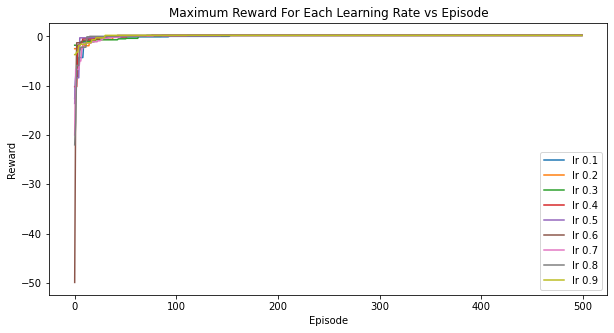

In [124]:
plt.figure(figsize=(10,5))
plt.plot(learning_rates_stats['aggr_ep_rewards'][0]['max'])
plt.plot(learning_rates_stats['aggr_ep_rewards'][1]['max'])
plt.plot(learning_rates_stats['aggr_ep_rewards'][2]['max'])
plt.plot(learning_rates_stats['aggr_ep_rewards'][3]['max'])
plt.plot(learning_rates_stats['aggr_ep_rewards'][4]['max'])
plt.plot(learning_rates_stats['aggr_ep_rewards'][5]['max'])
plt.plot(learning_rates_stats['aggr_ep_rewards'][6]['max'])
plt.plot(learning_rates_stats['aggr_ep_rewards'][7]['max'])
plt.plot(learning_rates_stats['aggr_ep_rewards'][8]['max'])
plt.title('Maximum Reward For Each Learning Rate vs Episode')
plt.ylabel('Reward')
plt.xlabel('Episode')
plt.legend(['lr 0.1', 'lr 0.2', 'lr 0.3', 'lr 0.4', 'lr 0.5', 'lr 0.6', 'lr 0.7', 'lr 0.8', 'lr 0.9'], loc='lower right')
plt.show()

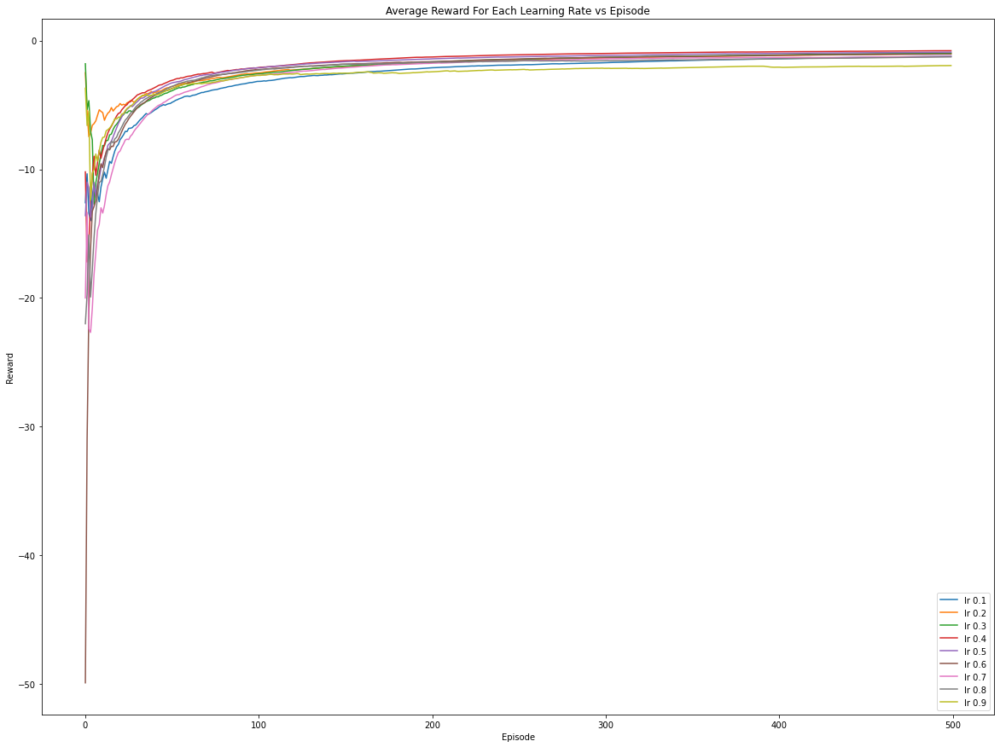

In [125]:
plt.figure(figsize=(20,15))
plt.plot(learning_rates_stats['aggr_ep_rewards'][0]['avg'])
plt.plot(learning_rates_stats['aggr_ep_rewards'][1]['avg'])
plt.plot(learning_rates_stats['aggr_ep_rewards'][2]['avg'])
plt.plot(learning_rates_stats['aggr_ep_rewards'][3]['avg'])
plt.plot(learning_rates_stats['aggr_ep_rewards'][4]['avg'])
plt.plot(learning_rates_stats['aggr_ep_rewards'][5]['avg'])
plt.plot(learning_rates_stats['aggr_ep_rewards'][6]['avg'])
plt.plot(learning_rates_stats['aggr_ep_rewards'][7]['avg'])
plt.plot(learning_rates_stats['aggr_ep_rewards'][8]['avg'])
plt.title('Average Reward For Each Learning Rate vs Episode')
plt.ylabel('Reward')
plt.xlabel('Episode')
plt.legend(['lr 0.1', 'lr 0.2', 'lr 0.3', 'lr 0.4', 'lr 0.5', 'lr 0.6', 'lr 0.7', 'lr 0.8', 'lr 0.9'], loc='lower right')
plt.show()

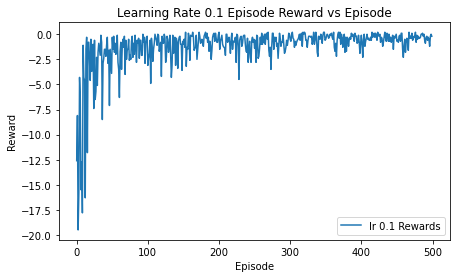

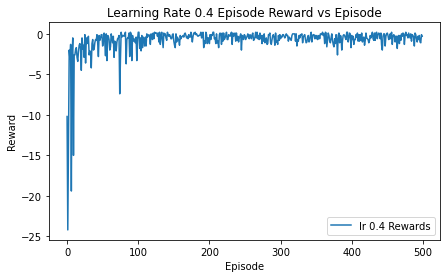

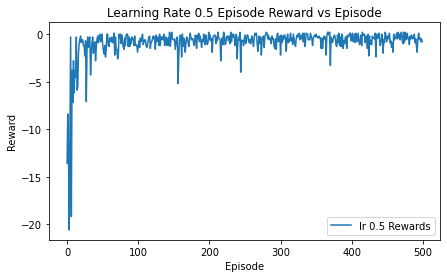

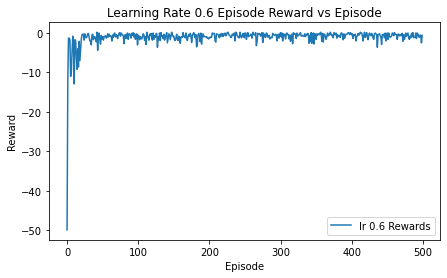

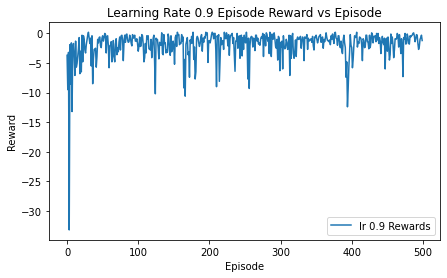

In [126]:
plt.figure(figsize=(7,4))
plt.plot(learning_rates_stats['ep_rewards'][0])
plt.title('Learning Rate 0.1 Episode Reward vs Episode')
plt.ylabel('Reward')
plt.xlabel('Episode')
plt.legend(['lr 0.1 Rewards'], loc='lower right')
plt.show()

plt.figure(figsize=(7,4))
plt.plot(learning_rates_stats['ep_rewards'][3])
plt.title('Learning Rate 0.4 Episode Reward vs Episode')
plt.ylabel('Reward')
plt.xlabel('Episode')
plt.legend(['lr 0.4 Rewards'], loc='lower right')
plt.show()

plt.figure(figsize=(7,4))
plt.plot(learning_rates_stats['ep_rewards'][4])
plt.title('Learning Rate 0.5 Episode Reward vs Episode')
plt.ylabel('Reward')
plt.xlabel('Episode')
plt.legend(['lr 0.5 Rewards'], loc='lower right')
plt.show()

plt.figure(figsize=(7,4))
plt.plot(learning_rates_stats['ep_rewards'][5])
plt.title('Learning Rate 0.6 Episode Reward vs Episode')
plt.ylabel('Reward')
plt.xlabel('Episode')
plt.legend(['lr 0.6 Rewards'], loc='lower right')
plt.show()

plt.figure(figsize=(7,4))
plt.plot(learning_rates_stats['ep_rewards'][8])
plt.title('Learning Rate 0.9 Episode Reward vs Episode')
plt.ylabel('Reward')
plt.xlabel('Episode')
plt.legend(['lr 0.9 Rewards'], loc='lower right')
plt.show()

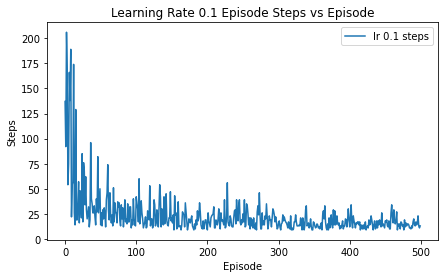

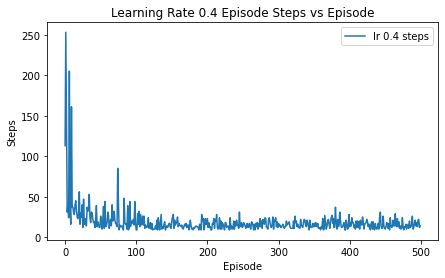

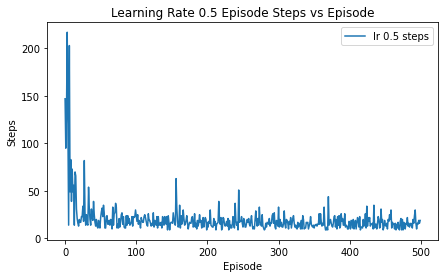

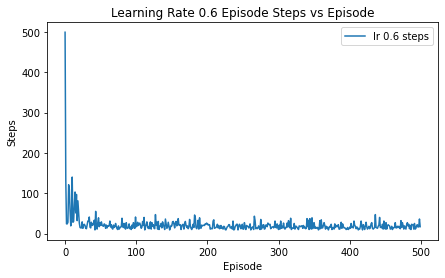

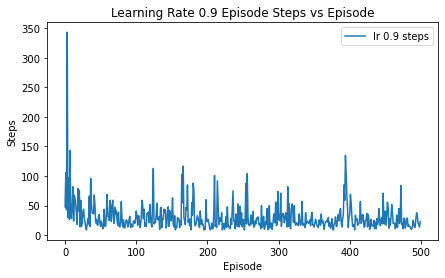

In [127]:
plt.figure(figsize=(7,4))
plt.plot(learning_rates_stats['ep_steps'][0])
plt.title('Learning Rate 0.1 Episode Steps vs Episode')
plt.ylabel('Steps')
plt.xlabel('Episode')
plt.legend(['lr 0.1 steps'], loc='upper right')
plt.show()

plt.figure(figsize=(7,4))
plt.plot(learning_rates_stats['ep_steps'][3])
plt.title('Learning Rate 0.4 Episode Steps vs Episode')
plt.ylabel('Steps')
plt.xlabel('Episode')
plt.legend(['lr 0.4 steps'], loc='upper right')
plt.show()

plt.figure(figsize=(7,4))
plt.plot(learning_rates_stats['ep_steps'][4])
plt.title('Learning Rate 0.5 Episode Steps vs Episode')
plt.ylabel('Steps')
plt.xlabel('Episode')
plt.legend(['lr 0.5 steps'], loc='upper right')
plt.show()

plt.figure(figsize=(7,4))
plt.plot(learning_rates_stats['ep_steps'][5])
plt.title('Learning Rate 0.6 Episode Steps vs Episode')
plt.ylabel('Steps')
plt.xlabel('Episode')
plt.legend(['lr 0.6 steps'], loc='upper right')
plt.show()

plt.figure(figsize=(7,4))
plt.plot(learning_rates_stats['ep_steps'][8])
plt.title('Learning Rate 0.9 Episode Steps vs Episode')
plt.ylabel('Steps')
plt.xlabel('Episode')
plt.legend(['lr 0.9 steps'], loc='upper right')
plt.show()

## Q Agent Choose Optimal Discount Factor

In [128]:
# Find optimal Discount Factor from [0.75,0.8,0.85,0.9,0.92,0.94,0.95,0.96,0.99] Discount Factors
class QAgent(object):
    def __init__(self, discount):
        self.learning_rate = 0.4
        self.discount = discount
        self.exploration_rate = 0.01
        self.action_space = ['left','right','forward','backward','up','down'] # in TreasureCube
        self.Q = np.zeros([64,6])

    def take_action(self, state):
        if np.random.random() > self.exploration_rate:
            # Get action from Q table
            print("current state: " + state)
            state = [int(d) for d in str(state)]
            state = state[0] + state[1]*4 + state[2]*16
            action = self.action_space[np.argmax(self.Q[state])]
        else:
            print("random action!!!")
            action = random.choice(self.action_space)
        return action

    # implement your train/update function to update self.V or self.Q
    # you should pass arguments to the train function
    def train(self, state, action, next_state, reward):
        state = [int(d) for d in str(state)]
        state = state[0] + state[1]*4 + state[2]*16
        
        next_state = [int(d) for d in str(next_state)]
        next_state = next_state[0] + next_state[1]*4 + next_state[2]*16
        
        # Maximum possible Q value in next step (for new state)
        max_future_q = np.max(self.Q[next_state])

        # Current Q value (for current state and performed action)
        current_q = self.Q[state,self.action_space.index(action)]

        # And here's our equation for a new Q value for current state and action
        new_q = (1 - self.learning_rate) * current_q + self.learning_rate * (reward + self.discount * max_future_q)

        # Update Q table with new Q value
        self.Q[state,self.action_space.index(action)] = new_q
        
    def q_table(self):
        return self.Q

def test_cube(max_episode, max_step):
    env = TreasureCube(max_step=max_step)
    discounts = [0.75,0.8,0.85,0.9,0.92,0.94,0.95,0.96,0.99]
    discounts_stats = {'lr': [], 'ep_rewards': [], 'aggr_ep_rewards': [], 'ep_steps': [], 'q_tables': []}
    for i in discounts:
        print("Discount: " + str(i))
        agent = QAgent(i)
        SHOW_EP = 100
        SHOW_STEP = 10
        # For stats
        ep_rewards = []
        aggr_ep_rewards = {'ep': [], 'avg': [], 'max': [], 'min': []}
        ep_steps = []

        for epsisode_num in range(0, max_episode):
            state = env.reset()
            terminate = False
            t = 0
            episode_reward = 0
            while not terminate:
                action = agent.take_action(state)
                reward, terminate, next_state = env.step(action)
                episode_reward += reward
                # you can comment the following two lines, if the output is too much
                #if epsisode_num % SHOW_EP == 0 and t % SHOW_STEP == 0:
                    #env.render() # comment
                print(f'discount: {i},epsisode: {epsisode_num},step: {t}, action: {action}, reward: {reward}') # comment
                t += 1
                agent.train(state, action, next_state, reward)
                state = next_state
            print(f'discount: {i},epsisode: {epsisode_num}, total_steps: {t} episode reward: {episode_reward}')
            ep_rewards.append(episode_reward)
            ep_steps.append(t)
            aggr_ep_rewards['ep'].append(epsisode_num)
            aggr_ep_rewards['avg'].append(sum(ep_rewards)/(epsisode_num+1))
            aggr_ep_rewards['max'].append(max(ep_rewards))
            aggr_ep_rewards['min'].append(min(ep_rewards))
            
        discounts_stats['lr'].append(i)
        discounts_stats['ep_rewards'].append(ep_rewards)
        discounts_stats['aggr_ep_rewards'].append(aggr_ep_rewards)
        discounts_stats['ep_steps'].append(ep_steps)
        discounts_stats['q_tables'].append(agent.q_table())
        
    return discounts_stats

In [158]:
discounts_stats = test_cube(500, 500)

Discount: 0.75
current state: 000
discount: 0.75,epsisode: 0,step: 0, action: left, reward: -0.1
current state: 001
discount: 0.75,epsisode: 0,step: 1, action: left, reward: -0.1
current state: 001
discount: 0.75,epsisode: 0,step: 2, action: right, reward: -0.1
current state: 101
discount: 0.75,epsisode: 0,step: 3, action: left, reward: -0.1
current state: 101
discount: 0.75,epsisode: 0,step: 4, action: right, reward: -0.1
current state: 001
discount: 0.75,epsisode: 0,step: 5, action: forward, reward: -0.1
current state: 101
discount: 0.75,epsisode: 0,step: 6, action: forward, reward: -0.1
current state: 201
discount: 0.75,epsisode: 0,step: 7, action: left, reward: -0.1
current state: 301
discount: 0.75,epsisode: 0,step: 8, action: left, reward: -0.1
current state: 301
discount: 0.75,epsisode: 0,step: 9, action: right, reward: -0.1
current state: 311
discount: 0.75,epsisode: 0,step: 10, action: left, reward: -0.1
current state: 301
discount: 0.75,epsisode: 0,step: 11, action: forward, 

discount: 0.75,epsisode: 18,step: 38, action: backward, reward: -0.1
current state: 130
discount: 0.75,epsisode: 18,step: 39, action: forward, reward: -0.1
current state: 230
discount: 0.75,epsisode: 18,step: 40, action: forward, reward: -0.1
current state: 330
discount: 0.75,epsisode: 18,step: 41, action: up, reward: -0.1
current state: 331
discount: 0.75,epsisode: 18,step: 42, action: up, reward: -0.1
current state: 332
discount: 0.75,epsisode: 18,step: 43, action: up, reward: -0.1
current state: 322
discount: 0.75,epsisode: 18,step: 44, action: up, reward: -0.1
current state: 332
discount: 0.75,epsisode: 18,step: 45, action: up, reward: 1
discount: 0.75,epsisode: 18, total_steps: 46 episode reward: -3.5
current state: 000
discount: 0.75,epsisode: 19,step: 0, action: up, reward: -0.1
current state: 001
discount: 0.75,epsisode: 19,step: 1, action: up, reward: -0.1
current state: 011
discount: 0.75,epsisode: 19,step: 2, action: down, reward: -0.1
current state: 111
discount: 0.75,epsis

discount: 0.75,epsisode: 66,step: 4, action: backward, reward: -0.1
current state: 012
discount: 0.75,epsisode: 66,step: 5, action: up, reward: -0.1
current state: 012
discount: 0.75,epsisode: 66,step: 6, action: down, reward: -0.1
current state: 011
discount: 0.75,epsisode: 66,step: 7, action: backward, reward: -0.1
current state: 011
discount: 0.75,epsisode: 66,step: 8, action: down, reward: -0.1
current state: 010
discount: 0.75,epsisode: 66,step: 9, action: right, reward: -0.1
current state: 020
discount: 0.75,epsisode: 66,step: 10, action: right, reward: -0.1
current state: 021
discount: 0.75,epsisode: 66,step: 11, action: forward, reward: -0.1
current state: 020
discount: 0.75,epsisode: 66,step: 12, action: up, reward: -0.1
current state: 021
discount: 0.75,epsisode: 66,step: 13, action: left, reward: -0.1
current state: 022
discount: 0.75,epsisode: 66,step: 14, action: forward, reward: -0.1
current state: 032
discount: 0.75,epsisode: 66,step: 15, action: up, reward: -0.1
current

current state: 202
discount: 0.75,epsisode: 128,step: 5, action: right, reward: -0.1
current state: 212
discount: 0.75,epsisode: 128,step: 6, action: forward, reward: -0.1
current state: 202
discount: 0.75,epsisode: 128,step: 7, action: right, reward: -0.1
current state: 203
discount: 0.75,epsisode: 128,step: 8, action: right, reward: -0.1
current state: 213
discount: 0.75,epsisode: 128,step: 9, action: forward, reward: -0.1
current state: 313
discount: 0.75,epsisode: 128,step: 10, action: right, reward: -0.1
current state: 323
discount: 0.75,epsisode: 128,step: 11, action: right, reward: 1
discount: 0.75,epsisode: 128, total_steps: 12 episode reward: -0.09999999999999987
current state: 000
discount: 0.75,epsisode: 129,step: 0, action: up, reward: -0.1
current state: 001
discount: 0.75,epsisode: 129,step: 1, action: up, reward: -0.1
current state: 001
discount: 0.75,epsisode: 129,step: 2, action: down, reward: -0.1
current state: 011
discount: 0.75,epsisode: 129,step: 3, action: forwar

discount: 0.75,epsisode: 197,step: 15, action: up, reward: -0.1
current state: 321
discount: 0.75,epsisode: 197,step: 16, action: right, reward: -0.1
current state: 320
discount: 0.75,epsisode: 197,step: 17, action: up, reward: -0.1
current state: 320
discount: 0.75,epsisode: 197,step: 18, action: up, reward: -0.1
current state: 321
discount: 0.75,epsisode: 197,step: 19, action: right, reward: -0.1
current state: 331
discount: 0.75,epsisode: 197,step: 20, action: up, reward: -0.1
current state: 332
discount: 0.75,epsisode: 197,step: 21, action: up, reward: -0.1
current state: 232
discount: 0.75,epsisode: 197,step: 22, action: up, reward: -0.1
current state: 233
discount: 0.75,epsisode: 197,step: 23, action: forward, reward: 1
discount: 0.75,epsisode: 197, total_steps: 24 episode reward: -1.3000000000000007
current state: 000
discount: 0.75,epsisode: 198,step: 0, action: right, reward: -0.1
current state: 010
discount: 0.75,epsisode: 198,step: 1, action: forward, reward: -0.1
current st

discount: 0.75,epsisode: 270,step: 18, action: up, reward: -0.1
current state: 222
discount: 0.75,epsisode: 270,step: 19, action: up, reward: -0.1
current state: 212
discount: 0.75,epsisode: 270,step: 20, action: up, reward: -0.1
current state: 112
discount: 0.75,epsisode: 270,step: 21, action: forward, reward: -0.1
current state: 212
discount: 0.75,epsisode: 270,step: 22, action: forward, reward: -0.1
current state: 312
discount: 0.75,epsisode: 270,step: 23, action: forward, reward: -0.1
current state: 302
discount: 0.75,epsisode: 270,step: 24, action: right, reward: -0.1
current state: 312
discount: 0.75,epsisode: 270,step: 25, action: forward, reward: -0.1
current state: 312
discount: 0.75,epsisode: 270,step: 26, action: forward, reward: -0.1
current state: 322
discount: 0.75,epsisode: 270,step: 27, action: right, reward: -0.1
current state: 322
discount: 0.75,epsisode: 270,step: 28, action: right, reward: -0.1
current state: 332
discount: 0.75,epsisode: 270,step: 29, action: up, re

discount: 0.75,epsisode: 335,step: 9, action: right, reward: -0.1
current state: 222
discount: 0.75,epsisode: 335,step: 10, action: up, reward: -0.1
current state: 223
discount: 0.75,epsisode: 335,step: 11, action: forward, reward: -0.1
current state: 223
discount: 0.75,epsisode: 335,step: 12, action: forward, reward: -0.1
current state: 233
discount: 0.75,epsisode: 335,step: 13, action: forward, reward: 1
discount: 0.75,epsisode: 335, total_steps: 14 episode reward: -0.30000000000000004
current state: 000
discount: 0.75,epsisode: 336,step: 0, action: right, reward: -0.1
current state: 000
discount: 0.75,epsisode: 336,step: 1, action: right, reward: -0.1
current state: 010
discount: 0.75,epsisode: 336,step: 2, action: forward, reward: -0.1
current state: 110
discount: 0.75,epsisode: 336,step: 3, action: up, reward: -0.1
current state: 100
discount: 0.75,epsisode: 336,step: 4, action: forward, reward: -0.1
current state: 100
discount: 0.75,epsisode: 336,step: 5, action: forward, reward:

current state: 000
discount: 0.75,epsisode: 417,step: 2, action: up, reward: -0.1
current state: 001
discount: 0.75,epsisode: 417,step: 3, action: forward, reward: -0.1
current state: 011
discount: 0.75,epsisode: 417,step: 4, action: forward, reward: -0.1
current state: 111
discount: 0.75,epsisode: 417,step: 5, action: forward, reward: -0.1
current state: 211
discount: 0.75,epsisode: 417,step: 6, action: forward, reward: -0.1
current state: 212
discount: 0.75,epsisode: 417,step: 7, action: up, reward: -0.1
current state: 213
discount: 0.75,epsisode: 417,step: 8, action: right, reward: -0.1
current state: 223
discount: 0.75,epsisode: 417,step: 9, action: forward, reward: -0.1
current state: 323
discount: 0.75,epsisode: 417,step: 10, action: right, reward: 1
discount: 0.75,epsisode: 417, total_steps: 11 episode reward: 1.1102230246251565e-16
current state: 000
discount: 0.75,epsisode: 418,step: 0, action: up, reward: -0.1
current state: 001
discount: 0.75,epsisode: 418,step: 1, action: f

current state: 332
discount: 0.75,epsisode: 491,step: 28, action: up, reward: 1
discount: 0.75,epsisode: 491, total_steps: 29 episode reward: -1.8000000000000012
current state: 000
discount: 0.75,epsisode: 492,step: 0, action: right, reward: -0.1
current state: 000
discount: 0.75,epsisode: 492,step: 1, action: right, reward: -0.1
current state: 010
discount: 0.75,epsisode: 492,step: 2, action: forward, reward: -0.1
current state: 110
discount: 0.75,epsisode: 492,step: 3, action: forward, reward: -0.1
current state: 120
discount: 0.75,epsisode: 492,step: 4, action: up, reward: -0.1
current state: 220
discount: 0.75,epsisode: 492,step: 5, action: up, reward: -0.1
current state: 120
discount: 0.75,epsisode: 492,step: 6, action: up, reward: -0.1
current state: 121
discount: 0.75,epsisode: 492,step: 7, action: right, reward: -0.1
current state: 122
discount: 0.75,epsisode: 492,step: 8, action: right, reward: -0.1
current state: 022
discount: 0.75,epsisode: 492,step: 9, action: up, reward: -

discount: 0.8,epsisode: 13,step: 14, action: up, reward: -0.1
current state: 002
discount: 0.8,epsisode: 13,step: 15, action: forward, reward: -0.1
current state: 003
discount: 0.8,epsisode: 13,step: 16, action: backward, reward: -0.1
current state: 003
discount: 0.8,epsisode: 13,step: 17, action: up, reward: -0.1
current state: 003
discount: 0.8,epsisode: 13,step: 18, action: down, reward: -0.1
current state: 002
discount: 0.8,epsisode: 13,step: 19, action: backward, reward: -0.1
current state: 002
discount: 0.8,epsisode: 13,step: 20, action: up, reward: -0.1
current state: 002
discount: 0.8,epsisode: 13,step: 21, action: forward, reward: -0.1
current state: 002
discount: 0.8,epsisode: 13,step: 22, action: left, reward: -0.1
current state: 002
discount: 0.8,epsisode: 13,step: 23, action: down, reward: -0.1
current state: 001
discount: 0.8,epsisode: 13,step: 24, action: backward, reward: -0.1
current state: 000
discount: 0.8,epsisode: 13,step: 25, action: right, reward: -0.1
current st

discount: 0.8,epsisode: 52,step: 18, action: right, reward: -0.1
current state: 331
discount: 0.8,epsisode: 52,step: 19, action: up, reward: -0.1
current state: 332
discount: 0.8,epsisode: 52,step: 20, action: right, reward: -0.1
current state: 232
discount: 0.8,epsisode: 52,step: 21, action: forward, reward: -0.1
current state: 233
discount: 0.8,epsisode: 52,step: 22, action: forward, reward: -0.1
current state: 232
discount: 0.8,epsisode: 52,step: 23, action: forward, reward: -0.1
current state: 231
discount: 0.8,epsisode: 52,step: 24, action: forward, reward: -0.1
current state: 331
discount: 0.8,epsisode: 52,step: 25, action: up, reward: -0.1
current state: 332
discount: 0.8,epsisode: 52,step: 26, action: right, reward: -0.1
current state: 332
discount: 0.8,epsisode: 52,step: 27, action: right, reward: -0.1
current state: 332
discount: 0.8,epsisode: 52,step: 28, action: right, reward: -0.1
current state: 332
discount: 0.8,epsisode: 52,step: 29, action: right, reward: 1
discount: 0.

current state: 231
discount: 0.8,epsisode: 97,step: 18, action: left, reward: -0.1
current state: 221
discount: 0.8,epsisode: 97,step: 19, action: up, reward: -0.1
current state: 222
discount: 0.8,epsisode: 97,step: 20, action: up, reward: -0.1
current state: 212
discount: 0.8,epsisode: 97,step: 21, action: up, reward: -0.1
current state: 202
discount: 0.8,epsisode: 97,step: 22, action: forward, reward: -0.1
current state: 212
discount: 0.8,epsisode: 97,step: 23, action: right, reward: -0.1
current state: 222
discount: 0.8,epsisode: 97,step: 24, action: backward, reward: -0.1
current state: 221
discount: 0.8,epsisode: 97,step: 25, action: up, reward: -0.1
current state: 211
discount: 0.8,epsisode: 97,step: 26, action: right, reward: -0.1
current state: 221
discount: 0.8,epsisode: 97,step: 27, action: up, reward: -0.1
current state: 222
discount: 0.8,epsisode: 97,step: 28, action: right, reward: -0.1
current state: 232
discount: 0.8,epsisode: 97,step: 29, action: up, reward: -0.1
curren

discount: 0.8,epsisode: 150, total_steps: 21 episode reward: -1.0000000000000004
current state: 000
discount: 0.8,epsisode: 151,step: 0, action: forward, reward: -0.1
current state: 100
discount: 0.8,epsisode: 151,step: 1, action: forward, reward: -0.1
current state: 200
discount: 0.8,epsisode: 151,step: 2, action: backward, reward: -0.1
current state: 100
discount: 0.8,epsisode: 151,step: 3, action: forward, reward: -0.1
current state: 200
discount: 0.8,epsisode: 151,step: 4, action: down, reward: -0.1
current state: 200
discount: 0.8,epsisode: 151,step: 5, action: right, reward: -0.1
current state: 201
discount: 0.8,epsisode: 151,step: 6, action: forward, reward: -0.1
current state: 301
discount: 0.8,epsisode: 151,step: 7, action: up, reward: -0.1
current state: 302
discount: 0.8,epsisode: 151,step: 8, action: right, reward: -0.1
current state: 302
discount: 0.8,epsisode: 151,step: 9, action: down, reward: -0.1
current state: 301
discount: 0.8,epsisode: 151,step: 10, action: up, rewa

discount: 0.8,epsisode: 223,step: 12, action: right, reward: 1
discount: 0.8,epsisode: 223, total_steps: 13 episode reward: -0.19999999999999996
current state: 000
discount: 0.8,epsisode: 224,step: 0, action: forward, reward: -0.1
current state: 010
discount: 0.8,epsisode: 224,step: 1, action: right, reward: -0.1
current state: 011
discount: 0.8,epsisode: 224,step: 2, action: up, reward: -0.1
current state: 012
discount: 0.8,epsisode: 224,step: 3, action: forward, reward: -0.1
current state: 112
discount: 0.8,epsisode: 224,step: 4, action: forward, reward: -0.1
current state: 212
discount: 0.8,epsisode: 224,step: 5, action: forward, reward: -0.1
current state: 202
discount: 0.8,epsisode: 224,step: 6, action: up, reward: -0.1
current state: 203
discount: 0.8,epsisode: 224,step: 7, action: forward, reward: -0.1
current state: 203
discount: 0.8,epsisode: 224,step: 8, action: forward, reward: -0.1
current state: 203
discount: 0.8,epsisode: 224,step: 9, action: up, reward: -0.1
current stat

current state: 010
discount: 0.8,epsisode: 297,step: 2, action: forward, reward: -0.1
current state: 011
discount: 0.8,epsisode: 297,step: 3, action: backward, reward: -0.1
current state: 011
discount: 0.8,epsisode: 297,step: 4, action: backward, reward: -0.1
current state: 010
discount: 0.8,epsisode: 297,step: 5, action: forward, reward: -0.1
current state: 110
discount: 0.8,epsisode: 297,step: 6, action: forward, reward: -0.1
current state: 210
discount: 0.8,epsisode: 297,step: 7, action: right, reward: -0.1
current state: 210
discount: 0.8,epsisode: 297,step: 8, action: right, reward: -0.1
current state: 220
discount: 0.8,epsisode: 297,step: 9, action: up, reward: -0.1
current state: 210
discount: 0.8,epsisode: 297,step: 10, action: right, reward: -0.1
current state: 220
discount: 0.8,epsisode: 297,step: 11, action: up, reward: -0.1
current state: 221
discount: 0.8,epsisode: 297,step: 12, action: up, reward: -0.1
current state: 222
discount: 0.8,epsisode: 297,step: 13, action: right

discount: 0.8,epsisode: 366,step: 15, action: right, reward: -0.1
current state: 232
discount: 0.8,epsisode: 366,step: 16, action: up, reward: -0.1
current state: 332
discount: 0.8,epsisode: 366,step: 17, action: up, reward: 1
discount: 0.8,epsisode: 366, total_steps: 18 episode reward: -0.7000000000000004
current state: 000
discount: 0.8,epsisode: 367,step: 0, action: up, reward: -0.1
current state: 010
discount: 0.8,epsisode: 367,step: 1, action: up, reward: -0.1
current state: 020
discount: 0.8,epsisode: 367,step: 2, action: up, reward: -0.1
current state: 021
discount: 0.8,epsisode: 367,step: 3, action: up, reward: -0.1
current state: 031
discount: 0.8,epsisode: 367,step: 4, action: up, reward: -0.1
current state: 131
discount: 0.8,epsisode: 367,step: 5, action: up, reward: -0.1
current state: 121
discount: 0.8,epsisode: 367,step: 6, action: forward, reward: -0.1
current state: 221
discount: 0.8,epsisode: 367,step: 7, action: up, reward: -0.1
current state: 222
discount: 0.8,epsiso

discount: 0.8,epsisode: 439, total_steps: 18 episode reward: -0.7000000000000004
current state: 000
discount: 0.8,epsisode: 440,step: 0, action: right, reward: -0.1
current state: 010
discount: 0.8,epsisode: 440,step: 1, action: right, reward: -0.1
current state: 020
discount: 0.8,epsisode: 440,step: 2, action: forward, reward: -0.1
current state: 030
discount: 0.8,epsisode: 440,step: 3, action: up, reward: -0.1
current state: 031
discount: 0.8,epsisode: 440,step: 4, action: up, reward: -0.1
current state: 021
discount: 0.8,epsisode: 440,step: 5, action: up, reward: -0.1
current state: 022
discount: 0.8,epsisode: 440,step: 6, action: forward, reward: -0.1
current state: 122
discount: 0.8,epsisode: 440,step: 7, action: forward, reward: -0.1
current state: 222
discount: 0.8,epsisode: 440,step: 8, action: forward, reward: -0.1
current state: 322
discount: 0.8,epsisode: 440,step: 9, action: up, reward: -0.1
current state: 322
discount: 0.8,epsisode: 440,step: 10, action: up, reward: -0.1
c

current state: 230
discount: 0.85,epsisode: 1,step: 80, action: backward, reward: -0.1
current state: 130
discount: 0.85,epsisode: 1,step: 81, action: right, reward: -0.1
current state: 230
discount: 0.85,epsisode: 1,step: 82, action: up, reward: -0.1
current state: 231
discount: 0.85,epsisode: 1,step: 83, action: up, reward: -0.1
current state: 232
discount: 0.85,epsisode: 1,step: 84, action: left, reward: -0.1
current state: 231
discount: 0.85,epsisode: 1,step: 85, action: down, reward: -0.1
current state: 331
discount: 0.85,epsisode: 1,step: 86, action: backward, reward: -0.1
current state: 231
discount: 0.85,epsisode: 1,step: 87, action: left, reward: -0.1
current state: 331
discount: 0.85,epsisode: 1,step: 88, action: up, reward: -0.1
current state: 332
discount: 0.85,epsisode: 1,step: 89, action: left, reward: -0.1
current state: 331
discount: 0.85,epsisode: 1,step: 90, action: down, reward: -0.1
current state: 331
discount: 0.85,epsisode: 1,step: 91, action: left, reward: -0.1
c

current state: 010
discount: 0.85,epsisode: 25,step: 13, action: right, reward: -0.1
current state: 020
discount: 0.85,epsisode: 25,step: 14, action: left, reward: -0.1
current state: 021
discount: 0.85,epsisode: 25,step: 15, action: down, reward: -0.1
current state: 020
discount: 0.85,epsisode: 25,step: 16, action: right, reward: -0.1
current state: 030
discount: 0.85,epsisode: 25,step: 17, action: right, reward: -0.1
current state: 030
discount: 0.85,epsisode: 25,step: 18, action: down, reward: -0.1
current state: 030
discount: 0.85,epsisode: 25,step: 19, action: backward, reward: -0.1
current state: 030
discount: 0.85,epsisode: 25,step: 20, action: up, reward: -0.1
current state: 031
discount: 0.85,epsisode: 25,step: 21, action: backward, reward: -0.1
random action!!!
discount: 0.85,epsisode: 25,step: 22, action: down, reward: -0.1
current state: 030
discount: 0.85,epsisode: 25,step: 23, action: forward, reward: -0.1
current state: 130
discount: 0.85,epsisode: 25,step: 24, action: f

current state: 000
discount: 0.85,epsisode: 78,step: 0, action: up, reward: -0.1
current state: 001
discount: 0.85,epsisode: 78,step: 1, action: right, reward: -0.1
current state: 011
discount: 0.85,epsisode: 78,step: 2, action: forward, reward: -0.1
current state: 001
discount: 0.85,epsisode: 78,step: 3, action: right, reward: -0.1
current state: 011
discount: 0.85,epsisode: 78,step: 4, action: right, reward: -0.1
current state: 011
discount: 0.85,epsisode: 78,step: 5, action: up, reward: -0.1
current state: 021
discount: 0.85,epsisode: 78,step: 6, action: forward, reward: -0.1
current state: 121
discount: 0.85,epsisode: 78,step: 7, action: right, reward: -0.1
current state: 131
discount: 0.85,epsisode: 78,step: 8, action: up, reward: -0.1
current state: 132
discount: 0.85,epsisode: 78,step: 9, action: forward, reward: -0.1
current state: 232
discount: 0.85,epsisode: 78,step: 10, action: up, reward: -0.1
current state: 233
discount: 0.85,epsisode: 78,step: 11, action: forward, reward:

current state: 332
discount: 0.85,epsisode: 149,step: 26, action: up, reward: -0.1
current state: 332
discount: 0.85,epsisode: 149,step: 27, action: up, reward: 1
discount: 0.85,epsisode: 149, total_steps: 28 episode reward: -1.700000000000001
current state: 000
discount: 0.85,epsisode: 150,step: 0, action: up, reward: -0.1
current state: 001
discount: 0.85,epsisode: 150,step: 1, action: up, reward: -0.1
current state: 002
discount: 0.85,epsisode: 150,step: 2, action: right, reward: -0.1
current state: 001
discount: 0.85,epsisode: 150,step: 3, action: up, reward: -0.1
current state: 011
discount: 0.85,epsisode: 150,step: 4, action: right, reward: -0.1
current state: 012
discount: 0.85,epsisode: 150,step: 5, action: right, reward: -0.1
current state: 022
discount: 0.85,epsisode: 150,step: 6, action: up, reward: -0.1
current state: 023
discount: 0.85,epsisode: 150,step: 7, action: right, reward: -0.1
current state: 033
discount: 0.85,epsisode: 150,step: 8, action: forward, reward: -0.1
c

current state: 311
discount: 0.85,epsisode: 233,step: 5, action: right, reward: -0.1
current state: 312
discount: 0.85,epsisode: 233,step: 6, action: forward, reward: -0.1
current state: 312
discount: 0.85,epsisode: 233,step: 7, action: forward, reward: -0.1
current state: 312
discount: 0.85,epsisode: 233,step: 8, action: forward, reward: -0.1
current state: 312
discount: 0.85,epsisode: 233,step: 9, action: forward, reward: -0.1
current state: 312
discount: 0.85,epsisode: 233,step: 10, action: forward, reward: -0.1
current state: 312
discount: 0.85,epsisode: 233,step: 11, action: forward, reward: -0.1
current state: 313
discount: 0.85,epsisode: 233,step: 12, action: right, reward: -0.1
current state: 323
discount: 0.85,epsisode: 233,step: 13, action: backward, reward: -0.1
current state: 322
discount: 0.85,epsisode: 233,step: 14, action: right, reward: -0.1
current state: 332
discount: 0.85,epsisode: 233,step: 15, action: up, reward: 1
discount: 0.85,epsisode: 233, total_steps: 16 epis

current state: 132
discount: 0.85,epsisode: 301,step: 9, action: forward, reward: -0.1
current state: 133
discount: 0.85,epsisode: 301,step: 10, action: down, reward: -0.1
current state: 132
discount: 0.85,epsisode: 301,step: 11, action: forward, reward: -0.1
current state: 232
discount: 0.85,epsisode: 301,step: 12, action: up, reward: -0.1
current state: 232
discount: 0.85,epsisode: 301,step: 13, action: up, reward: -0.1
current state: 233
discount: 0.85,epsisode: 301,step: 14, action: forward, reward: 1
discount: 0.85,epsisode: 301, total_steps: 15 episode reward: -0.40000000000000013
current state: 000
discount: 0.85,epsisode: 302,step: 0, action: right, reward: -0.1
current state: 010
discount: 0.85,epsisode: 302,step: 1, action: right, reward: -0.1
current state: 020
discount: 0.85,epsisode: 302,step: 2, action: up, reward: -0.1
current state: 021
discount: 0.85,epsisode: 302,step: 3, action: right, reward: -0.1
current state: 020
discount: 0.85,epsisode: 302,step: 4, action: up, 

current state: 332
discount: 0.85,epsisode: 373,step: 25, action: up, reward: 1
discount: 0.85,epsisode: 373, total_steps: 26 episode reward: -1.5000000000000009
current state: 000
discount: 0.85,epsisode: 374,step: 0, action: right, reward: -0.1
current state: 000
discount: 0.85,epsisode: 374,step: 1, action: right, reward: -0.1
current state: 010
discount: 0.85,epsisode: 374,step: 2, action: forward, reward: -0.1
current state: 110
discount: 0.85,epsisode: 374,step: 3, action: right, reward: -0.1
current state: 120
discount: 0.85,epsisode: 374,step: 4, action: up, reward: -0.1
current state: 121
discount: 0.85,epsisode: 374,step: 5, action: forward, reward: -0.1
current state: 111
discount: 0.85,epsisode: 374,step: 6, action: up, reward: -0.1
current state: 112
discount: 0.85,epsisode: 374,step: 7, action: backward, reward: -0.1
current state: 122
discount: 0.85,epsisode: 374,step: 8, action: right, reward: -0.1
current state: 132
discount: 0.85,epsisode: 374,step: 9, action: forward

current state: 233
discount: 0.85,epsisode: 453,step: 12, action: forward, reward: 1
discount: 0.85,epsisode: 453, total_steps: 13 episode reward: -0.19999999999999996
current state: 000
discount: 0.85,epsisode: 454,step: 0, action: forward, reward: -0.1
random action!!!
discount: 0.85,epsisode: 454,step: 1, action: down, reward: -0.1
current state: 100
discount: 0.85,epsisode: 454,step: 2, action: up, reward: -0.1
current state: 101
discount: 0.85,epsisode: 454,step: 3, action: up, reward: -0.1
current state: 102
discount: 0.85,epsisode: 454,step: 4, action: right, reward: -0.1
current state: 112
discount: 0.85,epsisode: 454,step: 5, action: up, reward: -0.1
current state: 113
discount: 0.85,epsisode: 454,step: 6, action: backward, reward: -0.1
current state: 013
discount: 0.85,epsisode: 454,step: 7, action: right, reward: -0.1
current state: 113
discount: 0.85,epsisode: 454,step: 8, action: backward, reward: -0.1
current state: 013
discount: 0.85,epsisode: 454,step: 9, action: right,

current state: 000
discount: 0.9,epsisode: 2,step: 367, action: right, reward: -0.1
current state: 010
discount: 0.9,epsisode: 2,step: 368, action: up, reward: -0.1
current state: 011
discount: 0.9,epsisode: 2,step: 369, action: backward, reward: -0.1
current state: 011
discount: 0.9,epsisode: 2,step: 370, action: down, reward: -0.1
random action!!!
discount: 0.9,epsisode: 2,step: 371, action: down, reward: -0.1
current state: 000
discount: 0.9,epsisode: 2,step: 372, action: up, reward: -0.1
current state: 000
discount: 0.9,epsisode: 2,step: 373, action: down, reward: -0.1
current state: 000
discount: 0.9,epsisode: 2,step: 374, action: forward, reward: -0.1
current state: 100
discount: 0.9,epsisode: 2,step: 375, action: backward, reward: -0.1
current state: 100
discount: 0.9,epsisode: 2,step: 376, action: down, reward: -0.1
current state: 200
discount: 0.9,epsisode: 2,step: 377, action: forward, reward: -0.1
current state: 300
discount: 0.9,epsisode: 2,step: 378, action: right, reward:

current state: 000
discount: 0.9,epsisode: 31,step: 12, action: right, reward: -0.1
current state: 010
discount: 0.9,epsisode: 31,step: 13, action: down, reward: -0.1
current state: 010
discount: 0.9,epsisode: 31,step: 14, action: forward, reward: -0.1
current state: 000
discount: 0.9,epsisode: 31,step: 15, action: right, reward: -0.1
current state: 000
discount: 0.9,epsisode: 31,step: 16, action: left, reward: -0.1
current state: 100
discount: 0.9,epsisode: 31,step: 17, action: down, reward: -0.1
current state: 100
discount: 0.9,epsisode: 31,step: 18, action: right, reward: -0.1
current state: 110
discount: 0.9,epsisode: 31,step: 19, action: forward, reward: -0.1
current state: 210
discount: 0.9,epsisode: 31,step: 20, action: right, reward: -0.1
current state: 210
discount: 0.9,epsisode: 31,step: 21, action: up, reward: -0.1
current state: 211
discount: 0.9,epsisode: 31,step: 22, action: forward, reward: -0.1
current state: 212
discount: 0.9,epsisode: 31,step: 23, action: right, rewar

discount: 0.9,epsisode: 86,step: 11, action: forward, reward: -0.1
current state: 123
discount: 0.9,epsisode: 86,step: 12, action: forward, reward: -0.1
current state: 113
discount: 0.9,epsisode: 86,step: 13, action: forward, reward: -0.1
current state: 213
discount: 0.9,epsisode: 86,step: 14, action: right, reward: -0.1
current state: 223
discount: 0.9,epsisode: 86,step: 15, action: right, reward: -0.1
current state: 222
discount: 0.9,epsisode: 86,step: 16, action: right, reward: -0.1
current state: 232
discount: 0.9,epsisode: 86,step: 17, action: up, reward: -0.1
current state: 233
discount: 0.9,epsisode: 86,step: 18, action: forward, reward: 1
discount: 0.9,epsisode: 86, total_steps: 19 episode reward: -0.8000000000000005
current state: 000
discount: 0.9,epsisode: 87,step: 0, action: right, reward: -0.1
current state: 010
discount: 0.9,epsisode: 87,step: 1, action: forward, reward: -0.1
current state: 110
discount: 0.9,epsisode: 87,step: 2, action: up, reward: -0.1
current state: 11

current state: 132
discount: 0.9,epsisode: 158,step: 9, action: up, reward: -0.1
current state: 132
discount: 0.9,epsisode: 158,step: 10, action: up, reward: -0.1
current state: 133
discount: 0.9,epsisode: 158,step: 11, action: forward, reward: -0.1
current state: 132
discount: 0.9,epsisode: 158,step: 12, action: up, reward: -0.1
current state: 133
discount: 0.9,epsisode: 158,step: 13, action: forward, reward: -0.1
current state: 233
discount: 0.9,epsisode: 158,step: 14, action: forward, reward: 1
discount: 0.9,epsisode: 158, total_steps: 15 episode reward: -0.40000000000000013
current state: 000
discount: 0.9,epsisode: 159,step: 0, action: forward, reward: -0.1
current state: 100
discount: 0.9,epsisode: 159,step: 1, action: up, reward: -0.1
current state: 200
discount: 0.9,epsisode: 159,step: 2, action: right, reward: -0.1
current state: 210
discount: 0.9,epsisode: 159,step: 3, action: right, reward: -0.1
current state: 220
discount: 0.9,epsisode: 159,step: 4, action: right, reward: -

random action!!!
discount: 0.9,epsisode: 240,step: 7, action: forward, reward: -0.1
current state: 103
discount: 0.9,epsisode: 240,step: 8, action: forward, reward: -0.1
current state: 203
discount: 0.9,epsisode: 240,step: 9, action: right, reward: -0.1
current state: 213
discount: 0.9,epsisode: 240,step: 10, action: right, reward: -0.1
current state: 213
discount: 0.9,epsisode: 240,step: 11, action: right, reward: -0.1
current state: 223
discount: 0.9,epsisode: 240,step: 12, action: right, reward: -0.1
current state: 223
discount: 0.9,epsisode: 240,step: 13, action: right, reward: -0.1
current state: 233
discount: 0.9,epsisode: 240,step: 14, action: forward, reward: -0.1
current state: 223
discount: 0.9,epsisode: 240,step: 15, action: right, reward: -0.1
current state: 222
discount: 0.9,epsisode: 240,step: 16, action: right, reward: -0.1
current state: 232
discount: 0.9,epsisode: 240,step: 17, action: up, reward: -0.1
random action!!!
discount: 0.9,epsisode: 240,step: 18, action: forw

discount: 0.9,epsisode: 313,step: 8, action: right, reward: -0.1
current state: 113
discount: 0.9,epsisode: 313,step: 9, action: forward, reward: -0.1
current state: 213
discount: 0.9,epsisode: 313,step: 10, action: right, reward: -0.1
current state: 223
discount: 0.9,epsisode: 313,step: 11, action: right, reward: -0.1
current state: 323
discount: 0.9,epsisode: 313,step: 12, action: right, reward: 1
discount: 0.9,epsisode: 313, total_steps: 13 episode reward: -0.19999999999999996
current state: 000
discount: 0.9,epsisode: 314,step: 0, action: forward, reward: -0.1
current state: 100
discount: 0.9,epsisode: 314,step: 1, action: forward, reward: -0.1
current state: 200
discount: 0.9,epsisode: 314,step: 2, action: forward, reward: -0.1
current state: 200
discount: 0.9,epsisode: 314,step: 3, action: forward, reward: -0.1
current state: 300
discount: 0.9,epsisode: 314,step: 4, action: right, reward: -0.1
current state: 301
discount: 0.9,epsisode: 314,step: 5, action: up, reward: -0.1
curren

discount: 0.9,epsisode: 391,step: 13, action: up, reward: 1
discount: 0.9,epsisode: 391, total_steps: 14 episode reward: -0.30000000000000004
current state: 000
discount: 0.9,epsisode: 392,step: 0, action: forward, reward: -0.1
current state: 100
discount: 0.9,epsisode: 392,step: 1, action: forward, reward: -0.1
current state: 200
discount: 0.9,epsisode: 392,step: 2, action: forward, reward: -0.1
current state: 300
discount: 0.9,epsisode: 392,step: 3, action: left, reward: -0.1
current state: 200
discount: 0.9,epsisode: 392,step: 4, action: forward, reward: -0.1
current state: 300
discount: 0.9,epsisode: 392,step: 5, action: left, reward: -0.1
current state: 200
discount: 0.9,epsisode: 392,step: 6, action: forward, reward: -0.1
random action!!!
discount: 0.9,epsisode: 392,step: 7, action: backward, reward: -0.1
current state: 220
discount: 0.9,epsisode: 392,step: 8, action: forward, reward: -0.1
current state: 320
discount: 0.9,epsisode: 392,step: 9, action: right, reward: -0.1
current

current state: 213
discount: 0.9,epsisode: 470,step: 6, action: right, reward: -0.1
current state: 223
discount: 0.9,epsisode: 470,step: 7, action: right, reward: -0.1
current state: 233
discount: 0.9,epsisode: 470,step: 8, action: forward, reward: 1
discount: 0.9,epsisode: 470, total_steps: 9 episode reward: 0.20000000000000007
current state: 000
discount: 0.9,epsisode: 471,step: 0, action: forward, reward: -0.1
current state: 010
discount: 0.9,epsisode: 471,step: 1, action: right, reward: -0.1
current state: 020
discount: 0.9,epsisode: 471,step: 2, action: right, reward: -0.1
current state: 030
discount: 0.9,epsisode: 471,step: 3, action: forward, reward: -0.1
current state: 130
discount: 0.9,epsisode: 471,step: 4, action: up, reward: -0.1
current state: 131
discount: 0.9,epsisode: 471,step: 5, action: forward, reward: -0.1
current state: 231
discount: 0.9,epsisode: 471,step: 6, action: forward, reward: -0.1
current state: 231
discount: 0.9,epsisode: 471,step: 7, action: forward, rew

current state: 011
discount: 0.92,epsisode: 11,step: 14, action: backward, reward: -0.1
current state: 001
discount: 0.92,epsisode: 11,step: 15, action: right, reward: -0.1
current state: 000
discount: 0.92,epsisode: 11,step: 16, action: backward, reward: -0.1
current state: 000
discount: 0.92,epsisode: 11,step: 17, action: forward, reward: -0.1
current state: 100
discount: 0.92,epsisode: 11,step: 18, action: right, reward: -0.1
current state: 110
discount: 0.92,epsisode: 11,step: 19, action: left, reward: -0.1
current state: 110
discount: 0.92,epsisode: 11,step: 20, action: down, reward: -0.1
current state: 110
discount: 0.92,epsisode: 11,step: 21, action: right, reward: -0.1
current state: 210
discount: 0.92,epsisode: 11,step: 22, action: forward, reward: -0.1
current state: 310
discount: 0.92,epsisode: 11,step: 23, action: left, reward: -0.1
random action!!!
discount: 0.92,epsisode: 11,step: 24, action: backward, reward: -0.1
current state: 300
discount: 0.92,epsisode: 11,step: 25, 

current state: 010
discount: 0.92,epsisode: 52,step: 2, action: forward, reward: -0.1
current state: 000
discount: 0.92,epsisode: 52,step: 3, action: right, reward: -0.1
current state: 010
discount: 0.92,epsisode: 52,step: 4, action: down, reward: -0.1
current state: 010
discount: 0.92,epsisode: 52,step: 5, action: backward, reward: -0.1
current state: 010
discount: 0.92,epsisode: 52,step: 6, action: up, reward: -0.1
current state: 011
discount: 0.92,epsisode: 52,step: 7, action: down, reward: -0.1
current state: 021
discount: 0.92,epsisode: 52,step: 8, action: up, reward: -0.1
current state: 022
discount: 0.92,epsisode: 52,step: 9, action: forward, reward: -0.1
current state: 023
discount: 0.92,epsisode: 52,step: 10, action: forward, reward: -0.1
current state: 013
discount: 0.92,epsisode: 52,step: 11, action: forward, reward: -0.1
current state: 113
discount: 0.92,epsisode: 52,step: 12, action: right, reward: -0.1
current state: 123
discount: 0.92,epsisode: 52,step: 13, action: forwa

discount: 0.92,epsisode: 112,step: 14, action: forward, reward: -0.1
current state: 221
discount: 0.92,epsisode: 112,step: 15, action: forward, reward: -0.1
current state: 321
discount: 0.92,epsisode: 112,step: 16, action: up, reward: -0.1
current state: 322
discount: 0.92,epsisode: 112,step: 17, action: up, reward: -0.1
current state: 323
discount: 0.92,epsisode: 112,step: 18, action: right, reward: 1
discount: 0.92,epsisode: 112, total_steps: 19 episode reward: -0.8000000000000005
current state: 000
discount: 0.92,epsisode: 113,step: 0, action: forward, reward: -0.1
current state: 000
discount: 0.92,epsisode: 113,step: 1, action: down, reward: -0.1
current state: 100
discount: 0.92,epsisode: 113,step: 2, action: down, reward: -0.1
current state: 000
discount: 0.92,epsisode: 113,step: 3, action: down, reward: -0.1
current state: 000
discount: 0.92,epsisode: 113,step: 4, action: left, reward: -0.1
current state: 000
discount: 0.92,epsisode: 113,step: 5, action: right, reward: -0.1
curr

discount: 0.92,epsisode: 181,step: 4, action: forward, reward: -0.1
current state: 203
discount: 0.92,epsisode: 181,step: 5, action: right, reward: -0.1
current state: 213
discount: 0.92,epsisode: 181,step: 6, action: right, reward: -0.1
current state: 223
discount: 0.92,epsisode: 181,step: 7, action: forward, reward: -0.1
current state: 323
discount: 0.92,epsisode: 181,step: 8, action: right, reward: 1
discount: 0.92,epsisode: 181, total_steps: 9 episode reward: 0.20000000000000007
current state: 000
discount: 0.92,epsisode: 182,step: 0, action: forward, reward: -0.1
current state: 100
discount: 0.92,epsisode: 182,step: 1, action: up, reward: -0.1
current state: 101
discount: 0.92,epsisode: 182,step: 2, action: forward, reward: -0.1
current state: 201
discount: 0.92,epsisode: 182,step: 3, action: up, reward: -0.1
current state: 202
discount: 0.92,epsisode: 182,step: 4, action: right, reward: -0.1
current state: 212
discount: 0.92,epsisode: 182,step: 5, action: right, reward: -0.1
curr

discount: 0.92,epsisode: 256,step: 5, action: right, reward: -0.1
current state: 030
discount: 0.92,epsisode: 256,step: 6, action: forward, reward: -0.1
current state: 130
discount: 0.92,epsisode: 256,step: 7, action: up, reward: -0.1
current state: 130
discount: 0.92,epsisode: 256,step: 8, action: up, reward: -0.1
current state: 230
discount: 0.92,epsisode: 256,step: 9, action: up, reward: -0.1
current state: 231
discount: 0.92,epsisode: 256,step: 10, action: up, reward: -0.1
current state: 232
discount: 0.92,epsisode: 256,step: 11, action: up, reward: -0.1
current state: 233
discount: 0.92,epsisode: 256,step: 12, action: forward, reward: 1
discount: 0.92,epsisode: 256, total_steps: 13 episode reward: -0.19999999999999996
current state: 000
discount: 0.92,epsisode: 257,step: 0, action: right, reward: -0.1
current state: 001
discount: 0.92,epsisode: 257,step: 1, action: up, reward: -0.1
current state: 002
discount: 0.92,epsisode: 257,step: 2, action: up, reward: -0.1
current state: 002

discount: 0.92,epsisode: 335,step: 13, action: up, reward: -0.1
current state: 211
discount: 0.92,epsisode: 335,step: 14, action: forward, reward: -0.1
current state: 311
discount: 0.92,epsisode: 335,step: 15, action: up, reward: -0.1
current state: 312
discount: 0.92,epsisode: 335,step: 16, action: right, reward: -0.1
current state: 312
discount: 0.92,epsisode: 335,step: 17, action: right, reward: -0.1
current state: 322
discount: 0.92,epsisode: 335,step: 18, action: right, reward: -0.1
current state: 322
discount: 0.92,epsisode: 335,step: 19, action: right, reward: -0.1
current state: 332
discount: 0.92,epsisode: 335,step: 20, action: up, reward: 1
discount: 0.92,epsisode: 335, total_steps: 21 episode reward: -1.0000000000000004
current state: 000
discount: 0.92,epsisode: 336,step: 0, action: right, reward: -0.1
current state: 001
discount: 0.92,epsisode: 336,step: 1, action: up, reward: -0.1
current state: 002
discount: 0.92,epsisode: 336,step: 2, action: up, reward: -0.1
current st

discount: 0.92,epsisode: 408,step: 19, action: forward, reward: -0.1
current state: 223
discount: 0.92,epsisode: 408,step: 20, action: forward, reward: -0.1
current state: 222
discount: 0.92,epsisode: 408,step: 21, action: forward, reward: -0.1
current state: 322
discount: 0.92,epsisode: 408,step: 22, action: right, reward: -0.1
current state: 332
discount: 0.92,epsisode: 408,step: 23, action: up, reward: -0.1
current state: 332
discount: 0.92,epsisode: 408,step: 24, action: up, reward: -0.1
current state: 322
discount: 0.92,epsisode: 408,step: 25, action: right, reward: -0.1
current state: 322
discount: 0.92,epsisode: 408,step: 26, action: right, reward: -0.1
current state: 332
discount: 0.92,epsisode: 408,step: 27, action: up, reward: -0.1
current state: 332
discount: 0.92,epsisode: 408,step: 28, action: up, reward: -0.1
current state: 322
discount: 0.92,epsisode: 408,step: 29, action: right, reward: -0.1
current state: 332
discount: 0.92,epsisode: 408,step: 30, action: up, reward: -

random action!!!
discount: 0.92,epsisode: 481,step: 2, action: right, reward: -0.1
current state: 110
discount: 0.92,epsisode: 481,step: 3, action: right, reward: -0.1
current state: 120
discount: 0.92,epsisode: 481,step: 4, action: forward, reward: -0.1
current state: 220
discount: 0.92,epsisode: 481,step: 5, action: up, reward: -0.1
current state: 230
discount: 0.92,epsisode: 481,step: 6, action: up, reward: -0.1
current state: 230
discount: 0.92,epsisode: 481,step: 7, action: up, reward: -0.1
current state: 231
discount: 0.92,epsisode: 481,step: 8, action: up, reward: -0.1
current state: 232
discount: 0.92,epsisode: 481,step: 9, action: up, reward: -0.1
current state: 233
discount: 0.92,epsisode: 481,step: 10, action: forward, reward: -0.1
current state: 232
discount: 0.92,epsisode: 481,step: 11, action: up, reward: -0.1
current state: 233
discount: 0.92,epsisode: 481,step: 12, action: forward, reward: 1
discount: 0.92,epsisode: 481, total_steps: 13 episode reward: -0.19999999999999

current state: 332
discount: 0.94,epsisode: 10,step: 41, action: up, reward: -0.1
current state: 322
discount: 0.94,epsisode: 10,step: 42, action: right, reward: -0.1
current state: 321
discount: 0.94,epsisode: 10,step: 43, action: down, reward: -0.1
current state: 320
discount: 0.94,epsisode: 10,step: 44, action: backward, reward: -0.1
current state: 220
discount: 0.94,epsisode: 10,step: 45, action: down, reward: -0.1
current state: 120
discount: 0.94,epsisode: 10,step: 46, action: right, reward: -0.1
current state: 130
discount: 0.94,epsisode: 10,step: 47, action: right, reward: -0.1
current state: 130
discount: 0.94,epsisode: 10,step: 48, action: forward, reward: -0.1
current state: 230
discount: 0.94,epsisode: 10,step: 49, action: backward, reward: -0.1
current state: 130
discount: 0.94,epsisode: 10,step: 50, action: backward, reward: -0.1
current state: 120
discount: 0.94,epsisode: 10,step: 51, action: forward, reward: -0.1
current state: 220
discount: 0.94,epsisode: 10,step: 52, 

discount: 0.94,epsisode: 38,step: 30, action: right, reward: -0.1
current state: 323
discount: 0.94,epsisode: 38,step: 31, action: right, reward: 1
discount: 0.94,epsisode: 38, total_steps: 32 episode reward: -2.1000000000000014
current state: 000
discount: 0.94,epsisode: 39,step: 0, action: left, reward: -0.1
current state: 000
discount: 0.94,epsisode: 39,step: 1, action: up, reward: -0.1
current state: 001
discount: 0.94,epsisode: 39,step: 2, action: left, reward: -0.1
current state: 001
discount: 0.94,epsisode: 39,step: 3, action: right, reward: -0.1
current state: 001
discount: 0.94,epsisode: 39,step: 4, action: backward, reward: -0.1
current state: 001
discount: 0.94,epsisode: 39,step: 5, action: forward, reward: -0.1
current state: 101
discount: 0.94,epsisode: 39,step: 6, action: up, reward: -0.1
current state: 102
discount: 0.94,epsisode: 39,step: 7, action: forward, reward: -0.1
current state: 112
discount: 0.94,epsisode: 39,step: 8, action: right, reward: -0.1
current state: 1

current state: 030
discount: 0.94,epsisode: 89,step: 22, action: down, reward: -0.1
current state: 030
discount: 0.94,epsisode: 89,step: 23, action: forward, reward: -0.1
current state: 030
discount: 0.94,epsisode: 89,step: 24, action: up, reward: -0.1
current state: 031
discount: 0.94,epsisode: 89,step: 25, action: up, reward: -0.1
current state: 031
discount: 0.94,epsisode: 89,step: 26, action: right, reward: -0.1
current state: 031
discount: 0.94,epsisode: 89,step: 27, action: forward, reward: -0.1
current state: 030
discount: 0.94,epsisode: 89,step: 28, action: up, reward: -0.1
current state: 030
discount: 0.94,epsisode: 89,step: 29, action: right, reward: -0.1
current state: 031
discount: 0.94,epsisode: 89,step: 30, action: up, reward: -0.1
current state: 032
discount: 0.94,epsisode: 89,step: 31, action: up, reward: -0.1
current state: 033
discount: 0.94,epsisode: 89,step: 32, action: forward, reward: -0.1
current state: 033
discount: 0.94,epsisode: 89,step: 33, action: forward, r

discount: 0.94,epsisode: 139,step: 11, action: right, reward: -0.1
current state: 323
discount: 0.94,epsisode: 139,step: 12, action: right, reward: 1
discount: 0.94,epsisode: 139, total_steps: 13 episode reward: -0.19999999999999996
current state: 000
discount: 0.94,epsisode: 140,step: 0, action: forward, reward: -0.1
current state: 100
discount: 0.94,epsisode: 140,step: 1, action: right, reward: -0.1
current state: 100
discount: 0.94,epsisode: 140,step: 2, action: down, reward: -0.1
current state: 100
discount: 0.94,epsisode: 140,step: 3, action: backward, reward: -0.1
current state: 100
discount: 0.94,epsisode: 140,step: 4, action: left, reward: -0.1
current state: 101
discount: 0.94,epsisode: 140,step: 5, action: up, reward: -0.1
current state: 102
discount: 0.94,epsisode: 140,step: 6, action: forward, reward: -0.1
current state: 202
discount: 0.94,epsisode: 140,step: 7, action: up, reward: -0.1
current state: 203
discount: 0.94,epsisode: 140,step: 8, action: right, reward: -0.1
cur

current state: 211
discount: 0.94,epsisode: 198,step: 7, action: up, reward: -0.1
current state: 212
discount: 0.94,epsisode: 198,step: 8, action: up, reward: -0.1
current state: 213
discount: 0.94,epsisode: 198,step: 9, action: forward, reward: -0.1
current state: 313
discount: 0.94,epsisode: 198,step: 10, action: right, reward: -0.1
current state: 323
discount: 0.94,epsisode: 198,step: 11, action: right, reward: 1
discount: 0.94,epsisode: 198, total_steps: 12 episode reward: -0.09999999999999987
current state: 000
discount: 0.94,epsisode: 199,step: 0, action: forward, reward: -0.1
current state: 100
discount: 0.94,epsisode: 199,step: 1, action: right, reward: -0.1
current state: 110
discount: 0.94,epsisode: 199,step: 2, action: forward, reward: -0.1
current state: 111
discount: 0.94,epsisode: 199,step: 3, action: right, reward: -0.1
current state: 121
discount: 0.94,epsisode: 199,step: 4, action: right, reward: -0.1
current state: 221
discount: 0.94,epsisode: 199,step: 5, action: up,

current state: 131
discount: 0.94,epsisode: 269,step: 7, action: forward, reward: -0.1
current state: 231
discount: 0.94,epsisode: 269,step: 8, action: forward, reward: -0.1
current state: 331
discount: 0.94,epsisode: 269,step: 9, action: up, reward: -0.1
current state: 331
discount: 0.94,epsisode: 269,step: 10, action: up, reward: -0.1
current state: 332
discount: 0.94,epsisode: 269,step: 11, action: up, reward: 1
discount: 0.94,epsisode: 269, total_steps: 12 episode reward: -0.09999999999999987
current state: 000
discount: 0.94,epsisode: 270,step: 0, action: up, reward: -0.1
current state: 010
discount: 0.94,epsisode: 270,step: 1, action: forward, reward: -0.1
current state: 000
discount: 0.94,epsisode: 270,step: 2, action: up, reward: -0.1
current state: 100
discount: 0.94,epsisode: 270,step: 3, action: right, reward: -0.1
current state: 101
discount: 0.94,epsisode: 270,step: 4, action: up, reward: -0.1
current state: 111
discount: 0.94,epsisode: 270,step: 5, action: right, reward: 

discount: 0.94,epsisode: 342,step: 0, action: up, reward: -0.1
current state: 000
discount: 0.94,epsisode: 342,step: 1, action: up, reward: -0.1
current state: 001
discount: 0.94,epsisode: 342,step: 2, action: up, reward: -0.1
current state: 002
discount: 0.94,epsisode: 342,step: 3, action: up, reward: -0.1
current state: 003
discount: 0.94,epsisode: 342,step: 4, action: forward, reward: -0.1
current state: 103
discount: 0.94,epsisode: 342,step: 5, action: forward, reward: -0.1
current state: 113
discount: 0.94,epsisode: 342,step: 6, action: forward, reward: -0.1
current state: 112
discount: 0.94,epsisode: 342,step: 7, action: forward, reward: -0.1
current state: 212
discount: 0.94,epsisode: 342,step: 8, action: up, reward: -0.1
current state: 213
discount: 0.94,epsisode: 342,step: 9, action: forward, reward: -0.1
current state: 203
discount: 0.94,epsisode: 342,step: 10, action: right, reward: -0.1
current state: 203
discount: 0.94,epsisode: 342,step: 11, action: right, reward: -0.1
cu

discount: 0.94,epsisode: 411,step: 6, action: up, reward: -0.1
current state: 311
discount: 0.94,epsisode: 411,step: 7, action: up, reward: -0.1
current state: 312
discount: 0.94,epsisode: 411,step: 8, action: up, reward: -0.1
current state: 313
discount: 0.94,epsisode: 411,step: 9, action: backward, reward: -0.1
current state: 312
discount: 0.94,epsisode: 411,step: 10, action: up, reward: -0.1
current state: 313
discount: 0.94,epsisode: 411,step: 11, action: up, reward: -0.1
current state: 313
discount: 0.94,epsisode: 411,step: 12, action: up, reward: -0.1
current state: 323
discount: 0.94,epsisode: 411,step: 13, action: right, reward: 1
discount: 0.94,epsisode: 411, total_steps: 14 episode reward: -0.30000000000000004
current state: 000
discount: 0.94,epsisode: 412,step: 0, action: forward, reward: -0.1
current state: 100
discount: 0.94,epsisode: 412,step: 1, action: right, reward: -0.1
current state: 110
discount: 0.94,epsisode: 412,step: 2, action: forward, reward: -0.1
current sta

discount: 0.94,epsisode: 483,step: 14, action: right, reward: -0.1
current state: 311
discount: 0.94,epsisode: 483,step: 15, action: right, reward: -0.1
current state: 321
discount: 0.94,epsisode: 483,step: 16, action: right, reward: -0.1
current state: 320
discount: 0.94,epsisode: 483,step: 17, action: up, reward: -0.1
current state: 321
discount: 0.94,epsisode: 483,step: 18, action: right, reward: -0.1
current state: 331
discount: 0.94,epsisode: 483,step: 19, action: up, reward: -0.1
current state: 332
discount: 0.94,epsisode: 483,step: 20, action: up, reward: 1
discount: 0.94,epsisode: 483, total_steps: 21 episode reward: -1.0000000000000004
current state: 000
discount: 0.94,epsisode: 484,step: 0, action: right, reward: -0.1
current state: 000
discount: 0.94,epsisode: 484,step: 1, action: right, reward: -0.1
current state: 000
discount: 0.94,epsisode: 484,step: 2, action: down, reward: -0.1
current state: 000
discount: 0.94,epsisode: 484,step: 3, action: forward, reward: -0.1
curren

discount: 0.95,epsisode: 10,step: 71, action: right, reward: -0.1
current state: 322
discount: 0.95,epsisode: 10,step: 72, action: right, reward: -0.1
current state: 332
discount: 0.95,epsisode: 10,step: 73, action: up, reward: -0.1
current state: 232
discount: 0.95,epsisode: 10,step: 74, action: up, reward: -0.1
current state: 233
discount: 0.95,epsisode: 10,step: 75, action: up, reward: -0.1
current state: 233
discount: 0.95,epsisode: 10,step: 76, action: up, reward: -0.1
current state: 233
discount: 0.95,epsisode: 10,step: 77, action: up, reward: -0.1
current state: 223
discount: 0.95,epsisode: 10,step: 78, action: forward, reward: -0.1
current state: 213
discount: 0.95,epsisode: 10,step: 79, action: down, reward: -0.1
current state: 212
discount: 0.95,epsisode: 10,step: 80, action: right, reward: -0.1
current state: 211
discount: 0.95,epsisode: 10,step: 81, action: backward, reward: -0.1
current state: 111
discount: 0.95,epsisode: 10,step: 82, action: up, reward: -0.1
current state

discount: 0.95,epsisode: 43,step: 10, action: up, reward: -0.1
current state: 313
discount: 0.95,epsisode: 43,step: 11, action: right, reward: -0.1
current state: 213
discount: 0.95,epsisode: 43,step: 12, action: right, reward: -0.1
current state: 223
discount: 0.95,epsisode: 43,step: 13, action: forward, reward: -0.1
current state: 323
discount: 0.95,epsisode: 43,step: 14, action: right, reward: -0.1
current state: 323
discount: 0.95,epsisode: 43,step: 15, action: right, reward: 1
discount: 0.95,epsisode: 43, total_steps: 16 episode reward: -0.5000000000000002
current state: 000
discount: 0.95,epsisode: 44,step: 0, action: up, reward: -0.1
current state: 000
discount: 0.95,epsisode: 44,step: 1, action: up, reward: -0.1
current state: 001
discount: 0.95,epsisode: 44,step: 2, action: forward, reward: -0.1
current state: 001
discount: 0.95,epsisode: 44,step: 3, action: right, reward: -0.1
current state: 011
discount: 0.95,epsisode: 44,step: 4, action: up, reward: -0.1
current state: 012


discount: 0.95,epsisode: 122,step: 7, action: right, reward: -0.1
current state: 123
discount: 0.95,epsisode: 122,step: 8, action: forward, reward: -0.1
current state: 123
discount: 0.95,epsisode: 122,step: 9, action: forward, reward: -0.1
current state: 223
discount: 0.95,epsisode: 122,step: 10, action: forward, reward: -0.1
current state: 323
discount: 0.95,epsisode: 122,step: 11, action: right, reward: -0.1
current state: 323
discount: 0.95,epsisode: 122,step: 12, action: right, reward: -0.1
current state: 223
discount: 0.95,epsisode: 122,step: 13, action: forward, reward: -0.1
current state: 223
discount: 0.95,epsisode: 122,step: 14, action: forward, reward: -0.1
random action!!!
discount: 0.95,epsisode: 122,step: 15, action: left, reward: -0.1
current state: 313
discount: 0.95,epsisode: 122,step: 16, action: right, reward: -0.1
current state: 323
discount: 0.95,epsisode: 122,step: 17, action: right, reward: -0.1
current state: 323
discount: 0.95,epsisode: 122,step: 18, action: rig

discount: 0.95,epsisode: 193,step: 0, action: right, reward: -0.1
current state: 010
discount: 0.95,epsisode: 193,step: 1, action: forward, reward: -0.1
current state: 110
discount: 0.95,epsisode: 193,step: 2, action: forward, reward: -0.1
current state: 210
discount: 0.95,epsisode: 193,step: 3, action: forward, reward: -0.1
current state: 210
discount: 0.95,epsisode: 193,step: 4, action: forward, reward: -0.1
current state: 310
discount: 0.95,epsisode: 193,step: 5, action: right, reward: -0.1
current state: 320
discount: 0.95,epsisode: 193,step: 6, action: right, reward: -0.1
current state: 330
discount: 0.95,epsisode: 193,step: 7, action: up, reward: -0.1
current state: 330
discount: 0.95,epsisode: 193,step: 8, action: up, reward: -0.1
current state: 320
discount: 0.95,epsisode: 193,step: 9, action: right, reward: -0.1
current state: 330
discount: 0.95,epsisode: 193,step: 10, action: up, reward: -0.1
current state: 331
discount: 0.95,epsisode: 193,step: 11, action: up, reward: -0.1
c

current state: 213
discount: 0.95,epsisode: 266,step: 10, action: right, reward: -0.1
current state: 223
discount: 0.95,epsisode: 266,step: 11, action: forward, reward: -0.1
current state: 222
discount: 0.95,epsisode: 266,step: 12, action: up, reward: -0.1
current state: 223
discount: 0.95,epsisode: 266,step: 13, action: forward, reward: -0.1
current state: 233
discount: 0.95,epsisode: 266,step: 14, action: forward, reward: -0.1
current state: 232
discount: 0.95,epsisode: 266,step: 15, action: up, reward: -0.1
current state: 332
discount: 0.95,epsisode: 266,step: 16, action: up, reward: 1
discount: 0.95,epsisode: 266, total_steps: 17 episode reward: -0.6000000000000003
current state: 000
discount: 0.95,epsisode: 267,step: 0, action: forward, reward: -0.1
current state: 100
discount: 0.95,epsisode: 267,step: 1, action: forward, reward: -0.1
current state: 200
discount: 0.95,epsisode: 267,step: 2, action: forward, reward: -0.1
current state: 200
discount: 0.95,epsisode: 267,step: 3, acti

current state: 200
discount: 0.95,epsisode: 350,step: 3, action: forward, reward: -0.1
current state: 300
discount: 0.95,epsisode: 350,step: 4, action: up, reward: -0.1
current state: 200
discount: 0.95,epsisode: 350,step: 5, action: forward, reward: -0.1
current state: 300
discount: 0.95,epsisode: 350,step: 6, action: up, reward: -0.1
current state: 301
discount: 0.95,epsisode: 350,step: 7, action: up, reward: -0.1
current state: 302
discount: 0.95,epsisode: 350,step: 8, action: up, reward: -0.1
current state: 302
discount: 0.95,epsisode: 350,step: 9, action: up, reward: -0.1
current state: 303
discount: 0.95,epsisode: 350,step: 10, action: right, reward: -0.1
current state: 313
discount: 0.95,epsisode: 350,step: 11, action: right, reward: -0.1
current state: 323
discount: 0.95,epsisode: 350,step: 12, action: right, reward: 1
discount: 0.95,epsisode: 350, total_steps: 13 episode reward: -0.19999999999999996
current state: 000
discount: 0.95,epsisode: 351,step: 0, action: forward, rewa

current state: 000
discount: 0.95,epsisode: 425,step: 0, action: up, reward: -0.1
current state: 000
discount: 0.95,epsisode: 425,step: 1, action: up, reward: -0.1
current state: 000
discount: 0.95,epsisode: 425,step: 2, action: up, reward: -0.1
current state: 100
discount: 0.95,epsisode: 425,step: 3, action: forward, reward: -0.1
current state: 100
discount: 0.95,epsisode: 425,step: 4, action: forward, reward: -0.1
current state: 200
discount: 0.95,epsisode: 425,step: 5, action: forward, reward: -0.1
current state: 201
discount: 0.95,epsisode: 425,step: 6, action: right, reward: -0.1
current state: 202
discount: 0.95,epsisode: 425,step: 7, action: up, reward: -0.1
current state: 212
discount: 0.95,epsisode: 425,step: 8, action: right, reward: -0.1
current state: 222
discount: 0.95,epsisode: 425,step: 9, action: up, reward: -0.1
current state: 223
discount: 0.95,epsisode: 425,step: 10, action: forward, reward: -0.1
current state: 213
discount: 0.95,epsisode: 425,step: 11, action: right

discount: 0.96,epsisode: 1,step: 46, action: down, reward: -0.1
current state: 310
discount: 0.96,epsisode: 1,step: 47, action: down, reward: -0.1
current state: 310
discount: 0.96,epsisode: 1,step: 48, action: left, reward: -0.1
current state: 300
discount: 0.96,epsisode: 1,step: 49, action: down, reward: -0.1
current state: 300
discount: 0.96,epsisode: 1,step: 50, action: up, reward: -0.1
current state: 310
discount: 0.96,epsisode: 1,step: 51, action: right, reward: -0.1
current state: 320
discount: 0.96,epsisode: 1,step: 52, action: left, reward: -0.1
random action!!!
discount: 0.96,epsisode: 1,step: 53, action: down, reward: -0.1
current state: 220
discount: 0.96,epsisode: 1,step: 54, action: backward, reward: -0.1
current state: 120
discount: 0.96,epsisode: 1,step: 55, action: down, reward: -0.1
current state: 020
discount: 0.96,epsisode: 1,step: 56, action: backward, reward: -0.1
current state: 020
discount: 0.96,epsisode: 1,step: 57, action: up, reward: -0.1
current state: 021
d

current state: 233
discount: 0.96,epsisode: 21,step: 39, action: forward, reward: -0.1
current state: 232
discount: 0.96,epsisode: 21,step: 40, action: up, reward: -0.1
current state: 332
discount: 0.96,epsisode: 21,step: 41, action: up, reward: 1
discount: 0.96,epsisode: 21, total_steps: 42 episode reward: -3.1000000000000014
current state: 000
discount: 0.96,epsisode: 22,step: 0, action: forward, reward: -0.1
current state: 100
discount: 0.96,epsisode: 22,step: 1, action: up, reward: -0.1
current state: 101
discount: 0.96,epsisode: 22,step: 2, action: up, reward: -0.1
current state: 102
discount: 0.96,epsisode: 22,step: 3, action: forward, reward: -0.1
current state: 101
discount: 0.96,epsisode: 22,step: 4, action: down, reward: -0.1
current state: 100
discount: 0.96,epsisode: 22,step: 5, action: down, reward: -0.1
current state: 200
discount: 0.96,epsisode: 22,step: 6, action: left, reward: -0.1
current state: 200
discount: 0.96,epsisode: 22,step: 7, action: right, reward: -0.1
curr

current state: 000
discount: 0.96,epsisode: 67,step: 0, action: forward, reward: -0.1
current state: 001
discount: 0.96,epsisode: 67,step: 1, action: up, reward: -0.1
current state: 002
discount: 0.96,epsisode: 67,step: 2, action: forward, reward: -0.1
current state: 002
discount: 0.96,epsisode: 67,step: 3, action: up, reward: -0.1
current state: 002
discount: 0.96,epsisode: 67,step: 4, action: right, reward: -0.1
current state: 002
discount: 0.96,epsisode: 67,step: 5, action: backward, reward: -0.1
current state: 002
discount: 0.96,epsisode: 67,step: 6, action: down, reward: -0.1
current state: 001
discount: 0.96,epsisode: 67,step: 7, action: backward, reward: -0.1
current state: 001
discount: 0.96,epsisode: 67,step: 8, action: up, reward: -0.1
random action!!!
discount: 0.96,epsisode: 67,step: 9, action: up, reward: -0.1
current state: 002
discount: 0.96,epsisode: 67,step: 10, action: left, reward: -0.1
current state: 002
discount: 0.96,epsisode: 67,step: 11, action: forward, reward:

discount: 0.96,epsisode: 141,step: 0, action: right, reward: -0.1
current state: 000
discount: 0.96,epsisode: 141,step: 1, action: right, reward: -0.1
current state: 001
discount: 0.96,epsisode: 141,step: 2, action: up, reward: -0.1
current state: 002
discount: 0.96,epsisode: 141,step: 3, action: up, reward: -0.1
current state: 003
discount: 0.96,epsisode: 141,step: 4, action: forward, reward: -0.1
current state: 002
discount: 0.96,epsisode: 141,step: 5, action: up, reward: -0.1
current state: 003
discount: 0.96,epsisode: 141,step: 6, action: forward, reward: -0.1
current state: 103
discount: 0.96,epsisode: 141,step: 7, action: forward, reward: -0.1
current state: 203
discount: 0.96,epsisode: 141,step: 8, action: right, reward: -0.1
current state: 303
discount: 0.96,epsisode: 141,step: 9, action: right, reward: -0.1
current state: 313
discount: 0.96,epsisode: 141,step: 10, action: right, reward: -0.1
current state: 323
discount: 0.96,epsisode: 141,step: 11, action: right, reward: 1
dis

discount: 0.96,epsisode: 222,step: 12, action: up, reward: -0.1
current state: 032
discount: 0.96,epsisode: 222,step: 13, action: up, reward: -0.1
current state: 022
discount: 0.96,epsisode: 222,step: 14, action: right, reward: -0.1
current state: 032
discount: 0.96,epsisode: 222,step: 15, action: up, reward: -0.1
current state: 033
discount: 0.96,epsisode: 222,step: 16, action: forward, reward: -0.1
current state: 033
discount: 0.96,epsisode: 222,step: 17, action: forward, reward: -0.1
current state: 133
discount: 0.96,epsisode: 222,step: 18, action: forward, reward: -0.1
current state: 123
discount: 0.96,epsisode: 222,step: 19, action: forward, reward: -0.1
current state: 123
discount: 0.96,epsisode: 222,step: 20, action: forward, reward: -0.1
current state: 113
discount: 0.96,epsisode: 222,step: 21, action: right, reward: -0.1
current state: 213
discount: 0.96,epsisode: 222,step: 22, action: forward, reward: -0.1
current state: 213
discount: 0.96,epsisode: 222,step: 23, action: forw

discount: 0.96,epsisode: 314,step: 9, action: down, reward: -0.1
current state: 330
discount: 0.96,epsisode: 314,step: 10, action: left, reward: -0.1
current state: 331
discount: 0.96,epsisode: 314,step: 11, action: up, reward: -0.1
current state: 332
discount: 0.96,epsisode: 314,step: 12, action: up, reward: -0.1
current state: 322
discount: 0.96,epsisode: 314,step: 13, action: up, reward: -0.1
current state: 323
discount: 0.96,epsisode: 314,step: 14, action: right, reward: 1
discount: 0.96,epsisode: 314, total_steps: 15 episode reward: -0.40000000000000013
current state: 000
discount: 0.96,epsisode: 315,step: 0, action: up, reward: -0.1
current state: 001
discount: 0.96,epsisode: 315,step: 1, action: right, reward: -0.1
current state: 000
discount: 0.96,epsisode: 315,step: 2, action: up, reward: -0.1
current state: 000
discount: 0.96,epsisode: 315,step: 3, action: up, reward: -0.1
current state: 001
discount: 0.96,epsisode: 315,step: 4, action: right, reward: -0.1
current state: 101


discount: 0.96,epsisode: 394,step: 1, action: right, reward: -0.1
current state: 011
discount: 0.96,epsisode: 394,step: 2, action: up, reward: -0.1
current state: 021
discount: 0.96,epsisode: 394,step: 3, action: right, reward: -0.1
current state: 031
discount: 0.96,epsisode: 394,step: 4, action: up, reward: -0.1
random action!!!
discount: 0.96,epsisode: 394,step: 5, action: right, reward: -0.1
current state: 032
discount: 0.96,epsisode: 394,step: 6, action: up, reward: -0.1
current state: 033
discount: 0.96,epsisode: 394,step: 7, action: forward, reward: -0.1
current state: 133
discount: 0.96,epsisode: 394,step: 8, action: forward, reward: -0.1
current state: 123
discount: 0.96,epsisode: 394,step: 9, action: forward, reward: -0.1
current state: 113
discount: 0.96,epsisode: 394,step: 10, action: right, reward: -0.1
current state: 123
discount: 0.96,epsisode: 394,step: 11, action: forward, reward: -0.1
current state: 223
discount: 0.96,epsisode: 394,step: 12, action: forward, reward: -0

discount: 0.96,epsisode: 473,step: 0, action: up, reward: -0.1
current state: 001
discount: 0.96,epsisode: 473,step: 1, action: right, reward: -0.1
current state: 011
discount: 0.96,epsisode: 473,step: 2, action: right, reward: -0.1
current state: 011
discount: 0.96,epsisode: 473,step: 3, action: backward, reward: -0.1
current state: 011
discount: 0.96,epsisode: 473,step: 4, action: up, reward: -0.1
current state: 111
discount: 0.96,epsisode: 473,step: 5, action: up, reward: -0.1
current state: 101
discount: 0.96,epsisode: 473,step: 6, action: up, reward: -0.1
current state: 102
discount: 0.96,epsisode: 473,step: 7, action: forward, reward: -0.1
current state: 103
discount: 0.96,epsisode: 473,step: 8, action: forward, reward: -0.1
current state: 102
discount: 0.96,epsisode: 473,step: 9, action: forward, reward: -0.1
current state: 202
discount: 0.96,epsisode: 473,step: 10, action: right, reward: -0.1
current state: 302
discount: 0.96,epsisode: 473,step: 11, action: right, reward: -0.1


current state: 101
discount: 0.99,epsisode: 9,step: 9, action: forward, reward: -0.1
current state: 201
discount: 0.99,epsisode: 9,step: 10, action: up, reward: -0.1
current state: 301
discount: 0.99,epsisode: 9,step: 11, action: forward, reward: -0.1
current state: 300
discount: 0.99,epsisode: 9,step: 12, action: left, reward: -0.1
current state: 300
discount: 0.99,epsisode: 9,step: 13, action: forward, reward: -0.1
current state: 300
discount: 0.99,epsisode: 9,step: 14, action: backward, reward: -0.1
current state: 200
discount: 0.99,epsisode: 9,step: 15, action: left, reward: -0.1
current state: 200
discount: 0.99,epsisode: 9,step: 16, action: up, reward: -0.1
current state: 300
discount: 0.99,epsisode: 9,step: 17, action: up, reward: -0.1
current state: 300
discount: 0.99,epsisode: 9,step: 18, action: down, reward: -0.1
current state: 300
discount: 0.99,epsisode: 9,step: 19, action: right, reward: -0.1
current state: 310
discount: 0.99,epsisode: 9,step: 20, action: down, reward: -0

current state: 312
discount: 0.99,epsisode: 50,step: 14, action: right, reward: -0.1
current state: 312
discount: 0.99,epsisode: 50,step: 15, action: right, reward: -0.1
current state: 322
discount: 0.99,epsisode: 50,step: 16, action: up, reward: -0.1
current state: 323
discount: 0.99,epsisode: 50,step: 17, action: right, reward: 1
discount: 0.99,epsisode: 50, total_steps: 18 episode reward: -0.7000000000000004
current state: 000
discount: 0.99,epsisode: 51,step: 0, action: up, reward: -0.1
current state: 001
discount: 0.99,epsisode: 51,step: 1, action: up, reward: -0.1
current state: 101
discount: 0.99,epsisode: 51,step: 2, action: right, reward: -0.1
current state: 111
discount: 0.99,epsisode: 51,step: 3, action: forward, reward: -0.1
current state: 211
discount: 0.99,epsisode: 51,step: 4, action: up, reward: -0.1
current state: 311
discount: 0.99,epsisode: 51,step: 5, action: up, reward: -0.1
current state: 301
discount: 0.99,epsisode: 51,step: 6, action: forward, reward: -0.1
curre

current state: 000
discount: 0.99,epsisode: 127,step: 0, action: forward, reward: -0.1
current state: 100
discount: 0.99,epsisode: 127,step: 1, action: forward, reward: -0.1
current state: 200
discount: 0.99,epsisode: 127,step: 2, action: backward, reward: -0.1
current state: 200
discount: 0.99,epsisode: 127,step: 3, action: backward, reward: -0.1
current state: 100
discount: 0.99,epsisode: 127,step: 4, action: forward, reward: -0.1
current state: 200
discount: 0.99,epsisode: 127,step: 5, action: down, reward: -0.1
current state: 100
discount: 0.99,epsisode: 127,step: 6, action: forward, reward: -0.1
current state: 110
discount: 0.99,epsisode: 127,step: 7, action: right, reward: -0.1
current state: 111
discount: 0.99,epsisode: 127,step: 8, action: forward, reward: -0.1
current state: 211
discount: 0.99,epsisode: 127,step: 9, action: up, reward: -0.1
current state: 212
discount: 0.99,epsisode: 127,step: 10, action: forward, reward: -0.1
current state: 312
discount: 0.99,epsisode: 127,st

discount: 0.99,epsisode: 210,step: 4, action: forward, reward: -0.1
current state: 200
discount: 0.99,epsisode: 210,step: 5, action: forward, reward: -0.1
current state: 200
discount: 0.99,epsisode: 210,step: 6, action: forward, reward: -0.1
current state: 200
discount: 0.99,epsisode: 210,step: 7, action: forward, reward: -0.1
current state: 200
discount: 0.99,epsisode: 210,step: 8, action: forward, reward: -0.1
current state: 200
discount: 0.99,epsisode: 210,step: 9, action: forward, reward: -0.1
current state: 300
discount: 0.99,epsisode: 210,step: 10, action: up, reward: -0.1
current state: 301
discount: 0.99,epsisode: 210,step: 11, action: right, reward: -0.1
current state: 302
discount: 0.99,epsisode: 210,step: 12, action: up, reward: -0.1
current state: 312
discount: 0.99,epsisode: 210,step: 13, action: right, reward: -0.1
current state: 322
discount: 0.99,epsisode: 210,step: 14, action: up, reward: -0.1
current state: 312
discount: 0.99,epsisode: 210,step: 15, action: right, rew

current state: 100
discount: 0.99,epsisode: 290,step: 1, action: forward, reward: -0.1
current state: 200
discount: 0.99,epsisode: 290,step: 2, action: forward, reward: -0.1
current state: 200
discount: 0.99,epsisode: 290,step: 3, action: forward, reward: -0.1
current state: 200
discount: 0.99,epsisode: 290,step: 4, action: forward, reward: -0.1
current state: 300
discount: 0.99,epsisode: 290,step: 5, action: up, reward: -0.1
current state: 300
discount: 0.99,epsisode: 290,step: 6, action: up, reward: -0.1
current state: 301
discount: 0.99,epsisode: 290,step: 7, action: right, reward: -0.1
current state: 311
discount: 0.99,epsisode: 290,step: 8, action: up, reward: -0.1
current state: 312
discount: 0.99,epsisode: 290,step: 9, action: right, reward: -0.1
current state: 322
discount: 0.99,epsisode: 290,step: 10, action: up, reward: -0.1
current state: 322
discount: 0.99,epsisode: 290,step: 11, action: up, reward: -0.1
current state: 323
discount: 0.99,epsisode: 290,step: 12, action: righ

current state: 030
discount: 0.99,epsisode: 374,step: 3, action: up, reward: -0.1
current state: 031
discount: 0.99,epsisode: 374,step: 4, action: up, reward: -0.1
current state: 131
discount: 0.99,epsisode: 374,step: 5, action: forward, reward: -0.1
current state: 132
discount: 0.99,epsisode: 374,step: 6, action: up, reward: -0.1
current state: 133
discount: 0.99,epsisode: 374,step: 7, action: forward, reward: -0.1
current state: 233
discount: 0.99,epsisode: 374,step: 8, action: forward, reward: -0.1
current state: 233
discount: 0.99,epsisode: 374,step: 9, action: forward, reward: 1
discount: 0.99,epsisode: 374, total_steps: 10 episode reward: 0.10000000000000009
current state: 000
discount: 0.99,epsisode: 375,step: 0, action: forward, reward: -0.1
current state: 001
discount: 0.99,epsisode: 375,step: 1, action: up, reward: -0.1
current state: 002
discount: 0.99,epsisode: 375,step: 2, action: right, reward: -0.1
current state: 012
discount: 0.99,epsisode: 375,step: 3, action: forward,

current state: 102
discount: 0.99,epsisode: 460,step: 5, action: right, reward: -0.1
current state: 112
discount: 0.99,epsisode: 460,step: 6, action: forward, reward: -0.1
current state: 102
discount: 0.99,epsisode: 460,step: 7, action: right, reward: -0.1
current state: 112
discount: 0.99,epsisode: 460,step: 8, action: forward, reward: -0.1
current state: 212
discount: 0.99,epsisode: 460,step: 9, action: forward, reward: -0.1
current state: 312
discount: 0.99,epsisode: 460,step: 10, action: right, reward: -0.1
current state: 212
discount: 0.99,epsisode: 460,step: 11, action: forward, reward: -0.1
current state: 312
discount: 0.99,epsisode: 460,step: 12, action: right, reward: -0.1
current state: 322
discount: 0.99,epsisode: 460,step: 13, action: up, reward: -0.1
current state: 323
discount: 0.99,epsisode: 460,step: 14, action: right, reward: 1
discount: 0.99,epsisode: 460, total_steps: 15 episode reward: -0.40000000000000013
current state: 000
discount: 0.99,epsisode: 461,step: 0, act

In [159]:
avg_rewards = []
max_rewards = []
for i in range(0,len(discounts_stats['lr'])):
    avg_rewards.append(max(discounts_stats['aggr_ep_rewards'][i]['avg']))
    
for i in range(0,len(discounts_stats['lr'])):
    max_rewards.append(max(discounts_stats['aggr_ep_rewards'][i]['max']))

In [160]:
best_avg = avg_rewards[0]
index = 0
for i in range(0,len(avg_rewards)):
    print("For discount factor {} maximum average reward is: ".format(discounts_stats['lr'][i]) + str(avg_rewards[i]))
    if(avg_rewards[i] > best_avg):
        best_avg = avg_rewards[i]
        index = i
print("Best maximum average reward: " + str(best_avg) + " from discount factor {}".format(discounts_stats['lr'][index]))

For discount factor 0.75 maximum average reward is: -1.069739478957916
For discount factor 0.8 maximum average reward is: -1.1179999999999988
For discount factor 0.85 maximum average reward is: -0.947799999999999
For discount factor 0.9 maximum average reward is: -0.942253521126761
For discount factor 0.92 maximum average reward is: -0.886573146292585
For discount factor 0.94 maximum average reward is: -1.1220000000000003
For discount factor 0.95 maximum average reward is: -0.9338000000000003
For discount factor 0.96 maximum average reward is: -0.8610000000000004
For discount factor 0.99 maximum average reward is: -0.7908000000000013
Best maximum average reward: -0.7908000000000013 from discount factor 0.99


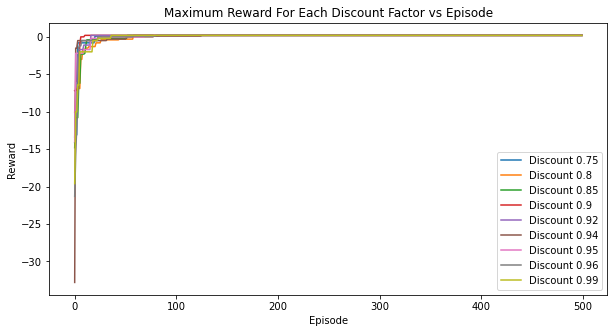

In [161]:
plt.figure(figsize=(10,5))
plt.plot(discounts_stats['aggr_ep_rewards'][0]['max'])
plt.plot(discounts_stats['aggr_ep_rewards'][1]['max'])
plt.plot(discounts_stats['aggr_ep_rewards'][2]['max'])
plt.plot(discounts_stats['aggr_ep_rewards'][3]['max'])
plt.plot(discounts_stats['aggr_ep_rewards'][4]['max'])
plt.plot(discounts_stats['aggr_ep_rewards'][5]['max'])
plt.plot(discounts_stats['aggr_ep_rewards'][6]['max'])
plt.plot(discounts_stats['aggr_ep_rewards'][7]['max'])
plt.plot(discounts_stats['aggr_ep_rewards'][8]['max'])
plt.title('Maximum Reward For Each Discount Factor vs Episode')
plt.ylabel('Reward')
plt.xlabel('Episode')
plt.legend(['Discount 0.75', 'Discount 0.8', 'Discount 0.85', 'Discount 0.9', 'Discount 0.92', 'Discount 0.94','Discount 0.95','Discount 0.96', 'Discount 0.99'], loc='lower right')
plt.show()

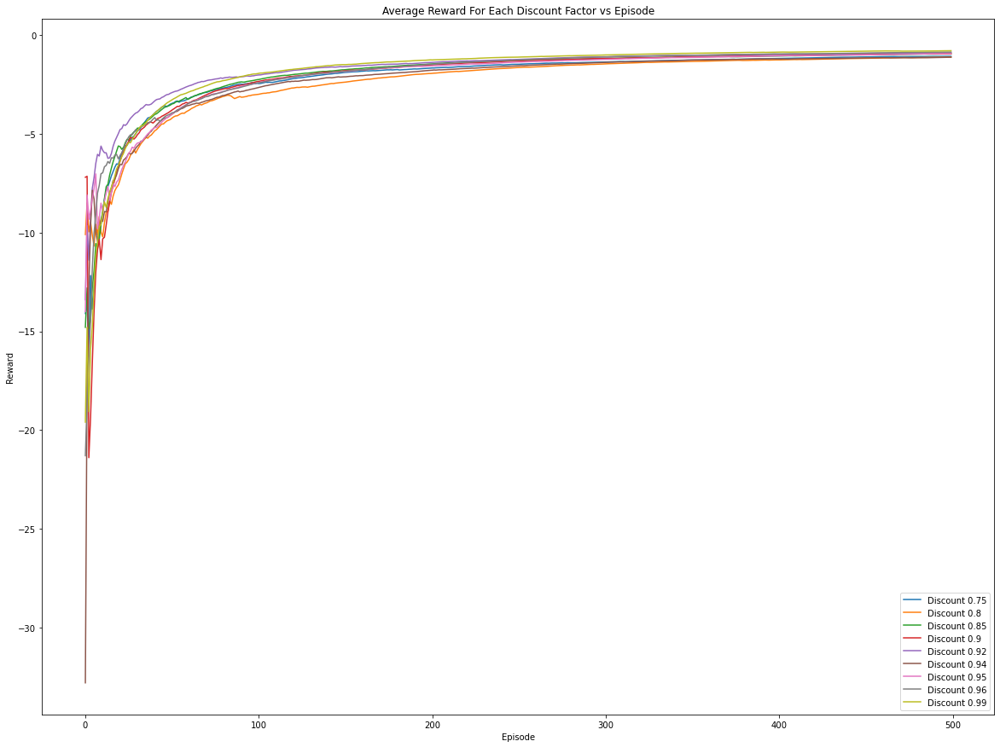

In [162]:
plt.figure(figsize=(20,15))
plt.plot(discounts_stats['aggr_ep_rewards'][0]['avg'])
plt.plot(discounts_stats['aggr_ep_rewards'][1]['avg'])
plt.plot(discounts_stats['aggr_ep_rewards'][2]['avg'])
plt.plot(discounts_stats['aggr_ep_rewards'][3]['avg'])
plt.plot(discounts_stats['aggr_ep_rewards'][4]['avg'])
plt.plot(discounts_stats['aggr_ep_rewards'][5]['avg'])
plt.plot(discounts_stats['aggr_ep_rewards'][6]['avg'])
plt.plot(discounts_stats['aggr_ep_rewards'][7]['avg'])
plt.plot(discounts_stats['aggr_ep_rewards'][8]['avg'])
plt.title('Average Reward For Each Discount Factor vs Episode')
plt.ylabel('Reward')
plt.xlabel('Episode')
plt.legend(['Discount 0.75', 'Discount 0.8', 'Discount 0.85', 'Discount 0.9', 'Discount 0.92', 'Discount 0.94','Discount 0.95','Discount 0.96', 'Discount 0.99'], loc='lower right')
plt.show()

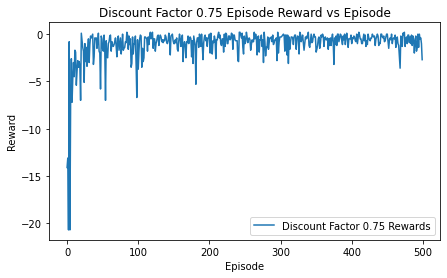

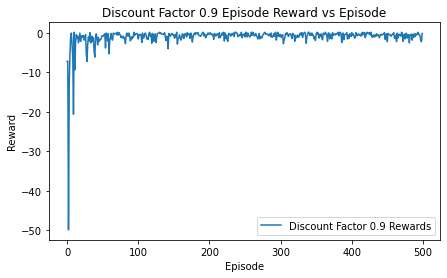

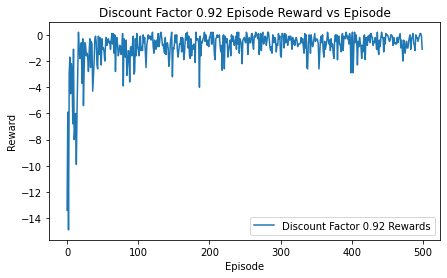

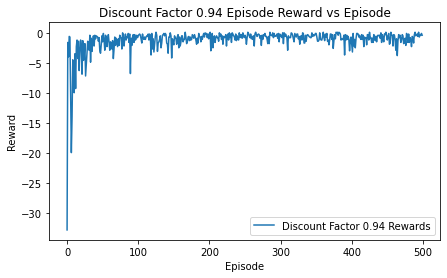

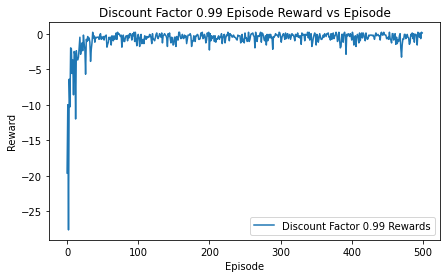

In [163]:
plt.figure(figsize=(7,4))
plt.plot(discounts_stats['ep_rewards'][0])
plt.title('Discount Factor 0.75 Episode Reward vs Episode')
plt.ylabel('Reward')
plt.xlabel('Episode')
plt.legend(['Discount Factor 0.75 Rewards'], loc='lower right')
plt.show()

plt.figure(figsize=(7,4))
plt.plot(discounts_stats['ep_rewards'][3])
plt.title('Discount Factor 0.9 Episode Reward vs Episode')
plt.ylabel('Reward')
plt.xlabel('Episode')
plt.legend(['Discount Factor 0.9 Rewards'], loc='lower right')
plt.show()

plt.figure(figsize=(7,4))
plt.plot(discounts_stats['ep_rewards'][4])
plt.title('Discount Factor 0.92 Episode Reward vs Episode')
plt.ylabel('Reward')
plt.xlabel('Episode')
plt.legend(['Discount Factor 0.92 Rewards'], loc='lower right')
plt.show()

plt.figure(figsize=(7,4))
plt.plot(discounts_stats['ep_rewards'][5])
plt.title('Discount Factor 0.94 Episode Reward vs Episode')
plt.ylabel('Reward')
plt.xlabel('Episode')
plt.legend(['Discount Factor 0.94 Rewards'], loc='lower right')
plt.show()

plt.figure(figsize=(7,4))
plt.plot(discounts_stats['ep_rewards'][8])
plt.title('Discount Factor 0.99 Episode Reward vs Episode')
plt.ylabel('Reward')
plt.xlabel('Episode')
plt.legend(['Discount Factor 0.99 Rewards'], loc='lower right')
plt.show()

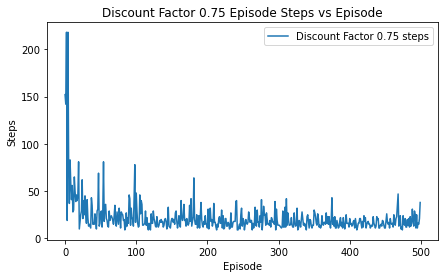

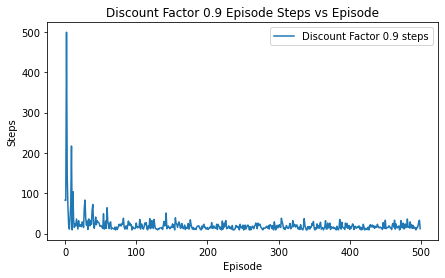

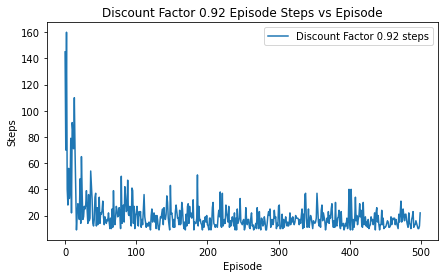

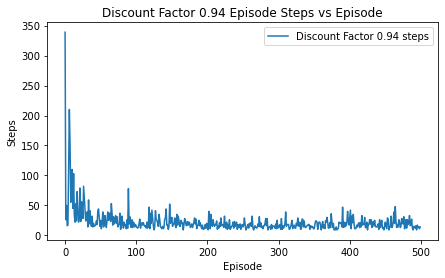

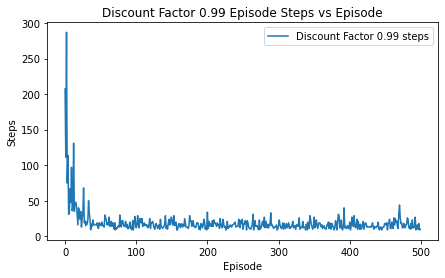

In [164]:
plt.figure(figsize=(7,4))
plt.plot(discounts_stats['ep_steps'][0])
plt.title('Discount Factor 0.75 Episode Steps vs Episode')
plt.ylabel('Steps')
plt.xlabel('Episode')
plt.legend(['Discount Factor 0.75 steps'], loc='upper right')
plt.show()

plt.figure(figsize=(7,4))
plt.plot(discounts_stats['ep_steps'][3])
plt.title('Discount Factor 0.9 Episode Steps vs Episode')
plt.ylabel('Steps')
plt.xlabel('Episode')
plt.legend(['Discount Factor 0.9 steps'], loc='upper right')
plt.show()

plt.figure(figsize=(7,4))
plt.plot(discounts_stats['ep_steps'][4])
plt.title('Discount Factor 0.92 Episode Steps vs Episode')
plt.ylabel('Steps')
plt.xlabel('Episode')
plt.legend(['Discount Factor 0.92 steps'], loc='upper right')
plt.show()

plt.figure(figsize=(7,4))
plt.plot(discounts_stats['ep_steps'][5])
plt.title('Discount Factor 0.94 Episode Steps vs Episode')
plt.ylabel('Steps')
plt.xlabel('Episode')
plt.legend(['Discount Factor 0.94 steps'], loc='upper right')
plt.show()

plt.figure(figsize=(7,4))
plt.plot(discounts_stats['ep_steps'][8])
plt.title('Discount Factor 0.99 Episode Steps vs Episode')
plt.ylabel('Steps')
plt.xlabel('Episode')
plt.legend(['Discount Factor 0.99 steps'], loc='upper right')
plt.show()

## Q Agent Choose Optimal Exploration Rate

In [3]:
# Find optimal Exploration Rate from [0.01,0.02,0.03,0.04,0.05,0.1] Exploration Rates
class QAgent(object):
    def __init__(self, exploration_rate):
        self.learning_rate = 0.4
        self.discount = 0.99
        self.exploration_rate = exploration_rate
        self.action_space = ['left','right','forward','backward','up','down'] # in TreasureCube
        self.Q = np.zeros([64,6])

    def take_action(self, state):
        if np.random.random() > self.exploration_rate:
            # Get action from Q table
            print("current state: " + state)
            state = [int(d) for d in str(state)]
            state = state[0] + state[1]*4 + state[2]*16
            action = self.action_space[np.argmax(self.Q[state])]
        else:
            print("random action!!!")
            action = random.choice(self.action_space)
        return action

    # implement your train/update function to update self.V or self.Q
    # you should pass arguments to the train function
    def train(self, state, action, next_state, reward):
        state = [int(d) for d in str(state)]
        state = state[0] + state[1]*4 + state[2]*16
        
        next_state = [int(d) for d in str(next_state)]
        next_state = next_state[0] + next_state[1]*4 + next_state[2]*16
        
        # Maximum possible Q value in next step (for new state)
        max_future_q = np.max(self.Q[next_state])

        # Current Q value (for current state and performed action)
        current_q = self.Q[state,self.action_space.index(action)]

        # And here's our equation for a new Q value for current state and action
        new_q = (1 - self.learning_rate) * current_q + self.learning_rate * (reward + self.discount * max_future_q)

        # Update Q table with new Q value
        self.Q[state,self.action_space.index(action)] = new_q
        
    def q_table(self):
        return self.Q

def test_cube(max_episode, max_step):
    env = TreasureCube(max_step=max_step)
    exploration_rates = [0.01,0.02,0.03,0.04,0.05,0.1]
    explore_stats = {'lr': [], 'ep_rewards': [], 'aggr_ep_rewards': [], 'ep_steps': [], 'q_tables': []}
    for i in exploration_rates:
        print("Exploration Rate: " + str(i))
        agent = QAgent(i)
        SHOW_EP = 100
        SHOW_STEP = 10
        # For stats
        ep_rewards = []
        aggr_ep_rewards = {'ep': [], 'avg': [], 'max': [], 'min': []}
        ep_steps = []

        for epsisode_num in range(0, max_episode):
            state = env.reset()
            terminate = False
            t = 0
            episode_reward = 0
            while not terminate:
                action = agent.take_action(state)
                reward, terminate, next_state = env.step(action)
                episode_reward += reward
                # you can comment the following two lines, if the output is too much
                #if epsisode_num % SHOW_EP == 0 and t % SHOW_STEP == 0:
                    #env.render() # comment
                print(f'exploration rate: {i},epsisode: {epsisode_num},step: {t}, action: {action}, reward: {reward}') # comment
                t += 1
                agent.train(state, action, next_state, reward)
                state = next_state
            print(f'exploration rate: {i},epsisode: {epsisode_num}, total_steps: {t} episode reward: {episode_reward}')
            ep_rewards.append(episode_reward)
            ep_steps.append(t)
            aggr_ep_rewards['ep'].append(epsisode_num)
            aggr_ep_rewards['avg'].append(sum(ep_rewards)/(epsisode_num+1))
            aggr_ep_rewards['max'].append(max(ep_rewards))
            aggr_ep_rewards['min'].append(min(ep_rewards))
            
        explore_stats['lr'].append(i)
        explore_stats['ep_rewards'].append(ep_rewards)
        explore_stats['aggr_ep_rewards'].append(aggr_ep_rewards)
        explore_stats['ep_steps'].append(ep_steps)
        explore_stats['q_tables'].append(agent.q_table())
        
    return explore_stats

In [13]:
explore_stats = test_cube(500, 500)

Exploration Rate: 0.01
current state: 000
exploration rate: 0.01,epsisode: 0,step: 0, action: left, reward: -0.1
current state: 001
exploration rate: 0.01,epsisode: 0,step: 1, action: left, reward: -0.1
current state: 001
exploration rate: 0.01,epsisode: 0,step: 2, action: right, reward: -0.1
current state: 101
exploration rate: 0.01,epsisode: 0,step: 3, action: left, reward: -0.1
current state: 101
exploration rate: 0.01,epsisode: 0,step: 4, action: right, reward: -0.1
current state: 001
exploration rate: 0.01,epsisode: 0,step: 5, action: forward, reward: -0.1
current state: 101
exploration rate: 0.01,epsisode: 0,step: 6, action: forward, reward: -0.1
current state: 201
exploration rate: 0.01,epsisode: 0,step: 7, action: left, reward: -0.1
current state: 301
exploration rate: 0.01,epsisode: 0,step: 8, action: left, reward: -0.1
current state: 301
exploration rate: 0.01,epsisode: 0,step: 9, action: right, reward: -0.1
current state: 311
exploration rate: 0.01,epsisode: 0,step: 10, acti

current state: 223
exploration rate: 0.01,epsisode: 14,step: 13, action: left, reward: -0.1
current state: 223
exploration rate: 0.01,epsisode: 14,step: 14, action: right, reward: -0.1
current state: 233
exploration rate: 0.01,epsisode: 14,step: 15, action: forward, reward: -0.1
current state: 232
exploration rate: 0.01,epsisode: 14,step: 16, action: up, reward: -0.1
current state: 233
exploration rate: 0.01,epsisode: 14,step: 17, action: forward, reward: 1
exploration rate: 0.01,epsisode: 14, total_steps: 18 episode reward: -0.7000000000000004
current state: 000
exploration rate: 0.01,epsisode: 15,step: 0, action: down, reward: -0.1
current state: 000
exploration rate: 0.01,epsisode: 15,step: 1, action: up, reward: -0.1
current state: 000
exploration rate: 0.01,epsisode: 15,step: 2, action: backward, reward: -0.1
current state: 000
exploration rate: 0.01,epsisode: 15,step: 3, action: right, reward: -0.1
current state: 010
exploration rate: 0.01,epsisode: 15,step: 4, action: up, reward

exploration rate: 0.01,epsisode: 60,step: 12, action: forward, reward: -0.1
current state: 233
exploration rate: 0.01,epsisode: 60,step: 13, action: forward, reward: 1
exploration rate: 0.01,epsisode: 60, total_steps: 14 episode reward: -0.30000000000000004
current state: 000
exploration rate: 0.01,epsisode: 61,step: 0, action: forward, reward: -0.1
current state: 100
exploration rate: 0.01,epsisode: 61,step: 1, action: right, reward: -0.1
current state: 100
exploration rate: 0.01,epsisode: 61,step: 2, action: forward, reward: -0.1
current state: 110
exploration rate: 0.01,epsisode: 61,step: 3, action: forward, reward: -0.1
current state: 210
exploration rate: 0.01,epsisode: 61,step: 4, action: forward, reward: -0.1
current state: 200
exploration rate: 0.01,epsisode: 61,step: 5, action: forward, reward: -0.1
current state: 300
exploration rate: 0.01,epsisode: 61,step: 6, action: forward, reward: -0.1
current state: 300
exploration rate: 0.01,epsisode: 61,step: 7, action: right, reward:

exploration rate: 0.01,epsisode: 130,step: 10, action: forward, reward: -0.1
current state: 132
exploration rate: 0.01,epsisode: 130,step: 11, action: up, reward: -0.1
current state: 132
exploration rate: 0.01,epsisode: 130,step: 12, action: up, reward: -0.1
current state: 032
exploration rate: 0.01,epsisode: 130,step: 13, action: forward, reward: -0.1
current state: 132
exploration rate: 0.01,epsisode: 130,step: 14, action: up, reward: -0.1
current state: 133
exploration rate: 0.01,epsisode: 130,step: 15, action: forward, reward: -0.1
current state: 233
exploration rate: 0.01,epsisode: 130,step: 16, action: forward, reward: -0.1
current state: 233
exploration rate: 0.01,epsisode: 130,step: 17, action: forward, reward: 1
exploration rate: 0.01,epsisode: 130, total_steps: 18 episode reward: -0.7000000000000004
current state: 000
exploration rate: 0.01,epsisode: 131,step: 0, action: up, reward: -0.1
current state: 010
exploration rate: 0.01,epsisode: 131,step: 1, action: right, reward: -

exploration rate: 0.01,epsisode: 210,step: 13, action: forward, reward: 1
exploration rate: 0.01,epsisode: 210, total_steps: 14 episode reward: -0.30000000000000004
current state: 000
exploration rate: 0.01,epsisode: 211,step: 0, action: right, reward: -0.1
random action!!!
exploration rate: 0.01,epsisode: 211,step: 1, action: left, reward: -0.1
current state: 000
exploration rate: 0.01,epsisode: 211,step: 2, action: right, reward: -0.1
current state: 000
exploration rate: 0.01,epsisode: 211,step: 3, action: right, reward: -0.1
current state: 010
exploration rate: 0.01,epsisode: 211,step: 4, action: up, reward: -0.1
current state: 011
exploration rate: 0.01,epsisode: 211,step: 5, action: right, reward: -0.1
current state: 021
exploration rate: 0.01,epsisode: 211,step: 6, action: right, reward: -0.1
current state: 021
exploration rate: 0.01,epsisode: 211,step: 7, action: right, reward: -0.1
current state: 031
exploration rate: 0.01,epsisode: 211,step: 8, action: up, reward: -0.1
current

current state: 100
exploration rate: 0.01,epsisode: 303,step: 13, action: right, reward: -0.1
current state: 000
exploration rate: 0.01,epsisode: 303,step: 14, action: right, reward: -0.1
current state: 001
exploration rate: 0.01,epsisode: 303,step: 15, action: up, reward: -0.1
current state: 001
exploration rate: 0.01,epsisode: 303,step: 16, action: up, reward: -0.1
current state: 002
exploration rate: 0.01,epsisode: 303,step: 17, action: up, reward: -0.1
current state: 003
exploration rate: 0.01,epsisode: 303,step: 18, action: forward, reward: -0.1
current state: 103
exploration rate: 0.01,epsisode: 303,step: 19, action: right, reward: -0.1
current state: 103
exploration rate: 0.01,epsisode: 303,step: 20, action: right, reward: -0.1
current state: 113
exploration rate: 0.01,epsisode: 303,step: 21, action: right, reward: -0.1
current state: 123
exploration rate: 0.01,epsisode: 303,step: 22, action: right, reward: -0.1
current state: 133
exploration rate: 0.01,epsisode: 303,step: 23, a

exploration rate: 0.01,epsisode: 407,step: 8, action: up, reward: -0.1
current state: 133
exploration rate: 0.01,epsisode: 407,step: 9, action: forward, reward: -0.1
current state: 132
exploration rate: 0.01,epsisode: 407,step: 10, action: up, reward: -0.1
current state: 133
exploration rate: 0.01,epsisode: 407,step: 11, action: forward, reward: -0.1
current state: 233
exploration rate: 0.01,epsisode: 407,step: 12, action: forward, reward: 1
exploration rate: 0.01,epsisode: 407, total_steps: 13 episode reward: -0.19999999999999996
current state: 000
exploration rate: 0.01,epsisode: 408,step: 0, action: right, reward: -0.1
current state: 010
exploration rate: 0.01,epsisode: 408,step: 1, action: right, reward: -0.1
current state: 010
exploration rate: 0.01,epsisode: 408,step: 2, action: right, reward: -0.1
current state: 020
exploration rate: 0.01,epsisode: 408,step: 3, action: right, reward: -0.1
current state: 020
exploration rate: 0.01,epsisode: 408,step: 4, action: right, reward: -0.

current state: 203
exploration rate: 0.02,epsisode: 0,step: 25, action: forward, reward: -0.1
current state: 202
exploration rate: 0.02,epsisode: 0,step: 26, action: backward, reward: -0.1
current state: 201
exploration rate: 0.02,epsisode: 0,step: 27, action: forward, reward: -0.1
current state: 301
exploration rate: 0.02,epsisode: 0,step: 28, action: left, reward: -0.1
current state: 302
exploration rate: 0.02,epsisode: 0,step: 29, action: left, reward: -0.1
current state: 302
exploration rate: 0.02,epsisode: 0,step: 30, action: right, reward: -0.1
current state: 302
exploration rate: 0.02,epsisode: 0,step: 31, action: forward, reward: -0.1
current state: 303
exploration rate: 0.02,epsisode: 0,step: 32, action: left, reward: -0.1
current state: 302
exploration rate: 0.02,epsisode: 0,step: 33, action: backward, reward: -0.1
current state: 302
exploration rate: 0.02,epsisode: 0,step: 34, action: up, reward: -0.1
current state: 303
exploration rate: 0.02,epsisode: 0,step: 35, action: ri

exploration rate: 0.02,epsisode: 37,step: 10, action: forward, reward: -0.1
current state: 013
exploration rate: 0.02,epsisode: 37,step: 11, action: right, reward: -0.1
current state: 012
exploration rate: 0.02,epsisode: 37,step: 12, action: down, reward: -0.1
current state: 011
exploration rate: 0.02,epsisode: 37,step: 13, action: up, reward: -0.1
current state: 012
exploration rate: 0.02,epsisode: 37,step: 14, action: left, reward: -0.1
current state: 002
exploration rate: 0.02,epsisode: 37,step: 15, action: up, reward: -0.1
current state: 003
exploration rate: 0.02,epsisode: 37,step: 16, action: down, reward: -0.1
current state: 003
exploration rate: 0.02,epsisode: 37,step: 17, action: forward, reward: -0.1
current state: 003
exploration rate: 0.02,epsisode: 37,step: 18, action: left, reward: -0.1
current state: 003
exploration rate: 0.02,epsisode: 37,step: 19, action: up, reward: -0.1
current state: 003
exploration rate: 0.02,epsisode: 37,step: 20, action: right, reward: -0.1
curre

exploration rate: 0.02,epsisode: 113,step: 7, action: right, reward: -0.1
current state: 310
exploration rate: 0.02,epsisode: 113,step: 8, action: forward, reward: -0.1
current state: 310
exploration rate: 0.02,epsisode: 113,step: 9, action: forward, reward: -0.1
current state: 310
exploration rate: 0.02,epsisode: 113,step: 10, action: down, reward: -0.1
current state: 310
exploration rate: 0.02,epsisode: 113,step: 11, action: right, reward: -0.1
current state: 320
exploration rate: 0.02,epsisode: 113,step: 12, action: up, reward: -0.1
current state: 321
exploration rate: 0.02,epsisode: 113,step: 13, action: right, reward: -0.1
current state: 320
exploration rate: 0.02,epsisode: 113,step: 14, action: up, reward: -0.1
current state: 321
exploration rate: 0.02,epsisode: 113,step: 15, action: right, reward: -0.1
current state: 331
exploration rate: 0.02,epsisode: 113,step: 16, action: up, reward: -0.1
current state: 332
exploration rate: 0.02,epsisode: 113,step: 17, action: up, reward: -0

exploration rate: 0.02,epsisode: 198,step: 1, action: up, reward: -0.1
current state: 011
exploration rate: 0.02,epsisode: 198,step: 2, action: up, reward: -0.1
current state: 012
exploration rate: 0.02,epsisode: 198,step: 3, action: right, reward: -0.1
current state: 013
exploration rate: 0.02,epsisode: 198,step: 4, action: right, reward: -0.1
current state: 012
exploration rate: 0.02,epsisode: 198,step: 5, action: right, reward: -0.1
current state: 022
exploration rate: 0.02,epsisode: 198,step: 6, action: right, reward: -0.1
current state: 022
exploration rate: 0.02,epsisode: 198,step: 7, action: right, reward: -0.1
current state: 032
exploration rate: 0.02,epsisode: 198,step: 8, action: forward, reward: -0.1
current state: 132
exploration rate: 0.02,epsisode: 198,step: 9, action: forward, reward: -0.1
current state: 132
exploration rate: 0.02,epsisode: 198,step: 10, action: forward, reward: -0.1
current state: 232
exploration rate: 0.02,epsisode: 198,step: 11, action: up, reward: -0

current state: 010
exploration rate: 0.02,epsisode: 292,step: 8, action: right, reward: -0.1
current state: 020
exploration rate: 0.02,epsisode: 292,step: 9, action: right, reward: -0.1
current state: 030
exploration rate: 0.02,epsisode: 292,step: 10, action: up, reward: -0.1
current state: 031
exploration rate: 0.02,epsisode: 292,step: 11, action: forward, reward: -0.1
current state: 131
exploration rate: 0.02,epsisode: 292,step: 12, action: forward, reward: -0.1
current state: 231
exploration rate: 0.02,epsisode: 292,step: 13, action: up, reward: -0.1
current state: 232
exploration rate: 0.02,epsisode: 292,step: 14, action: up, reward: -0.1
current state: 233
exploration rate: 0.02,epsisode: 292,step: 15, action: forward, reward: -0.1
current state: 232
exploration rate: 0.02,epsisode: 292,step: 16, action: up, reward: -0.1
current state: 233
exploration rate: 0.02,epsisode: 292,step: 17, action: forward, reward: 1
exploration rate: 0.02,epsisode: 292, total_steps: 18 episode reward:

current state: 132
exploration rate: 0.02,epsisode: 389,step: 11, action: forward, reward: -0.1
current state: 131
exploration rate: 0.02,epsisode: 389,step: 12, action: forward, reward: -0.1
current state: 121
exploration rate: 0.02,epsisode: 389,step: 13, action: right, reward: -0.1
random action!!!
exploration rate: 0.02,epsisode: 389,step: 14, action: forward, reward: -0.1
current state: 231
exploration rate: 0.02,epsisode: 389,step: 15, action: up, reward: -0.1
current state: 232
exploration rate: 0.02,epsisode: 389,step: 16, action: up, reward: -0.1
current state: 233
exploration rate: 0.02,epsisode: 389,step: 17, action: forward, reward: 1
exploration rate: 0.02,epsisode: 389, total_steps: 18 episode reward: -0.7000000000000004
current state: 000
exploration rate: 0.02,epsisode: 390,step: 0, action: right, reward: -0.1
current state: 000
exploration rate: 0.02,epsisode: 390,step: 1, action: right, reward: -0.1
current state: 010
exploration rate: 0.02,epsisode: 390,step: 2, acti

exploration rate: 0.02,epsisode: 480,step: 3, action: right, reward: -0.1
current state: 120
exploration rate: 0.02,epsisode: 480,step: 4, action: right, reward: -0.1
current state: 220
exploration rate: 0.02,epsisode: 480,step: 5, action: up, reward: -0.1
current state: 320
exploration rate: 0.02,epsisode: 480,step: 6, action: up, reward: -0.1
current state: 220
exploration rate: 0.02,epsisode: 480,step: 7, action: up, reward: -0.1
current state: 221
exploration rate: 0.02,epsisode: 480,step: 8, action: right, reward: -0.1
current state: 231
exploration rate: 0.02,epsisode: 480,step: 9, action: up, reward: -0.1
current state: 131
exploration rate: 0.02,epsisode: 480,step: 10, action: forward, reward: -0.1
current state: 231
exploration rate: 0.02,epsisode: 480,step: 11, action: up, reward: -0.1
current state: 232
exploration rate: 0.02,epsisode: 480,step: 12, action: up, reward: -0.1
current state: 233
exploration rate: 0.02,epsisode: 480,step: 13, action: forward, reward: -0.1
curren

exploration rate: 0.03,epsisode: 9,step: 123, action: backward, reward: -0.1
current state: 231
exploration rate: 0.03,epsisode: 9,step: 124, action: backward, reward: -0.1
current state: 221
exploration rate: 0.03,epsisode: 9,step: 125, action: right, reward: -0.1
current state: 321
exploration rate: 0.03,epsisode: 9,step: 126, action: up, reward: -0.1
current state: 321
exploration rate: 0.03,epsisode: 9,step: 127, action: forward, reward: -0.1
current state: 321
exploration rate: 0.03,epsisode: 9,step: 128, action: right, reward: -0.1
current state: 322
exploration rate: 0.03,epsisode: 9,step: 129, action: left, reward: -0.1
random action!!!
exploration rate: 0.03,epsisode: 9,step: 130, action: right, reward: -0.1
current state: 311
exploration rate: 0.03,epsisode: 9,step: 131, action: forward, reward: -0.1
current state: 311
exploration rate: 0.03,epsisode: 9,step: 132, action: down, reward: -0.1
current state: 301
exploration rate: 0.03,epsisode: 9,step: 133, action: up, reward: -

exploration rate: 0.03,epsisode: 45,step: 10, action: backward, reward: -0.1
current state: 300
exploration rate: 0.03,epsisode: 45,step: 11, action: forward, reward: -0.1
current state: 300
exploration rate: 0.03,epsisode: 45,step: 12, action: up, reward: -0.1
current state: 300
exploration rate: 0.03,epsisode: 45,step: 13, action: left, reward: -0.1
current state: 300
exploration rate: 0.03,epsisode: 45,step: 14, action: right, reward: -0.1
current state: 310
exploration rate: 0.03,epsisode: 45,step: 15, action: right, reward: -0.1
current state: 320
exploration rate: 0.03,epsisode: 45,step: 16, action: backward, reward: -0.1
current state: 220
exploration rate: 0.03,epsisode: 45,step: 17, action: forward, reward: -0.1
current state: 221
exploration rate: 0.03,epsisode: 45,step: 18, action: forward, reward: -0.1
random action!!!
exploration rate: 0.03,epsisode: 45,step: 19, action: up, reward: -0.1
current state: 232
exploration rate: 0.03,epsisode: 45,step: 20, action: forward, rewa

exploration rate: 0.03,epsisode: 107,step: 16, action: forward, reward: -0.1
current state: 332
exploration rate: 0.03,epsisode: 107,step: 17, action: up, reward: 1
exploration rate: 0.03,epsisode: 107, total_steps: 18 episode reward: -0.7000000000000004
current state: 000
exploration rate: 0.03,epsisode: 108,step: 0, action: forward, reward: -0.1
current state: 100
exploration rate: 0.03,epsisode: 108,step: 1, action: right, reward: -0.1
current state: 110
exploration rate: 0.03,epsisode: 108,step: 2, action: forward, reward: -0.1
current state: 210
exploration rate: 0.03,epsisode: 108,step: 3, action: right, reward: -0.1
current state: 220
exploration rate: 0.03,epsisode: 108,step: 4, action: forward, reward: -0.1
current state: 320
exploration rate: 0.03,epsisode: 108,step: 5, action: up, reward: -0.1
current state: 330
exploration rate: 0.03,epsisode: 108,step: 6, action: up, reward: -0.1
current state: 330
exploration rate: 0.03,epsisode: 108,step: 7, action: up, reward: -0.1
curr

exploration rate: 0.03,epsisode: 194,step: 8, action: right, reward: -0.1
current state: 320
exploration rate: 0.03,epsisode: 194,step: 9, action: up, reward: -0.1
current state: 321
exploration rate: 0.03,epsisode: 194,step: 10, action: right, reward: -0.1
current state: 221
exploration rate: 0.03,epsisode: 194,step: 11, action: forward, reward: -0.1
current state: 211
exploration rate: 0.03,epsisode: 194,step: 12, action: right, reward: -0.1
current state: 212
exploration rate: 0.03,epsisode: 194,step: 13, action: up, reward: -0.1
current state: 213
exploration rate: 0.03,epsisode: 194,step: 14, action: right, reward: -0.1
current state: 223
exploration rate: 0.03,epsisode: 194,step: 15, action: right, reward: -0.1
current state: 233
exploration rate: 0.03,epsisode: 194,step: 16, action: down, reward: -0.1
current state: 232
exploration rate: 0.03,epsisode: 194,step: 17, action: forward, reward: -0.1
current state: 332
exploration rate: 0.03,epsisode: 194,step: 18, action: up, reward

exploration rate: 0.03,epsisode: 285,step: 6, action: forward, reward: -0.1
current state: 320
exploration rate: 0.03,epsisode: 285,step: 7, action: up, reward: -0.1
current state: 320
exploration rate: 0.03,epsisode: 285,step: 8, action: up, reward: -0.1
current state: 310
exploration rate: 0.03,epsisode: 285,step: 9, action: right, reward: -0.1
current state: 320
exploration rate: 0.03,epsisode: 285,step: 10, action: up, reward: -0.1
current state: 321
exploration rate: 0.03,epsisode: 285,step: 11, action: right, reward: -0.1
current state: 221
exploration rate: 0.03,epsisode: 285,step: 12, action: forward, reward: -0.1
random action!!!
exploration rate: 0.03,epsisode: 285,step: 13, action: right, reward: -0.1
current state: 210
exploration rate: 0.03,epsisode: 285,step: 14, action: forward, reward: -0.1
current state: 210
exploration rate: 0.03,epsisode: 285,step: 15, action: forward, reward: -0.1
current state: 310
exploration rate: 0.03,epsisode: 285,step: 16, action: right, rewar

exploration rate: 0.03,epsisode: 371,step: 0, action: right, reward: -0.1
current state: 000
exploration rate: 0.03,epsisode: 371,step: 1, action: right, reward: -0.1
current state: 000
exploration rate: 0.03,epsisode: 371,step: 2, action: right, reward: -0.1
current state: 010
exploration rate: 0.03,epsisode: 371,step: 3, action: right, reward: -0.1
current state: 110
exploration rate: 0.03,epsisode: 371,step: 4, action: forward, reward: -0.1
current state: 100
exploration rate: 0.03,epsisode: 371,step: 5, action: up, reward: -0.1
current state: 101
exploration rate: 0.03,epsisode: 371,step: 6, action: right, reward: -0.1
current state: 111
exploration rate: 0.03,epsisode: 371,step: 7, action: forward, reward: -0.1
current state: 211
exploration rate: 0.03,epsisode: 371,step: 8, action: right, reward: -0.1
current state: 221
exploration rate: 0.03,epsisode: 371,step: 9, action: forward, reward: -0.1
current state: 321
exploration rate: 0.03,epsisode: 371,step: 10, action: right, rewar

exploration rate: 0.03,epsisode: 456,step: 14, action: down, reward: -0.1
current state: 213
exploration rate: 0.03,epsisode: 456,step: 15, action: right, reward: -0.1
current state: 113
exploration rate: 0.03,epsisode: 456,step: 16, action: forward, reward: -0.1
current state: 213
exploration rate: 0.03,epsisode: 456,step: 17, action: right, reward: -0.1
current state: 213
exploration rate: 0.03,epsisode: 456,step: 18, action: right, reward: -0.1
current state: 223
exploration rate: 0.03,epsisode: 456,step: 19, action: down, reward: -0.1
current state: 222
exploration rate: 0.03,epsisode: 456,step: 20, action: forward, reward: -0.1
current state: 322
exploration rate: 0.03,epsisode: 456,step: 21, action: right, reward: -0.1
current state: 332
exploration rate: 0.03,epsisode: 456,step: 22, action: up, reward: 1
exploration rate: 0.03,epsisode: 456, total_steps: 23 episode reward: -1.2000000000000006
current state: 000
exploration rate: 0.03,epsisode: 457,step: 0, action: right, reward:

current state: 231
exploration rate: 0.04,epsisode: 10,step: 19, action: forward, reward: -0.1
current state: 331
exploration rate: 0.04,epsisode: 10,step: 20, action: up, reward: -0.1
current state: 332
exploration rate: 0.04,epsisode: 10,step: 21, action: backward, reward: -0.1
current state: 232
exploration rate: 0.04,epsisode: 10,step: 22, action: backward, reward: -0.1
current state: 222
exploration rate: 0.04,epsisode: 10,step: 23, action: up, reward: -0.1
current state: 223
exploration rate: 0.04,epsisode: 10,step: 24, action: right, reward: -0.1
current state: 233
exploration rate: 0.04,epsisode: 10,step: 25, action: forward, reward: 1
exploration rate: 0.04,epsisode: 10, total_steps: 26 episode reward: -1.5000000000000009
current state: 000
exploration rate: 0.04,epsisode: 11,step: 0, action: backward, reward: -0.1
current state: 010
exploration rate: 0.04,epsisode: 11,step: 1, action: up, reward: -0.1
current state: 011
exploration rate: 0.04,epsisode: 11,step: 2, action: for

current state: 323
exploration rate: 0.04,epsisode: 57,step: 20, action: backward, reward: -0.1
current state: 322
exploration rate: 0.04,epsisode: 57,step: 21, action: down, reward: -0.1
current state: 321
exploration rate: 0.04,epsisode: 57,step: 22, action: right, reward: -0.1
current state: 331
exploration rate: 0.04,epsisode: 57,step: 23, action: up, reward: -0.1
current state: 332
exploration rate: 0.04,epsisode: 57,step: 24, action: up, reward: 1
exploration rate: 0.04,epsisode: 57, total_steps: 25 episode reward: -1.4000000000000008
current state: 000
exploration rate: 0.04,epsisode: 58,step: 0, action: backward, reward: -0.1
current state: 000
exploration rate: 0.04,epsisode: 58,step: 1, action: up, reward: -0.1
current state: 001
exploration rate: 0.04,epsisode: 58,step: 2, action: up, reward: -0.1
current state: 001
exploration rate: 0.04,epsisode: 58,step: 3, action: right, reward: -0.1
current state: 011
exploration rate: 0.04,epsisode: 58,step: 4, action: left, reward: -0

exploration rate: 0.04,epsisode: 125,step: 13, action: right, reward: -0.1
current state: 003
exploration rate: 0.04,epsisode: 125,step: 14, action: right, reward: -0.1
current state: 013
exploration rate: 0.04,epsisode: 125,step: 15, action: right, reward: -0.1
current state: 023
exploration rate: 0.04,epsisode: 125,step: 16, action: right, reward: -0.1
current state: 033
exploration rate: 0.04,epsisode: 125,step: 17, action: forward, reward: -0.1
current state: 033
exploration rate: 0.04,epsisode: 125,step: 18, action: forward, reward: -0.1
current state: 133
exploration rate: 0.04,epsisode: 125,step: 19, action: forward, reward: -0.1
current state: 233
exploration rate: 0.04,epsisode: 125,step: 20, action: forward, reward: -0.1
current state: 233
exploration rate: 0.04,epsisode: 125,step: 21, action: forward, reward: 1
exploration rate: 0.04,epsisode: 125, total_steps: 22 episode reward: -1.1000000000000005
current state: 000
exploration rate: 0.04,epsisode: 126,step: 0, action: lef

current state: 030
exploration rate: 0.04,epsisode: 206,step: 4, action: forward, reward: -0.1
current state: 130
exploration rate: 0.04,epsisode: 206,step: 5, action: up, reward: -0.1
current state: 130
exploration rate: 0.04,epsisode: 206,step: 6, action: up, reward: -0.1
current state: 131
exploration rate: 0.04,epsisode: 206,step: 7, action: forward, reward: -0.1
current state: 231
exploration rate: 0.04,epsisode: 206,step: 8, action: forward, reward: -0.1
current state: 331
exploration rate: 0.04,epsisode: 206,step: 9, action: up, reward: -0.1
current state: 332
exploration rate: 0.04,epsisode: 206,step: 10, action: up, reward: -0.1
current state: 322
exploration rate: 0.04,epsisode: 206,step: 11, action: down, reward: -0.1
current state: 321
exploration rate: 0.04,epsisode: 206,step: 12, action: right, reward: -0.1
current state: 321
exploration rate: 0.04,epsisode: 206,step: 13, action: right, reward: -0.1
current state: 320
exploration rate: 0.04,epsisode: 206,step: 14, action:

current state: 231
exploration rate: 0.04,epsisode: 292,step: 6, action: forward, reward: -0.1
current state: 331
exploration rate: 0.04,epsisode: 292,step: 7, action: up, reward: -0.1
current state: 332
exploration rate: 0.04,epsisode: 292,step: 8, action: up, reward: 1
exploration rate: 0.04,epsisode: 292, total_steps: 9 episode reward: 0.20000000000000007
random action!!!
exploration rate: 0.04,epsisode: 293,step: 0, action: up, reward: -0.1
current state: 001
exploration rate: 0.04,epsisode: 293,step: 1, action: up, reward: -0.1
current state: 011
exploration rate: 0.04,epsisode: 293,step: 2, action: forward, reward: -0.1
current state: 111
exploration rate: 0.04,epsisode: 293,step: 3, action: right, reward: -0.1
current state: 121
exploration rate: 0.04,epsisode: 293,step: 4, action: up, reward: -0.1
random action!!!
exploration rate: 0.04,epsisode: 293,step: 5, action: down, reward: -0.1
current state: 121
exploration rate: 0.04,epsisode: 293,step: 6, action: up, reward: -0.1
cur

current state: 100
exploration rate: 0.04,epsisode: 391,step: 1, action: right, reward: -0.1
current state: 100
exploration rate: 0.04,epsisode: 391,step: 2, action: right, reward: -0.1
current state: 200
exploration rate: 0.04,epsisode: 391,step: 3, action: forward, reward: -0.1
current state: 300
exploration rate: 0.04,epsisode: 391,step: 4, action: up, reward: -0.1
current state: 300
exploration rate: 0.04,epsisode: 391,step: 5, action: up, reward: -0.1
current state: 301
exploration rate: 0.04,epsisode: 391,step: 6, action: right, reward: -0.1
current state: 311
exploration rate: 0.04,epsisode: 391,step: 7, action: up, reward: -0.1
current state: 312
exploration rate: 0.04,epsisode: 391,step: 8, action: right, reward: -0.1
current state: 322
exploration rate: 0.04,epsisode: 391,step: 9, action: down, reward: -0.1
current state: 312
exploration rate: 0.04,epsisode: 391,step: 10, action: right, reward: -0.1
current state: 312
exploration rate: 0.04,epsisode: 391,step: 11, action: rig

current state: 222
exploration rate: 0.04,epsisode: 475,step: 21, action: forward, reward: -0.1
current state: 223
exploration rate: 0.04,epsisode: 475,step: 22, action: right, reward: -0.1
current state: 233
exploration rate: 0.04,epsisode: 475,step: 23, action: forward, reward: -0.1
current state: 233
exploration rate: 0.04,epsisode: 475,step: 24, action: forward, reward: 1
exploration rate: 0.04,epsisode: 475, total_steps: 25 episode reward: -1.4000000000000008
current state: 000
exploration rate: 0.04,epsisode: 476,step: 0, action: right, reward: -0.1
current state: 000
exploration rate: 0.04,epsisode: 476,step: 1, action: right, reward: -0.1
current state: 010
exploration rate: 0.04,epsisode: 476,step: 2, action: right, reward: -0.1
random action!!!
exploration rate: 0.04,epsisode: 476,step: 3, action: left, reward: -0.1
current state: 100
exploration rate: 0.04,epsisode: 476,step: 4, action: right, reward: -0.1
current state: 100
exploration rate: 0.04,epsisode: 476,step: 5, acti

exploration rate: 0.05,epsisode: 14,step: 30, action: backward, reward: -0.1
current state: 030
exploration rate: 0.05,epsisode: 14,step: 31, action: left, reward: -0.1
current state: 020
exploration rate: 0.05,epsisode: 14,step: 32, action: left, reward: -0.1
current state: 010
exploration rate: 0.05,epsisode: 14,step: 33, action: right, reward: -0.1
current state: 020
exploration rate: 0.05,epsisode: 14,step: 34, action: right, reward: -0.1
current state: 030
exploration rate: 0.05,epsisode: 14,step: 35, action: right, reward: -0.1
current state: 031
exploration rate: 0.05,epsisode: 14,step: 36, action: backward, reward: -0.1
current state: 032
exploration rate: 0.05,epsisode: 14,step: 37, action: up, reward: -0.1
current state: 032
exploration rate: 0.05,epsisode: 14,step: 38, action: down, reward: -0.1
current state: 031
exploration rate: 0.05,epsisode: 14,step: 39, action: left, reward: -0.1
current state: 021
exploration rate: 0.05,epsisode: 14,step: 40, action: up, reward: -0.1


exploration rate: 0.05,epsisode: 69,step: 17, action: down, reward: -0.1
current state: 211
exploration rate: 0.05,epsisode: 69,step: 18, action: up, reward: -0.1
current state: 212
exploration rate: 0.05,epsisode: 69,step: 19, action: right, reward: -0.1
current state: 213
exploration rate: 0.05,epsisode: 69,step: 20, action: right, reward: -0.1
random action!!!
exploration rate: 0.05,epsisode: 69,step: 21, action: backward, reward: -0.1
current state: 223
exploration rate: 0.05,epsisode: 69,step: 22, action: right, reward: -0.1
current state: 223
exploration rate: 0.05,epsisode: 69,step: 23, action: right, reward: -0.1
current state: 233
exploration rate: 0.05,epsisode: 69,step: 24, action: forward, reward: 1
exploration rate: 0.05,epsisode: 69, total_steps: 25 episode reward: -1.4000000000000008
current state: 000
exploration rate: 0.05,epsisode: 70,step: 0, action: right, reward: -0.1
current state: 010
exploration rate: 0.05,epsisode: 70,step: 1, action: right, reward: -0.1
curren

current state: 132
exploration rate: 0.05,epsisode: 153,step: 14, action: left, reward: -0.1
current state: 122
exploration rate: 0.05,epsisode: 153,step: 15, action: up, reward: -0.1
current state: 123
exploration rate: 0.05,epsisode: 153,step: 16, action: forward, reward: -0.1
current state: 113
exploration rate: 0.05,epsisode: 153,step: 17, action: forward, reward: -0.1
current state: 113
exploration rate: 0.05,epsisode: 153,step: 18, action: forward, reward: -0.1
current state: 213
exploration rate: 0.05,epsisode: 153,step: 19, action: right, reward: -0.1
current state: 223
exploration rate: 0.05,epsisode: 153,step: 20, action: right, reward: -0.1
current state: 233
exploration rate: 0.05,epsisode: 153,step: 21, action: forward, reward: 1
exploration rate: 0.05,epsisode: 153, total_steps: 22 episode reward: -1.1000000000000005
current state: 000
exploration rate: 0.05,epsisode: 154,step: 0, action: up, reward: -0.1
current state: 001
exploration rate: 0.05,epsisode: 154,step: 1, ac

exploration rate: 0.05,epsisode: 245,step: 5, action: up, reward: -0.1
current state: 220
exploration rate: 0.05,epsisode: 245,step: 6, action: up, reward: -0.1
current state: 230
exploration rate: 0.05,epsisode: 245,step: 7, action: forward, reward: -0.1
current state: 230
exploration rate: 0.05,epsisode: 245,step: 8, action: forward, reward: -0.1
current state: 330
exploration rate: 0.05,epsisode: 245,step: 9, action: up, reward: -0.1
current state: 331
exploration rate: 0.05,epsisode: 245,step: 10, action: up, reward: -0.1
current state: 331
exploration rate: 0.05,epsisode: 245,step: 11, action: up, reward: -0.1
current state: 332
exploration rate: 0.05,epsisode: 245,step: 12, action: up, reward: 1
exploration rate: 0.05,epsisode: 245, total_steps: 13 episode reward: -0.19999999999999996
current state: 000
exploration rate: 0.05,epsisode: 246,step: 0, action: forward, reward: -0.1
current state: 100
exploration rate: 0.05,epsisode: 246,step: 1, action: forward, reward: -0.1
current 

exploration rate: 0.05,epsisode: 338,step: 0, action: forward, reward: -0.1
current state: 100
exploration rate: 0.05,epsisode: 338,step: 1, action: forward, reward: -0.1
current state: 100
exploration rate: 0.05,epsisode: 338,step: 2, action: forward, reward: -0.1
current state: 101
exploration rate: 0.05,epsisode: 338,step: 3, action: up, reward: -0.1
current state: 102
exploration rate: 0.05,epsisode: 338,step: 4, action: forward, reward: -0.1
current state: 202
exploration rate: 0.05,epsisode: 338,step: 5, action: forward, reward: -0.1
current state: 202
exploration rate: 0.05,epsisode: 338,step: 6, action: forward, reward: -0.1
current state: 302
exploration rate: 0.05,epsisode: 338,step: 7, action: right, reward: -0.1
current state: 312
exploration rate: 0.05,epsisode: 338,step: 8, action: right, reward: -0.1
current state: 322
exploration rate: 0.05,epsisode: 338,step: 9, action: right, reward: -0.1
random action!!!
exploration rate: 0.05,epsisode: 338,step: 10, action: forward,

current state: 103
exploration rate: 0.05,epsisode: 422,step: 6, action: down, reward: -0.1
current state: 003
exploration rate: 0.05,epsisode: 422,step: 7, action: right, reward: -0.1
current state: 013
exploration rate: 0.05,epsisode: 422,step: 8, action: forward, reward: -0.1
current state: 013
exploration rate: 0.05,epsisode: 422,step: 9, action: forward, reward: -0.1
current state: 113
exploration rate: 0.05,epsisode: 422,step: 10, action: forward, reward: -0.1
current state: 112
exploration rate: 0.05,epsisode: 422,step: 11, action: up, reward: -0.1
current state: 122
exploration rate: 0.05,epsisode: 422,step: 12, action: up, reward: -0.1
current state: 123
exploration rate: 0.05,epsisode: 422,step: 13, action: forward, reward: -0.1
current state: 223
exploration rate: 0.05,epsisode: 422,step: 14, action: forward, reward: -0.1
current state: 213
exploration rate: 0.05,epsisode: 422,step: 15, action: right, reward: -0.1
current state: 223
exploration rate: 0.05,epsisode: 422,step:

current state: 200
exploration rate: 0.1,epsisode: 1,step: 117, action: forward, reward: -0.1
current state: 300
exploration rate: 0.1,epsisode: 1,step: 118, action: forward, reward: -0.1
current state: 310
exploration rate: 0.1,epsisode: 1,step: 119, action: right, reward: -0.1
random action!!!
exploration rate: 0.1,epsisode: 1,step: 120, action: left, reward: -0.1
current state: 200
exploration rate: 0.1,epsisode: 1,step: 121, action: backward, reward: -0.1
current state: 210
exploration rate: 0.1,epsisode: 1,step: 122, action: forward, reward: -0.1
current state: 310
exploration rate: 0.1,epsisode: 1,step: 123, action: forward, reward: -0.1
current state: 310
exploration rate: 0.1,epsisode: 1,step: 124, action: backward, reward: -0.1
current state: 320
exploration rate: 0.1,epsisode: 1,step: 125, action: down, reward: -0.1
current state: 320
exploration rate: 0.1,epsisode: 1,step: 126, action: left, reward: -0.1
current state: 310
exploration rate: 0.1,epsisode: 1,step: 127, action:

current state: 330
exploration rate: 0.1,epsisode: 21,step: 54, action: left, reward: -0.1
current state: 330
exploration rate: 0.1,epsisode: 21,step: 55, action: right, reward: -0.1
current state: 230
exploration rate: 0.1,epsisode: 21,step: 56, action: right, reward: -0.1
current state: 230
exploration rate: 0.1,epsisode: 21,step: 57, action: backward, reward: -0.1
current state: 130
exploration rate: 0.1,epsisode: 21,step: 58, action: right, reward: -0.1
current state: 130
exploration rate: 0.1,epsisode: 21,step: 59, action: down, reward: -0.1
current state: 120
exploration rate: 0.1,epsisode: 21,step: 60, action: left, reward: -0.1
current state: 121
exploration rate: 0.1,epsisode: 21,step: 61, action: forward, reward: -0.1
current state: 122
exploration rate: 0.1,epsisode: 21,step: 62, action: right, reward: -0.1
current state: 132
exploration rate: 0.1,epsisode: 21,step: 63, action: forward, reward: -0.1
current state: 232
exploration rate: 0.1,epsisode: 21,step: 64, action: up, 

exploration rate: 0.1,epsisode: 83,step: 2, action: left, reward: -0.1
current state: 101
exploration rate: 0.1,epsisode: 83,step: 3, action: right, reward: -0.1
random action!!!
exploration rate: 0.1,epsisode: 83,step: 4, action: forward, reward: -0.1
current state: 112
exploration rate: 0.1,epsisode: 83,step: 5, action: right, reward: -0.1
current state: 122
exploration rate: 0.1,epsisode: 83,step: 6, action: right, reward: -0.1
current state: 123
exploration rate: 0.1,epsisode: 83,step: 7, action: right, reward: -0.1
current state: 023
exploration rate: 0.1,epsisode: 83,step: 8, action: up, reward: -0.1
current state: 023
exploration rate: 0.1,epsisode: 83,step: 9, action: up, reward: -0.1
current state: 013
exploration rate: 0.1,epsisode: 83,step: 10, action: left, reward: -0.1
random action!!!
exploration rate: 0.1,epsisode: 83,step: 11, action: left, reward: -0.1
current state: 003
exploration rate: 0.1,epsisode: 83,step: 12, action: forward, reward: -0.1
current state: 103
explo

current state: 301
exploration rate: 0.1,epsisode: 160,step: 10, action: up, reward: -0.1
current state: 302
exploration rate: 0.1,epsisode: 160,step: 11, action: backward, reward: -0.1
current state: 302
exploration rate: 0.1,epsisode: 160,step: 12, action: up, reward: -0.1
current state: 303
exploration rate: 0.1,epsisode: 160,step: 13, action: left, reward: -0.1
current state: 303
exploration rate: 0.1,epsisode: 160,step: 14, action: down, reward: -0.1
current state: 302
exploration rate: 0.1,epsisode: 160,step: 15, action: backward, reward: -0.1
current state: 302
exploration rate: 0.1,epsisode: 160,step: 16, action: up, reward: -0.1
current state: 303
exploration rate: 0.1,epsisode: 160,step: 17, action: left, reward: -0.1
current state: 303
exploration rate: 0.1,epsisode: 160,step: 18, action: up, reward: -0.1
current state: 303
exploration rate: 0.1,epsisode: 160,step: 19, action: left, reward: -0.1
current state: 303
exploration rate: 0.1,epsisode: 160,step: 20, action: forward

current state: 000
exploration rate: 0.1,epsisode: 245,step: 0, action: up, reward: -0.1
current state: 100
exploration rate: 0.1,epsisode: 245,step: 1, action: forward, reward: -0.1
current state: 100
exploration rate: 0.1,epsisode: 245,step: 2, action: forward, reward: -0.1
current state: 100
exploration rate: 0.1,epsisode: 245,step: 3, action: down, reward: -0.1
current state: 100
exploration rate: 0.1,epsisode: 245,step: 4, action: left, reward: -0.1
current state: 100
exploration rate: 0.1,epsisode: 245,step: 5, action: right, reward: -0.1
current state: 200
exploration rate: 0.1,epsisode: 245,step: 6, action: up, reward: -0.1
current state: 201
exploration rate: 0.1,epsisode: 245,step: 7, action: up, reward: -0.1
current state: 202
exploration rate: 0.1,epsisode: 245,step: 8, action: right, reward: -0.1
current state: 201
exploration rate: 0.1,epsisode: 245,step: 9, action: up, reward: -0.1
random action!!!
exploration rate: 0.1,epsisode: 245,step: 10, action: backward, reward: -

current state: 213
exploration rate: 0.1,epsisode: 321,step: 8, action: right, reward: -0.1
current state: 223
exploration rate: 0.1,epsisode: 321,step: 9, action: forward, reward: -0.1
current state: 222
exploration rate: 0.1,epsisode: 321,step: 10, action: up, reward: -0.1
current state: 212
exploration rate: 0.1,epsisode: 321,step: 11, action: up, reward: -0.1
current state: 213
exploration rate: 0.1,epsisode: 321,step: 12, action: right, reward: -0.1
current state: 223
exploration rate: 0.1,epsisode: 321,step: 13, action: forward, reward: -0.1
random action!!!
exploration rate: 0.1,epsisode: 321,step: 14, action: right, reward: 1
exploration rate: 0.1,epsisode: 321, total_steps: 15 episode reward: -0.40000000000000013
current state: 000
exploration rate: 0.1,epsisode: 322,step: 0, action: up, reward: -0.1
current state: 001
exploration rate: 0.1,epsisode: 322,step: 1, action: up, reward: -0.1
current state: 011
exploration rate: 0.1,epsisode: 322,step: 2, action: right, reward: -0.

exploration rate: 0.1,epsisode: 408,step: 13, action: up, reward: -0.1
current state: 212
exploration rate: 0.1,epsisode: 408,step: 14, action: up, reward: -0.1
current state: 213
exploration rate: 0.1,epsisode: 408,step: 15, action: forward, reward: -0.1
random action!!!
exploration rate: 0.1,epsisode: 408,step: 16, action: forward, reward: -0.1
current state: 313
exploration rate: 0.1,epsisode: 408,step: 17, action: right, reward: -0.1
current state: 323
exploration rate: 0.1,epsisode: 408,step: 18, action: right, reward: 1
exploration rate: 0.1,epsisode: 408, total_steps: 19 episode reward: -0.8000000000000005
current state: 000
exploration rate: 0.1,epsisode: 409,step: 0, action: forward, reward: -0.1
current state: 100
exploration rate: 0.1,epsisode: 409,step: 1, action: left, reward: -0.1
current state: 101
exploration rate: 0.1,epsisode: 409,step: 2, action: forward, reward: -0.1
current state: 201
exploration rate: 0.1,epsisode: 409,step: 3, action: up, reward: -0.1
current sta

current state: 223
exploration rate: 0.1,epsisode: 492,step: 18, action: right, reward: -0.1
current state: 233
exploration rate: 0.1,epsisode: 492,step: 19, action: forward, reward: 1
exploration rate: 0.1,epsisode: 492, total_steps: 20 episode reward: -0.9000000000000006
random action!!!
exploration rate: 0.1,epsisode: 493,step: 0, action: right, reward: -0.1
current state: 010
exploration rate: 0.1,epsisode: 493,step: 1, action: forward, reward: -0.1
current state: 020
exploration rate: 0.1,epsisode: 493,step: 2, action: forward, reward: -0.1
random action!!!
exploration rate: 0.1,epsisode: 493,step: 3, action: backward, reward: -0.1
current state: 020
exploration rate: 0.1,epsisode: 493,step: 4, action: forward, reward: -0.1
current state: 120
exploration rate: 0.1,epsisode: 493,step: 5, action: up, reward: -0.1
current state: 020
exploration rate: 0.1,epsisode: 493,step: 6, action: forward, reward: -0.1
current state: 020
exploration rate: 0.1,epsisode: 493,step: 7, action: forwar

In [14]:
avg_rewards = []
max_rewards = []
for i in range(0,len(explore_stats['lr'])):
    avg_rewards.append(max(explore_stats['aggr_ep_rewards'][i]['avg']))
    
for i in range(0,len(explore_stats['lr'])):
    max_rewards.append(max(explore_stats['aggr_ep_rewards'][i]['max']))
    
best_avg = avg_rewards[0]
index = 0
for i in range(0,len(avg_rewards)):
    print("For exploration rate {} maximum average reward is: ".format(explore_stats['lr'][i]) + str(avg_rewards[i]))
    if(avg_rewards[i] > best_avg):
        best_avg = avg_rewards[i]
        index = i
print("Best maximum average reward: " + str(best_avg) + " from exploration rate {}".format(explore_stats['lr'][index]))

For exploration rate 0.01 maximum average reward is: -0.9492000000000003
For exploration rate 0.02 maximum average reward is: -0.8218181818181814
For exploration rate 0.03 maximum average reward is: -1.0747494989979958
For exploration rate 0.04 maximum average reward is: -0.9843999999999992
For exploration rate 0.05 maximum average reward is: -0.9241448692152909
For exploration rate 0.1 maximum average reward is: -1.1027999999999991
Best maximum average reward: -0.8218181818181814 from exploration rate 0.02


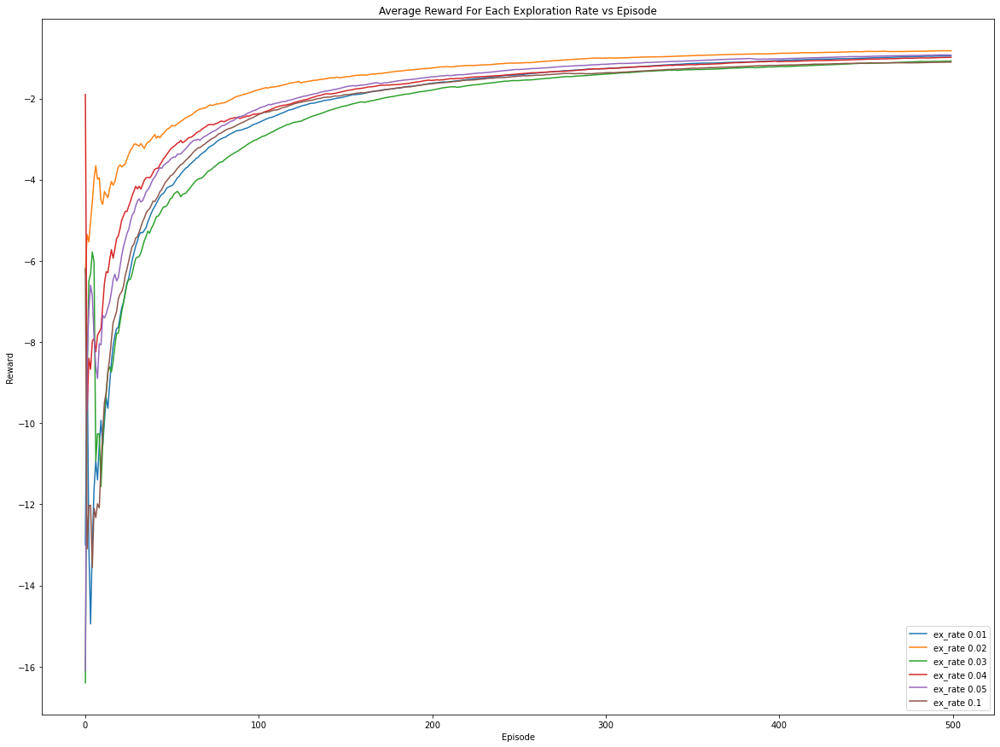

In [15]:
plt.figure(figsize=(20,15))
plt.plot(explore_stats['aggr_ep_rewards'][0]['avg'])
plt.plot(explore_stats['aggr_ep_rewards'][1]['avg'])
plt.plot(explore_stats['aggr_ep_rewards'][2]['avg'])
plt.plot(explore_stats['aggr_ep_rewards'][3]['avg'])
plt.plot(explore_stats['aggr_ep_rewards'][4]['avg'])
plt.plot(explore_stats['aggr_ep_rewards'][5]['avg'])
plt.title('Average Reward For Each Exploration Rate vs Episode')
plt.ylabel('Reward')
plt.xlabel('Episode')
plt.legend(['ex_rate 0.01', 'ex_rate 0.02', 'ex_rate 0.03', 'ex_rate 0.04', 'ex_rate 0.05', 'ex_rate 0.1'], loc='lower right')
plt.show()

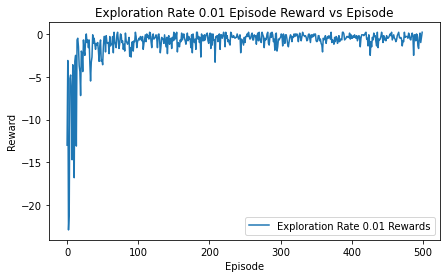

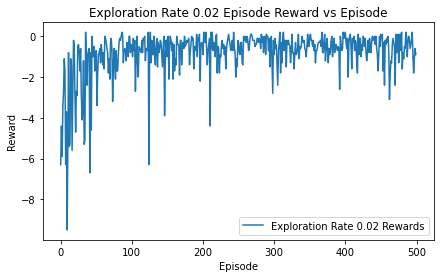

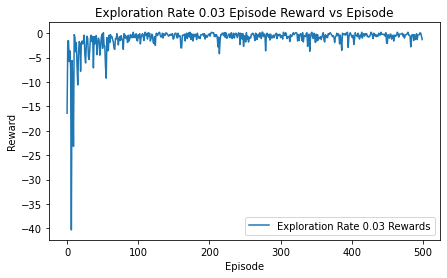

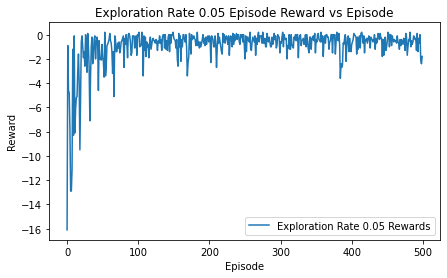

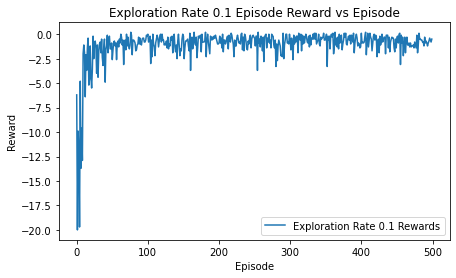

In [16]:
plt.figure(figsize=(7,4))
plt.plot(explore_stats['ep_rewards'][0])
plt.title('Exploration Rate 0.01 Episode Reward vs Episode')
plt.ylabel('Reward')
plt.xlabel('Episode')
plt.legend(['Exploration Rate 0.01 Rewards'], loc='lower right')
plt.show()

plt.figure(figsize=(7,4))
plt.plot(explore_stats['ep_rewards'][1])
plt.title('Exploration Rate 0.02 Episode Reward vs Episode')
plt.ylabel('Reward')
plt.xlabel('Episode')
plt.legend(['Exploration Rate 0.02 Rewards'], loc='lower right')
plt.show()

plt.figure(figsize=(7,4))
plt.plot(explore_stats['ep_rewards'][2])
plt.title('Exploration Rate 0.03 Episode Reward vs Episode')
plt.ylabel('Reward')
plt.xlabel('Episode')
plt.legend(['Exploration Rate 0.03 Rewards'], loc='lower right')
plt.show()

plt.figure(figsize=(7,4))
plt.plot(explore_stats['ep_rewards'][4])
plt.title('Exploration Rate 0.05 Episode Reward vs Episode')
plt.ylabel('Reward')
plt.xlabel('Episode')
plt.legend(['Exploration Rate 0.05 Rewards'], loc='lower right')
plt.show()

plt.figure(figsize=(7,4))
plt.plot(explore_stats['ep_rewards'][5])
plt.title('Exploration Rate 0.1 Episode Reward vs Episode')
plt.ylabel('Reward')
plt.xlabel('Episode')
plt.legend(['Exploration Rate 0.1 Rewards'], loc='lower right')
plt.show()

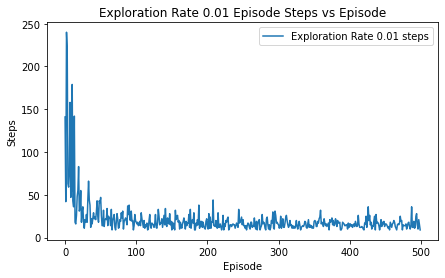

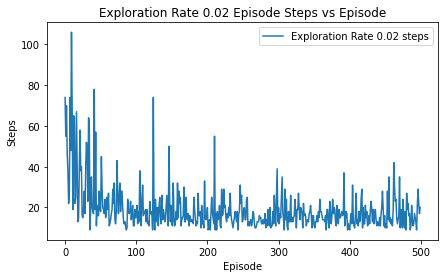

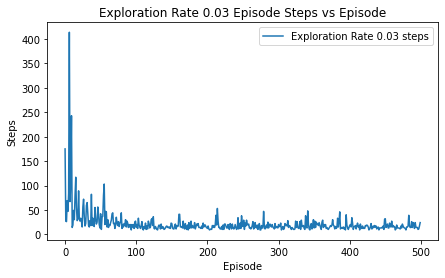

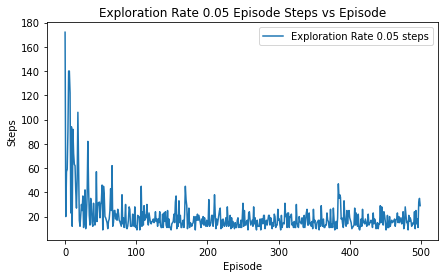

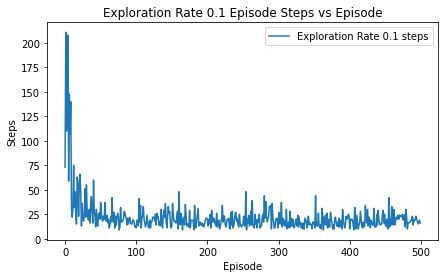

In [17]:
plt.figure(figsize=(7,4))
plt.plot(explore_stats['ep_steps'][0])
plt.title('Exploration Rate 0.01 Episode Steps vs Episode')
plt.ylabel('Steps')
plt.xlabel('Episode')
plt.legend(['Exploration Rate 0.01 steps'], loc='upper right')
plt.show()

plt.figure(figsize=(7,4))
plt.plot(explore_stats['ep_steps'][1])
plt.title('Exploration Rate 0.02 Episode Steps vs Episode')
plt.ylabel('Steps')
plt.xlabel('Episode')
plt.legend(['Exploration Rate 0.02 steps'], loc='upper right')
plt.show()

plt.figure(figsize=(7,4))
plt.plot(explore_stats['ep_steps'][2])
plt.title('Exploration Rate 0.03 Episode Steps vs Episode')
plt.ylabel('Steps')
plt.xlabel('Episode')
plt.legend(['Exploration Rate 0.03 steps'], loc='upper right')
plt.show()

plt.figure(figsize=(7,4))
plt.plot(explore_stats['ep_steps'][4])
plt.title('Exploration Rate 0.05 Episode Steps vs Episode')
plt.ylabel('Steps')
plt.xlabel('Episode')
plt.legend(['Exploration Rate 0.05 steps'], loc='upper right')
plt.show()

plt.figure(figsize=(7,4))
plt.plot(explore_stats['ep_steps'][5])
plt.title('Exploration Rate 0.1 Episode Steps vs Episode')
plt.ylabel('Steps')
plt.xlabel('Episode')
plt.legend(['Exploration Rate 0.1 steps'], loc='upper right')
plt.show()

## Q Agent with Optimized Parameters

In [302]:
# you need to implement your agent based on one RL algorithm
class QAgent(object):
    def __init__(self):
        self.learning_rate = 0.4
        self.discount = 0.99
        self.exploration_rate = 0.02
        self.action_space = ['left','right','forward','backward','up','down'] # in TreasureCube
        self.Q = np.zeros([64,6])

    def take_action(self, state):
        if np.random.random() > self.exploration_rate:
            # Get action from Q table
            print("current state: " + state)
            state = [int(d) for d in str(state)]
            state = state[0] + state[1]*4 + state[2]*16
            action = self.action_space[np.argmax(self.Q[state])]
        else:
            print("random action!!!")
            action = random.choice(self.action_space)
        return action

    # implement your train/update function to update self.V or self.Q
    # you should pass arguments to the train function
    def train(self, state, action, next_state, reward):
        state = [int(d) for d in str(state)]
        state = state[0] + state[1]*4 + state[2]*16
        
        next_state = [int(d) for d in str(next_state)]
        next_state = next_state[0] + next_state[1]*4 + next_state[2]*16
        
        # Maximum possible Q value in next step (for new state)
        max_future_q = np.max(self.Q[next_state])

        # Current Q value (for current state and performed action)
        current_q = self.Q[state,self.action_space.index(action)]

        # And here's our equation for a new Q value for current state and action
        new_q = (1 - self.learning_rate) * current_q + self.learning_rate * (reward + self.discount * max_future_q)

        # Update Q table with new Q value
        self.Q[state,self.action_space.index(action)] = new_q
        
    def q_table(self):
        return self.Q

def test_cube(max_episode, max_step):
    env = TreasureCube(max_step=max_step)
    agent = QAgent()
    SHOW_EP = 100
    SHOW_STEP = 10
    # For stats
    ep_rewards = []
    aggr_ep_rewards = {'ep': [], 'avg': [], 'max': [], 'min': []}
    ep_steps = []

    for epsisode_num in range(0, max_episode):
        state = env.reset()
        terminate = False
        t = 0
        episode_reward = 0
        while not terminate:
            action = agent.take_action(state)
            reward, terminate, next_state = env.step(action)
            episode_reward += reward
            # you can comment the following two lines, if the output is too much
            #if epsisode_num % SHOW_EP == 0 and t % SHOW_STEP == 0:
                #env.render() # comment
            print(f'epsisode: {epsisode_num},step: {t}, action: {action}, reward: {reward}') # comment
            t += 1
            agent.train(state, action, next_state, reward)
            state = next_state
        print(f'epsisode: {epsisode_num}, total_steps: {t} episode reward: {episode_reward}')
        ep_rewards.append(episode_reward)
        ep_steps.append(t)
        aggr_ep_rewards['ep'].append(epsisode_num)
        aggr_ep_rewards['avg'].append(sum(ep_rewards)/(epsisode_num+1))
        aggr_ep_rewards['max'].append(max(ep_rewards))
        aggr_ep_rewards['min'].append(min(ep_rewards))
        
    return agent.q_table(),ep_rewards,aggr_ep_rewards,ep_steps

In [348]:
q,ep_rewards,aggr_ep_rewards,ep_steps = test_cube(500, 500)

current state: 000
epsisode: 0,step: 0, action: left, reward: -0.1
current state: 001
epsisode: 0,step: 1, action: left, reward: -0.1
current state: 001
epsisode: 0,step: 2, action: right, reward: -0.1
current state: 101
epsisode: 0,step: 3, action: left, reward: -0.1
current state: 101
epsisode: 0,step: 4, action: right, reward: -0.1
current state: 001
epsisode: 0,step: 5, action: forward, reward: -0.1
current state: 101
epsisode: 0,step: 6, action: forward, reward: -0.1
current state: 201
epsisode: 0,step: 7, action: left, reward: -0.1
current state: 301
epsisode: 0,step: 8, action: left, reward: -0.1
random action!!!
epsisode: 0,step: 9, action: down, reward: -0.1
current state: 300
epsisode: 0,step: 10, action: left, reward: -0.1
current state: 300
epsisode: 0,step: 11, action: right, reward: -0.1
current state: 300
epsisode: 0,step: 12, action: forward, reward: -0.1
current state: 300
epsisode: 0,step: 13, action: backward, reward: -0.1
current state: 200
epsisode: 0,step: 14, act

current state: 001
epsisode: 13,step: 31, action: up, reward: -0.1
current state: 001
epsisode: 13,step: 32, action: right, reward: -0.1
current state: 011
epsisode: 13,step: 33, action: right, reward: -0.1
current state: 021
epsisode: 13,step: 34, action: backward, reward: -0.1
current state: 021
epsisode: 13,step: 35, action: down, reward: -0.1
current state: 020
epsisode: 13,step: 36, action: left, reward: -0.1
current state: 010
epsisode: 13,step: 37, action: backward, reward: -0.1
current state: 010
epsisode: 13,step: 38, action: forward, reward: -0.1
current state: 000
epsisode: 13,step: 39, action: forward, reward: -0.1
current state: 100
epsisode: 13,step: 40, action: forward, reward: -0.1
current state: 200
epsisode: 13,step: 41, action: forward, reward: -0.1
current state: 300
epsisode: 13,step: 42, action: left, reward: -0.1
current state: 300
epsisode: 13,step: 43, action: forward, reward: -0.1
current state: 300
epsisode: 13,step: 44, action: up, reward: -0.1
current state

epsisode: 75,step: 9, action: right, reward: 1
epsisode: 75, total_steps: 10 episode reward: 0.10000000000000009
current state: 000
epsisode: 76,step: 0, action: up, reward: -0.1
current state: 100
epsisode: 76,step: 1, action: up, reward: -0.1
current state: 101
epsisode: 76,step: 2, action: down, reward: -0.1
current state: 001
epsisode: 76,step: 3, action: backward, reward: -0.1
current state: 000
epsisode: 76,step: 4, action: up, reward: -0.1
current state: 100
epsisode: 76,step: 5, action: up, reward: -0.1
current state: 200
epsisode: 76,step: 6, action: forward, reward: -0.1
current state: 201
epsisode: 76,step: 7, action: up, reward: -0.1
current state: 202
epsisode: 76,step: 8, action: forward, reward: -0.1
current state: 302
epsisode: 76,step: 9, action: right, reward: -0.1
current state: 202
epsisode: 76,step: 10, action: forward, reward: -0.1
current state: 212
epsisode: 76,step: 11, action: up, reward: -0.1
current state: 112
epsisode: 76,step: 12, action: right, reward: -0

epsisode: 163,step: 12, action: right, reward: -0.1
current state: 313
epsisode: 163,step: 13, action: right, reward: -0.1
current state: 312
epsisode: 163,step: 14, action: right, reward: -0.1
current state: 322
epsisode: 163,step: 15, action: up, reward: -0.1
current state: 323
epsisode: 163,step: 16, action: right, reward: -0.1
current state: 323
epsisode: 163,step: 17, action: right, reward: 1
epsisode: 163, total_steps: 18 episode reward: -0.7000000000000004
current state: 000
epsisode: 164,step: 0, action: up, reward: -0.1
current state: 000
epsisode: 164,step: 1, action: up, reward: -0.1
current state: 001
epsisode: 164,step: 2, action: up, reward: -0.1
current state: 011
epsisode: 164,step: 3, action: right, reward: -0.1
current state: 012
epsisode: 164,step: 4, action: up, reward: -0.1
current state: 013
epsisode: 164,step: 5, action: forward, reward: -0.1
current state: 113
epsisode: 164,step: 6, action: forward, reward: -0.1
current state: 123
epsisode: 164,step: 7, action: 

current state: 112
epsisode: 257,step: 12, action: up, reward: -0.1
current state: 102
epsisode: 257,step: 13, action: right, reward: -0.1
current state: 002
epsisode: 257,step: 14, action: forward, reward: -0.1
current state: 012
epsisode: 257,step: 15, action: up, reward: -0.1
current state: 013
epsisode: 257,step: 16, action: forward, reward: -0.1
current state: 113
epsisode: 257,step: 17, action: forward, reward: -0.1
current state: 112
epsisode: 257,step: 18, action: up, reward: -0.1
current state: 122
epsisode: 257,step: 19, action: right, reward: -0.1
current state: 123
epsisode: 257,step: 20, action: right, reward: -0.1
current state: 133
epsisode: 257,step: 21, action: forward, reward: -0.1
current state: 233
epsisode: 257,step: 22, action: forward, reward: -0.1
current state: 233
epsisode: 257,step: 23, action: forward, reward: 1
epsisode: 257, total_steps: 24 episode reward: -1.3000000000000007
current state: 000
epsisode: 258,step: 0, action: up, reward: -0.1
current state:

current state: 012
epsisode: 345,step: 17, action: up, reward: -0.1
current state: 013
epsisode: 345,step: 18, action: forward, reward: -0.1
random action!!!
epsisode: 345,step: 19, action: forward, reward: -0.1
current state: 112
epsisode: 345,step: 20, action: backward, reward: -0.1
current state: 012
epsisode: 345,step: 21, action: up, reward: -0.1
current state: 112
epsisode: 345,step: 22, action: up, reward: -0.1
current state: 113
epsisode: 345,step: 23, action: up, reward: -0.1
current state: 113
epsisode: 345,step: 24, action: forward, reward: -0.1
current state: 213
epsisode: 345,step: 25, action: forward, reward: -0.1
current state: 223
epsisode: 345,step: 26, action: right, reward: -0.1
current state: 233
epsisode: 345,step: 27, action: forward, reward: -0.1
current state: 233
epsisode: 345,step: 28, action: forward, reward: -0.1
current state: 223
epsisode: 345,step: 29, action: right, reward: -0.1
current state: 233
epsisode: 345,step: 30, action: forward, reward: -0.1
cur

current state: 233
epsisode: 428,step: 16, action: forward, reward: 1
epsisode: 428, total_steps: 17 episode reward: -0.6000000000000003
current state: 000
epsisode: 429,step: 0, action: up, reward: -0.1
current state: 001
epsisode: 429,step: 1, action: right, reward: -0.1
current state: 002
epsisode: 429,step: 2, action: forward, reward: -0.1
current state: 102
epsisode: 429,step: 3, action: up, reward: -0.1
current state: 103
epsisode: 429,step: 4, action: right, reward: -0.1
current state: 003
epsisode: 429,step: 5, action: right, reward: -0.1
current state: 103
epsisode: 429,step: 6, action: right, reward: -0.1
current state: 003
epsisode: 429,step: 7, action: right, reward: -0.1
current state: 013
epsisode: 429,step: 8, action: forward, reward: -0.1
current state: 003
epsisode: 429,step: 9, action: right, reward: -0.1
current state: 013
epsisode: 429,step: 10, action: forward, reward: -0.1
current state: 113
epsisode: 429,step: 11, action: forward, reward: -0.1
current state: 113


In [349]:
print("Maximum number of steps for last 100 episodes: " + str(max(ep_steps[-100:])))
print("Average number of steps for last 100 episodes: " + str(sum(ep_steps[-100:])/100))

Maximum number of steps for last 100 episodes: 33
Average number of steps for last 100 episodes: 15.35


In [350]:
count = 0

for i in ep_steps:
    if i < 15:
        count += 1
print("percentage of episodes below 15 steps : " + str(count/len(ep_steps)))

percentage of episodes below 15 steps : 0.42


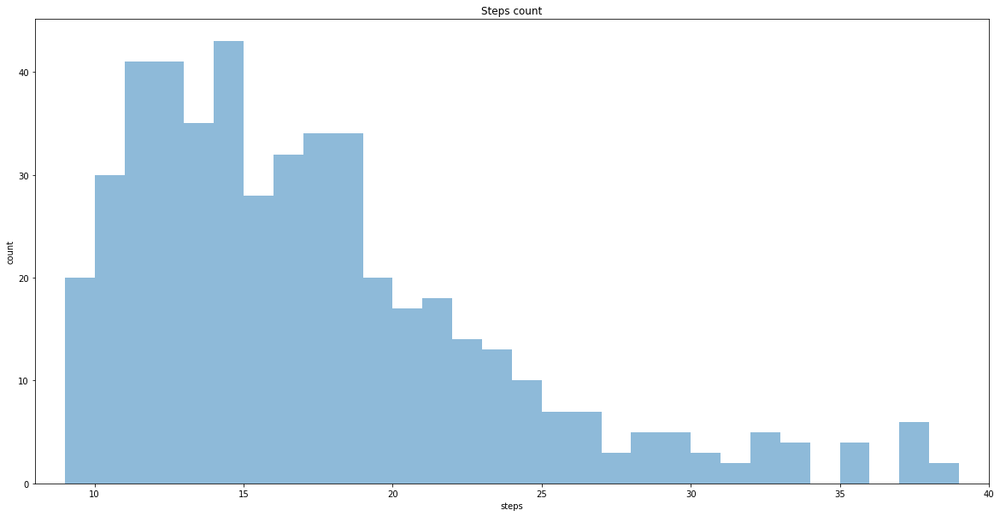

In [351]:
plt.figure(figsize=(20,10))
bins = np.arange(9, 40, 1) # fixed bin size

plt.xlim([8, 40])

plt.hist(ep_steps, bins=bins, alpha=0.5)
plt.title('Steps count')
plt.xlabel('steps')
plt.ylabel('count')

plt.show()

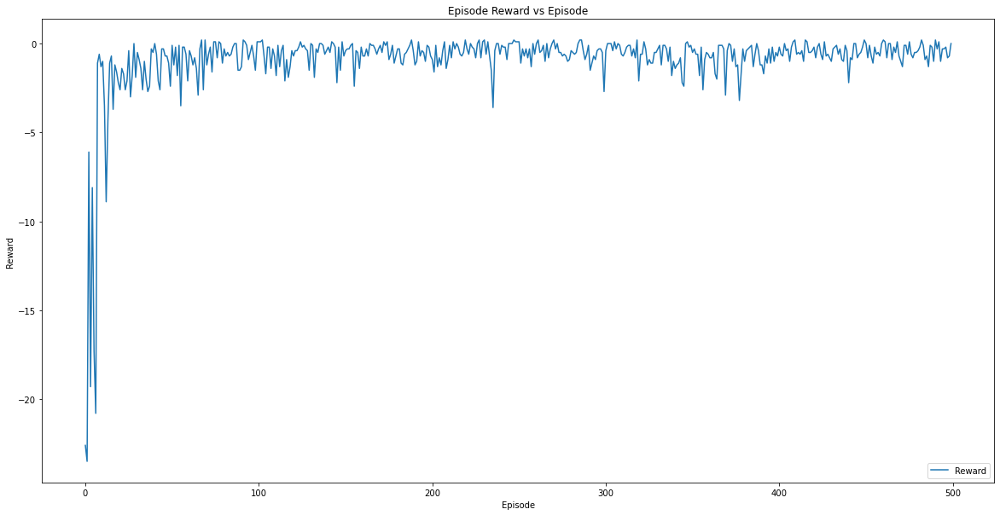

In [352]:
plt.figure(figsize=(20,10))
plt.plot(ep_rewards)
plt.title('Episode Reward vs Episode')
plt.ylabel('Reward')
plt.xlabel('Episode')
plt.legend(['Reward'], loc='lower right')
plt.show()

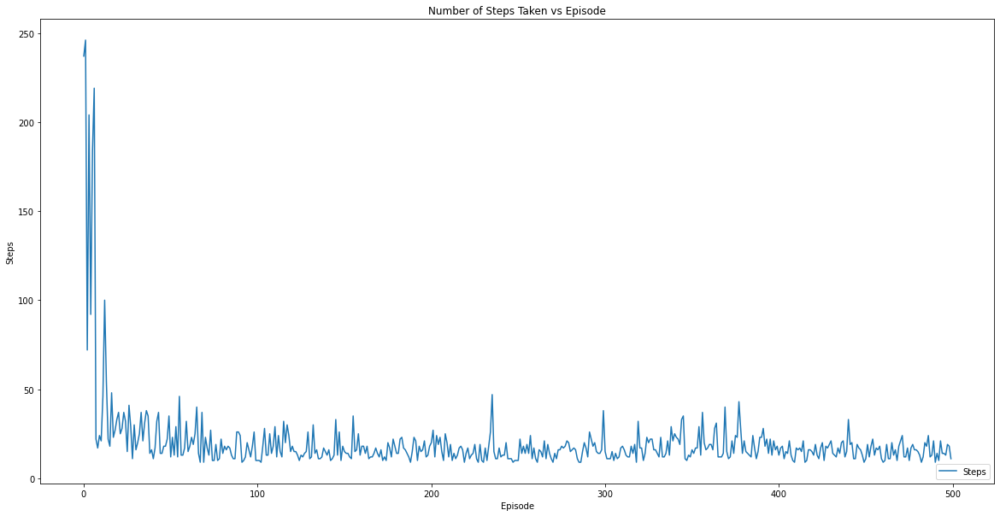

In [353]:
plt.figure(figsize=(20,10))
plt.plot(ep_steps)
plt.title('Number of Steps Taken vs Episode')
plt.ylabel('Steps')
plt.xlabel('Episode')
plt.legend(['Steps'], loc='lower right')
plt.show()

In [354]:
index = []

for i in range(0,4):
    for j in range(0,4):
        for h in range(0,4):
            x = str(i) + ',' + str(j) + ',' + str(h)
            index.append(x)
            
q_table_frame = pd.DataFrame(index,columns=['Grid Position'])
df = pd.DataFrame(data=q, columns=['left','right','forward','backward','up','down'])
q_table_frame = pd.concat([q_table_frame, df], axis=1)
q_table_frame = q_table_frame.set_index('Grid Position')
pd.set_option("display.max_rows", None, "display.max_columns", None)
q_table_frame

,left,right,forward,backward,up,down
Grid Position,,,,,,
"0,0,0",-0.639693,-0.628977,-0.398674,-0.615944,-0.614762,-0.631223
"0,0,1",-0.543557,-0.507098,-0.249475,-0.526513,-0.510369,-0.510125
"0,0,2",-0.413695,-0.380802,-0.110807,-0.429990,-0.412752,-0.395753
"0,0,3",-0.288079,-0.011573,-0.263027,-0.306892,-0.266028,-0.297551
"0,1,0",-0.509045,-0.217684,-0.507215,-0.527989,-0.541483,-0.532265
"0,1,1",-0.405287,-0.400575,-0.436495,-0.412390,-0.165680,-0.436773
"0,1,2",-0.328238,-0.347796,-0.331035,-0.346488,-0.157518,-0.340976
"0,1,3",-0.167877,-0.113154,-0.240654,-0.277473,0.224120,-0.232663
"0,2,0",-0.432865,-0.320399,-0.426024,-0.461357,-0.139211,-0.432993


In [355]:
class TestAgent(object):
    def __init__(self,q_table):
        self.action_space = ['left','right','forward','backward','up','down'] # in TreasureCube
        self.Q = q_table

    def take_action(self, state):

        print("current state: " + state)
        state = [int(d) for d in str(state)]
        state = state[0] + state[1]*4 + state[2]*16
        action = self.action_space[np.argmax(self.Q[state])]
   
        return action

def test(max_episode, max_step,q_table):
    env = TreasureCube(max_step=max_step)
    agent = TestAgent(q_table)
    SHOW_EP = 100
    SHOW_STEP = 10
    # For stats
    ep_rewards = []
    aggr_ep_rewards = {'ep': [], 'avg': [], 'max': [], 'min': []}
    ep_steps = []

    for epsisode_num in range(0, max_episode):
        state = env.reset()
        terminate = False
        t = 0
        episode_reward = 0
        while not terminate:
            action = agent.take_action(state)
            reward, terminate, next_state = env.step(action)
            episode_reward += reward
            # you can comment the following two lines, if the output is too much
            #if epsisode_num % SHOW_EP == 0 and t % SHOW_STEP == 0:
                #env.render() # comment
            print(f'epsisode: {epsisode_num},step: {t}, action: {action}, reward: {reward}') # comment
            t += 1
            state = next_state
        print(f'epsisode: {epsisode_num}, total_steps: {t} episode reward: {episode_reward}')
        ep_rewards.append(episode_reward)
        ep_steps.append(t)
        aggr_ep_rewards['ep'].append(epsisode_num)
        aggr_ep_rewards['avg'].append(sum(ep_rewards)/(epsisode_num+1))
        aggr_ep_rewards['max'].append(max(ep_rewards))
        aggr_ep_rewards['min'].append(min(ep_rewards))
        
    return ep_rewards,ep_steps,aggr_ep_rewards

In [356]:
ep_rewards,ep_steps,aggr_ep_rewards = test(100, 500,q)

current state: 000
epsisode: 0,step: 0, action: forward, reward: -0.1
current state: 000
epsisode: 0,step: 1, action: forward, reward: -0.1
current state: 100
epsisode: 0,step: 2, action: forward, reward: -0.1
current state: 101
epsisode: 0,step: 3, action: up, reward: -0.1
current state: 102
epsisode: 0,step: 4, action: up, reward: -0.1
current state: 002
epsisode: 0,step: 5, action: forward, reward: -0.1
current state: 102
epsisode: 0,step: 6, action: up, reward: -0.1
current state: 103
epsisode: 0,step: 7, action: right, reward: -0.1
current state: 203
epsisode: 0,step: 8, action: right, reward: -0.1
current state: 213
epsisode: 0,step: 9, action: forward, reward: -0.1
current state: 313
epsisode: 0,step: 10, action: right, reward: -0.1
current state: 323
epsisode: 0,step: 11, action: right, reward: 1
epsisode: 0, total_steps: 12 episode reward: -0.09999999999999987
current state: 000
epsisode: 1,step: 0, action: forward, reward: -0.1
current state: 001
epsisode: 1,step: 1, action: 

In [357]:
print("Maximum number of steps : " + str(max(ep_steps)))
print("Average number of steps: " + str(sum(ep_steps)/100))

Maximum number of steps : 27
Average number of steps: 14.72


In [358]:
count = 0

for i in ep_steps:
    if i < 15:
        count += 1
print("percentage of episodes below 15 steps : " + str(count/len(ep_steps)))

percentage of episodes below 15 steps : 0.57


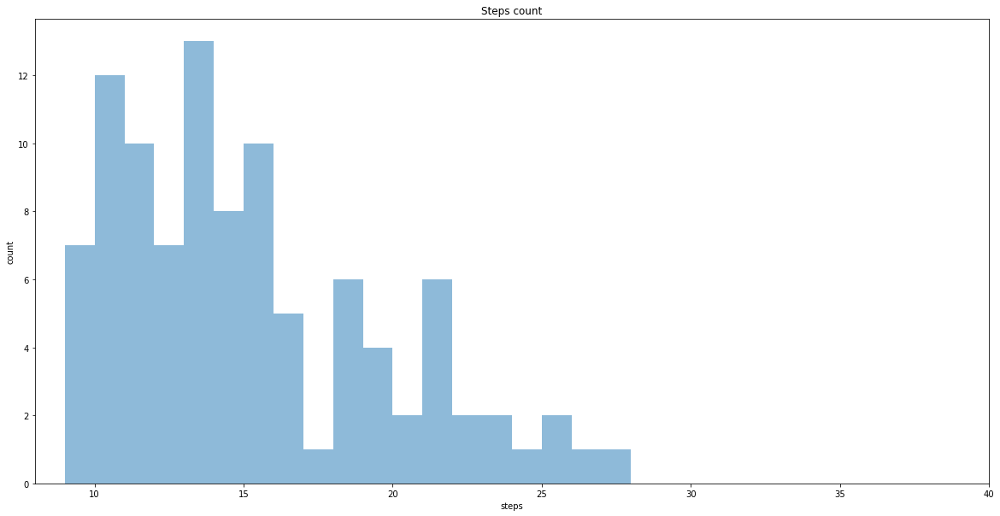

In [359]:
plt.figure(figsize=(20,10))
bins = np.arange(9, 40, 1) # fixed bin size

plt.xlim([8, 40])

plt.hist(ep_steps, bins=bins, alpha=0.5)
plt.title('Steps count')
plt.xlabel('steps')
plt.ylabel('count')

plt.show()

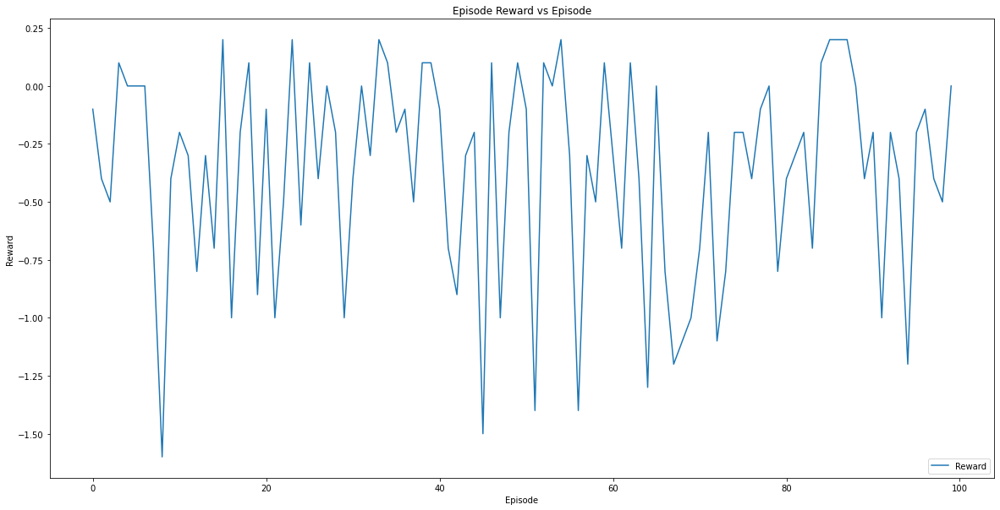

In [360]:
plt.figure(figsize=(20,10))
plt.plot(ep_rewards)
plt.title('Episode Reward vs Episode')
plt.ylabel('Reward')
plt.xlabel('Episode')
plt.legend(['Reward'], loc='lower right')
plt.show()

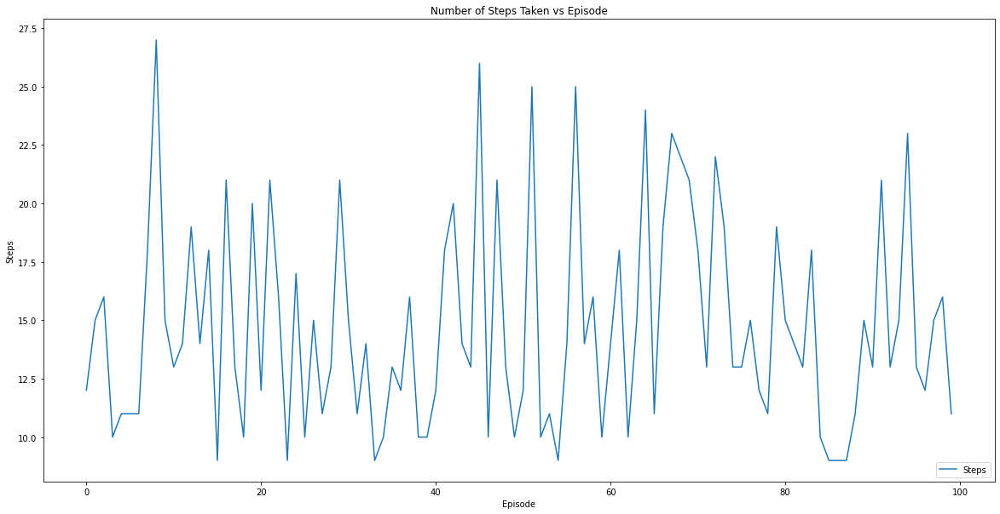

In [361]:
plt.figure(figsize=(20,10))
plt.plot(ep_steps)
plt.title('Number of Steps Taken vs Episode')
plt.ylabel('Steps')
plt.xlabel('Episode')
plt.legend(['Steps'], loc='lower right')
plt.show()

## Q Agent Decaying Exploration Rate

In [437]:

class QAgent(object):
    def __init__(self):
        self.learning_rate = 0.4
        self.discount = 0.99
        self.exploration_rate = 0.5
        self.action_space = ['left','right','forward','backward','up','down'] # in TreasureCube
        self.Q = np.zeros([64,6])
        self.START_EPSILON_DECAYING = 1
        self.END_EPSILON_DECAYING = 200//2
        self.epsilon_decay_value = 0.49/(self.END_EPSILON_DECAYING - self.START_EPSILON_DECAYING)

    def take_action(self, state):
        if np.random.random() > self.exploration_rate:
            # Get action from Q table
            print("current state: " + state)
            state = [int(d) for d in str(state)]
            state = state[0] + state[1]*4 + state[2]*16
            action = self.action_space[np.argmax(self.Q[state])]
        else:
            print("random action!!!")
            action = random.choice(self.action_space)
   
        return action

    # implement your train/update function to update self.V or self.Q
    # you should pass arguments to the train function
    def train(self, state, action, next_state, reward):
        state = [int(d) for d in str(state)]
        state = state[0] + state[1]*4 + state[2]*16
        
        next_state = [int(d) for d in str(next_state)]
        next_state = next_state[0] + next_state[1]*4 + next_state[2]*16
        
        # Maximum possible Q value in next step (for new state)
        max_future_q = np.max(self.Q[next_state])

        # Current Q value (for current state and performed action)
        current_q = self.Q[state,self.action_space.index(action)]

        # And here's our equation for a new Q value for current state and action
        new_q = (1 - self.learning_rate) * current_q + self.learning_rate * (reward + self.discount * max_future_q)

        # Update Q table with new Q value
        self.Q[state,self.action_space.index(action)] = new_q
        
    def q_table(self):
        return self.Q
    def update_exploration_rate(self,episode):
        if self.END_EPSILON_DECAYING >= episode >= self.START_EPSILON_DECAYING:
            if(self.exploration_rate > self.epsilon_decay_value):
                self.exploration_rate -= self.epsilon_decay_value
            print("new exploration rate: " + str(self.exploration_rate))
        if episode >= 100:
            self.exploration_rate = 0

def test_cube(max_episode, max_step):
    env = TreasureCube(max_step=max_step)
    agent = QAgent()
    SHOW_EP = 100
    SHOW_STEP = 10
    # For stats
    ep_rewards = []
    aggr_ep_rewards = {'ep': [], 'avg': [], 'max': [], 'min': []}
    ep_steps = []

    for epsisode_num in range(0, max_episode):
        state = env.reset()
        terminate = False
        t = 0
        episode_reward = 0
        while not terminate:
            action = agent.take_action(state)
            reward, terminate, next_state = env.step(action)
            episode_reward += reward
            # you can comment the following two lines, if the output is too much
            #if epsisode_num % SHOW_EP == 0 and t % SHOW_STEP == 0:
                #env.render() # comment
            print(f'epsisode: {epsisode_num},step: {t}, action: {action}, reward: {reward}') # comment
            t += 1
            agent.train(state, action, next_state, reward)
            state = next_state
        print(f'epsisode: {epsisode_num}, total_steps: {t} episode reward: {episode_reward}')
        ep_rewards.append(episode_reward)
        ep_steps.append(t)
        aggr_ep_rewards['ep'].append(epsisode_num)
        aggr_ep_rewards['avg'].append(sum(ep_rewards)/(epsisode_num+1))
        aggr_ep_rewards['max'].append(max(ep_rewards))
        aggr_ep_rewards['min'].append(min(ep_rewards))
        agent.update_exploration_rate(epsisode_num)
        
    return agent.q_table(),ep_rewards,ep_steps,aggr_ep_rewards

In [453]:
q_table,ep_rewards,ep_steps,aggr_ep_rewards = test_cube(500, 500)

current state: 000
epsisode: 0,step: 0, action: left, reward: -0.1
random action!!!
epsisode: 0,step: 1, action: left, reward: -0.1
current state: 101
epsisode: 0,step: 2, action: left, reward: -0.1
current state: 101
epsisode: 0,step: 3, action: right, reward: -0.1
random action!!!
epsisode: 0,step: 4, action: up, reward: -0.1
current state: 101
epsisode: 0,step: 5, action: forward, reward: -0.1
random action!!!
epsisode: 0,step: 6, action: up, reward: -0.1
current state: 202
epsisode: 0,step: 7, action: left, reward: -0.1
random action!!!
epsisode: 0,step: 8, action: down, reward: -0.1
random action!!!
epsisode: 0,step: 9, action: up, reward: -0.1
random action!!!
epsisode: 0,step: 10, action: backward, reward: -0.1
current state: 302
epsisode: 0,step: 11, action: left, reward: -0.1
random action!!!
epsisode: 0,step: 12, action: left, reward: -0.1
random action!!!
epsisode: 0,step: 13, action: up, reward: -0.1
current state: 303
epsisode: 0,step: 14, action: left, reward: -0.1
curren

current state: 321
epsisode: 18,step: 22, action: up, reward: -0.1
current state: 322
epsisode: 18,step: 23, action: right, reward: -0.1
current state: 332
epsisode: 18,step: 24, action: up, reward: 1
epsisode: 18, total_steps: 25 episode reward: -1.4000000000000008
new exploration rate: 0.41090909090909133
random action!!!
epsisode: 19,step: 0, action: up, reward: -0.1
random action!!!
epsisode: 19,step: 1, action: up, reward: -0.1
current state: 000
epsisode: 19,step: 2, action: right, reward: -0.1
random action!!!
epsisode: 19,step: 3, action: up, reward: -0.1
current state: 011
epsisode: 19,step: 4, action: forward, reward: -0.1
random action!!!
epsisode: 19,step: 5, action: up, reward: -0.1
current state: 112
epsisode: 19,step: 6, action: forward, reward: -0.1
current state: 212
epsisode: 19,step: 7, action: left, reward: -0.1
current state: 202
epsisode: 19,step: 8, action: forward, reward: -0.1
random action!!!
epsisode: 19,step: 9, action: right, reward: -0.1
current state: 312

random action!!!
epsisode: 65,step: 0, action: up, reward: -0.1
random action!!!
epsisode: 65,step: 1, action: right, reward: -0.1
current state: 110
epsisode: 65,step: 2, action: backward, reward: -0.1
current state: 010
epsisode: 65,step: 3, action: up, reward: -0.1
current state: 011
epsisode: 65,step: 4, action: up, reward: -0.1
current state: 001
epsisode: 65,step: 5, action: up, reward: -0.1
random action!!!
epsisode: 65,step: 6, action: backward, reward: -0.1
current state: 002
epsisode: 65,step: 7, action: up, reward: -0.1
current state: 003
epsisode: 65,step: 8, action: right, reward: -0.1
current state: 013
epsisode: 65,step: 9, action: forward, reward: -0.1
current state: 113
epsisode: 65,step: 10, action: right, reward: -0.1
random action!!!
epsisode: 65,step: 11, action: left, reward: -0.1
random action!!!
epsisode: 65,step: 12, action: forward, reward: -0.1
current state: 313
epsisode: 65,step: 13, action: right, reward: -0.1
random action!!!
epsisode: 65,step: 14, action

epsisode: 147,step: 6, action: right, reward: -0.1
current state: 221
epsisode: 147,step: 7, action: up, reward: -0.1
current state: 121
epsisode: 147,step: 8, action: right, reward: -0.1
current state: 131
epsisode: 147,step: 9, action: up, reward: -0.1
current state: 131
epsisode: 147,step: 10, action: up, reward: -0.1
current state: 132
epsisode: 147,step: 11, action: up, reward: -0.1
current state: 133
epsisode: 147,step: 12, action: forward, reward: -0.1
current state: 133
epsisode: 147,step: 13, action: forward, reward: -0.1
current state: 233
epsisode: 147,step: 14, action: forward, reward: -0.1
current state: 232
epsisode: 147,step: 15, action: up, reward: -0.1
current state: 232
epsisode: 147,step: 16, action: up, reward: -0.1
current state: 233
epsisode: 147,step: 17, action: forward, reward: 1
epsisode: 147, total_steps: 18 episode reward: -0.7000000000000004
current state: 000
epsisode: 148,step: 0, action: forward, reward: -0.1
current state: 000
epsisode: 148,step: 1, act

epsisode: 241,step: 4, action: right, reward: -0.1
current state: 110
epsisode: 241,step: 5, action: up, reward: -0.1
current state: 120
epsisode: 241,step: 6, action: forward, reward: -0.1
current state: 220
epsisode: 241,step: 7, action: right, reward: -0.1
current state: 230
epsisode: 241,step: 8, action: forward, reward: -0.1
current state: 330
epsisode: 241,step: 9, action: up, reward: -0.1
current state: 331
epsisode: 241,step: 10, action: up, reward: -0.1
current state: 331
epsisode: 241,step: 11, action: up, reward: -0.1
current state: 321
epsisode: 241,step: 12, action: up, reward: -0.1
current state: 322
epsisode: 241,step: 13, action: right, reward: -0.1
current state: 323
epsisode: 241,step: 14, action: right, reward: 1
epsisode: 241, total_steps: 15 episode reward: -0.40000000000000013
current state: 000
epsisode: 242,step: 0, action: forward, reward: -0.1
current state: 100
epsisode: 242,step: 1, action: forward, reward: -0.1
current state: 110
epsisode: 242,step: 2, acti

epsisode: 328,step: 8, action: forward, reward: -0.1
current state: 233
epsisode: 328,step: 9, action: forward, reward: 1
epsisode: 328, total_steps: 10 episode reward: 0.10000000000000009
current state: 000
epsisode: 329,step: 0, action: forward, reward: -0.1
current state: 000
epsisode: 329,step: 1, action: forward, reward: -0.1
current state: 010
epsisode: 329,step: 2, action: right, reward: -0.1
current state: 020
epsisode: 329,step: 3, action: right, reward: -0.1
current state: 020
epsisode: 329,step: 4, action: right, reward: -0.1
current state: 020
epsisode: 329,step: 5, action: right, reward: -0.1
current state: 030
epsisode: 329,step: 6, action: up, reward: -0.1
current state: 031
epsisode: 329,step: 7, action: up, reward: -0.1
current state: 032
epsisode: 329,step: 8, action: up, reward: -0.1
current state: 022
epsisode: 329,step: 9, action: right, reward: -0.1
current state: 032
epsisode: 329,step: 10, action: up, reward: -0.1
current state: 033
epsisode: 329,step: 11, actio

epsisode: 432,step: 2, action: forward, reward: -0.1
current state: 210
epsisode: 432,step: 3, action: right, reward: -0.1
current state: 310
epsisode: 432,step: 4, action: up, reward: -0.1
current state: 311
epsisode: 432,step: 5, action: right, reward: -0.1
current state: 321
epsisode: 432,step: 6, action: up, reward: -0.1
current state: 331
epsisode: 432,step: 7, action: up, reward: -0.1
current state: 321
epsisode: 432,step: 8, action: up, reward: -0.1
current state: 322
epsisode: 432,step: 9, action: right, reward: -0.1
current state: 332
epsisode: 432,step: 10, action: up, reward: -0.1
current state: 322
epsisode: 432,step: 11, action: right, reward: -0.1
current state: 332
epsisode: 432,step: 12, action: up, reward: -0.1
current state: 322
epsisode: 432,step: 13, action: right, reward: -0.1
current state: 323
epsisode: 432,step: 14, action: right, reward: -0.1
current state: 322
epsisode: 432,step: 15, action: right, reward: -0.1
current state: 332
epsisode: 432,step: 16, action

In [454]:
print("Maximum reward: " + str(max(aggr_ep_rewards['max'])))

Maximum reward: 0.20000000000000007


In [455]:
print("Maximum number of steps for last 200 episodes: " + str(max(ep_steps[-200:])))

Maximum number of steps for last 200 episodes: 47


In [456]:
print("Average number of steps for last 200 episodes: " + str(sum(ep_steps[-200:])/200))

Average number of steps for last 200 episodes: 14.82


In [457]:
count = 0

for i in ep_steps:
    if i < 15:
        count += 1
print("percentage of episodes below 15 steps : " + str(count/len(ep_steps)))

percentage of episodes below 15 steps : 0.466


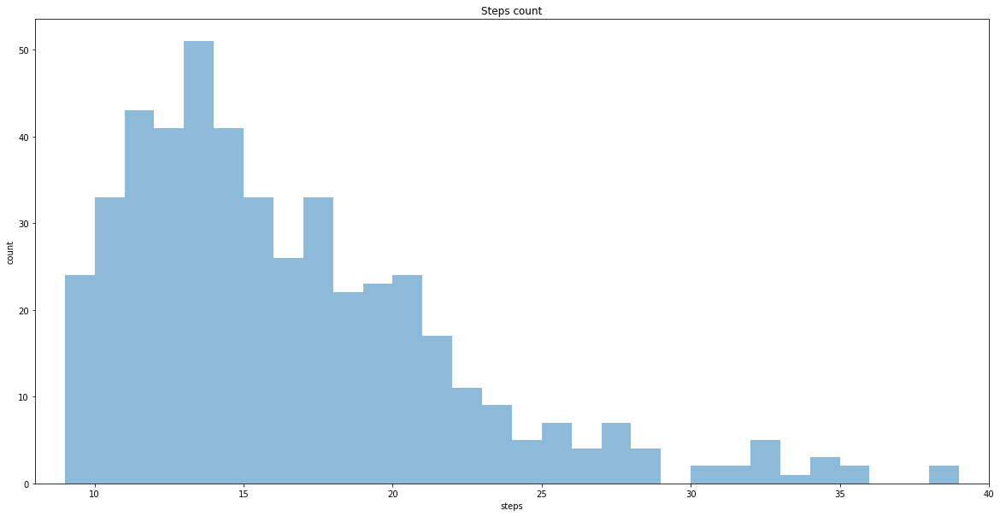

In [458]:
plt.figure(figsize=(20,10))
bins = np.arange(9, 40, 1) # fixed bin size

plt.xlim([8, 40])

plt.hist(ep_steps, bins=bins, alpha=0.5)
plt.title('Steps count')
plt.xlabel('steps')
plt.ylabel('count')

plt.show()

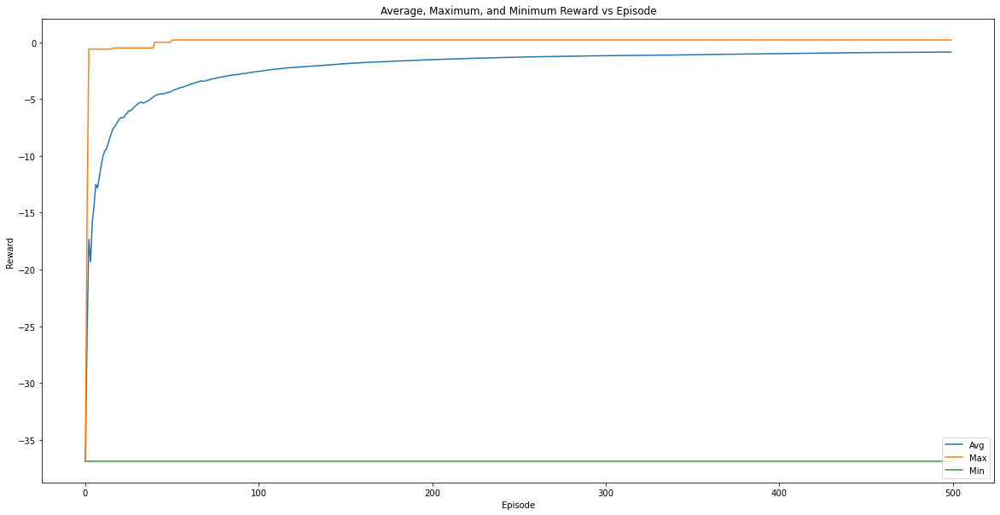

In [459]:
plt.figure(figsize=(20,10))
plt.plot(aggr_ep_rewards['avg'])
plt.plot(aggr_ep_rewards['max'])
plt.plot(aggr_ep_rewards['min'])
plt.title('Average, Maximum, and Minimum Reward vs Episode')
plt.ylabel('Reward')
plt.xlabel('Episode')
plt.legend(['Avg', 'Max', 'Min'], loc='lower right')
plt.show()

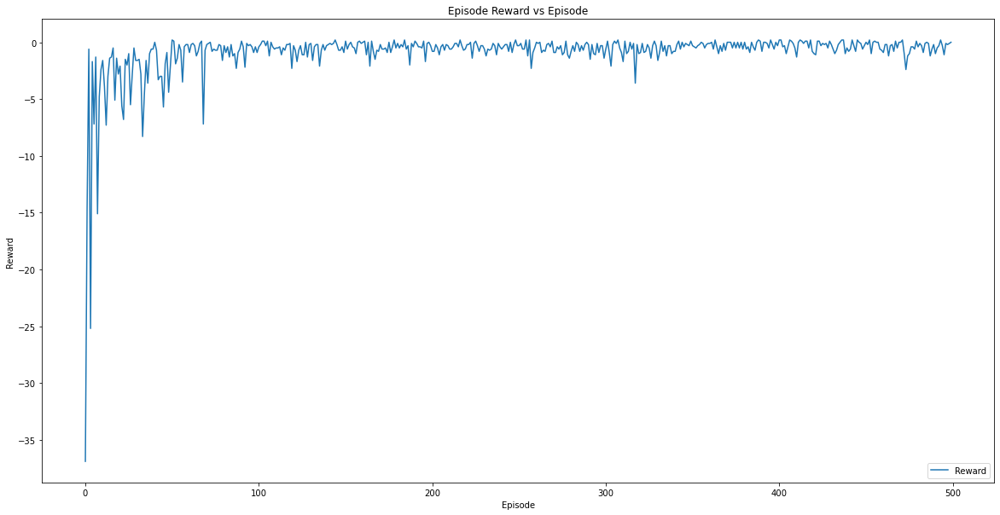

In [460]:
plt.figure(figsize=(20,10))
plt.plot(ep_rewards)
plt.title('Episode Reward vs Episode')
plt.ylabel('Reward')
plt.xlabel('Episode')
plt.legend(['Reward'], loc='lower right')
plt.show()

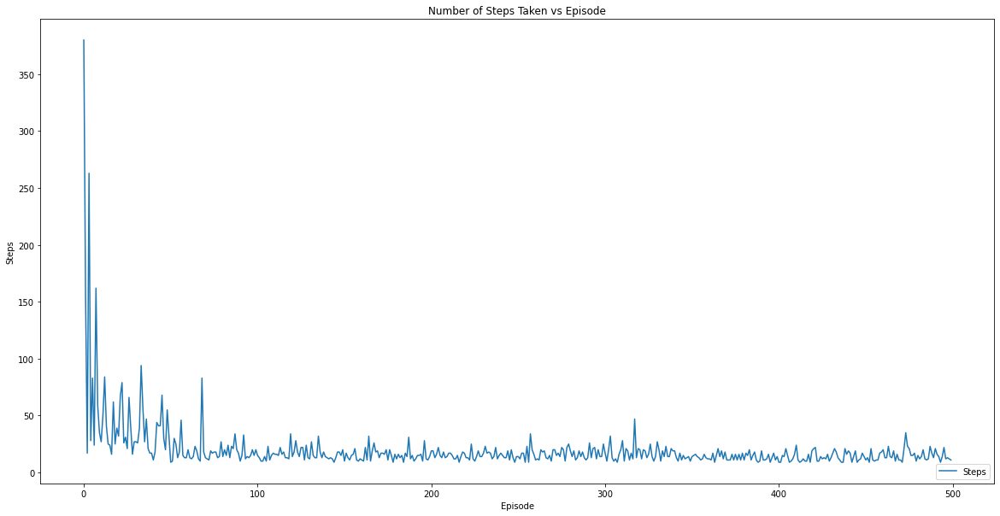

In [461]:
plt.figure(figsize=(20,10))
plt.plot(ep_steps)
plt.title('Number of Steps Taken vs Episode')
plt.ylabel('Steps')
plt.xlabel('Episode')
plt.legend(['Steps'], loc='lower right')
plt.show()

In [462]:
q_table.shape

(64, 6)

In [464]:
index = []

for i in range(0,4):
    for j in range(0,4):
        for h in range(0,4):
            x = str(i) + ',' + str(j) + ',' + str(h)
            index.append(x)
            
q_table_frame = pd.DataFrame(index,columns=['Grid Position'])
df = pd.DataFrame(data=q_table, columns=['left','right','forward','backward','up','down'])
q_table_frame = pd.concat([q_table_frame, df], axis=1)
q_table_frame = q_table_frame.set_index('Grid Position')
pd.set_option("display.max_rows", None, "display.max_columns", None)
q_table_frame

,left,right,forward,backward,up,down
Grid Position,,,,,,
"0,0,0",-0.608452,-0.604384,-0.404238,-0.583929,-0.585965,-0.580963
"0,0,1",-0.555387,-0.529710,-0.218333,-0.534110,-0.566530,-0.530575
"0,0,2",-0.409795,-0.408571,-0.099161,-0.419755,-0.400088,-0.381877
"0,0,3",-0.344062,-0.045716,-0.365530,-0.353337,-0.353052,-0.348427
"0,1,0",-0.490956,-0.483705,-0.384431,-0.479925,-0.510152,-0.503187
"0,1,1",-0.422717,-0.432426,-0.428443,-0.431733,-0.101722,-0.428030
"0,1,2",-0.284552,0.043316,-0.310478,-0.354021,-0.297275,-0.274162
"0,1,3",-0.295714,-0.251173,-0.213491,-0.250858,0.000545,-0.250207
"0,2,0",-0.394553,-0.152315,-0.337077,-0.357910,-0.406288,-0.369538


In [465]:
class TestAgent(object):
    def __init__(self,q_table):
        self.action_space = ['left','right','forward','backward','up','down'] # in TreasureCube
        self.Q = q_table

    def take_action(self, state):

        print("current state: " + state)
        state = [int(d) for d in str(state)]
        state = state[0] + state[1]*4 + state[2]*16
        action = self.action_space[np.argmax(self.Q[state])]
   
        return action

def test(max_episode, max_step,q_table):
    env = TreasureCube(max_step=max_step)
    agent = TestAgent(q_table)
    SHOW_EP = 100
    SHOW_STEP = 10
    # For stats
    ep_rewards = []
    aggr_ep_rewards = {'ep': [], 'avg': [], 'max': [], 'min': []}
    ep_steps = []

    for epsisode_num in range(0, max_episode):
        state = env.reset()
        terminate = False
        t = 0
        episode_reward = 0
        while not terminate:
            action = agent.take_action(state)
            reward, terminate, next_state = env.step(action)
            episode_reward += reward
            # you can comment the following two lines, if the output is too much
            #if epsisode_num % SHOW_EP == 0 and t % SHOW_STEP == 0:
                #env.render() # comment
            print(f'epsisode: {epsisode_num},step: {t}, action: {action}, reward: {reward}') # comment
            t += 1
            state = next_state
        print(f'epsisode: {epsisode_num}, total_steps: {t} episode reward: {episode_reward}')
        ep_rewards.append(episode_reward)
        ep_steps.append(t)
        aggr_ep_rewards['ep'].append(epsisode_num)
        aggr_ep_rewards['avg'].append(sum(ep_rewards)/(epsisode_num+1))
        aggr_ep_rewards['max'].append(max(ep_rewards))
        aggr_ep_rewards['min'].append(min(ep_rewards))
        
    return ep_rewards,ep_steps,aggr_ep_rewards

In [466]:
ep_rewards,ep_steps,aggr_ep_rewards = test(100, 500,q_table)

current state: 000
epsisode: 0,step: 0, action: forward, reward: -0.1
current state: 000
epsisode: 0,step: 1, action: forward, reward: -0.1
current state: 100
epsisode: 0,step: 2, action: forward, reward: -0.1
current state: 101
epsisode: 0,step: 3, action: up, reward: -0.1
current state: 102
epsisode: 0,step: 4, action: right, reward: -0.1
current state: 002
epsisode: 0,step: 5, action: forward, reward: -0.1
current state: 102
epsisode: 0,step: 6, action: right, reward: -0.1
current state: 112
epsisode: 0,step: 7, action: up, reward: -0.1
current state: 212
epsisode: 0,step: 8, action: right, reward: -0.1
current state: 222
epsisode: 0,step: 9, action: up, reward: -0.1
current state: 223
epsisode: 0,step: 10, action: right, reward: -0.1
current state: 233
epsisode: 0,step: 11, action: forward, reward: 1
epsisode: 0, total_steps: 12 episode reward: -0.09999999999999987
current state: 000
epsisode: 1,step: 0, action: forward, reward: -0.1
current state: 001
epsisode: 1,step: 1, action: 

In [472]:
print("Maximum number of steps : " + str(max(ep_steps)))
print("Average number of steps: " + str(sum(ep_steps)/100))

count = 0

for i in ep_steps:
    if i < 15:
        count += 1
print("percentage of episodes below 15 steps : " + str(count/len(ep_steps)))

Maximum number of steps : 33
Average number of steps: 14.67
percentage of episodes below 15 steps : 0.56


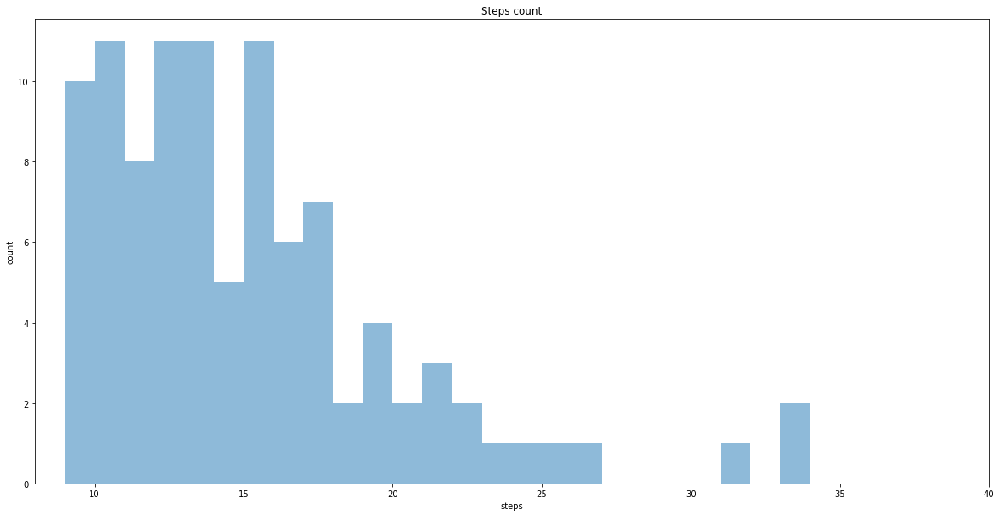

In [468]:
plt.figure(figsize=(20,10))
bins = np.arange(9, 40, 1) # fixed bin size

plt.xlim([8, 40])

plt.hist(ep_steps, bins=bins, alpha=0.5)
plt.title('Steps count')
plt.xlabel('steps')
plt.ylabel('count')

plt.show()

In [474]:
from collections import Counter

Counter(ep_steps)

Counter({12: 11,
         15: 11,
         17: 7,
         10: 11,
         20: 2,
         24: 1,
         11: 8,
         16: 6,
         23: 1,
         13: 11,
         9: 10,
         14: 5,
         19: 4,
         31: 1,
         25: 1,
         33: 2,
         22: 2,
         21: 3,
         26: 1,
         18: 2})

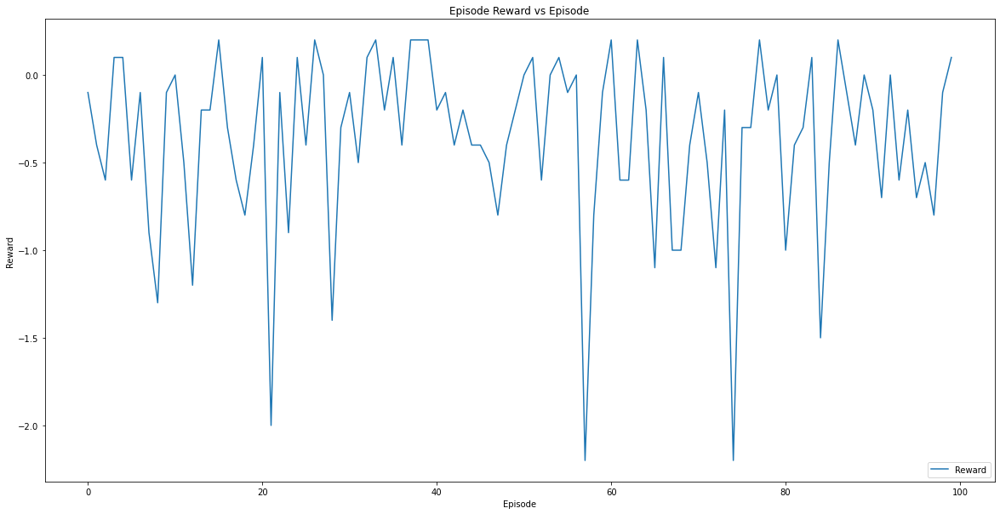

In [469]:
plt.figure(figsize=(20,10))
plt.plot(ep_rewards)
plt.title('Episode Reward vs Episode')
plt.ylabel('Reward')
plt.xlabel('Episode')
plt.legend(['Reward'], loc='lower right')
plt.show()

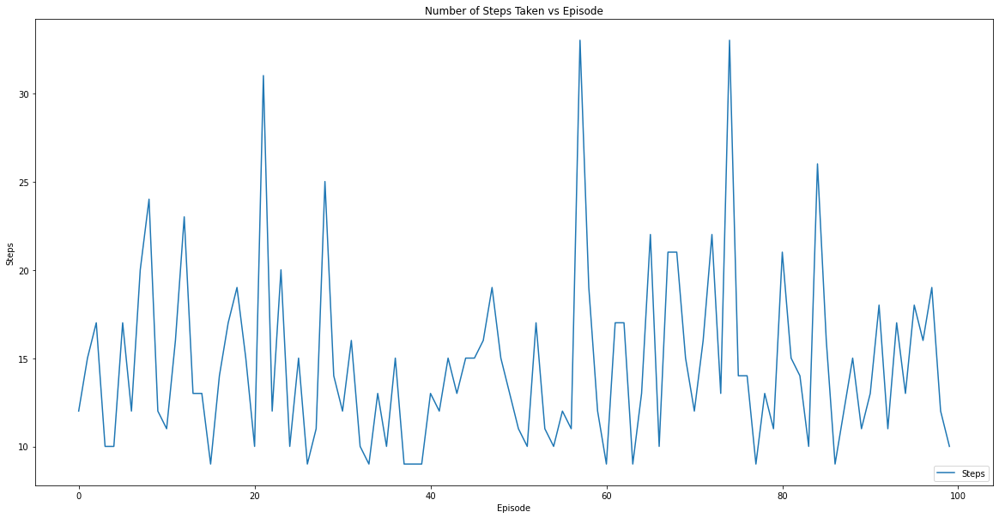

In [470]:
plt.figure(figsize=(20,10))
plt.plot(ep_steps)
plt.title('Number of Steps Taken vs Episode')
plt.ylabel('Steps')
plt.xlabel('Episode')
plt.legend(['Steps'], loc='lower right')
plt.show()

In [473]:
q_table_frame.to_csv('q_table.csv')

## Extra: Q Agent Decaying Learning Rate & Decaying Exploration Rate

In [1043]:

class QAgent(object):
    def __init__(self):
        self.learning_rate = 0.9
        self.discount = 0.99
        self.exploration_rate = 0
        self.action_space = ['left','right','forward','backward','up','down'] # in TreasureCube
        self.Q = np.zeros([64,6])
        self.START_LEARNING_DECAYING = 1
        self.END_LEARNING_DECAYING = 600//2
        self.LEARNING_decay_value = 0.7/(self.END_LEARNING_DECAYING - self.START_LEARNING_DECAYING)
        self.START_EPSILON_DECAYING = 21
        self.END_EPSILON_DECAYING = 200//2
        self.epsilon_decay_value = 0.49/(self.END_EPSILON_DECAYING - self.START_EPSILON_DECAYING)

    def take_action(self, state):
        if np.random.random() > self.exploration_rate:
            # Get action from Q table
            print("current state: " + state)
            state = [int(d) for d in str(state)]
            state = state[0] + state[1]*4 + state[2]*16
            action = self.action_space[np.argmax(self.Q[state])]
        else:
            print("random action!!!")
            action = random.choice(self.action_space)
   
        return action

    # implement your train/update function to update self.V or self.Q
    # you should pass arguments to the train function
    def train(self, state, action, next_state, reward):
        state = [int(d) for d in str(state)]
        state = state[0] + state[1]*4 + state[2]*16
        
        next_state = [int(d) for d in str(next_state)]
        next_state = next_state[0] + next_state[1]*4 + next_state[2]*16
        
        # Maximum possible Q value in next step (for new state)
        max_future_q = np.max(self.Q[next_state])

        # Current Q value (for current state and performed action)
        current_q = self.Q[state,self.action_space.index(action)]

        # And here's our equation for a new Q value for current state and action
        new_q = (1 - self.learning_rate) * current_q + self.learning_rate * (reward + self.discount * max_future_q)

        # Update Q table with new Q value
        self.Q[state,self.action_space.index(action)] = new_q
        
    def q_table(self):
        return self.Q
    def update_learning_rate(self,episode):
        #return
        if self.END_LEARNING_DECAYING >= episode >= self.START_LEARNING_DECAYING:
            if(self.learning_rate > self.LEARNING_decay_value):
                self.learning_rate -= self.LEARNING_decay_value
            print("new learning rate: " + str(self.learning_rate))
    def update_exploration_rate(self,episode):
        #return
        if episode == 20:
            self.exploration_rate = 0.5
        if self.END_EPSILON_DECAYING > episode >= self.START_EPSILON_DECAYING:
            if(self.exploration_rate > self.epsilon_decay_value):
                self.exploration_rate -= self.epsilon_decay_value
            print("new exploration rate: " + str(self.exploration_rate))
        if episode >= 100:
            self.exploration_rate = 0

def test_cube(max_episode, max_step):
    env = TreasureCube(max_step=max_step)
    agent = QAgent()
    SHOW_EP = 100
    SHOW_STEP = 10
    # For stats
    ep_rewards = []
    aggr_ep_rewards = {'ep': [], 'avg': [], 'max': [], 'min': []}
    ep_steps = []

    for epsisode_num in range(0, max_episode):
        state = env.reset()
        terminate = False
        t = 0
        episode_reward = 0
        while not terminate:
            action = agent.take_action(state)
            reward, terminate, next_state = env.step(action)
            episode_reward += reward
            # you can comment the following two lines, if the output is too much
            #if epsisode_num % SHOW_EP == 0 and t % SHOW_STEP == 0:
                #env.render() # comment
            print(f'epsisode: {epsisode_num},step: {t}, action: {action}, reward: {reward}') # comment
            t += 1
            agent.train(state, action, next_state, reward)
            state = next_state
        print(f'epsisode: {epsisode_num}, total_steps: {t} episode reward: {episode_reward}')
        ep_rewards.append(episode_reward)
        ep_steps.append(t)
        aggr_ep_rewards['ep'].append(epsisode_num)
        aggr_ep_rewards['avg'].append(sum(ep_rewards)/(epsisode_num+1))
        aggr_ep_rewards['max'].append(max(ep_rewards))
        aggr_ep_rewards['min'].append(min(ep_rewards))
        agent.update_learning_rate(epsisode_num)
        agent.update_exploration_rate(epsisode_num)
        
    return agent.q_table(),ep_rewards,ep_steps,aggr_ep_rewards

In [1044]:
q_table,ep_rewards,ep_steps,aggr_ep_rewards = test_cube(500, 500)

current state: 000
epsisode: 0,step: 0, action: left, reward: -0.1
current state: 001
epsisode: 0,step: 1, action: left, reward: -0.1
current state: 001
epsisode: 0,step: 2, action: right, reward: -0.1
current state: 101
epsisode: 0,step: 3, action: left, reward: -0.1
current state: 101
epsisode: 0,step: 4, action: right, reward: -0.1
current state: 001
epsisode: 0,step: 5, action: forward, reward: -0.1
current state: 101
epsisode: 0,step: 6, action: forward, reward: -0.1
current state: 201
epsisode: 0,step: 7, action: left, reward: -0.1
current state: 301
epsisode: 0,step: 8, action: left, reward: -0.1
current state: 301
epsisode: 0,step: 9, action: right, reward: -0.1
current state: 311
epsisode: 0,step: 10, action: left, reward: -0.1
current state: 301
epsisode: 0,step: 11, action: forward, reward: -0.1
current state: 301
epsisode: 0,step: 12, action: backward, reward: -0.1
current state: 302
epsisode: 0,step: 13, action: left, reward: -0.1
current state: 302
epsisode: 0,step: 14, a

epsisode: 13,step: 8, action: forward, reward: -0.1
current state: 012
epsisode: 13,step: 9, action: right, reward: -0.1
current state: 022
epsisode: 13,step: 10, action: backward, reward: -0.1
current state: 032
epsisode: 13,step: 11, action: up, reward: -0.1
current state: 033
epsisode: 13,step: 12, action: up, reward: -0.1
current state: 033
epsisode: 13,step: 13, action: forward, reward: -0.1
current state: 033
epsisode: 13,step: 14, action: right, reward: -0.1
current state: 033
epsisode: 13,step: 15, action: backward, reward: -0.1
current state: 033
epsisode: 13,step: 16, action: down, reward: -0.1
current state: 133
epsisode: 13,step: 17, action: forward, reward: -0.1
current state: 233
epsisode: 13,step: 18, action: forward, reward: -0.1
current state: 233
epsisode: 13,step: 19, action: forward, reward: -0.1
current state: 232
epsisode: 13,step: 20, action: left, reward: -0.1
current state: 222
epsisode: 13,step: 21, action: left, reward: -0.1
current state: 212
epsisode: 13,st

epsisode: 49,step: 13, action: right, reward: -0.1
current state: 233
epsisode: 49,step: 14, action: forward, reward: 1
epsisode: 49, total_steps: 15 episode reward: -0.40000000000000013
new learning rate: 0.7852842809364539
new exploration rate: 0.32012658227848134
random action!!!
epsisode: 50,step: 0, action: backward, reward: -0.1
current state: 000
epsisode: 50,step: 1, action: right, reward: -0.1
current state: 010
epsisode: 50,step: 2, action: forward, reward: -0.1
current state: 110
epsisode: 50,step: 3, action: up, reward: -0.1
current state: 111
epsisode: 50,step: 4, action: right, reward: -0.1
current state: 121
epsisode: 50,step: 5, action: right, reward: -0.1
current state: 120
epsisode: 50,step: 6, action: down, reward: -0.1
random action!!!
epsisode: 50,step: 7, action: left, reward: -0.1
current state: 030
epsisode: 50,step: 8, action: forward, reward: -0.1
current state: 031
epsisode: 50,step: 9, action: forward, reward: -0.1
current state: 032
epsisode: 50,step: 10, a

epsisode: 99,step: 24, action: right, reward: -0.1
current state: 221
epsisode: 99,step: 25, action: forward, reward: -0.1
current state: 220
epsisode: 99,step: 26, action: up, reward: -0.1
current state: 221
epsisode: 99,step: 27, action: up, reward: -0.1
current state: 321
epsisode: 99,step: 28, action: right, reward: -0.1
current state: 322
epsisode: 99,step: 29, action: up, reward: -0.1
current state: 323
epsisode: 99,step: 30, action: right, reward: 1
epsisode: 99, total_steps: 31 episode reward: -2.0000000000000013
new learning rate: 0.6682274247491619
new exploration rate: 0.010000000000000647
current state: 000
epsisode: 100,step: 0, action: left, reward: -0.1
current state: 001
epsisode: 100,step: 1, action: up, reward: -0.1
current state: 002
epsisode: 100,step: 2, action: forward, reward: -0.1
current state: 102
epsisode: 100,step: 3, action: right, reward: -0.1
current state: 112
epsisode: 100,step: 4, action: right, reward: -0.1
current state: 122
epsisode: 100,step: 5, ac

current state: 223
epsisode: 182,step: 7, action: forward, reward: -0.1
current state: 323
epsisode: 182,step: 8, action: right, reward: -0.1
current state: 322
epsisode: 182,step: 9, action: right, reward: -0.1
current state: 322
epsisode: 182,step: 10, action: right, reward: -0.1
current state: 332
epsisode: 182,step: 11, action: up, reward: 1
epsisode: 182, total_steps: 12 episode reward: -0.09999999999999987
new learning rate: 0.47391304347825713
current state: 000
epsisode: 183,step: 0, action: up, reward: -0.1
current state: 001
epsisode: 183,step: 1, action: up, reward: -0.1
current state: 002
epsisode: 183,step: 2, action: forward, reward: -0.1
current state: 102
epsisode: 183,step: 3, action: forward, reward: -0.1
current state: 202
epsisode: 183,step: 4, action: right, reward: -0.1
current state: 203
epsisode: 183,step: 5, action: right, reward: -0.1
current state: 213
epsisode: 183,step: 6, action: forward, reward: -0.1
current state: 203
epsisode: 183,step: 7, action: right

epsisode: 277,step: 9, action: right, reward: -0.1
current state: 112
epsisode: 277,step: 10, action: right, reward: -0.1
current state: 122
epsisode: 277,step: 11, action: up, reward: -0.1
current state: 222
epsisode: 277,step: 12, action: up, reward: -0.1
current state: 223
epsisode: 277,step: 13, action: forward, reward: -0.1
current state: 213
epsisode: 277,step: 14, action: right, reward: -0.1
current state: 213
epsisode: 277,step: 15, action: right, reward: -0.1
current state: 223
epsisode: 277,step: 16, action: forward, reward: -0.1
current state: 222
epsisode: 277,step: 17, action: up, reward: -0.1
current state: 223
epsisode: 277,step: 18, action: forward, reward: -0.1
current state: 213
epsisode: 277,step: 19, action: right, reward: -0.1
current state: 223
epsisode: 277,step: 20, action: forward, reward: -0.1
current state: 323
epsisode: 277,step: 21, action: right, reward: -0.1
current state: 323
epsisode: 277,step: 22, action: right, reward: -0.1
current state: 323
epsisode

current state: 200
epsisode: 381,step: 2, action: right, reward: -0.1
current state: 100
epsisode: 381,step: 3, action: up, reward: -0.1
current state: 101
epsisode: 381,step: 4, action: up, reward: -0.1
current state: 102
epsisode: 381,step: 5, action: right, reward: -0.1
current state: 101
epsisode: 381,step: 6, action: up, reward: -0.1
current state: 102
epsisode: 381,step: 7, action: right, reward: -0.1
current state: 112
epsisode: 381,step: 8, action: right, reward: -0.1
current state: 122
epsisode: 381,step: 9, action: up, reward: -0.1
current state: 123
epsisode: 381,step: 10, action: forward, reward: -0.1
current state: 122
epsisode: 381,step: 11, action: up, reward: -0.1
current state: 222
epsisode: 381,step: 12, action: up, reward: -0.1
current state: 223
epsisode: 381,step: 13, action: forward, reward: -0.1
current state: 323
epsisode: 381,step: 14, action: right, reward: 1
epsisode: 381, total_steps: 15 episode reward: -0.40000000000000013
current state: 000
epsisode: 382,s

current state: 112
epsisode: 478,step: 7, action: right, reward: -0.1
current state: 122
epsisode: 478,step: 8, action: up, reward: -0.1
current state: 222
epsisode: 478,step: 9, action: up, reward: -0.1
current state: 223
epsisode: 478,step: 10, action: forward, reward: -0.1
current state: 213
epsisode: 478,step: 11, action: right, reward: -0.1
current state: 212
epsisode: 478,step: 12, action: forward, reward: -0.1
current state: 312
epsisode: 478,step: 13, action: up, reward: -0.1
current state: 313
epsisode: 478,step: 14, action: right, reward: -0.1
current state: 313
epsisode: 478,step: 15, action: right, reward: -0.1
current state: 323
epsisode: 478,step: 16, action: right, reward: -0.1
current state: 223
epsisode: 478,step: 17, action: forward, reward: -0.1
current state: 223
epsisode: 478,step: 18, action: forward, reward: -0.1
current state: 323
epsisode: 478,step: 19, action: right, reward: -0.1
current state: 322
epsisode: 478,step: 20, action: right, reward: -0.1
current st

In [1045]:
print("Maximum number of steps for last 200 episodes: " + str(max(ep_steps[-200:])))
print("Average number of steps for last 200 episodes: " + str(sum(ep_steps[-200:])/200))

Maximum number of steps for last 200 episodes: 35
Average number of steps for last 200 episodes: 15.055


In [1046]:
from collections import Counter

Counter(ep_steps)

Counter({241: 1,
         117: 1,
         39: 2,
         403: 1,
         125: 1,
         115: 1,
         173: 1,
         49: 1,
         35: 4,
         69: 2,
         62: 2,
         22: 18,
         29: 8,
         26: 7,
         10: 27,
         12: 40,
         25: 7,
         43: 2,
         11: 46,
         17: 18,
         74: 1,
         71: 1,
         19: 25,
         53: 1,
         24: 10,
         51: 2,
         14: 36,
         45: 3,
         48: 1,
         30: 5,
         78: 1,
         37: 3,
         50: 2,
         33: 8,
         72: 1,
         55: 1,
         28: 3,
         15: 47,
         23: 10,
         42: 1,
         65: 2,
         67: 1,
         20: 18,
         13: 36,
         21: 13,
         41: 1,
         32: 2,
         34: 1,
         16: 20,
         44: 2,
         31: 2,
         9: 28,
         18: 17,
         36: 1,
         56: 1,
         27: 3})

In [1047]:
count = 0

for i in ep_steps:
    if i < 15:
        count += 1
print("percentage of episodes below 15 steps : " + str(count/len(ep_steps)))

percentage of episodes below 15 steps : 0.426


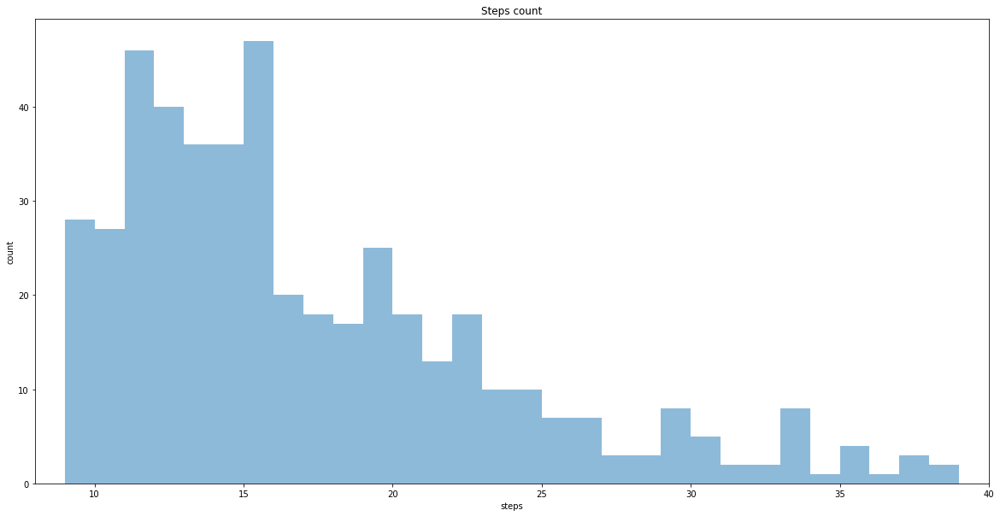

In [1048]:
plt.figure(figsize=(20,10))
bins = np.arange(9, 40, 1) # fixed bin size

plt.xlim([8, 40])

plt.hist(ep_steps, bins=bins, alpha=0.5)
plt.title('Steps count')
plt.xlabel('steps')
plt.ylabel('count')

plt.show()

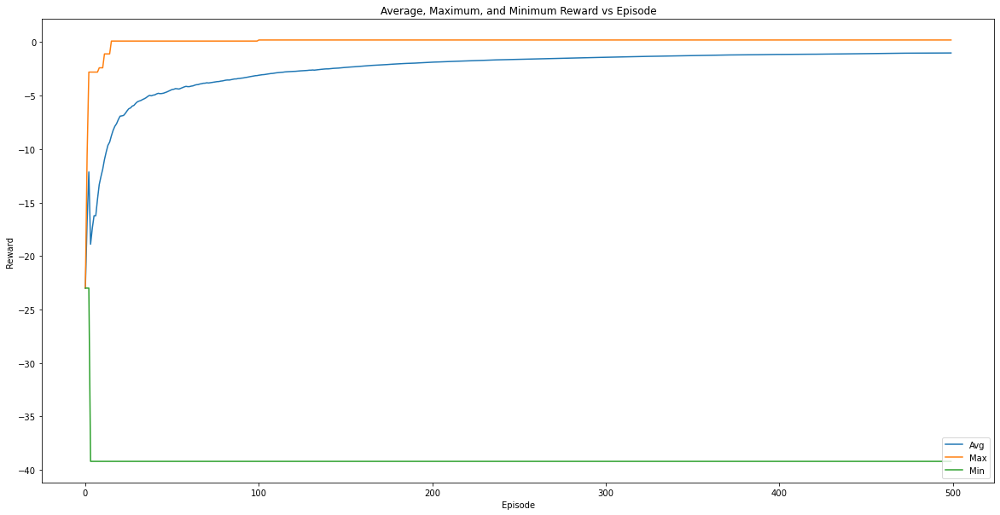

In [1049]:
plt.figure(figsize=(20,10))
plt.plot(aggr_ep_rewards['avg'])
plt.plot(aggr_ep_rewards['max'])
plt.plot(aggr_ep_rewards['min'])
plt.title('Average, Maximum, and Minimum Reward vs Episode')
plt.ylabel('Reward')
plt.xlabel('Episode')
plt.legend(['Avg', 'Max', 'Min'], loc='lower right')
plt.show()

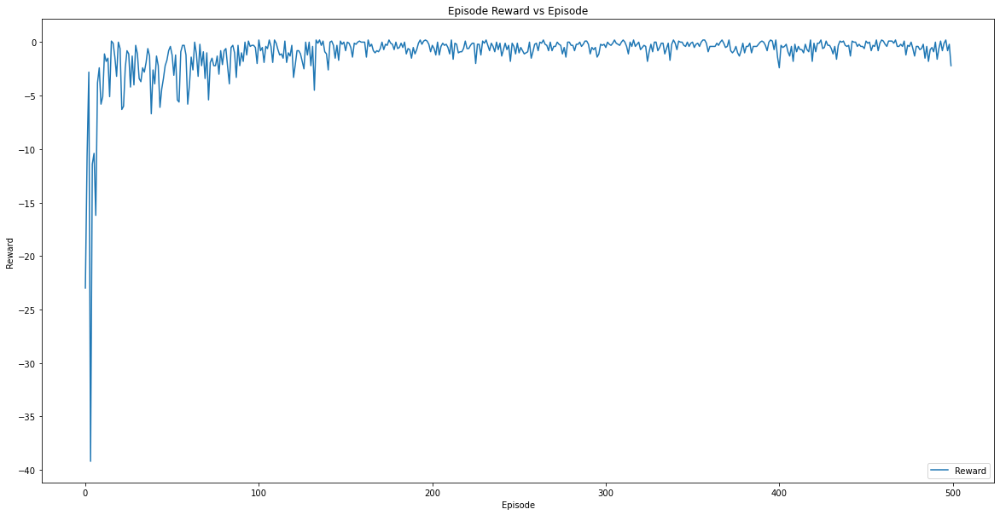

In [1050]:
plt.figure(figsize=(20,10))
plt.plot(ep_rewards)
plt.title('Episode Reward vs Episode')
plt.ylabel('Reward')
plt.xlabel('Episode')
plt.legend(['Reward'], loc='lower right')
plt.show()

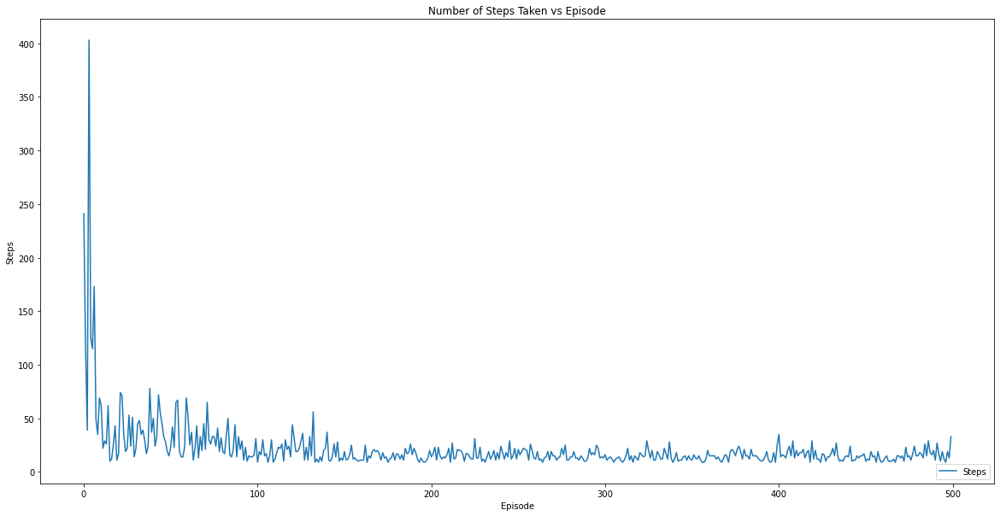

In [1051]:
plt.figure(figsize=(20,10))
plt.plot(ep_steps)
plt.title('Number of Steps Taken vs Episode')
plt.ylabel('Steps')
plt.xlabel('Episode')
plt.legend(['Steps'], loc='lower right')
plt.show()

In [1052]:
index = []

for i in range(0,4):
    for j in range(0,4):
        for h in range(0,4):
            x = str(i) + ',' + str(j) + ',' + str(h)
            index.append(x)
            
q_table_frame = pd.DataFrame(index,columns=['Grid Position'])
df = pd.DataFrame(data=q_table, columns=['left','right','forward','backward','up','down'])
q_table_frame = pd.concat([q_table_frame, df], axis=1)
q_table_frame = q_table_frame.set_index('Grid Position')
pd.set_option("display.max_rows", None, "display.max_columns", None)
q_table_frame

,left,right,forward,backward,up,down
Grid Position,,,,,,
"0,0,0",-0.543697,-0.544370,-0.558295,-0.571641,-0.383381,-0.560937
"0,0,1",-0.543061,-0.429861,-0.457123,-0.608671,-0.339983,-0.473637
"0,0,2",-0.569557,-0.322515,-0.599887,-0.642556,-0.525942,-0.548115
"0,0,3",-0.557321,-0.278217,-0.590013,-0.594830,-0.591037,-0.536413
"0,1,0",-0.541846,-0.553890,-0.546604,-0.547874,-0.286436,-0.503032
"0,1,1",-0.417590,-0.519745,-0.410975,-0.407085,-0.233941,-0.387178
"0,1,2",-0.563410,-0.148414,-0.525308,-0.398030,-0.514250,-0.406194
"0,1,3",-0.319601,-0.135577,-0.281082,-0.532334,-0.337475,-0.268368
"0,2,0",-0.319916,-0.295151,-0.411770,-0.464341,-0.240521,-0.283828


In [1053]:
class TestAgent(object):
    def __init__(self,q_table):
        self.action_space = ['left','right','forward','backward','up','down'] # in TreasureCube
        self.Q = q_table

    def take_action(self, state):

        print("current state: " + state)
        state = [int(d) for d in str(state)]
        state = state[0] + state[1]*4 + state[2]*16
        action = self.action_space[np.argmax(self.Q[state])]
   
        return action

def test(max_episode, max_step,q_table):
    env = TreasureCube(max_step=max_step)
    agent = TestAgent(q_table)
    SHOW_EP = 100
    SHOW_STEP = 10
    # For stats
    ep_rewards = []
    aggr_ep_rewards = {'ep': [], 'avg': [], 'max': [], 'min': []}
    ep_steps = []

    for epsisode_num in range(0, max_episode):
        state = env.reset()
        terminate = False
        t = 0
        episode_reward = 0
        while not terminate:
            action = agent.take_action(state)
            reward, terminate, next_state = env.step(action)
            episode_reward += reward
            # you can comment the following two lines, if the output is too much
            #if epsisode_num % SHOW_EP == 0 and t % SHOW_STEP == 0:
                #env.render() # comment
            print(f'epsisode: {epsisode_num},step: {t}, action: {action}, reward: {reward}') # comment
            t += 1
            state = next_state
        print(f'epsisode: {epsisode_num}, total_steps: {t} episode reward: {episode_reward}')
        ep_rewards.append(episode_reward)
        ep_steps.append(t)
        aggr_ep_rewards['ep'].append(epsisode_num)
        aggr_ep_rewards['avg'].append(sum(ep_rewards)/(epsisode_num+1))
        aggr_ep_rewards['max'].append(max(ep_rewards))
        aggr_ep_rewards['min'].append(min(ep_rewards))
        
    return ep_rewards,ep_steps,aggr_ep_rewards

In [1054]:
ep_rewards,ep_steps,aggr_ep_rewards = test(100, 500,q_table)

current state: 000
epsisode: 0,step: 0, action: up, reward: -0.1
current state: 000
epsisode: 0,step: 1, action: up, reward: -0.1
current state: 001
epsisode: 0,step: 2, action: up, reward: -0.1
current state: 101
epsisode: 0,step: 3, action: up, reward: -0.1
current state: 102
epsisode: 0,step: 4, action: right, reward: -0.1
current state: 002
epsisode: 0,step: 5, action: forward, reward: -0.1
current state: 102
epsisode: 0,step: 6, action: right, reward: -0.1
current state: 112
epsisode: 0,step: 7, action: right, reward: -0.1
current state: 212
epsisode: 0,step: 8, action: forward, reward: -0.1
current state: 312
epsisode: 0,step: 9, action: up, reward: -0.1
current state: 313
epsisode: 0,step: 10, action: right, reward: -0.1
current state: 323
epsisode: 0,step: 11, action: right, reward: 1
epsisode: 0, total_steps: 12 episode reward: -0.09999999999999987
current state: 000
epsisode: 1,step: 0, action: up, reward: -0.1
current state: 100
epsisode: 1,step: 1, action: up, reward: -0.1


In [1055]:
print("Maximum number of steps : " + str(max(ep_steps)))
print("Average number of steps: " + str(sum(ep_steps)/100))

count = 0

for i in ep_steps:
    if i < 15:
        count += 1
print("percentage of episodes below 15 steps : " + str(count/len(ep_steps)))

Maximum number of steps : 38
Average number of steps: 14.77
percentage of episodes below 15 steps : 0.62


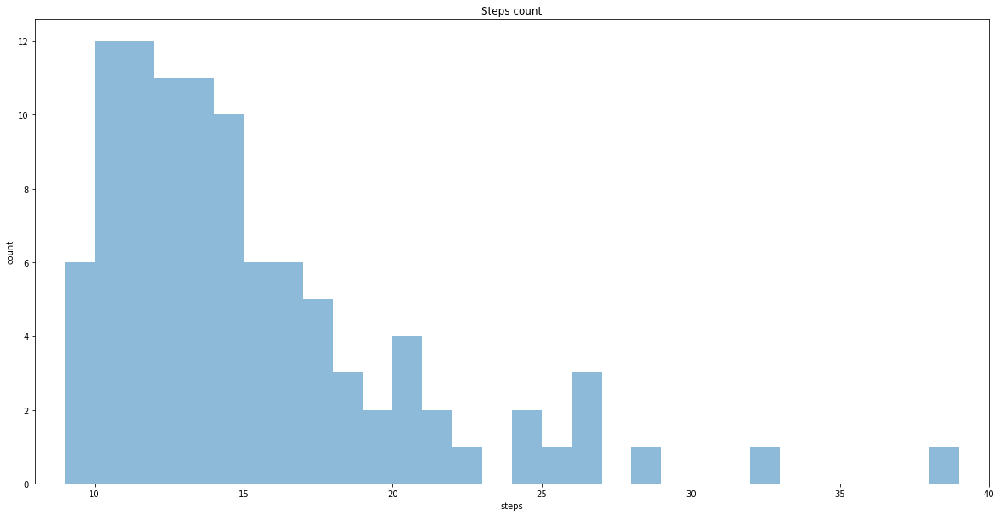

In [1056]:
plt.figure(figsize=(20,10))
bins = np.arange(9, 40, 1) # fixed bin size

plt.xlim([8, 40])

plt.hist(ep_steps, bins=bins, alpha=0.5)
plt.title('Steps count')
plt.xlabel('steps')
plt.ylabel('count')

plt.show()

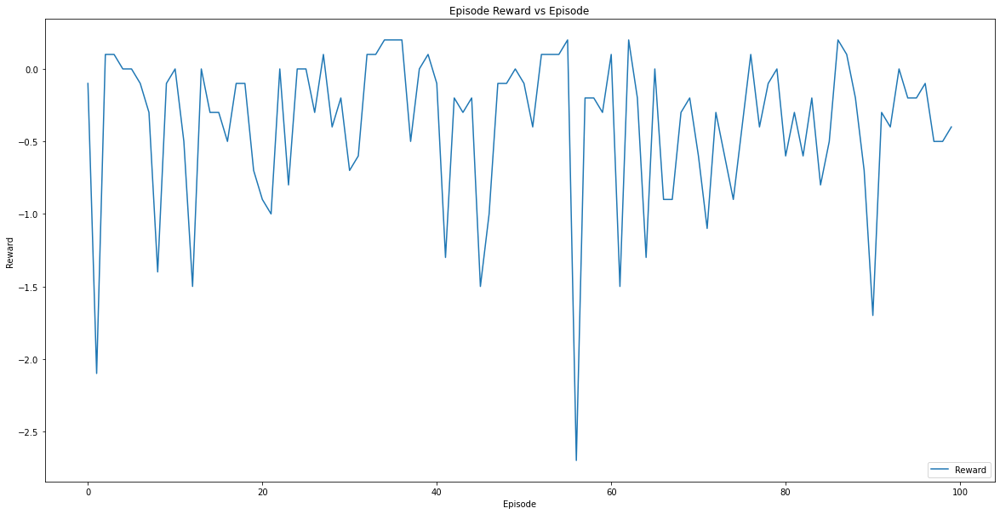

In [1057]:
plt.figure(figsize=(20,10))
plt.plot(ep_rewards)
plt.title('Episode Reward vs Episode')
plt.ylabel('Reward')
plt.xlabel('Episode')
plt.legend(['Reward'], loc='lower right')
plt.show()

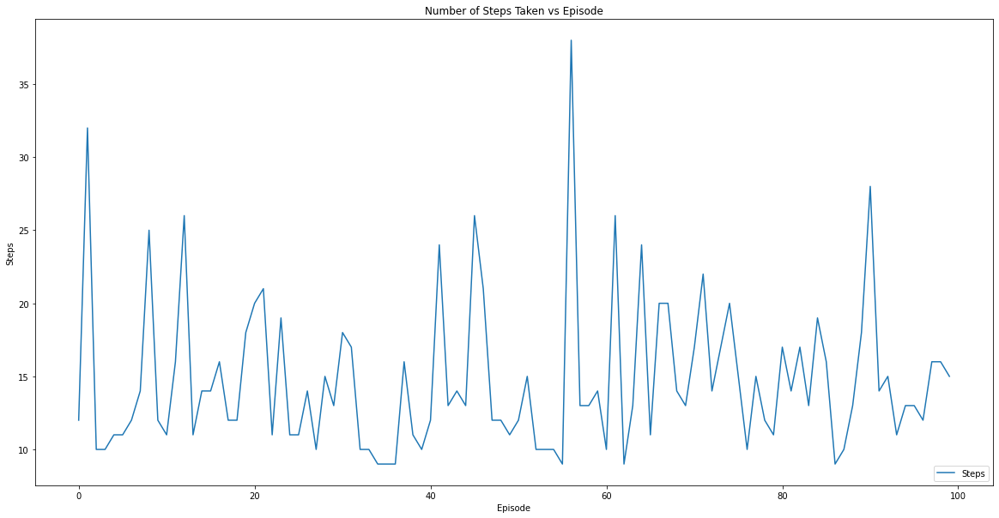

In [1058]:
plt.figure(figsize=(20,10))
plt.plot(ep_steps)
plt.title('Number of Steps Taken vs Episode')
plt.ylabel('Steps')
plt.xlabel('Episode')
plt.legend(['Steps'], loc='lower right')
plt.show()

## No Exploration Rate, Decaying Learning Rate

In [614]:
#optimized for less than 1000 episodes 
class QAgent(object):
    def __init__(self):
        self.learning_rate = 0.9
        self.discount = 0.92
        self.exploration_rate = 0
        self.action_space = ['left','right','forward','backward','up','down'] # in TreasureCube
        self.Q = np.zeros([64,6])
        self.START_LEARNING_DECAYING = 21
        self.END_LEARNING_DECAYING = 1850//2
        self.LEARNING_decay_value = 0.7/(self.END_LEARNING_DECAYING - self.START_LEARNING_DECAYING)

    def take_action(self, state):
        if np.random.random() > self.exploration_rate:
            # Get action from Q table
            print("current state: " + state)
            state = [int(d) for d in str(state)]
            state = state[0] + state[1]*4 + state[2]*16
            action = self.action_space[np.argmax(self.Q[state])]
        else:
            print("random action!!!")
            action = random.choice(self.action_space)
   
        return action

    # implement your train/update function to update self.V or self.Q
    # you should pass arguments to the train function
    def train(self, state, action, next_state, reward):
        state = [int(d) for d in str(state)]
        state = state[0] + state[1]*4 + state[2]*16
        
        next_state = [int(d) for d in str(next_state)]
        next_state = next_state[0] + next_state[1]*4 + next_state[2]*16
        
        # Maximum possible Q value in next step (for new state)
        max_future_q = np.max(self.Q[next_state])

        # Current Q value (for current state and performed action)
        current_q = self.Q[state,self.action_space.index(action)]

        # And here's our equation for a new Q value for current state and action
        new_q = (1 - self.learning_rate) * current_q + self.learning_rate * (reward + self.discount * max_future_q)

        # Update Q table with new Q value
        self.Q[state,self.action_space.index(action)] = new_q
        
    def q_table(self):
        return self.Q
    def update_learning_rate(self,episode):
        #return
        if self.END_LEARNING_DECAYING >= episode >= self.START_LEARNING_DECAYING:
            if(self.learning_rate > self.LEARNING_decay_value):
                self.learning_rate -= self.LEARNING_decay_value
            print("new learning rate: " + str(self.learning_rate))

def test_cube(max_episode, max_step):
    env = TreasureCube(max_step=max_step)
    agent = QAgent()
    SHOW_EP = 100
    SHOW_STEP = 10
    # For stats
    ep_rewards = []
    aggr_ep_rewards = {'ep': [], 'avg': [], 'max': [], 'min': []}
    ep_steps = []

    for epsisode_num in range(0, max_episode):
        state = env.reset()
        terminate = False
        t = 0
        episode_reward = 0
        while not terminate:
            action = agent.take_action(state)
            reward, terminate, next_state = env.step(action)
            episode_reward += reward
            # you can comment the following two lines, if the output is too much
            #if epsisode_num % SHOW_EP == 0 and t % SHOW_STEP == 0:
                #env.render() # comment
            print(f'epsisode: {epsisode_num},step: {t}, action: {action}, reward: {reward}') # comment
            t += 1
            agent.train(state, action, next_state, reward)
            state = next_state
        print(f'epsisode: {epsisode_num}, total_steps: {t} episode reward: {episode_reward}')
        ep_rewards.append(episode_reward)
        ep_steps.append(t)
        aggr_ep_rewards['ep'].append(epsisode_num)
        aggr_ep_rewards['avg'].append(sum(ep_rewards)/(epsisode_num+1))
        aggr_ep_rewards['max'].append(max(ep_rewards))
        aggr_ep_rewards['min'].append(min(ep_rewards))
        agent.update_learning_rate(epsisode_num)
        
    return agent.q_table(),ep_rewards,ep_steps,aggr_ep_rewards

In [615]:
q_table,ep_rewards,ep_steps,aggr_ep_rewards = test_cube(2000, 500)

current state: 000
epsisode: 0,step: 0, action: left, reward: -0.1
current state: 001
epsisode: 0,step: 1, action: left, reward: -0.1
current state: 001
epsisode: 0,step: 2, action: right, reward: -0.1
current state: 101
epsisode: 0,step: 3, action: left, reward: -0.1
current state: 101
epsisode: 0,step: 4, action: right, reward: -0.1
current state: 001
epsisode: 0,step: 5, action: forward, reward: -0.1
current state: 101
epsisode: 0,step: 6, action: forward, reward: -0.1
current state: 201
epsisode: 0,step: 7, action: left, reward: -0.1
current state: 301
epsisode: 0,step: 8, action: left, reward: -0.1
current state: 301
epsisode: 0,step: 9, action: right, reward: -0.1
current state: 311
epsisode: 0,step: 10, action: left, reward: -0.1
current state: 301
epsisode: 0,step: 11, action: forward, reward: -0.1
current state: 301
epsisode: 0,step: 12, action: backward, reward: -0.1
current state: 302
epsisode: 0,step: 13, action: left, reward: -0.1
current state: 302
epsisode: 0,step: 14, a

epsisode: 29,step: 36, action: up, reward: -0.1
current state: 332
epsisode: 29,step: 37, action: up, reward: -0.1
current state: 332
epsisode: 29,step: 38, action: up, reward: 1
epsisode: 29, total_steps: 39 episode reward: -2.800000000000002
new learning rate: 0.8930309734513279
current state: 000
epsisode: 30,step: 0, action: up, reward: -0.1
current state: 001
epsisode: 30,step: 1, action: right, reward: -0.1
current state: 011
epsisode: 30,step: 2, action: up, reward: -0.1
current state: 012
epsisode: 30,step: 3, action: left, reward: -0.1
current state: 012
epsisode: 30,step: 4, action: right, reward: -0.1
current state: 022
epsisode: 30,step: 5, action: forward, reward: -0.1
current state: 122
epsisode: 30,step: 6, action: up, reward: -0.1
current state: 123
epsisode: 30,step: 7, action: right, reward: -0.1
current state: 123
epsisode: 30,step: 8, action: right, reward: -0.1
current state: 023
epsisode: 30,step: 9, action: right, reward: -0.1
current state: 033
epsisode: 30,step

current state: 222
epsisode: 80,step: 13, action: right, reward: -0.1
current state: 232
epsisode: 80,step: 14, action: forward, reward: -0.1
current state: 231
epsisode: 80,step: 15, action: up, reward: -0.1
current state: 232
epsisode: 80,step: 16, action: forward, reward: -0.1
current state: 231
epsisode: 80,step: 17, action: up, reward: -0.1
current state: 232
epsisode: 80,step: 18, action: forward, reward: -0.1
current state: 222
epsisode: 80,step: 19, action: right, reward: -0.1
current state: 221
epsisode: 80,step: 20, action: down, reward: -0.1
current state: 220
epsisode: 80,step: 21, action: right, reward: -0.1
current state: 120
epsisode: 80,step: 22, action: right, reward: -0.1
current state: 130
epsisode: 80,step: 23, action: up, reward: -0.1
current state: 030
epsisode: 80,step: 24, action: backward, reward: -0.1
current state: 030
epsisode: 80,step: 25, action: down, reward: -0.1
current state: 030
epsisode: 80,step: 26, action: up, reward: -0.1
current state: 031
epsiso

current state: 210
epsisode: 146,step: 3, action: up, reward: -0.1
current state: 220
epsisode: 146,step: 4, action: up, reward: -0.1
current state: 221
epsisode: 146,step: 5, action: forward, reward: -0.1
current state: 321
epsisode: 146,step: 6, action: up, reward: -0.1
current state: 221
epsisode: 146,step: 7, action: forward, reward: -0.1
current state: 211
epsisode: 146,step: 8, action: forward, reward: -0.1
current state: 311
epsisode: 146,step: 9, action: right, reward: -0.1
current state: 310
epsisode: 146,step: 10, action: forward, reward: -0.1
current state: 320
epsisode: 146,step: 11, action: up, reward: -0.1
current state: 321
epsisode: 146,step: 12, action: up, reward: -0.1
current state: 331
epsisode: 146,step: 13, action: up, reward: -0.1
current state: 332
epsisode: 146,step: 14, action: up, reward: 1
epsisode: 146, total_steps: 15 episode reward: -0.40000000000000013
new learning rate: 0.8024336283185899
current state: 000
epsisode: 147,step: 0, action: forward, reward

epsisode: 225,step: 5, action: up, reward: -0.1
current state: 112
epsisode: 225,step: 6, action: right, reward: -0.1
current state: 122
epsisode: 225,step: 7, action: right, reward: -0.1
current state: 132
epsisode: 225,step: 8, action: up, reward: -0.1
current state: 133
epsisode: 225,step: 9, action: forward, reward: -0.1
current state: 233
epsisode: 225,step: 10, action: forward, reward: 1
epsisode: 225, total_steps: 11 episode reward: 1.1102230246251565e-16
new learning rate: 0.7412610619469121
current state: 000
epsisode: 226,step: 0, action: right, reward: -0.1
current state: 010
epsisode: 226,step: 1, action: right, reward: -0.1
current state: 020
epsisode: 226,step: 2, action: forward, reward: -0.1
current state: 021
epsisode: 226,step: 3, action: forward, reward: -0.1
current state: 121
epsisode: 226,step: 4, action: forward, reward: -0.1
current state: 221
epsisode: 226,step: 5, action: up, reward: -0.1
current state: 231
epsisode: 226,step: 6, action: up, reward: -0.1
curre

current state: 211
epsisode: 313,step: 17, action: up, reward: -0.1
current state: 201
epsisode: 313,step: 18, action: forward, reward: -0.1
current state: 211
epsisode: 313,step: 19, action: up, reward: -0.1
current state: 212
epsisode: 313,step: 20, action: up, reward: -0.1
current state: 312
epsisode: 313,step: 21, action: right, reward: -0.1
current state: 322
epsisode: 313,step: 22, action: up, reward: -0.1
current state: 332
epsisode: 313,step: 23, action: up, reward: -0.1
current state: 332
epsisode: 313,step: 24, action: up, reward: 1
epsisode: 313, total_steps: 25 episode reward: -1.4000000000000008
new learning rate: 0.6731194690265622
current state: 000
epsisode: 314,step: 0, action: right, reward: -0.1
current state: 010
epsisode: 314,step: 1, action: right, reward: -0.1
current state: 010
epsisode: 314,step: 2, action: right, reward: -0.1
current state: 020
epsisode: 314,step: 3, action: right, reward: -0.1
current state: 021
epsisode: 314,step: 4, action: forward, reward:

current state: 020
epsisode: 409,step: 2, action: right, reward: -0.1
current state: 120
epsisode: 409,step: 3, action: up, reward: -0.1
current state: 121
epsisode: 409,step: 4, action: forward, reward: -0.1
current state: 221
epsisode: 409,step: 5, action: up, reward: -0.1
current state: 222
epsisode: 409,step: 6, action: forward, reward: -0.1
current state: 221
epsisode: 409,step: 7, action: up, reward: -0.1
current state: 222
epsisode: 409,step: 8, action: forward, reward: -0.1
current state: 221
epsisode: 409,step: 9, action: up, reward: -0.1
current state: 222
epsisode: 409,step: 10, action: forward, reward: -0.1
current state: 322
epsisode: 409,step: 11, action: up, reward: -0.1
current state: 322
epsisode: 409,step: 12, action: up, reward: -0.1
current state: 332
epsisode: 409,step: 13, action: up, reward: 1
epsisode: 409, total_steps: 14 episode reward: -0.30000000000000004
new learning rate: 0.5987831858407259
current state: 000
epsisode: 410,step: 0, action: right, reward: -

current state: 111
epsisode: 510,step: 5, action: up, reward: -0.1
current state: 112
epsisode: 510,step: 6, action: up, reward: -0.1
current state: 113
epsisode: 510,step: 7, action: right, reward: -0.1
current state: 213
epsisode: 510,step: 8, action: forward, reward: -0.1
current state: 212
epsisode: 510,step: 9, action: up, reward: -0.1
current state: 213
epsisode: 510,step: 10, action: forward, reward: -0.1
current state: 313
epsisode: 510,step: 11, action: right, reward: -0.1
current state: 323
epsisode: 510,step: 12, action: right, reward: -0.1
current state: 322
epsisode: 510,step: 13, action: up, reward: -0.1
current state: 322
epsisode: 510,step: 14, action: up, reward: -0.1
current state: 323
epsisode: 510,step: 15, action: right, reward: 1
epsisode: 510, total_steps: 16 episode reward: -0.5000000000000002
new learning rate: 0.5205752212389606
current state: 000
epsisode: 511,step: 0, action: right, reward: -0.1
current state: 001
epsisode: 511,step: 1, action: forward, rewa

epsisode: 610,step: 9, action: up, reward: -0.1
current state: 321
epsisode: 610,step: 10, action: right, reward: -0.1
current state: 331
epsisode: 610,step: 11, action: up, reward: -0.1
current state: 331
epsisode: 610,step: 12, action: up, reward: -0.1
current state: 331
epsisode: 610,step: 13, action: up, reward: -0.1
current state: 332
epsisode: 610,step: 14, action: up, reward: -0.1
current state: 332
epsisode: 610,step: 15, action: up, reward: 1
epsisode: 610, total_steps: 16 episode reward: -0.5000000000000002
new learning rate: 0.443141592920377
current state: 000
epsisode: 611,step: 0, action: right, reward: -0.1
current state: 001
epsisode: 611,step: 1, action: forward, reward: -0.1
current state: 101
epsisode: 611,step: 2, action: up, reward: -0.1
current state: 102
epsisode: 611,step: 3, action: up, reward: -0.1
current state: 103
epsisode: 611,step: 4, action: right, reward: -0.1
current state: 203
epsisode: 611,step: 5, action: forward, reward: -0.1
current state: 303
eps

new learning rate: 0.36957964601772125
current state: 000
epsisode: 706,step: 0, action: right, reward: -0.1
current state: 010
epsisode: 706,step: 1, action: right, reward: -0.1
current state: 011
epsisode: 706,step: 2, action: up, reward: -0.1
current state: 012
epsisode: 706,step: 3, action: right, reward: -0.1
current state: 022
epsisode: 706,step: 4, action: forward, reward: -0.1
current state: 021
epsisode: 706,step: 5, action: forward, reward: -0.1
current state: 121
epsisode: 706,step: 6, action: forward, reward: -0.1
current state: 221
epsisode: 706,step: 7, action: up, reward: -0.1
current state: 222
epsisode: 706,step: 8, action: forward, reward: -0.1
current state: 322
epsisode: 706,step: 9, action: up, reward: -0.1
current state: 322
epsisode: 706,step: 10, action: up, reward: -0.1
current state: 323
epsisode: 706,step: 11, action: right, reward: -0.1
current state: 323
epsisode: 706,step: 12, action: right, reward: 1
epsisode: 706, total_steps: 13 episode reward: -0.19999

epsisode: 792, total_steps: 11 episode reward: 1.1102230246251565e-16
new learning rate: 0.3022123893805523
current state: 000
epsisode: 793,step: 0, action: right, reward: -0.1
current state: 010
epsisode: 793,step: 1, action: right, reward: -0.1
current state: 020
epsisode: 793,step: 2, action: right, reward: -0.1
current state: 030
epsisode: 793,step: 3, action: up, reward: -0.1
current state: 020
epsisode: 793,step: 4, action: right, reward: -0.1
current state: 030
epsisode: 793,step: 5, action: up, reward: -0.1
current state: 031
epsisode: 793,step: 6, action: forward, reward: -0.1
current state: 131
epsisode: 793,step: 7, action: forward, reward: -0.1
current state: 231
epsisode: 793,step: 8, action: up, reward: -0.1
current state: 232
epsisode: 793,step: 9, action: up, reward: -0.1
current state: 233
epsisode: 793,step: 10, action: forward, reward: 1
epsisode: 793, total_steps: 11 episode reward: 1.1102230246251565e-16
new learning rate: 0.30143805309736643
current state: 000
ep

epsisode: 895,step: 1, action: right, reward: -0.1
current state: 020
epsisode: 895,step: 2, action: right, reward: -0.1
current state: 030
epsisode: 895,step: 3, action: up, reward: -0.1
current state: 030
epsisode: 895,step: 4, action: up, reward: -0.1
current state: 031
epsisode: 895,step: 5, action: forward, reward: -0.1
current state: 131
epsisode: 895,step: 6, action: forward, reward: -0.1
current state: 231
epsisode: 895,step: 7, action: up, reward: -0.1
current state: 232
epsisode: 895,step: 8, action: up, reward: -0.1
current state: 233
epsisode: 895,step: 9, action: forward, reward: 1
epsisode: 895, total_steps: 10 episode reward: 0.10000000000000009
new learning rate: 0.2224557522124097
current state: 000
epsisode: 896,step: 0, action: right, reward: -0.1
current state: 010
epsisode: 896,step: 1, action: right, reward: -0.1
current state: 010
epsisode: 896,step: 2, action: right, reward: -0.1
current state: 020
epsisode: 896,step: 3, action: right, reward: -0.1
current state

current state: 020
epsisode: 991,step: 5, action: right, reward: -0.1
current state: 030
epsisode: 991,step: 6, action: up, reward: -0.1
current state: 030
epsisode: 991,step: 7, action: up, reward: -0.1
current state: 031
epsisode: 991,step: 8, action: forward, reward: -0.1
current state: 131
epsisode: 991,step: 9, action: forward, reward: -0.1
current state: 231
epsisode: 991,step: 10, action: up, reward: -0.1
current state: 331
epsisode: 991,step: 11, action: up, reward: -0.1
current state: 332
epsisode: 991,step: 12, action: up, reward: 1
epsisode: 991, total_steps: 13 episode reward: -0.19999999999999996
current state: 000
epsisode: 992,step: 0, action: right, reward: -0.1
current state: 000
epsisode: 992,step: 1, action: right, reward: -0.1
current state: 100
epsisode: 992,step: 2, action: right, reward: -0.1
current state: 101
epsisode: 992,step: 3, action: up, reward: -0.1
current state: 111
epsisode: 992,step: 4, action: up, reward: -0.1
current state: 112
epsisode: 992,step: 

epsisode: 1090,step: 7, action: forward, reward: -0.1
current state: 223
epsisode: 1090,step: 8, action: right, reward: -0.1
current state: 222
epsisode: 1090,step: 9, action: forward, reward: -0.1
current state: 232
epsisode: 1090,step: 10, action: up, reward: -0.1
current state: 233
epsisode: 1090,step: 11, action: forward, reward: 1
epsisode: 1090, total_steps: 12 episode reward: -0.09999999999999987
current state: 000
epsisode: 1091,step: 0, action: right, reward: -0.1
current state: 000
epsisode: 1091,step: 1, action: right, reward: -0.1
current state: 010
epsisode: 1091,step: 2, action: right, reward: -0.1
current state: 020
epsisode: 1091,step: 3, action: right, reward: -0.1
current state: 030
epsisode: 1091,step: 4, action: up, reward: -0.1
current state: 031
epsisode: 1091,step: 5, action: forward, reward: -0.1
current state: 131
epsisode: 1091,step: 6, action: forward, reward: -0.1
current state: 231
epsisode: 1091,step: 7, action: up, reward: -0.1
current state: 221
epsisode

current state: 232
epsisode: 1182,step: 11, action: up, reward: -0.1
current state: 233
epsisode: 1182,step: 12, action: forward, reward: -0.1
current state: 233
epsisode: 1182,step: 13, action: forward, reward: 1
epsisode: 1182, total_steps: 14 episode reward: -0.30000000000000004
current state: 000
epsisode: 1183,step: 0, action: right, reward: -0.1
current state: 010
epsisode: 1183,step: 1, action: right, reward: -0.1
current state: 010
epsisode: 1183,step: 2, action: right, reward: -0.1
current state: 011
epsisode: 1183,step: 3, action: up, reward: -0.1
current state: 012
epsisode: 1183,step: 4, action: right, reward: -0.1
current state: 013
epsisode: 1183,step: 5, action: forward, reward: -0.1
current state: 113
epsisode: 1183,step: 6, action: right, reward: -0.1
current state: 213
epsisode: 1183,step: 7, action: forward, reward: -0.1
current state: 213
epsisode: 1183,step: 8, action: forward, reward: -0.1
current state: 313
epsisode: 1183,step: 9, action: right, reward: -0.1
curr

epsisode: 1277,step: 4, action: up, reward: -0.1
current state: 031
epsisode: 1277,step: 5, action: forward, reward: -0.1
current state: 131
epsisode: 1277,step: 6, action: forward, reward: -0.1
current state: 231
epsisode: 1277,step: 7, action: up, reward: -0.1
current state: 232
epsisode: 1277,step: 8, action: up, reward: -0.1
current state: 233
epsisode: 1277,step: 9, action: forward, reward: -0.1
current state: 233
epsisode: 1277,step: 10, action: forward, reward: 1
epsisode: 1277, total_steps: 11 episode reward: 1.1102230246251565e-16
current state: 000
epsisode: 1278,step: 0, action: right, reward: -0.1
current state: 010
epsisode: 1278,step: 1, action: right, reward: -0.1
current state: 110
epsisode: 1278,step: 2, action: forward, reward: -0.1
current state: 100
epsisode: 1278,step: 3, action: right, reward: -0.1
current state: 000
epsisode: 1278,step: 4, action: right, reward: -0.1
current state: 010
epsisode: 1278,step: 5, action: right, reward: -0.1
current state: 011
epsisod

epsisode: 1364,step: 3, action: right, reward: -0.1
current state: 110
epsisode: 1364,step: 4, action: forward, reward: -0.1
current state: 210
epsisode: 1364,step: 5, action: right, reward: -0.1
current state: 210
epsisode: 1364,step: 6, action: right, reward: -0.1
current state: 220
epsisode: 1364,step: 7, action: up, reward: -0.1
current state: 230
epsisode: 1364,step: 8, action: up, reward: -0.1
current state: 330
epsisode: 1364,step: 9, action: backward, reward: -0.1
current state: 230
epsisode: 1364,step: 10, action: up, reward: -0.1
current state: 231
epsisode: 1364,step: 11, action: up, reward: -0.1
current state: 231
epsisode: 1364,step: 12, action: up, reward: -0.1
current state: 232
epsisode: 1364,step: 13, action: up, reward: -0.1
current state: 233
epsisode: 1364,step: 14, action: forward, reward: 1
epsisode: 1364, total_steps: 15 episode reward: -0.40000000000000013
current state: 000
epsisode: 1365,step: 0, action: right, reward: -0.1
current state: 100
epsisode: 1365,st

epsisode: 1462,step: 5, action: forward, reward: -0.1
current state: 131
epsisode: 1462,step: 6, action: forward, reward: -0.1
current state: 231
epsisode: 1462,step: 7, action: up, reward: -0.1
current state: 232
epsisode: 1462,step: 8, action: up, reward: -0.1
current state: 222
epsisode: 1462,step: 9, action: forward, reward: -0.1
current state: 232
epsisode: 1462,step: 10, action: up, reward: -0.1
current state: 233
epsisode: 1462,step: 11, action: forward, reward: 1
epsisode: 1462, total_steps: 12 episode reward: -0.09999999999999987
current state: 000
epsisode: 1463,step: 0, action: right, reward: -0.1
current state: 010
epsisode: 1463,step: 1, action: right, reward: -0.1
current state: 020
epsisode: 1463,step: 2, action: right, reward: -0.1
current state: 030
epsisode: 1463,step: 3, action: up, reward: -0.1
current state: 031
epsisode: 1463,step: 4, action: forward, reward: -0.1
current state: 131
epsisode: 1463,step: 5, action: forward, reward: -0.1
current state: 121
epsisode:

epsisode: 1553,step: 7, action: forward, reward: -0.1
current state: 031
epsisode: 1553,step: 8, action: forward, reward: -0.1
current state: 030
epsisode: 1553,step: 9, action: up, reward: -0.1
current state: 031
epsisode: 1553,step: 10, action: forward, reward: -0.1
current state: 021
epsisode: 1553,step: 11, action: forward, reward: -0.1
current state: 121
epsisode: 1553,step: 12, action: forward, reward: -0.1
current state: 122
epsisode: 1553,step: 13, action: up, reward: -0.1
current state: 112
epsisode: 1553,step: 14, action: up, reward: -0.1
current state: 122
epsisode: 1553,step: 15, action: up, reward: -0.1
current state: 123
epsisode: 1553,step: 16, action: forward, reward: -0.1
current state: 223
epsisode: 1553,step: 17, action: right, reward: -0.1
current state: 233
epsisode: 1553,step: 18, action: forward, reward: 1
epsisode: 1553, total_steps: 19 episode reward: -0.8000000000000005
current state: 000
epsisode: 1554,step: 0, action: right, reward: -0.1
current state: 010
e

epsisode: 1652,step: 1, action: right, reward: -0.1
current state: 010
epsisode: 1652,step: 2, action: right, reward: -0.1
current state: 020
epsisode: 1652,step: 3, action: right, reward: -0.1
current state: 030
epsisode: 1652,step: 4, action: up, reward: -0.1
current state: 030
epsisode: 1652,step: 5, action: up, reward: -0.1
current state: 130
epsisode: 1652,step: 6, action: up, reward: -0.1
current state: 230
epsisode: 1652,step: 7, action: up, reward: -0.1
current state: 130
epsisode: 1652,step: 8, action: up, reward: -0.1
current state: 131
epsisode: 1652,step: 9, action: forward, reward: -0.1
current state: 231
epsisode: 1652,step: 10, action: up, reward: -0.1
current state: 221
epsisode: 1652,step: 11, action: up, reward: -0.1
current state: 121
epsisode: 1652,step: 12, action: forward, reward: -0.1
current state: 122
epsisode: 1652,step: 13, action: up, reward: -0.1
current state: 123
epsisode: 1652,step: 14, action: forward, reward: -0.1
current state: 223
epsisode: 1652,step

current state: 133
epsisode: 1745,step: 16, action: forward, reward: -0.1
current state: 123
epsisode: 1745,step: 17, action: forward, reward: -0.1
current state: 223
epsisode: 1745,step: 18, action: right, reward: -0.1
current state: 233
epsisode: 1745,step: 19, action: forward, reward: 1
epsisode: 1745, total_steps: 20 episode reward: -0.9000000000000006
current state: 000
epsisode: 1746,step: 0, action: right, reward: -0.1
current state: 100
epsisode: 1746,step: 1, action: right, reward: -0.1
current state: 110
epsisode: 1746,step: 2, action: forward, reward: -0.1
current state: 210
epsisode: 1746,step: 3, action: right, reward: -0.1
current state: 110
epsisode: 1746,step: 4, action: forward, reward: -0.1
current state: 120
epsisode: 1746,step: 5, action: up, reward: -0.1
current state: 121
epsisode: 1746,step: 6, action: forward, reward: -0.1
current state: 221
epsisode: 1746,step: 7, action: up, reward: -0.1
current state: 222
epsisode: 1746,step: 8, action: forward, reward: -0.1


current state: 020
epsisode: 1843,step: 3, action: right, reward: -0.1
current state: 120
epsisode: 1843,step: 4, action: up, reward: -0.1
current state: 110
epsisode: 1843,step: 5, action: forward, reward: -0.1
current state: 100
epsisode: 1843,step: 6, action: right, reward: -0.1
current state: 100
epsisode: 1843,step: 7, action: right, reward: -0.1
current state: 000
epsisode: 1843,step: 8, action: right, reward: -0.1
current state: 010
epsisode: 1843,step: 9, action: right, reward: -0.1
current state: 020
epsisode: 1843,step: 10, action: right, reward: -0.1
current state: 030
epsisode: 1843,step: 11, action: up, reward: -0.1
current state: 031
epsisode: 1843,step: 12, action: forward, reward: -0.1
current state: 131
epsisode: 1843,step: 13, action: forward, reward: -0.1
current state: 131
epsisode: 1843,step: 14, action: forward, reward: -0.1
current state: 132
epsisode: 1843,step: 15, action: up, reward: -0.1
current state: 133
epsisode: 1843,step: 16, action: forward, reward: -0.

epsisode: 1948,step: 4, action: up, reward: -0.1
current state: 212
epsisode: 1948,step: 5, action: up, reward: -0.1
current state: 213
epsisode: 1948,step: 6, action: forward, reward: -0.1
current state: 313
epsisode: 1948,step: 7, action: right, reward: -0.1
current state: 323
epsisode: 1948,step: 8, action: right, reward: -0.1
current state: 323
epsisode: 1948,step: 9, action: right, reward: 1
epsisode: 1948, total_steps: 10 episode reward: 0.10000000000000009
current state: 000
epsisode: 1949,step: 0, action: right, reward: -0.1
current state: 000
epsisode: 1949,step: 1, action: right, reward: -0.1
current state: 100
epsisode: 1949,step: 2, action: right, reward: -0.1
current state: 100
epsisode: 1949,step: 3, action: right, reward: -0.1
current state: 110
epsisode: 1949,step: 4, action: forward, reward: -0.1
current state: 210
epsisode: 1949,step: 5, action: right, reward: -0.1
current state: 210
epsisode: 1949,step: 6, action: right, reward: -0.1
current state: 220
epsisode: 1949

In [616]:
print("Maximum number of steps for last 200 episodes: " + str(max(ep_steps[-200:])))
print("Average number of steps for last 200 episodes: " + str(sum(ep_steps[-200:])/200))

Maximum number of steps for last 200 episodes: 39
Average number of steps for last 200 episodes: 15.225


In [617]:
from collections import Counter

Counter(ep_steps)

Counter({241: 1,
         117: 1,
         25: 24,
         130: 1,
         34: 5,
         33: 8,
         32: 8,
         31: 16,
         60: 2,
         45: 4,
         23: 39,
         80: 2,
         72: 1,
         27: 22,
         53: 1,
         105: 1,
         24: 22,
         35: 7,
         49: 1,
         26: 31,
         44: 1,
         65: 1,
         18: 94,
         17: 103,
         13: 205,
         39: 3,
         20: 77,
         10: 120,
         81: 1,
         30: 6,
         29: 18,
         36: 10,
         63: 1,
         15: 169,
         62: 1,
         11: 190,
         16: 115,
         57: 1,
         37: 3,
         21: 58,
         50: 1,
         12: 190,
         19: 78,
         9: 112,
         43: 3,
         14: 179,
         38: 1,
         22: 48,
         48: 1,
         28: 9,
         42: 1,
         47: 1,
         52: 1,
         40: 1})

In [618]:
count = 0

for i in ep_steps:
    if i < 15:
        count += 1
print("percentage of episodes below 15 steps : " + str(count/len(ep_steps)))

percentage of episodes below 15 steps : 0.498


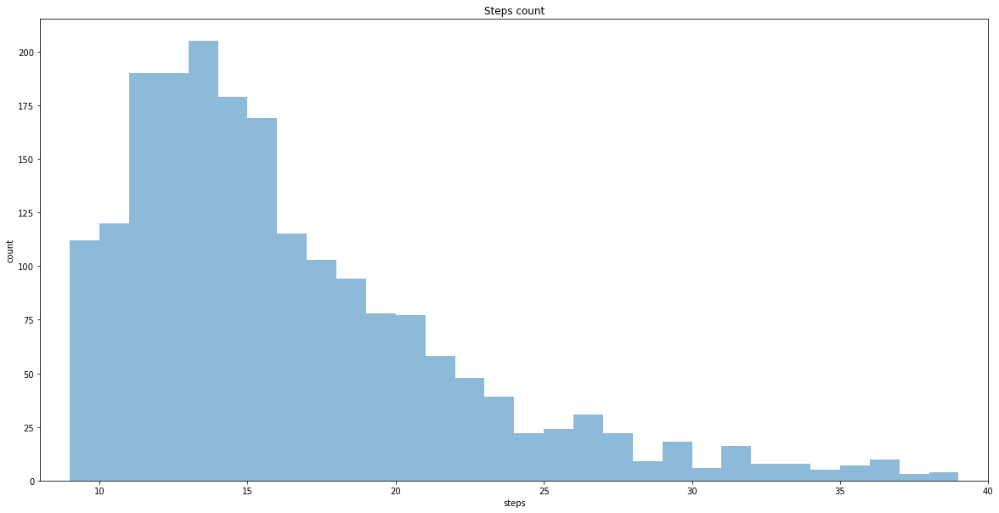

In [619]:
plt.figure(figsize=(20,10))
bins = np.arange(9, 40, 1) # fixed bin size

plt.xlim([8, 40])

plt.hist(ep_steps, bins=bins, alpha=0.5)
plt.title('Steps count')
plt.xlabel('steps')
plt.ylabel('count')

plt.show()

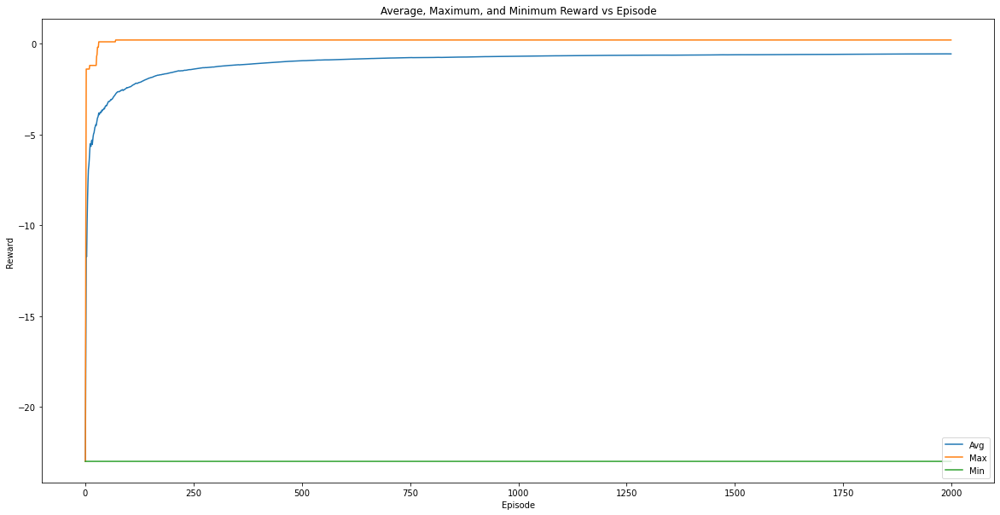

In [620]:
plt.figure(figsize=(20,10))
plt.plot(aggr_ep_rewards['avg'])
plt.plot(aggr_ep_rewards['max'])
plt.plot(aggr_ep_rewards['min'])
plt.title('Average, Maximum, and Minimum Reward vs Episode')
plt.ylabel('Reward')
plt.xlabel('Episode')
plt.legend(['Avg', 'Max', 'Min'], loc='lower right')
plt.show()

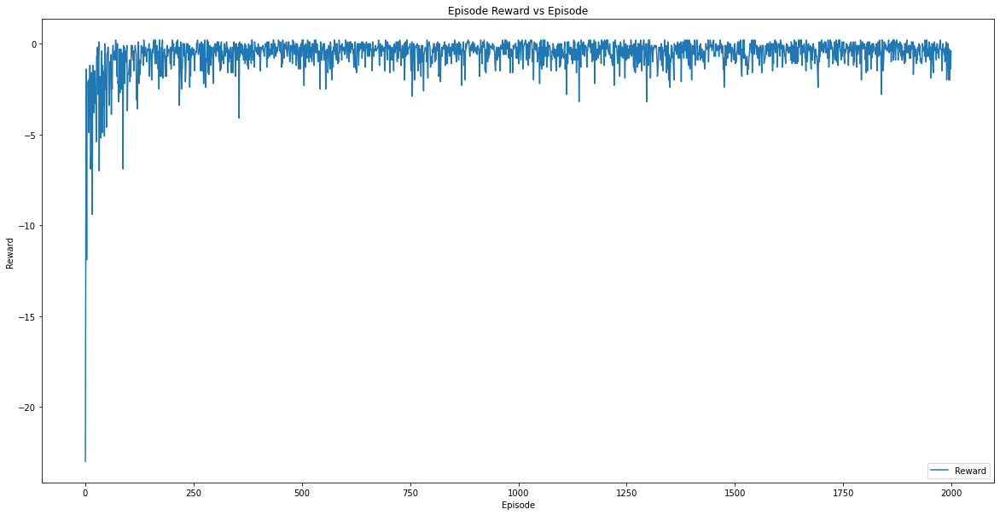

In [621]:
plt.figure(figsize=(20,10))
plt.plot(ep_rewards)
plt.title('Episode Reward vs Episode')
plt.ylabel('Reward')
plt.xlabel('Episode')
plt.legend(['Reward'], loc='lower right')
plt.show()

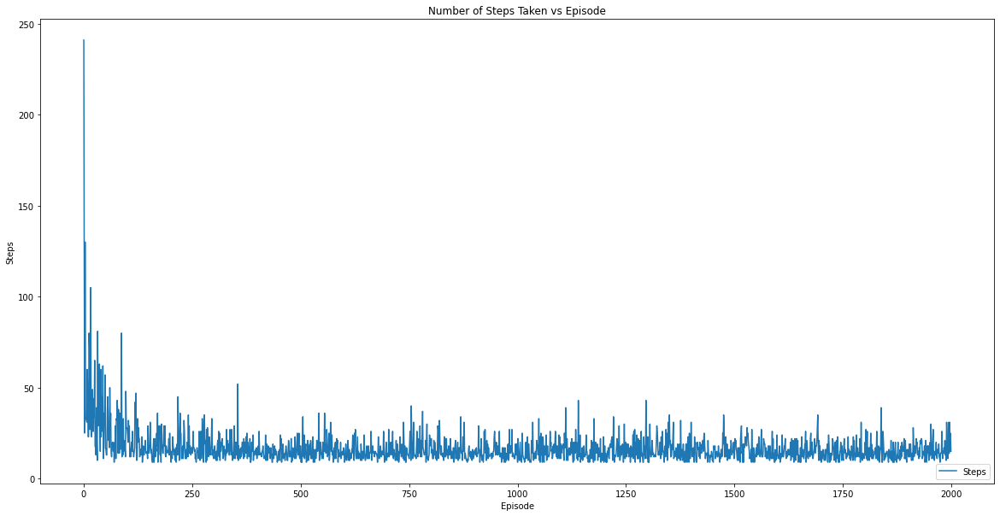

In [622]:
plt.figure(figsize=(20,10))
plt.plot(ep_steps)
plt.title('Number of Steps Taken vs Episode')
plt.ylabel('Steps')
plt.xlabel('Episode')
plt.legend(['Steps'], loc='lower right')
plt.show()

In [623]:
index = []

for i in range(0,4):
    for j in range(0,4):
        for h in range(0,4):
            x = str(i) + ',' + str(j) + ',' + str(h)
            index.append(x)
            
q_table_frame = pd.DataFrame(index,columns=['Grid Position'])
df = pd.DataFrame(data=q_table, columns=['left','right','forward','backward','up','down'])
q_table_frame = pd.concat([q_table_frame, df], axis=1)
q_table_frame = q_table_frame.set_index('Grid Position')
pd.set_option("display.max_rows", None, "display.max_columns", None)
q_table_frame

,left,right,forward,backward,up,down
Grid Position,,,,,,
"0,0,0",-0.703707,-0.470610,-0.709428,-0.701797,-0.708083,-0.692316
"0,0,1",-0.646687,-0.385617,-0.634363,-0.653796,-0.646512,-0.646741
"0,0,2",-0.599263,-0.573492,-0.271977,-0.567648,-0.565630,-0.584752
"0,0,3",-0.552457,-0.516693,-0.552457,-0.542969,-0.200825,-0.544015
"0,1,0",-0.657594,-0.371920,-0.647255,-0.661102,-0.675182,-0.667166
"0,1,1",-0.591287,-0.595005,-0.270033,-0.620860,-0.604676,-0.596595
"0,1,2",-0.536111,-0.165205,-0.546523,-0.587721,-0.567865,-0.573488
"0,1,3",-0.508049,-0.092883,-0.523872,-0.512278,-0.498595,-0.539311
"0,2,0",-0.603745,-0.318520,-0.583886,-0.587231,-0.585742,-0.646934


In [624]:
class TestAgent(object):
    def __init__(self,q_table):
        self.action_space = ['left','right','forward','backward','up','down'] # in TreasureCube
        self.Q = q_table

    def take_action(self, state):

        print("current state: " + state)
        state = [int(d) for d in str(state)]
        state = state[0] + state[1]*4 + state[2]*16
        action = self.action_space[np.argmax(self.Q[state])]
   
        return action

def test(max_episode, max_step,q_table):
    env = TreasureCube(max_step=max_step)
    agent = TestAgent(q_table)
    SHOW_EP = 100
    SHOW_STEP = 10
    # For stats
    ep_rewards = []
    aggr_ep_rewards = {'ep': [], 'avg': [], 'max': [], 'min': []}
    ep_steps = []

    for epsisode_num in range(0, max_episode):
        state = env.reset()
        terminate = False
        t = 0
        episode_reward = 0
        while not terminate:
            action = agent.take_action(state)
            reward, terminate, next_state = env.step(action)
            episode_reward += reward
            # you can comment the following two lines, if the output is too much
            #if epsisode_num % SHOW_EP == 0 and t % SHOW_STEP == 0:
                #env.render() # comment
            print(f'epsisode: {epsisode_num},step: {t}, action: {action}, reward: {reward}') # comment
            t += 1
            state = next_state
        print(f'epsisode: {epsisode_num}, total_steps: {t} episode reward: {episode_reward}')
        ep_rewards.append(episode_reward)
        ep_steps.append(t)
        aggr_ep_rewards['ep'].append(epsisode_num)
        aggr_ep_rewards['avg'].append(sum(ep_rewards)/(epsisode_num+1))
        aggr_ep_rewards['max'].append(max(ep_rewards))
        aggr_ep_rewards['min'].append(min(ep_rewards))
        
    return ep_rewards,ep_steps,aggr_ep_rewards

In [625]:
ep_rewards,ep_steps,aggr_ep_rewards = test(100, 500,q_table)

current state: 000
epsisode: 0,step: 0, action: right, reward: -0.1
current state: 001
epsisode: 0,step: 1, action: forward, reward: -0.1
current state: 101
epsisode: 0,step: 2, action: up, reward: -0.1
current state: 201
epsisode: 0,step: 3, action: forward, reward: -0.1
current state: 301
epsisode: 0,step: 4, action: up, reward: -0.1
current state: 201
epsisode: 0,step: 5, action: forward, reward: -0.1
current state: 301
epsisode: 0,step: 6, action: up, reward: -0.1
current state: 302
epsisode: 0,step: 7, action: up, reward: -0.1
current state: 302
epsisode: 0,step: 8, action: up, reward: -0.1
current state: 303
epsisode: 0,step: 9, action: right, reward: -0.1
current state: 313
epsisode: 0,step: 10, action: right, reward: -0.1
current state: 323
epsisode: 0,step: 11, action: right, reward: 1
epsisode: 0, total_steps: 12 episode reward: -0.09999999999999987
current state: 000
epsisode: 1,step: 0, action: right, reward: -0.1
current state: 100
epsisode: 1,step: 1, action: right, rewar

epsisode: 98,step: 9, action: up, reward: -0.1
current state: 033
epsisode: 98,step: 10, action: forward, reward: -0.1
current state: 133
epsisode: 98,step: 11, action: forward, reward: -0.1
current state: 233
epsisode: 98,step: 12, action: forward, reward: 1
epsisode: 98, total_steps: 13 episode reward: -0.19999999999999996
current state: 000
epsisode: 99,step: 0, action: right, reward: -0.1
current state: 010
epsisode: 99,step: 1, action: right, reward: -0.1
current state: 020
epsisode: 99,step: 2, action: right, reward: -0.1
current state: 020
epsisode: 99,step: 3, action: right, reward: -0.1
current state: 030
epsisode: 99,step: 4, action: up, reward: -0.1
current state: 031
epsisode: 99,step: 5, action: forward, reward: -0.1
current state: 131
epsisode: 99,step: 6, action: forward, reward: -0.1
current state: 121
epsisode: 99,step: 7, action: forward, reward: -0.1
current state: 122
epsisode: 99,step: 8, action: up, reward: -0.1
current state: 123
epsisode: 99,step: 9, action: for

In [626]:
print("Maximum number of steps : " + str(max(ep_steps)))
print("Average number of steps: " + str(sum(ep_steps)/100))

count = 0

for i in ep_steps:
    if i < 15:
        count += 1
print("percentage of episodes below 15 steps : " + str(count/len(ep_steps)))

Maximum number of steps : 30
Average number of steps: 14.77
percentage of episodes below 15 steps : 0.6


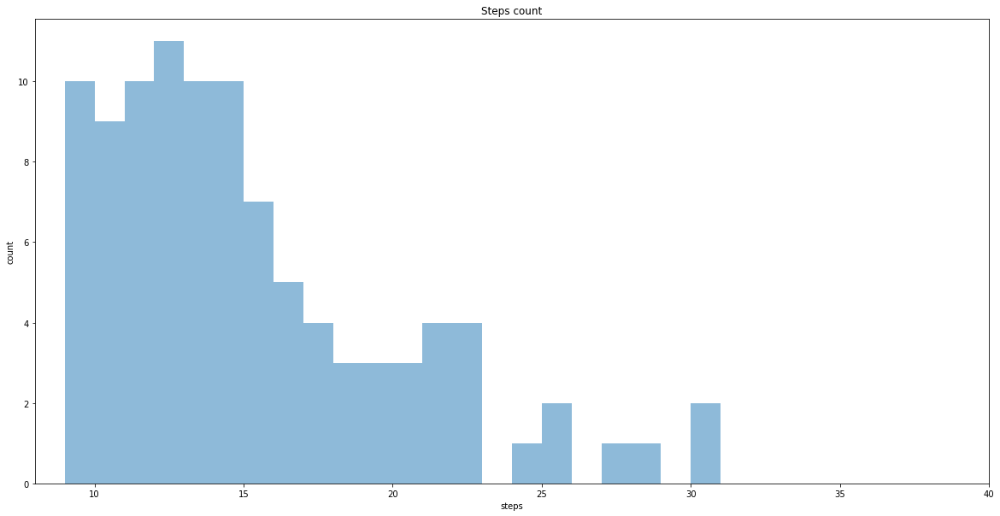

In [627]:
plt.figure(figsize=(20,10))
bins = np.arange(9, 40, 1) # fixed bin size

plt.xlim([8, 40])

plt.hist(ep_steps, bins=bins, alpha=0.5)
plt.title('Steps count')
plt.xlabel('steps')
plt.ylabel('count')

plt.show()

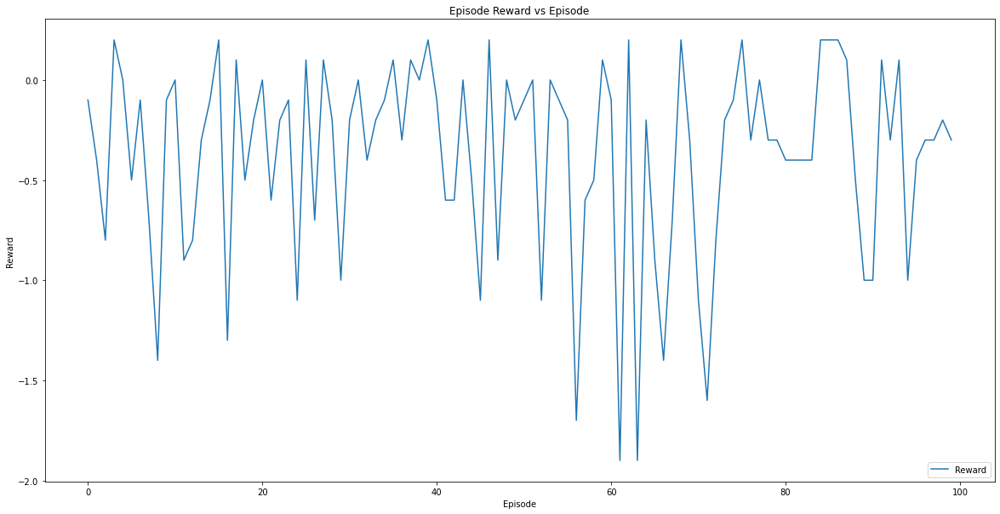

In [628]:
plt.figure(figsize=(20,10))
plt.plot(ep_rewards)
plt.title('Episode Reward vs Episode')
plt.ylabel('Reward')
plt.xlabel('Episode')
plt.legend(['Reward'], loc='lower right')
plt.show()

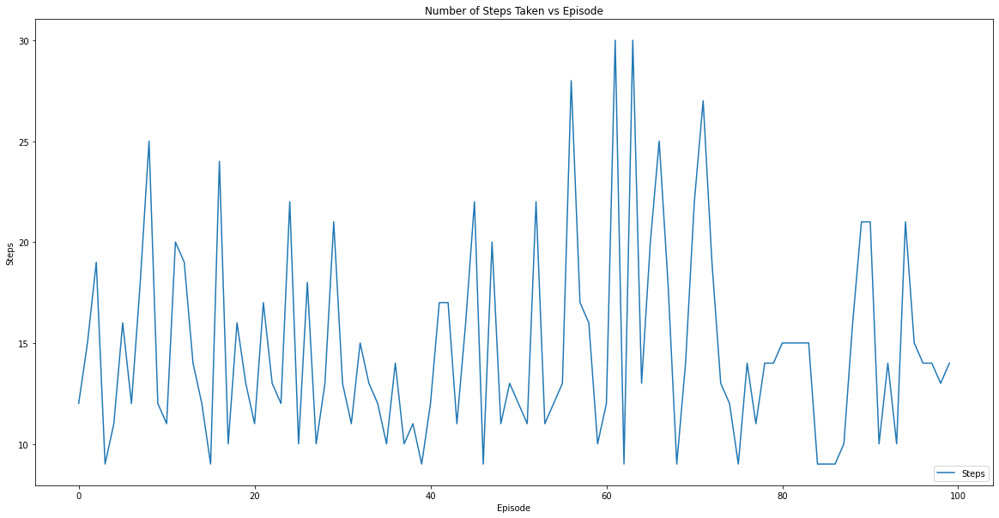

In [629]:
plt.figure(figsize=(20,10))
plt.plot(ep_steps)
plt.title('Number of Steps Taken vs Episode')
plt.ylabel('Steps')
plt.xlabel('Episode')
plt.legend(['Steps'], loc='lower right')
plt.show()